<a href="https://colab.research.google.com/github/xinruili07/MiniProject1/blob/master/project2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
from sklearn.datasets import load_digits
from sklearn.datasets import fetch_openml
soy = fetch_openml(name='soybean')
digits = load_digits()
import matplotlib.pyplot as plt
import numpy as np
from numpy import *
from IPython.core.debugger import set_trace
import warnings
from random import shuffle, randrange
import random
import time
warnings.filterwarnings('ignore')

/usr/local/lib/python3.6/dist-packages/sklearn/datasets/_openml.py:372: UserWarning: Multiple active versions of the dataset matching the name soybean exist. Versions may be fundamentally different, returning version 1.
  " {version}.".format(name=name, version=res[0]['version']))


In [2]:
def oneHotEncoder(y, classes):
  # pad with zeros when not target
    y = np.asarray(y, dtype='int32')
    output = np.zeros((len(y), classes))
    output[np.arange(len(y)), y] = 1
    return output


In [3]:
def softmax(z):
  # numerically stable softmax function (instead of regular softmax)
    z -= np.max(z)
    odds = (np.exp(z).T / np.sum(np.exp(z), axis=1)).T
    return odds

In [4]:
def averagAcc(x, y, weight):
  # check average accuracy over X data set
    y_hat_picked = np.argmax(x.dot(weight), 1)
    return np.mean(np.equal(y, y_hat_picked))

In [5]:
def gradientCalculator(x, y_oneHot, probabilities, regularization, weight):
    N,d = x.shape
    gradient = ((-1 / N) * np.dot(x.T,(y_oneHot - probabilities))) + (regularization * weight)
    return gradient

In [6]:
def costAndGradient(x, y_oneHot, weight, regularization):
    N,d = x.shape
    # compute predicted score z
    z = np.dot(x, weight)
    probabilities = softmax(z)

    cost = -np.log(np.max(probabilities)) * y_oneHot
    # regularizationCost is half of regularization times norm of weights
    regularizationCost = regularization/2*np.sum(weight*weight)
    totalCost = np.sum(cost)/N + regularizationCost

    # gradient of the cost
    gradient = gradientCalculator(x, y_oneHot, probabilities, regularization, weight)
    return totalCost, gradient

In [7]:
class MultiClassLogisticRegression:
    
    def __init__(self, add_bias=True):
      # by default add bias
        self.add_bias = add_bias
        self.best_accuracy = 0;
        self.all_accuracies = []

    def fit(self, x_train, x_valid, y_train, y_valid, optimizer, termination=None):
        if x_train.ndim == 1:
            x_train = x_train[:, None]
        if self.add_bias:
            N_train = x_train.shape[0]
            N_valid = x_valid.shape[0]
            x_train = np.column_stack([x_train,np.ones(N_train)])
            x_valid = np.column_stack([x_valid,np.ones(N_valid)])
        self.weight, self.training_Costs, self.validation_Costs, self.training_Accuracy, self.validation_Accuracy = optimizer.run(x_train, x_valid, y_train, y_valid, termination)      # run the optimizer to get the optimal weights
        if self.best_accuracy < self.validation_Accuracy[-1]:
          self.best_weight = self.weight
          self.best_accuracy = self.validation_Accuracy[-1]
          self.all_accuracies.append(self.validation_Accuracy[-1])
        return self
    
    def predict(self, x, y):
        if x.ndim == 1:
            x = x[:, None]
        Nt = x.shape[0]
        if self.add_bias:
            x = np.column_stack([x,np.ones(Nt)])
            # just return the most probable class
        accuracy = averagAcc(x, y, self.weight)
        print("_______________________DONE 5 FOLD_______________________")
        print("Best accuracy on validation set: " + str(self.best_accuracy))
        print("Average cross validation score: " + str(sum(self.all_accuracies)/len(self.all_accuracies)))
        print("Accuracy on test: " + str(accuracy))

        

In [8]:
class GradientDescent:

    def __init__(self, record_history = True, learning_rate=.07, max_iters=300, epsilon=1e-8, batch_size = 64, momentum=0.05, regularization = 0.001):
        self.batch_size = batch_size
        self.learning_rate = learning_rate
        self.max_iters = max_iters
        self.epsilon = epsilon
        self.regularization = regularization
        self.momentum = momentum
        self.record_history = record_history
        if record_history:
            self.w_history = []                 #to store the weight history for visualization
          
    def run(self, x_train, x_valid, y_train, y_valid, termination=None):
      start_time = time.perf_counter()
      training_Costs = []
      validation_Costs = []
      training_Accuracy = []
      validation_Accuracy = []
      D= x_train.shape[1]
      label = np.unique(np.concatenate((y_train, y_valid)))
      classes = len(label)
      self.weight = np.zeros((D, classes))
      self.velocity = np.zeros(self.weight.shape)
      y_train_encoded = oneHotEncoder(y_train, classes)
      y_valid_encoded = oneHotEncoder(y_valid, classes)
      for e in range(int(self.max_iters)):
        # Mini Batch gardient descent with random sampling of size batch size
        costs = []
        rand_indices = random.sample(range(x_train.shape[0]), x_train.shape[0])
        x = x_train[rand_indices]
        y = y_train_encoded[rand_indices]
        for i in range(0, x.shape[0], self.batch_size):
            Xbatch = x[i:i+self.batch_size]
            ybatch = y[i:i+self.batch_size]
            loss, gradient = costAndGradient(Xbatch, ybatch, self.weight, self.regularization)
            self.velocity = (self.momentum * self.velocity) + (self.learning_rate * gradient)
            self.weight -= self.velocity
            costs.append(loss)
        training_cost =  np.sum(costs) / len(costs)
        validation_cost, gradient_unecessary = costAndGradient(x_valid, y_valid_encoded, self.weight, self.regularization)
        # save costs and accuracy if save history is true
        if self.record_history:
          training_Accuracy.append(averagAcc(x_train, y_train, self.weight))
          validation_Accuracy.append(averagAcc(x_valid, y_valid, self.weight))
          training_Costs.append(training_cost)
          validation_Costs.append(validation_cost)
        if termination:
          if (termination.iter(validation_cost)):
            print(e)
            break;
          # TEMPORARY TO SPEED UP COMPUTATION____________________________________________________________________________________________________________________
        # print("{:d}\t Training Cost : {:.7f}\tValidation Cost : {:.7f}\tTraining Accuracy : {:.7f}\tValidation Accuracy: {:.7f}"
        #       .format(e, training_Costs[-1], validation_Costs[-1], training_Accuracy[-1], validation_Accuracy[-1]))
      end_time = time.perf_counter()
      print("training cost: " + str(training_Costs[-1]))
      print("validation cost: " + str(validation_Costs[-1]))
      print("training accuracy: " + str(training_Accuracy[-1]))
      print("validation accuracy: " + str(validation_Accuracy[-1]))
      print("time elapsed: " + str(end_time - start_time))
      print("learning rate: " + str(self.learning_rate))
      print("momentum : " + str(self.momentum))
      print("regularization: " + str(self.regularization))
      return self.weight, training_Costs, validation_Costs, training_Accuracy, validation_Accuracy

In [9]:
class GDTermination:
  def __init__(self, delta=1e-3, patience=20):
    self.patience = patience
    self.delta = delta
    self.current_loss = None
    self.counter = 0
  
  def iter(self, new_loss):
    if self.current_loss is None:
      self.current_loss = new_loss
      return False
    if new_loss < self.current_loss - self.delta:
      self.current_loss = new_loss
      self.counter = 0
    else:
      self.counter += 1
    
    return self.counter >= self.patience

In [10]:
# in best case, rewrite this


def plotGraph(trainLosses, testLosses, trainAcc, testAcc):
    plt.subplot(1, 2, 1)
    plt.plot(trainLosses, label="Train loss")
    plt.plot(testLosses, label="Test loss")
    plt.legend(loc='best')
    plt.title("Epochs vs. Cross Entropy Loss")
    plt.xlabel("Number of Iteration or Epochs")
    plt.ylabel("Cross Entropy Loss")

    plt.subplot(1, 2, 2)
    plt.plot(trainAcc, label="Train Accuracy")
    plt.plot(testAcc, label="Test Accuracy")
    plt.legend(loc='best')
    plt.title("Epochs vs. Mean per class Accuracy")
    plt.xlabel("Number of Iteration or Epochs")
    plt.ylabel("Mean per class Accuracy")
    plt.show()

In [11]:
def trainOnData(dataset):
  x, y = dataset['data'], dataset['target']
  where_are_NaNs = isnan(x)
  x[where_are_NaNs] = 0

# transform each class to a digit label
  uniqueClasses = np.unique(y)
  translation = {}
  for i in range(len(uniqueClasses)):
    translation[uniqueClasses[i]] = i
  for i in range(len(y)):
    y[i] = translation[y[i]]

  model = MultiClassLogisticRegression()
  # first split into data and test data, test data is 5% of all data
  x, x_test = np.split(x, [int(.95 * len(x))])
  y, y_test = np.split(y, [int(.95 * len(y))])
  for learning_rate in [0.001, 0.01, 0.1]:
    for momentum in [0.005, 0.05, 0.5]:
      for batch_size in [1, 10, 100]:
        for regularization in [0.1, 0.5, 0.9]:
          optimizer = GradientDescent(True, learning_rate, 300, 1e-08, batch_size, momentum, regularization)
          validation_size = len(y)//5
          for i in range(5):
            # 5 fold cross validation
            validation_indices = np.arange(start=validation_size * i, stop=validation_size * (i + 1), step=1)
            x_train = np.delete(x, validation_indices, 0)
            x_valid = np.take(x, validation_indices, 0)
            y_train = np.delete(y, validation_indices)
            y_valid = np.take(y, validation_indices)
            termination = GDTermination()
            model.fit(x_train,x_valid, y_train, y_valid, optimizer, termination)
            plotGraph(model.training_Costs, model.validation_Costs, model.training_Accuracy, model.validation_Accuracy)
        # check accuracy with weights that gave best accuracy
          model.predict(x_test, y_test)

Digits dataset

20
training cost: 0.1893289902483906
validation cost: 0.10435595557289046
training accuracy: 0.9824304538799414
validation accuracy: 0.9354838709677419
time elapsed: 2.847142040000108
learning rate: 0.001
momentum : 0.005
regularization: 0.1


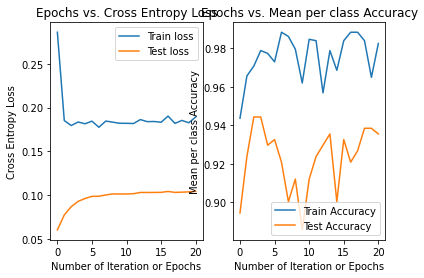

20
training cost: 0.17701995062625317
validation cost: 0.10110785980077645
training accuracy: 0.9707174231332357
validation accuracy: 0.873900293255132
time elapsed: 2.756442299000355
learning rate: 0.001
momentum : 0.005
regularization: 0.1


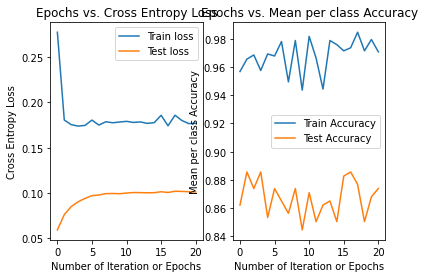

20
training cost: 0.1818722385080044
validation cost: 0.10285747978358906
training accuracy: 0.9751098096632503
validation accuracy: 0.9237536656891495
time elapsed: 2.7268981970000823
learning rate: 0.001
momentum : 0.005
regularization: 0.1


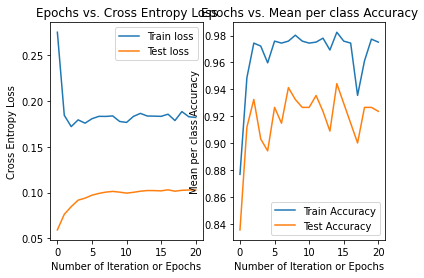

20
training cost: 0.190107761612546
validation cost: 0.10626635521354207
training accuracy: 0.9699853587115667
validation accuracy: 0.9354838709677419
time elapsed: 2.6925516269998298
learning rate: 0.001
momentum : 0.005
regularization: 0.1


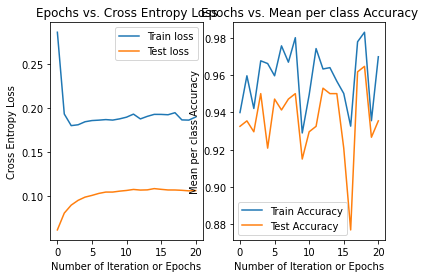

20
training cost: 0.16931420207254821
validation cost: 0.09684315428714413
training accuracy: 0.9831625183016105
validation accuracy: 0.9208211143695014
time elapsed: 2.700349214000198
learning rate: 0.001
momentum : 0.005
regularization: 0.1


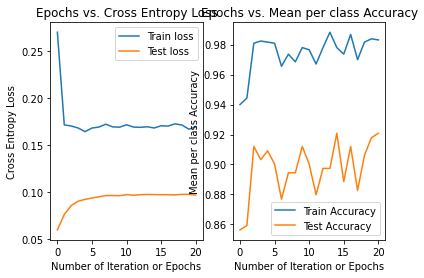

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9354838709677419
Average cross validation score: 0.9354838709677419
Accuracy on test: 0.9333333333333333
20
training cost: 0.3879504752568325
validation cost: 0.21389105963189226
training accuracy: 0.9458272327964861
validation accuracy: 0.8914956011730205
time elapsed: 2.8031609700001354
learning rate: 0.001
momentum : 0.005
regularization: 0.5


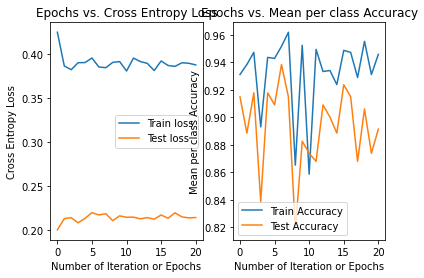

20
training cost: 0.3737635495266196
validation cost: 0.21225159829678755
training accuracy: 0.9633967789165446
validation accuracy: 0.8826979472140762
time elapsed: 2.733707521999804
learning rate: 0.001
momentum : 0.005
regularization: 0.5


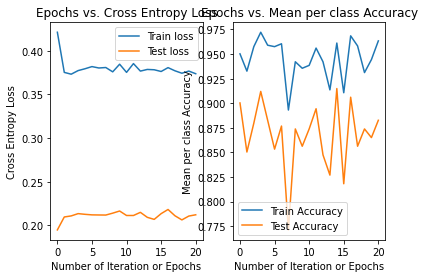

20
training cost: 0.3880680534908658
validation cost: 0.209295071528749
training accuracy: 0.9612005856515373
validation accuracy: 0.906158357771261
time elapsed: 2.765225988000111
learning rate: 0.001
momentum : 0.005
regularization: 0.5


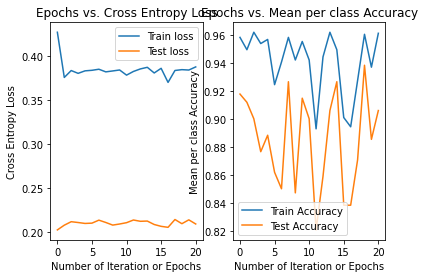

20
training cost: 0.3958887659116354
validation cost: 0.2224628784054554
training accuracy: 0.9524158125915081
validation accuracy: 0.9442815249266863
time elapsed: 2.697695407000083
learning rate: 0.001
momentum : 0.005
regularization: 0.5


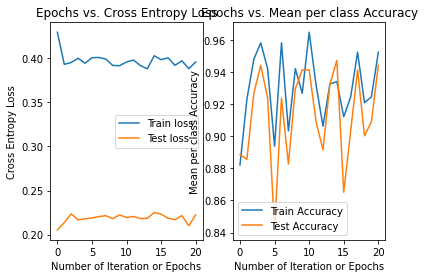

20
training cost: 0.36599012873208187
validation cost: 0.20487958974440007
training accuracy: 0.9560761346998536
validation accuracy: 0.8768328445747801
time elapsed: 2.686409635000018
learning rate: 0.001
momentum : 0.005
regularization: 0.5


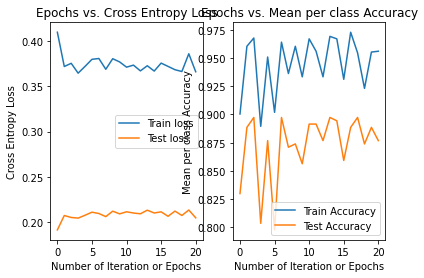

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9442815249266863
Average cross validation score: 0.9398826979472141
Accuracy on test: 0.8444444444444444
20
training cost: 0.5207024513806966
validation cost: 0.2805164030316322
training accuracy: 0.842606149341142
validation accuracy: 0.718475073313783
time elapsed: 2.8079116710000562
learning rate: 0.001
momentum : 0.005
regularization: 0.9


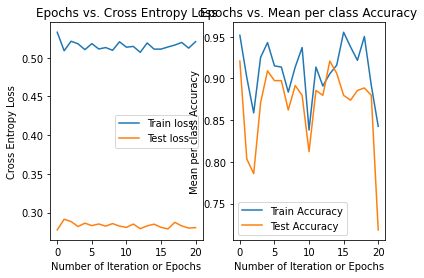

25
training cost: 0.4934373848904316
validation cost: 0.28104473482189907
training accuracy: 0.9568081991215227
validation accuracy: 0.8709677419354839
time elapsed: 3.362936443000308
learning rate: 0.001
momentum : 0.005
regularization: 0.9


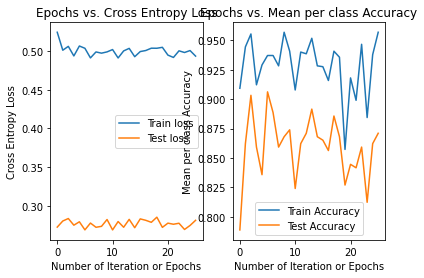

20
training cost: 0.5053041318018219
validation cost: 0.2721535256549862
training accuracy: 0.9297218155197657
validation accuracy: 0.8621700879765396
time elapsed: 2.706079788000352
learning rate: 0.001
momentum : 0.005
regularization: 0.9


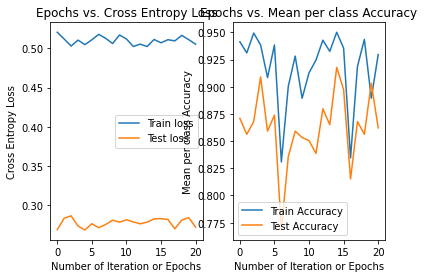

34
training cost: 0.5244238809028242
validation cost: 0.2938269614765175
training accuracy: 0.9209370424597365
validation accuracy: 0.9384164222873901
time elapsed: 4.526911026000107
learning rate: 0.001
momentum : 0.005
regularization: 0.9


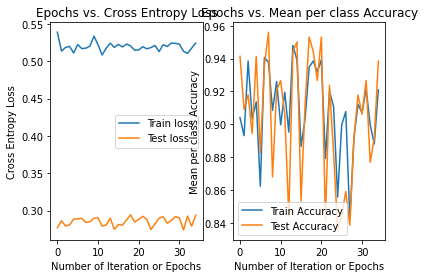

26
training cost: 0.48997623188988887
validation cost: 0.27807165564979974
training accuracy: 0.8887262079062958
validation accuracy: 0.782991202346041
time elapsed: 3.5281376780003484
learning rate: 0.001
momentum : 0.005
regularization: 0.9


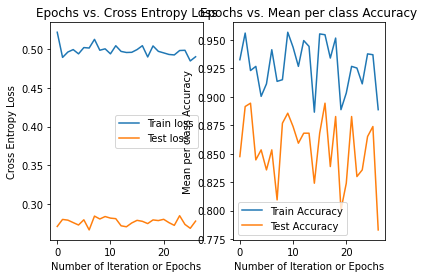

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9442815249266863
Average cross validation score: 0.9398826979472141
Accuracy on test: 0.8666666666666667
21
training cost: 0.06342372170051976
validation cost: 0.06038455685827627
training accuracy: 0.9824304538799414
validation accuracy: 0.9442815249266863
time elapsed: 0.4487980910002989
learning rate: 0.001
momentum : 0.005
regularization: 0.1


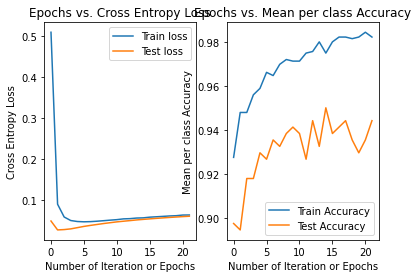

21
training cost: 0.061654570807649245
validation cost: 0.060058594240236615
training accuracy: 0.9809663250366032
validation accuracy: 0.8973607038123167
time elapsed: 0.4878131589998702
learning rate: 0.001
momentum : 0.005
regularization: 0.1


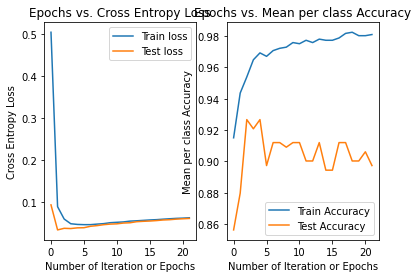

23
training cost: 0.06408116142838634
validation cost: 0.06142715333454438
training accuracy: 0.9809663250366032
validation accuracy: 0.9325513196480938
time elapsed: 0.49766510100016603
learning rate: 0.001
momentum : 0.005
regularization: 0.1


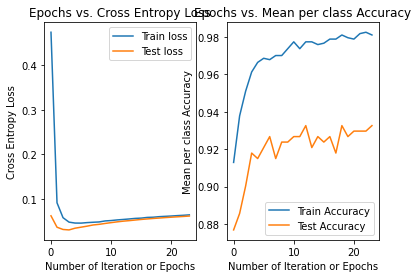

21
training cost: 0.06460784863258727
validation cost: 0.061433420457003535
training accuracy: 0.9816983894582724
validation accuracy: 0.9648093841642229
time elapsed: 0.5387719969999125
learning rate: 0.001
momentum : 0.005
regularization: 0.1


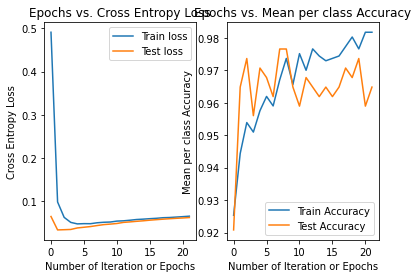

22
training cost: 0.06323658670960829
validation cost: 0.060446942445392185
training accuracy: 0.9824304538799414
validation accuracy: 0.9090909090909091
time elapsed: 0.5317666470000404
learning rate: 0.001
momentum : 0.005
regularization: 0.1


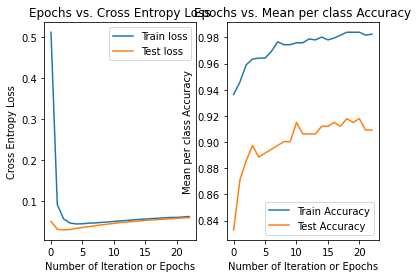

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9648093841642229
Average cross validation score: 0.9481915933528837
Accuracy on test: 0.9333333333333333
21
training cost: 0.1837246041976387
validation cost: 0.16607088495488573
training accuracy: 0.972181551976574
validation accuracy: 0.9442815249266863
time elapsed: 0.4550245659997927
learning rate: 0.001
momentum : 0.005
regularization: 0.5


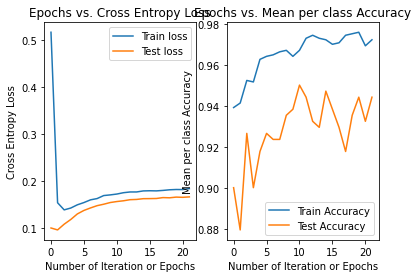

21
training cost: 0.17756799193162048
validation cost: 0.16961290611974805
training accuracy: 0.9751098096632503
validation accuracy: 0.9266862170087976
time elapsed: 0.4644469830000162
learning rate: 0.001
momentum : 0.005
regularization: 0.5


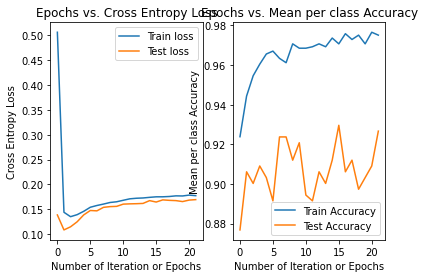

20
training cost: 0.17960130285971773
validation cost: 0.1676702690678717
training accuracy: 0.972913616398243
validation accuracy: 0.9296187683284457
time elapsed: 0.43128534299967214
learning rate: 0.001
momentum : 0.005
regularization: 0.5


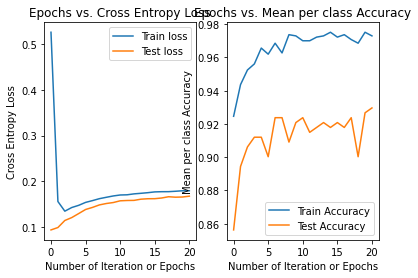

21
training cost: 0.1840881697755343
validation cost: 0.1733797083342523
training accuracy: 0.9692532942898975
validation accuracy: 0.9589442815249267
time elapsed: 0.446158233999995
learning rate: 0.001
momentum : 0.005
regularization: 0.5


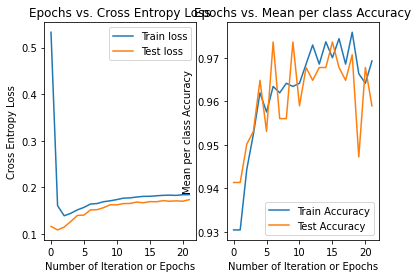

20
training cost: 0.1793158576896219
validation cost: 0.16714956425620614
training accuracy: 0.9743777452415813
validation accuracy: 0.9032258064516129
time elapsed: 0.47071011299976817
learning rate: 0.001
momentum : 0.005
regularization: 0.5


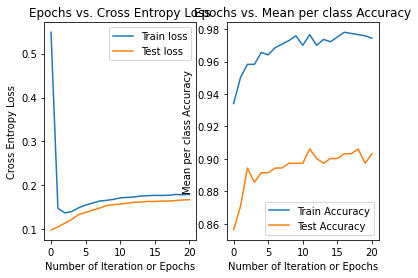

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9648093841642229
Average cross validation score: 0.9481915933528837
Accuracy on test: 0.9222222222222223
20
training cost: 0.2518666421762284
validation cost: 0.21961503462600707
training accuracy: 0.9655929721815519
validation accuracy: 0.9090909090909091
time elapsed: 0.4405046459996811
learning rate: 0.001
momentum : 0.005
regularization: 0.9


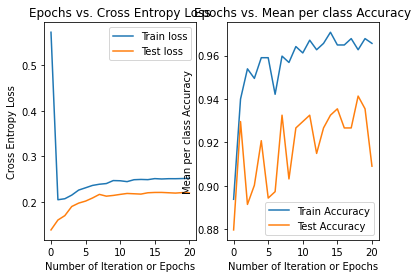

20
training cost: 0.24239629101189095
validation cost: 0.2286985310192841
training accuracy: 0.9699853587115667
validation accuracy: 0.9237536656891495
time elapsed: 0.4319291419997171
learning rate: 0.001
momentum : 0.005
regularization: 0.9


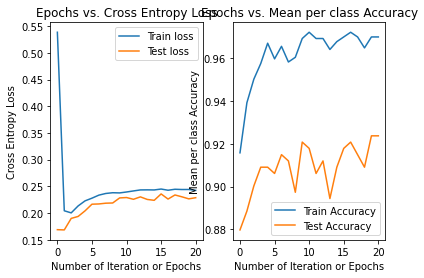

20
training cost: 0.2472376627240116
validation cost: 0.22063564978566075
training accuracy: 0.9670571010248902
validation accuracy: 0.9178885630498533
time elapsed: 0.44374649300016245
learning rate: 0.001
momentum : 0.005
regularization: 0.9


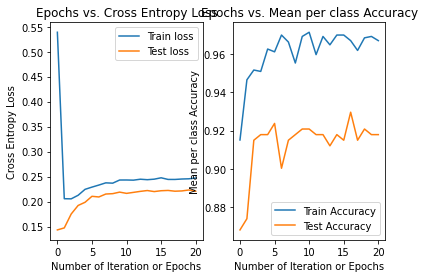

20
training cost: 0.2548884369399025
validation cost: 0.2315786048313503
training accuracy: 0.9670571010248902
validation accuracy: 0.9736070381231672
time elapsed: 0.4263673650002602
learning rate: 0.001
momentum : 0.005
regularization: 0.9


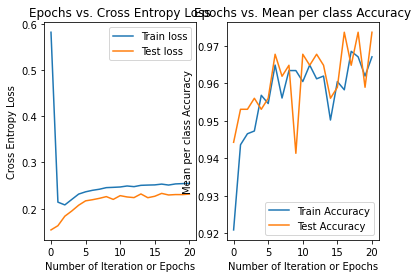

20
training cost: 0.24830942503338002
validation cost: 0.22199345399650555
training accuracy: 0.972181551976574
validation accuracy: 0.8973607038123167
time elapsed: 0.42692962199998874
learning rate: 0.001
momentum : 0.005
regularization: 0.9


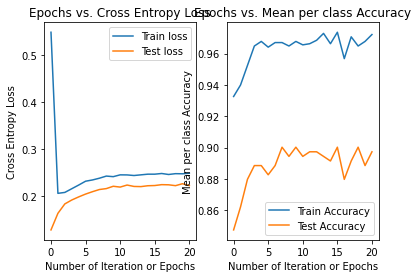

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9111111111111111
40
training cost: 0.0360201635870852
validation cost: 0.03032091061653653
training accuracy: 0.9604685212298683
validation accuracy: 0.9237536656891495
time elapsed: 0.30129624100027286
learning rate: 0.001
momentum : 0.005
regularization: 0.1


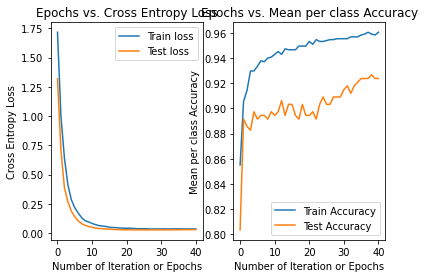

57
training cost: 0.037910983475655184
validation cost: 0.039054404828350896
training accuracy: 0.9685212298682284
validation accuracy: 0.9178885630498533
time elapsed: 0.4186640430002626
learning rate: 0.001
momentum : 0.005
regularization: 0.1


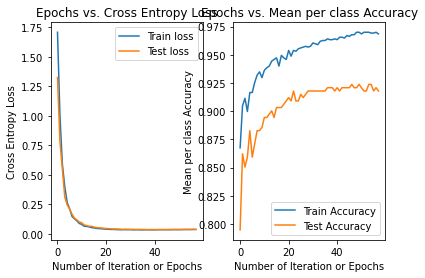

46
training cost: 0.03506349412551408
validation cost: 0.0329333566162697
training accuracy: 0.9670571010248902
validation accuracy: 0.9237536656891495
time elapsed: 0.3402415830000791
learning rate: 0.001
momentum : 0.005
regularization: 0.1


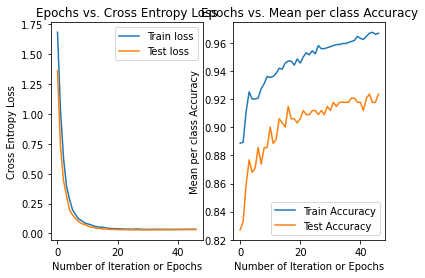

48
training cost: 0.03613094381209896
validation cost: 0.0366927824891545
training accuracy: 0.9612005856515373
validation accuracy: 0.9648093841642229
time elapsed: 0.3394410070000049
learning rate: 0.001
momentum : 0.005
regularization: 0.1


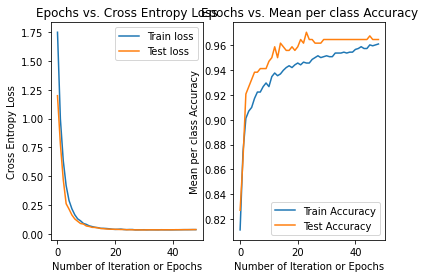

48
training cost: 0.03673443952913937
validation cost: 0.03358459151747336
training accuracy: 0.9655929721815519
validation accuracy: 0.8973607038123167
time elapsed: 0.3562356819998058
learning rate: 0.001
momentum : 0.005
regularization: 0.1


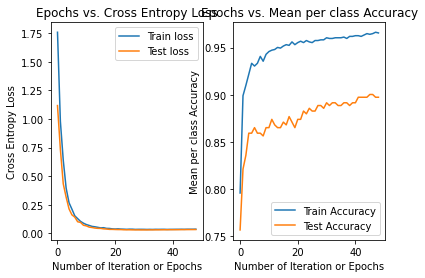

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9222222222222223
32
training cost: 0.1240973449893787
validation cost: 0.11177340001118194
training accuracy: 0.9568081991215227
validation accuracy: 0.9149560117302052
time elapsed: 0.23235292499975913
learning rate: 0.001
momentum : 0.005
regularization: 0.5


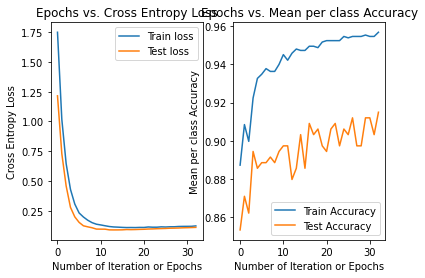

43
training cost: 0.1309511257944745
validation cost: 0.1320390364158526
training accuracy: 0.9641288433382138
validation accuracy: 0.9208211143695014
time elapsed: 0.33215807999977187
learning rate: 0.001
momentum : 0.005
regularization: 0.5


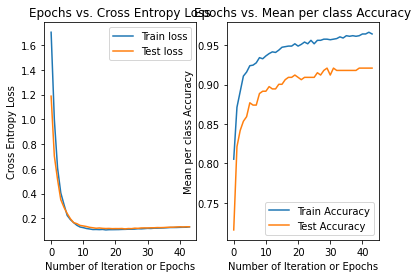

39
training cost: 0.12728511008755183
validation cost: 0.12179823114530808
training accuracy: 0.9633967789165446
validation accuracy: 0.9178885630498533
time elapsed: 0.2822462919998543
learning rate: 0.001
momentum : 0.005
regularization: 0.5


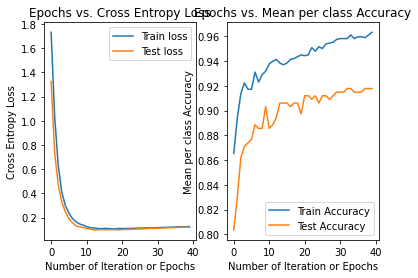

35
training cost: 0.12269988390248078
validation cost: 0.1236662540020646
training accuracy: 0.9516837481698389
validation accuracy: 0.9648093841642229
time elapsed: 0.250978989000032
learning rate: 0.001
momentum : 0.005
regularization: 0.5


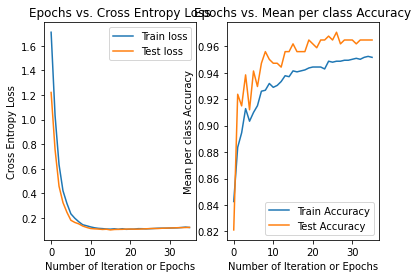

32
training cost: 0.1205354267110215
validation cost: 0.11590233122855295
training accuracy: 0.9604685212298683
validation accuracy: 0.8914956011730205
time elapsed: 0.2442727749998994
learning rate: 0.001
momentum : 0.005
regularization: 0.5


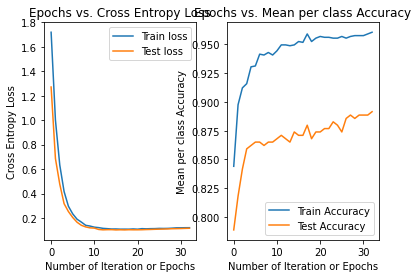

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9111111111111111
30
training cost: 0.1872800468223164
validation cost: 0.17309513380116168
training accuracy: 0.9560761346998536
validation accuracy: 0.906158357771261
time elapsed: 0.22368853099987973
learning rate: 0.001
momentum : 0.005
regularization: 0.9


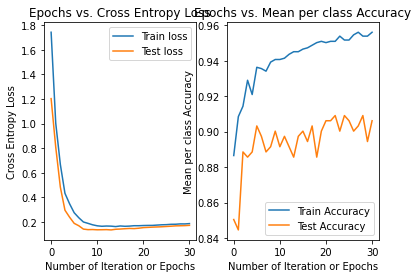

34
training cost: 0.18985160197152132
validation cost: 0.1947364764419144
training accuracy: 0.958272327964861
validation accuracy: 0.9178885630498533
time elapsed: 0.24365661799993177
learning rate: 0.001
momentum : 0.005
regularization: 0.9


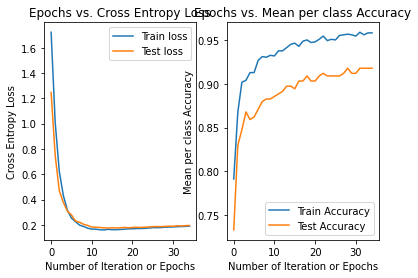

33
training cost: 0.1870118424696447
validation cost: 0.18164541192642547
training accuracy: 0.95900439238653
validation accuracy: 0.9120234604105572
time elapsed: 0.24225347399988095
learning rate: 0.001
momentum : 0.005
regularization: 0.9


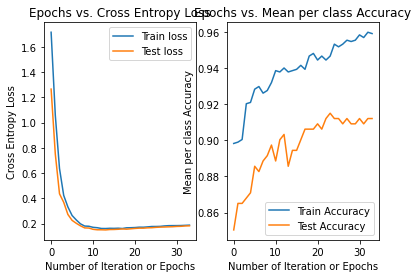

34
training cost: 0.18971621857917537
validation cost: 0.1907020079064426
training accuracy: 0.9516837481698389
validation accuracy: 0.967741935483871
time elapsed: 0.248312815999725
learning rate: 0.001
momentum : 0.005
regularization: 0.9


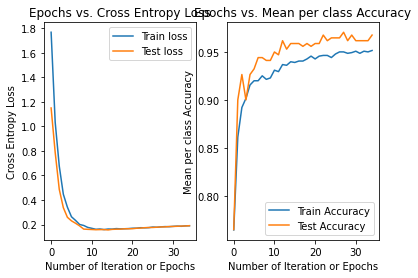

31
training cost: 0.18704104579518677
validation cost: 0.18024389657130202
training accuracy: 0.9575402635431918
validation accuracy: 0.8826979472140762
time elapsed: 0.23304605500015896
learning rate: 0.001
momentum : 0.005
regularization: 0.9


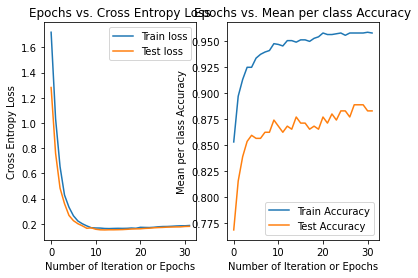

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9222222222222223
20
training cost: 0.18680771754968784
validation cost: 0.10482277766927445
training accuracy: 0.9275256222547584
validation accuracy: 0.9237536656891495
time elapsed: 2.7120930529999896
learning rate: 0.001
momentum : 0.05
regularization: 0.1


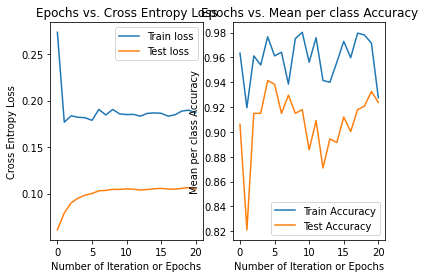

20
training cost: 0.18005851951202412
validation cost: 0.1026819829761638
training accuracy: 0.9795021961932651
validation accuracy: 0.841642228739003
time elapsed: 2.6932721749999473
learning rate: 0.001
momentum : 0.05
regularization: 0.1


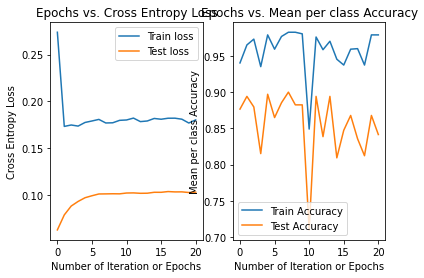

20
training cost: 0.1824434972333935
validation cost: 0.10368706620599695
training accuracy: 0.9809663250366032
validation accuracy: 0.9472140762463344
time elapsed: 2.707327433000046
learning rate: 0.001
momentum : 0.05
regularization: 0.1


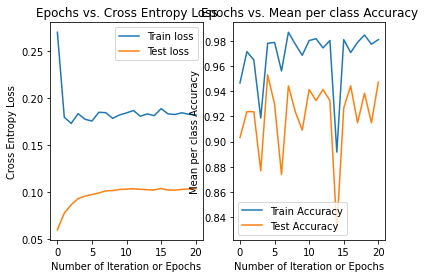

20
training cost: 0.19062961344506302
validation cost: 0.10934749949715056
training accuracy: 0.9531478770131772
validation accuracy: 0.9354838709677419
time elapsed: 2.6749405300001854
learning rate: 0.001
momentum : 0.05
regularization: 0.1


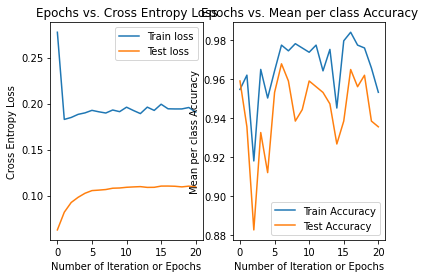

20
training cost: 0.173893274107258
validation cost: 0.09916955719191833
training accuracy: 0.9890190336749634
validation accuracy: 0.9090909090909091
time elapsed: 2.673977833000208
learning rate: 0.001
momentum : 0.05
regularization: 0.1


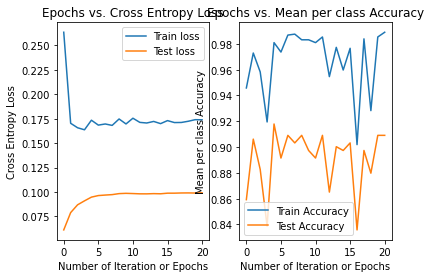

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9222222222222223
20
training cost: 0.39481793644518376
validation cost: 0.2151710436459723
training accuracy: 0.9494875549048316
validation accuracy: 0.9032258064516129
time elapsed: 2.7293455019998873
learning rate: 0.001
momentum : 0.05
regularization: 0.5


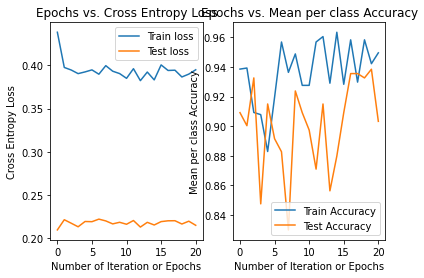

37
training cost: 0.3832864192337334
validation cost: 0.21954838586792624
training accuracy: 0.8748169838945827
validation accuracy: 0.7565982404692082
time elapsed: 4.932944528999997
learning rate: 0.001
momentum : 0.05
regularization: 0.5


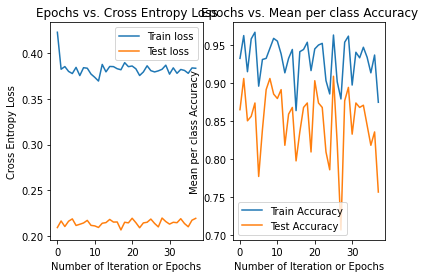

20
training cost: 0.39118217867804783
validation cost: 0.21287788626725815
training accuracy: 0.9626647144948756
validation accuracy: 0.9120234604105572
time elapsed: 2.711905793000369
learning rate: 0.001
momentum : 0.05
regularization: 0.5


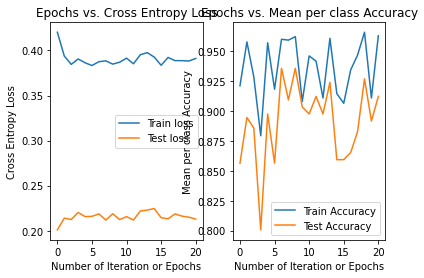

20
training cost: 0.40231014656705694
validation cost: 0.22197313244085023
training accuracy: 0.9421669106881405
validation accuracy: 0.9325513196480938
time elapsed: 2.7273974999998245
learning rate: 0.001
momentum : 0.05
regularization: 0.5


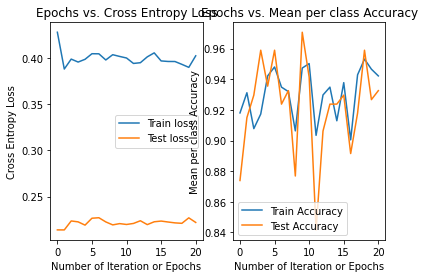

20
training cost: 0.38248961281355265
validation cost: 0.21539760798465954
training accuracy: 0.9275256222547584
validation accuracy: 0.8504398826979472
time elapsed: 2.702925060000325
learning rate: 0.001
momentum : 0.05
regularization: 0.5


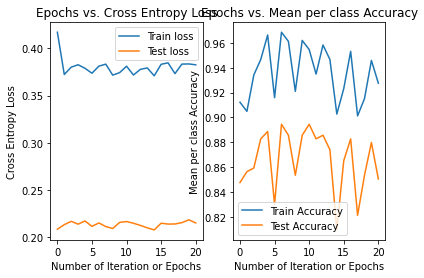

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9333333333333333
29
training cost: 0.5234826779190234
validation cost: 0.28120973768415863
training accuracy: 0.9363103953147877
validation accuracy: 0.906158357771261
time elapsed: 3.8521949109999696
learning rate: 0.001
momentum : 0.05
regularization: 0.9


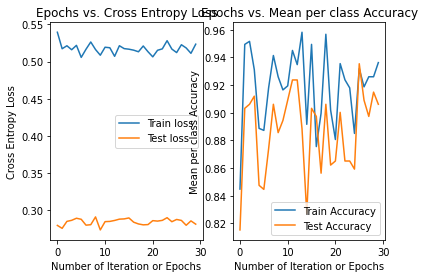

23
training cost: 0.5114552654410972
validation cost: 0.28883793884757375
training accuracy: 0.9209370424597365
validation accuracy: 0.8504398826979472
time elapsed: 3.168576523000411
learning rate: 0.001
momentum : 0.05
regularization: 0.9


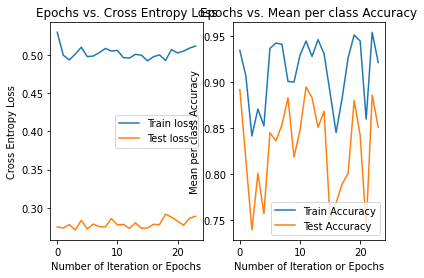

36
training cost: 0.5236988156298537
validation cost: 0.2832465271713217
training accuracy: 0.9238653001464129
validation accuracy: 0.8533724340175953
time elapsed: 4.771047535999969
learning rate: 0.001
momentum : 0.05
regularization: 0.9


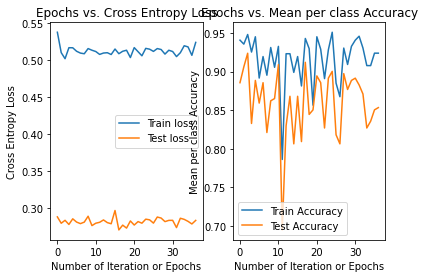

52
training cost: 0.5234979609998598
validation cost: 0.2950617669184882
training accuracy: 0.8960468521229868
validation accuracy: 0.9090909090909091
time elapsed: 6.934917176999988
learning rate: 0.001
momentum : 0.05
regularization: 0.9


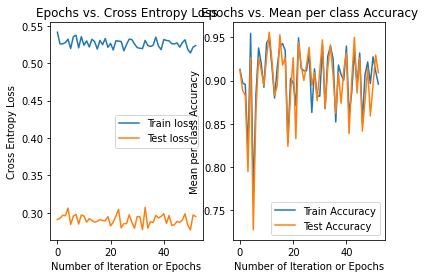

22
training cost: 0.5016640787880711
validation cost: 0.28606509169757993
training accuracy: 0.9612005856515373
validation accuracy: 0.8680351906158358
time elapsed: 2.975139621999915
learning rate: 0.001
momentum : 0.05
regularization: 0.9


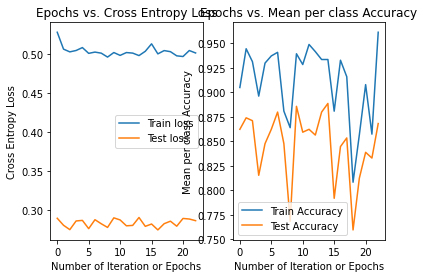

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.8888888888888888
22
training cost: 0.06522336910454088
validation cost: 0.062187092166929574
training accuracy: 0.9846266471449487
validation accuracy: 0.9442815249266863
time elapsed: 0.477065310999933
learning rate: 0.001
momentum : 0.05
regularization: 0.1


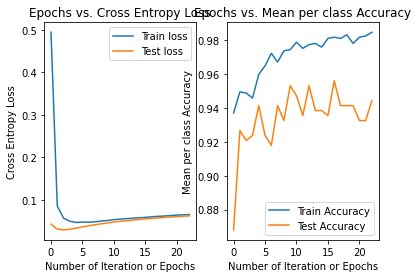

21
training cost: 0.06264035507013212
validation cost: 0.06123049002336518
training accuracy: 0.9824304538799414
validation accuracy: 0.906158357771261
time elapsed: 0.44184772399967187
learning rate: 0.001
momentum : 0.05
regularization: 0.1


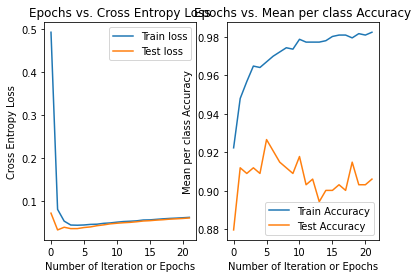

21
training cost: 0.06307635676205023
validation cost: 0.06081147473094424
training accuracy: 0.9831625183016105
validation accuracy: 0.9296187683284457
time elapsed: 0.45859044200005883
learning rate: 0.001
momentum : 0.05
regularization: 0.1


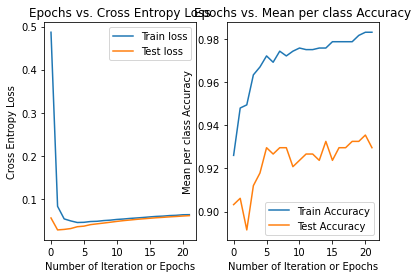

22
training cost: 0.06575558017451145
validation cost: 0.06305668815560275
training accuracy: 0.9795021961932651
validation accuracy: 0.9589442815249267
time elapsed: 0.46982968000020264
learning rate: 0.001
momentum : 0.05
regularization: 0.1


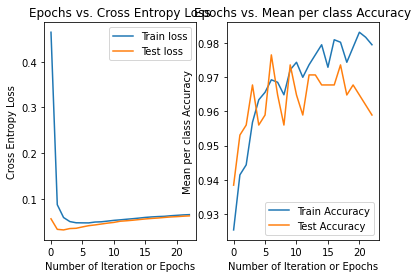

21
training cost: 0.06330503207651696
validation cost: 0.060443412223897555
training accuracy: 0.9831625183016105
validation accuracy: 0.9237536656891495
time elapsed: 0.4439287109998986
learning rate: 0.001
momentum : 0.05
regularization: 0.1


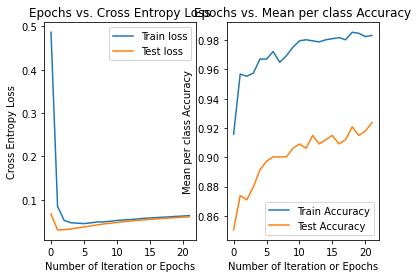

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9111111111111111
21
training cost: 0.18326595811345167
validation cost: 0.16731934572555932
training accuracy: 0.972181551976574
validation accuracy: 0.9413489736070382
time elapsed: 0.4437333029995898
learning rate: 0.001
momentum : 0.05
regularization: 0.5


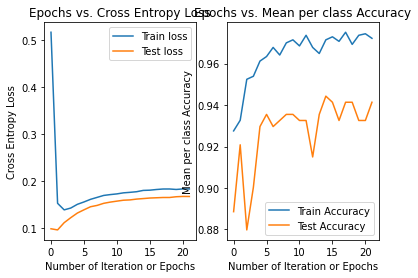

21
training cost: 0.17849426322561812
validation cost: 0.16770412207997618
training accuracy: 0.972913616398243
validation accuracy: 0.906158357771261
time elapsed: 0.44376106699974116
learning rate: 0.001
momentum : 0.05
regularization: 0.5


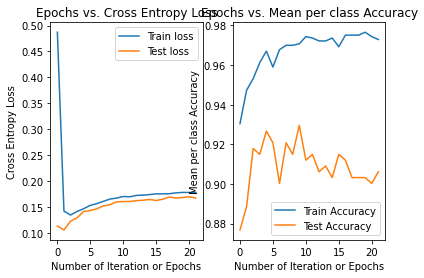

20
training cost: 0.17950469567514007
validation cost: 0.16706319849771356
training accuracy: 0.9743777452415813
validation accuracy: 0.9266862170087976
time elapsed: 0.43715412100027606
learning rate: 0.001
momentum : 0.05
regularization: 0.5


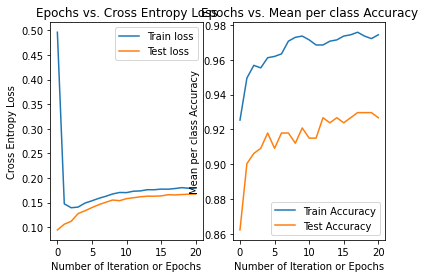

21
training cost: 0.1856293704849908
validation cost: 0.17335314963924436
training accuracy: 0.972913616398243
validation accuracy: 0.9706744868035191
time elapsed: 0.48894986899995274
learning rate: 0.001
momentum : 0.05
regularization: 0.5


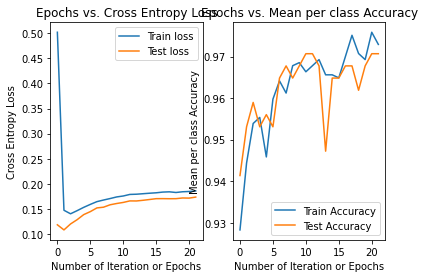

21
training cost: 0.1801778132720738
validation cost: 0.1663985157847641
training accuracy: 0.9765739385065886
validation accuracy: 0.9032258064516129
time elapsed: 0.44673168199960855
learning rate: 0.001
momentum : 0.05
regularization: 0.5


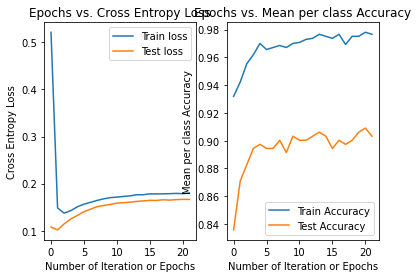

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9333333333333333
20
training cost: 0.2509970923035822
validation cost: 0.22117205142047816
training accuracy: 0.9663250366032211
validation accuracy: 0.9178885630498533
time elapsed: 0.4281046480000441
learning rate: 0.001
momentum : 0.05
regularization: 0.9


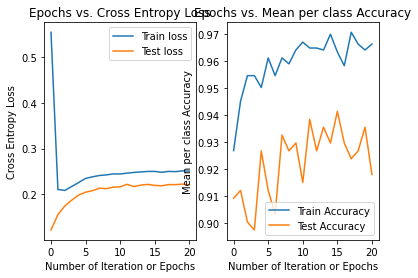

20
training cost: 0.24446168022067657
validation cost: 0.2274683223868867
training accuracy: 0.9685212298682284
validation accuracy: 0.906158357771261
time elapsed: 0.42465726599994014
learning rate: 0.001
momentum : 0.05
regularization: 0.9


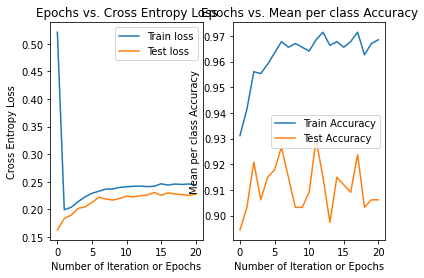

20
training cost: 0.24731883058911283
validation cost: 0.22388655766100893
training accuracy: 0.9663250366032211
validation accuracy: 0.9120234604105572
time elapsed: 0.435747038000045
learning rate: 0.001
momentum : 0.05
regularization: 0.9


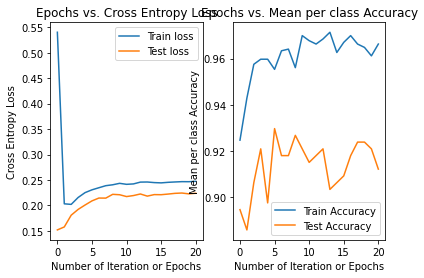

20
training cost: 0.2518150176687377
validation cost: 0.23224764934341574
training accuracy: 0.9626647144948756
validation accuracy: 0.9648093841642229
time elapsed: 0.4923494660001779
learning rate: 0.001
momentum : 0.05
regularization: 0.9


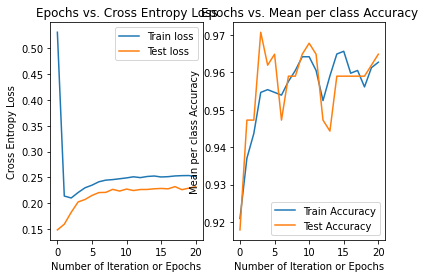

20
training cost: 0.2485748327941345
validation cost: 0.22007942918303525
training accuracy: 0.9655929721815519
validation accuracy: 0.8826979472140762
time elapsed: 0.42299818900028185
learning rate: 0.001
momentum : 0.05
regularization: 0.9


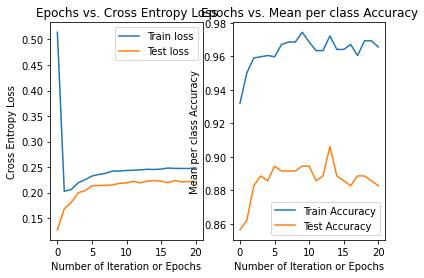

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.8777777777777778
41
training cost: 0.03618419940470846
validation cost: 0.031142343324904988
training accuracy: 0.9619326500732065
validation accuracy: 0.9237536656891495
time elapsed: 0.332965687000069
learning rate: 0.001
momentum : 0.05
regularization: 0.1


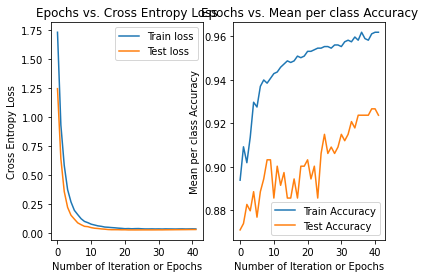

51
training cost: 0.03689836431681846
validation cost: 0.038864567048426946
training accuracy: 0.9677891654465594
validation accuracy: 0.9208211143695014
time elapsed: 0.3683900920000269
learning rate: 0.001
momentum : 0.05
regularization: 0.1


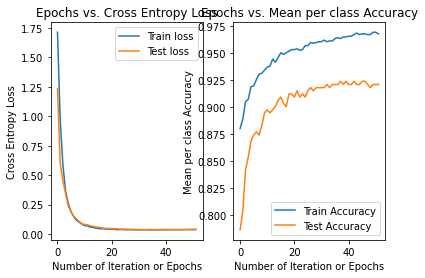

41
training cost: 0.03517442182098403
validation cost: 0.03209202065101024
training accuracy: 0.9670571010248902
validation accuracy: 0.9237536656891495
time elapsed: 0.32554599499962933
learning rate: 0.001
momentum : 0.05
regularization: 0.1


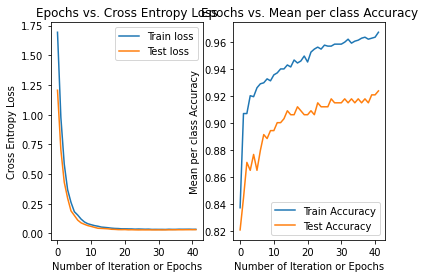

49
training cost: 0.036793092187309764
validation cost: 0.03714603025730764
training accuracy: 0.9626647144948756
validation accuracy: 0.9648093841642229
time elapsed: 0.3797160469998744
learning rate: 0.001
momentum : 0.05
regularization: 0.1


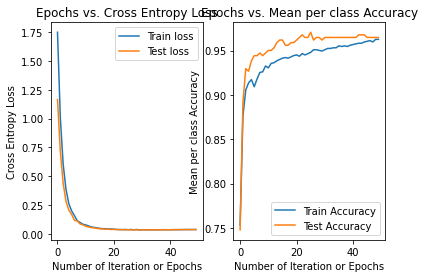

42
training cost: 0.03559438327109089
validation cost: 0.03281904885443707
training accuracy: 0.9648609077598829
validation accuracy: 0.8944281524926686
time elapsed: 0.3062432329998046
learning rate: 0.001
momentum : 0.05
regularization: 0.1


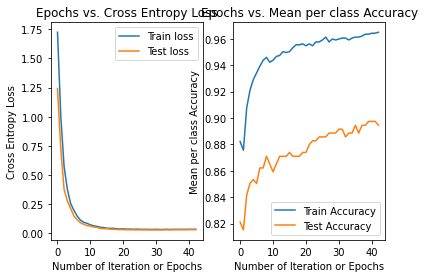

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9111111111111111
31
training cost: 0.12295712055767317
validation cost: 0.11213833754000892
training accuracy: 0.9560761346998536
validation accuracy: 0.9149560117302052
time elapsed: 0.2384428189998289
learning rate: 0.001
momentum : 0.05
regularization: 0.5


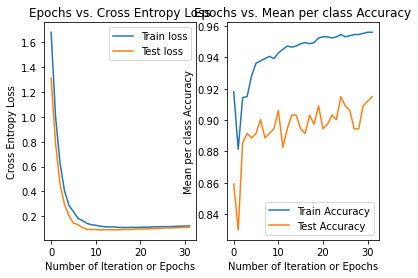

36
training cost: 0.12549449782508515
validation cost: 0.12688575379799993
training accuracy: 0.9619326500732065
validation accuracy: 0.9178885630498533
time elapsed: 0.28238989400006176
learning rate: 0.001
momentum : 0.05
regularization: 0.5


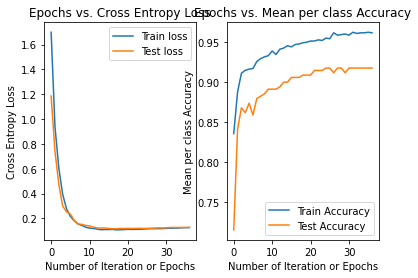

35
training cost: 0.12357338793956131
validation cost: 0.11966501063313409
training accuracy: 0.9597364568081991
validation accuracy: 0.9149560117302052
time elapsed: 0.255320959999608
learning rate: 0.001
momentum : 0.05
regularization: 0.5


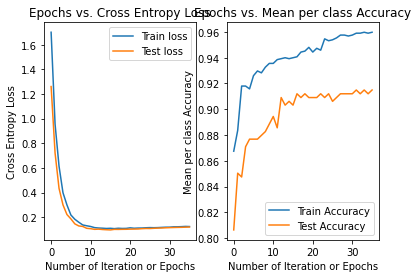

37
training cost: 0.1279951525257379
validation cost: 0.12825688950815806
training accuracy: 0.9531478770131772
validation accuracy: 0.9648093841642229
time elapsed: 0.2769419870001002
learning rate: 0.001
momentum : 0.05
regularization: 0.5


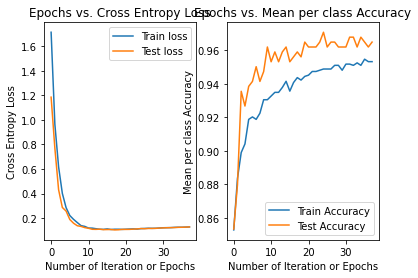

32
training cost: 0.12264439327703316
validation cost: 0.11770641317322306
training accuracy: 0.95900439238653
validation accuracy: 0.8885630498533724
time elapsed: 0.2613432169996486
learning rate: 0.001
momentum : 0.05
regularization: 0.5


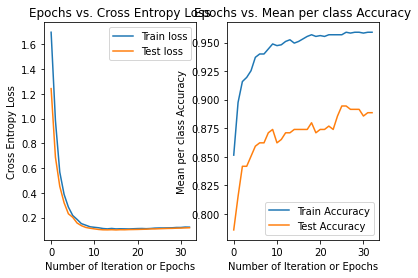

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9222222222222223
31
training cost: 0.1909547485618976
validation cost: 0.17656667707092166
training accuracy: 0.9553440702781845
validation accuracy: 0.9002932551319648
time elapsed: 0.2339326470000742
learning rate: 0.001
momentum : 0.05
regularization: 0.9


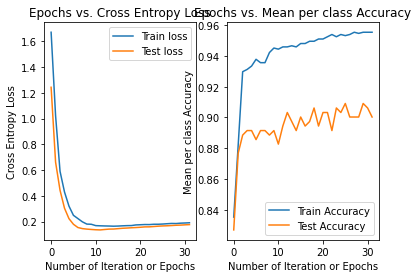

31
training cost: 0.18845400034059562
validation cost: 0.19139188472387145
training accuracy: 0.9575402635431918
validation accuracy: 0.9178885630498533
time elapsed: 0.222279386000082
learning rate: 0.001
momentum : 0.05
regularization: 0.9


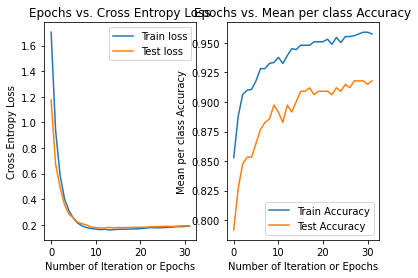

31
training cost: 0.1867459328280412
validation cost: 0.1807264422067115
training accuracy: 0.95900439238653
validation accuracy: 0.9120234604105572
time elapsed: 0.23525904300004186
learning rate: 0.001
momentum : 0.05
regularization: 0.9


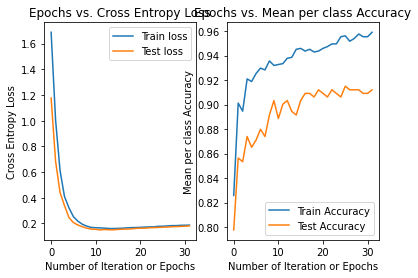

31
training cost: 0.18782392015614038
validation cost: 0.19003649432921543
training accuracy: 0.9502196193265008
validation accuracy: 0.967741935483871
time elapsed: 0.22341063800013217
learning rate: 0.001
momentum : 0.05
regularization: 0.9


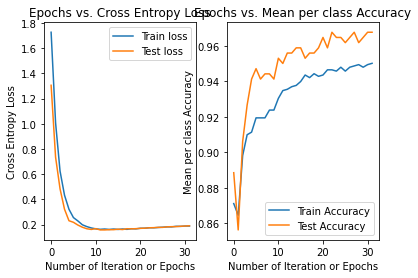

30
training cost: 0.18836378100957832
validation cost: 0.18224071343550385
training accuracy: 0.958272327964861
validation accuracy: 0.8885630498533724
time elapsed: 0.24066374699987136
learning rate: 0.001
momentum : 0.05
regularization: 0.9


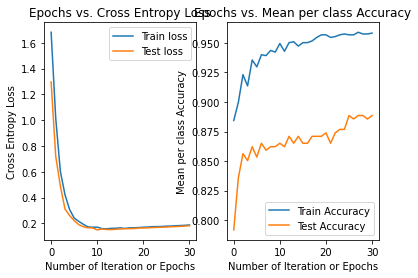

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9222222222222223
20
training cost: 0.23582023974089877
validation cost: 0.1667334261174664
training accuracy: 0.9758418740849195
validation accuracy: 0.9237536656891495
time elapsed: 2.8946132169999146
learning rate: 0.001
momentum : 0.5
regularization: 0.1


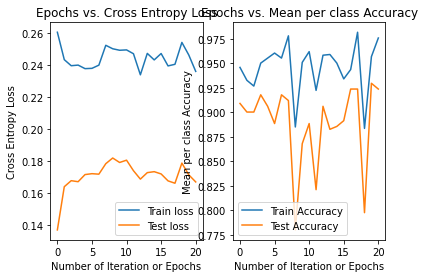

20
training cost: 0.23626660432181706
validation cost: 0.17122022458235012
training accuracy: 0.9612005856515373
validation accuracy: 0.8797653958944281
time elapsed: 2.715305705999981
learning rate: 0.001
momentum : 0.5
regularization: 0.1


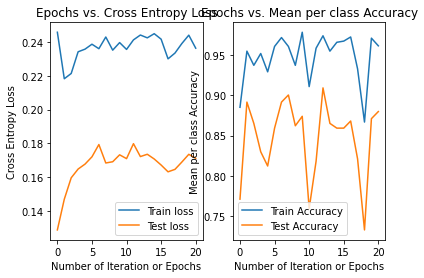

20
training cost: 0.23571340512908837
validation cost: 0.16621908053325385
training accuracy: 0.9341142020497804
validation accuracy: 0.8973607038123167
time elapsed: 2.741522163999889
learning rate: 0.001
momentum : 0.5
regularization: 0.1


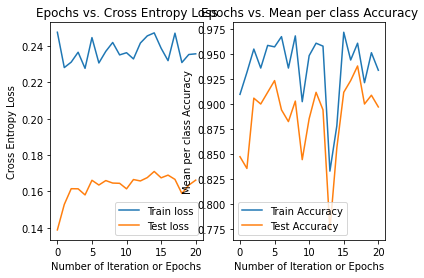

20
training cost: 0.2604405807005079
validation cost: 0.19527115734713135
training accuracy: 0.945095168374817
validation accuracy: 0.9149560117302052
time elapsed: 2.6938232779998543
learning rate: 0.001
momentum : 0.5
regularization: 0.1


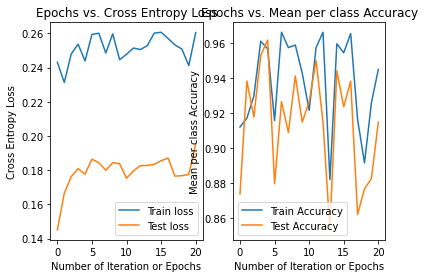

20
training cost: 0.23551480665949517
validation cost: 0.1702668902746496
training accuracy: 0.9348462664714495
validation accuracy: 0.8709677419354839
time elapsed: 2.8292805750002117
learning rate: 0.001
momentum : 0.5
regularization: 0.1


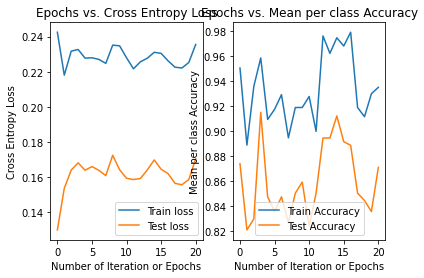

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9222222222222223
24
training cost: 0.49696876034014886
validation cost: 0.3503759123499933
training accuracy: 0.9421669106881405
validation accuracy: 0.8944281524926686
time elapsed: 3.2143275900002664
learning rate: 0.001
momentum : 0.5
regularization: 0.5


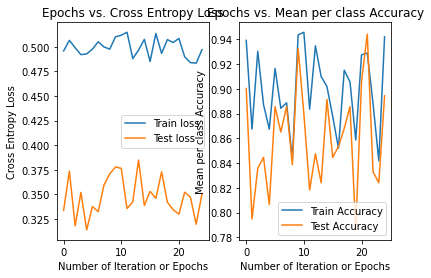

23
training cost: 0.4629734403442073
validation cost: 0.32492642981289804
training accuracy: 0.7035139092240117
validation accuracy: 0.6422287390029325
time elapsed: 3.1272193919999154
learning rate: 0.001
momentum : 0.5
regularization: 0.5


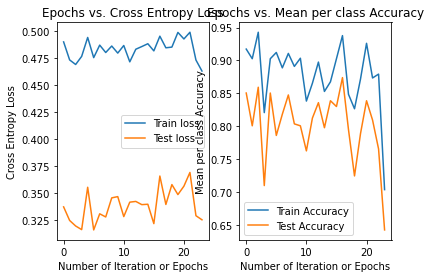

54
training cost: 0.4883165943432495
validation cost: 0.36185720116119224
training accuracy: 0.8784773060029283
validation accuracy: 0.7624633431085044
time elapsed: 7.339133794999725
learning rate: 0.001
momentum : 0.5
regularization: 0.5


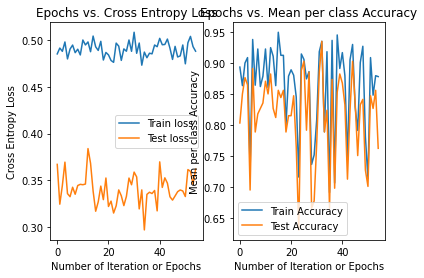

22
training cost: 0.5243032844913686
validation cost: 0.3713500566268474
training accuracy: 0.9165446559297218
validation accuracy: 0.9237536656891495
time elapsed: 3.1418840979999914
learning rate: 0.001
momentum : 0.5
regularization: 0.5


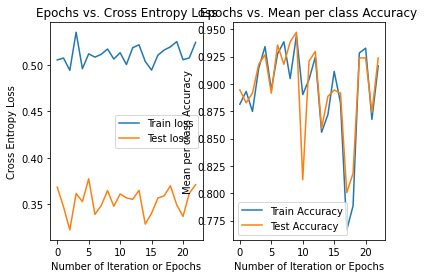

30
training cost: 0.48761517348505906
validation cost: 0.3434789899369098
training accuracy: 0.9216691068814056
validation accuracy: 0.8621700879765396
time elapsed: 4.0122009639999305
learning rate: 0.001
momentum : 0.5
regularization: 0.5


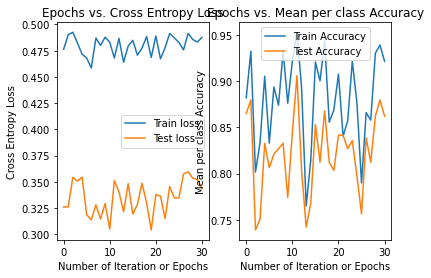

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.8444444444444444
27
training cost: 0.6516825878158209
validation cost: 0.4264702889052055
training accuracy: 0.8696925329428989
validation accuracy: 0.8387096774193549
time elapsed: 3.6727287449998585
learning rate: 0.001
momentum : 0.5
regularization: 0.9


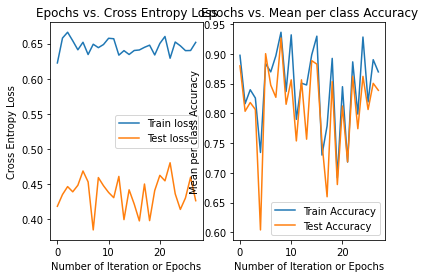

20
training cost: 0.6329752267485
validation cost: 0.4318268690239906
training accuracy: 0.849194729136164
validation accuracy: 0.7771260997067448
time elapsed: 2.7298436000000947
learning rate: 0.001
momentum : 0.5
regularization: 0.9


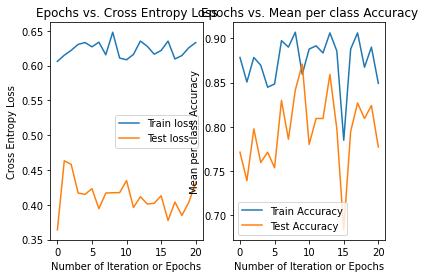

54
training cost: 0.6354553001552256
validation cost: 0.4106861771128077
training accuracy: 0.904099560761347
validation accuracy: 0.8504398826979472
time elapsed: 7.309785654999814
learning rate: 0.001
momentum : 0.5
regularization: 0.9


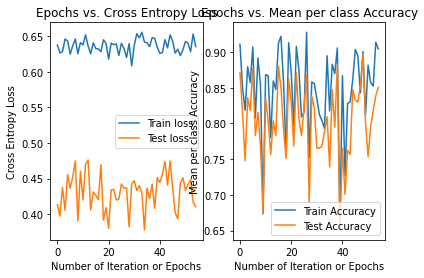

24
training cost: 0.6808299721776722
validation cost: 0.42052490748148835
training accuracy: 0.8975109809663251
validation accuracy: 0.8563049853372434
time elapsed: 3.248194628999954
learning rate: 0.001
momentum : 0.5
regularization: 0.9


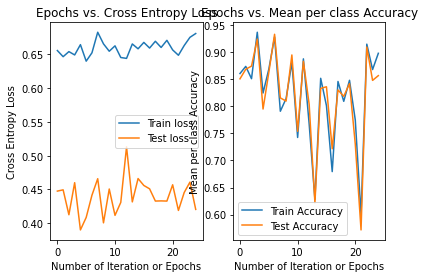

53
training cost: 0.6399776539411303
validation cost: 0.40991659899024185
training accuracy: 0.8894582723279648
validation accuracy: 0.7917888563049853
time elapsed: 7.02051624700016
learning rate: 0.001
momentum : 0.5
regularization: 0.9


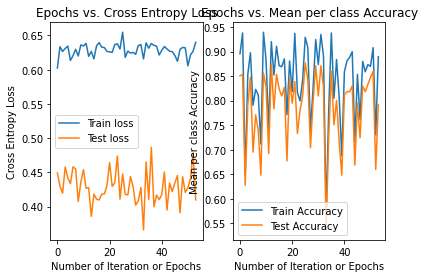

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.8666666666666667
20
training cost: 0.07552705370757215
validation cost: 0.0731567860164657
training accuracy: 0.9875549048316252
validation accuracy: 0.9296187683284457
time elapsed: 0.4359723280003891
learning rate: 0.001
momentum : 0.5
regularization: 0.1


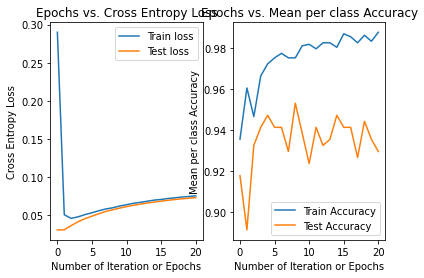

21
training cost: 0.07375915080620889
validation cost: 0.07274924155191305
training accuracy: 0.986090775988287
validation accuracy: 0.9032258064516129
time elapsed: 0.4492857919999551
learning rate: 0.001
momentum : 0.5
regularization: 0.1


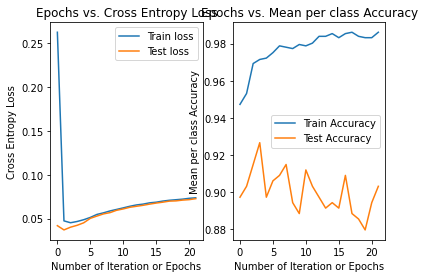

20
training cost: 0.07407391566142651
validation cost: 0.07240449797651788
training accuracy: 0.9853587115666179
validation accuracy: 0.9296187683284457
time elapsed: 0.42878128799975457
learning rate: 0.001
momentum : 0.5
regularization: 0.1


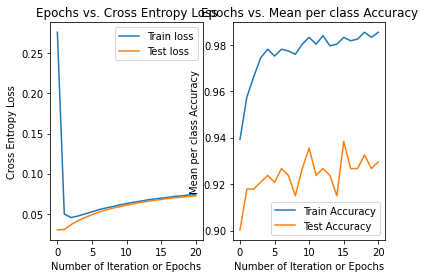

20
training cost: 0.07605461896547827
validation cost: 0.07420322645559921
training accuracy: 0.9809663250366032
validation accuracy: 0.9706744868035191
time elapsed: 0.44272620699985055
learning rate: 0.001
momentum : 0.5
regularization: 0.1


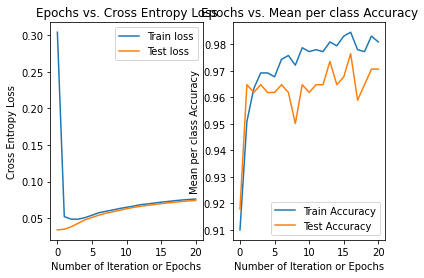

20
training cost: 0.07305533631442251
validation cost: 0.07112750719580428
training accuracy: 0.9897510980966325
validation accuracy: 0.9237536656891495
time elapsed: 0.4162213489998976
learning rate: 0.001
momentum : 0.5
regularization: 0.1


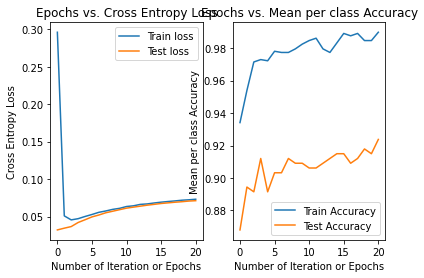

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9333333333333333
20
training cost: 0.18630217847857702
validation cost: 0.1710655880367716
training accuracy: 0.9751098096632503
validation accuracy: 0.9354838709677419
time elapsed: 0.43506668800000625
learning rate: 0.001
momentum : 0.5
regularization: 0.5


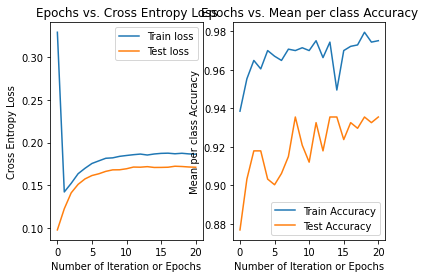

20
training cost: 0.1818432291930469
validation cost: 0.17417275962953044
training accuracy: 0.9765739385065886
validation accuracy: 0.9002932551319648
time elapsed: 0.42167109100000744
learning rate: 0.001
momentum : 0.5
regularization: 0.5


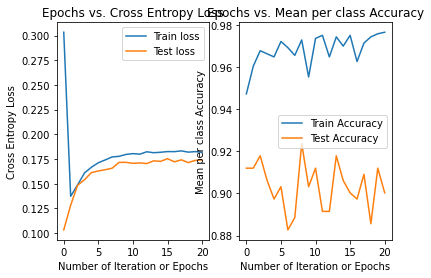

20
training cost: 0.1848072090918352
validation cost: 0.17119595919562877
training accuracy: 0.9751098096632503
validation accuracy: 0.9296187683284457
time elapsed: 0.4366381179997916
learning rate: 0.001
momentum : 0.5
regularization: 0.5


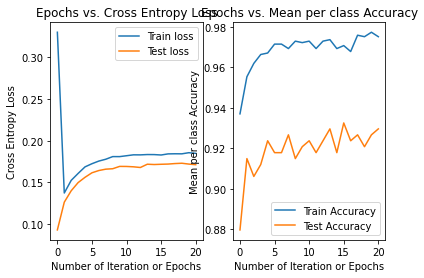

20
training cost: 0.18888826721678378
validation cost: 0.17946619165790428
training accuracy: 0.9663250366032211
validation accuracy: 0.9589442815249267
time elapsed: 0.42092781599967566
learning rate: 0.001
momentum : 0.5
regularization: 0.5


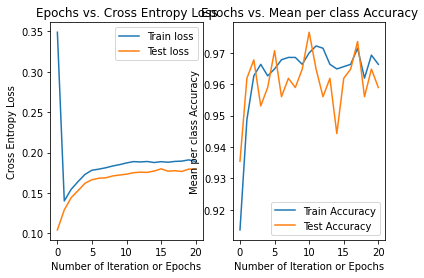

20
training cost: 0.1838077147885724
validation cost: 0.1703207282380505
training accuracy: 0.9765739385065886
validation accuracy: 0.8973607038123167
time elapsed: 0.42779402999985905
learning rate: 0.001
momentum : 0.5
regularization: 0.5


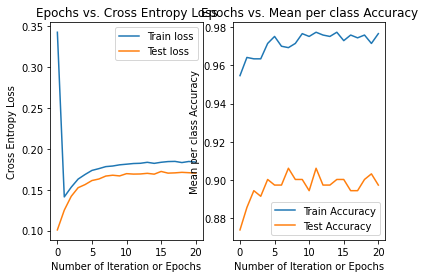

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9222222222222223
20
training cost: 0.253227782989686
validation cost: 0.2262279932833772
training accuracy: 0.9619326500732065
validation accuracy: 0.9178885630498533
time elapsed: 0.4454683379999551
learning rate: 0.001
momentum : 0.5
regularization: 0.9


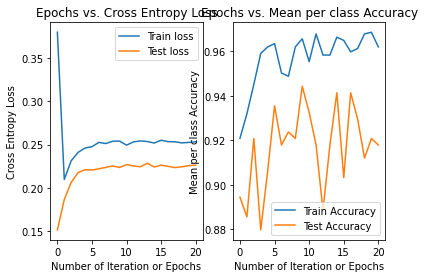

20
training cost: 0.246637986778823
validation cost: 0.23164900985233972
training accuracy: 0.9626647144948756
validation accuracy: 0.9120234604105572
time elapsed: 0.4280434709999099
learning rate: 0.001
momentum : 0.5
regularization: 0.9


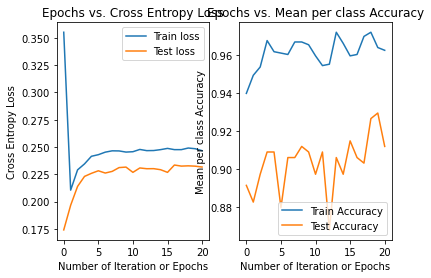

20
training cost: 0.24987027842039375
validation cost: 0.2261811450073321
training accuracy: 0.9677891654465594
validation accuracy: 0.9237536656891495
time elapsed: 0.42510991400013154
learning rate: 0.001
momentum : 0.5
regularization: 0.9


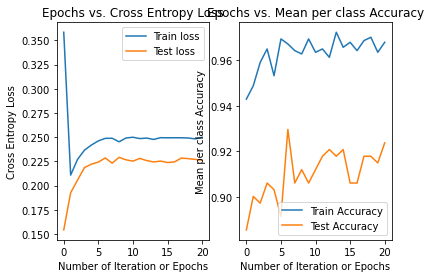

20
training cost: 0.2558855787947521
validation cost: 0.2348935121095522
training accuracy: 0.9655929721815519
validation accuracy: 0.9736070381231672
time elapsed: 0.4320219169999291
learning rate: 0.001
momentum : 0.5
regularization: 0.9


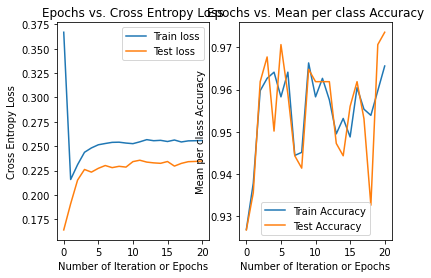

20
training cost: 0.24963760524624926
validation cost: 0.22410469986743606
training accuracy: 0.9692532942898975
validation accuracy: 0.8885630498533724
time elapsed: 0.42450190299996393
learning rate: 0.001
momentum : 0.5
regularization: 0.9


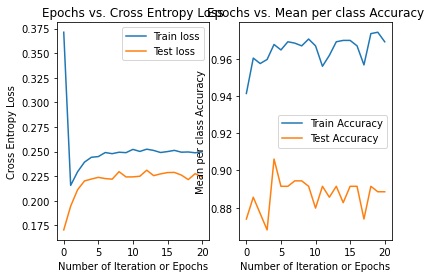

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9222222222222223
30
training cost: 0.039094306308137164
validation cost: 0.03596739608358051
training accuracy: 0.9677891654465594
validation accuracy: 0.9296187683284457
time elapsed: 0.22297700700028145
learning rate: 0.001
momentum : 0.5
regularization: 0.1


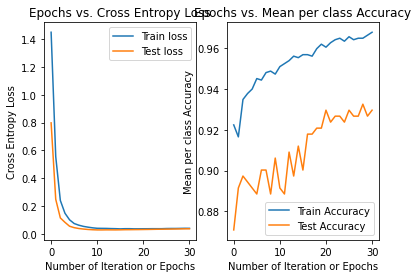

34
training cost: 0.04020656022524709
validation cost: 0.04097988421279089
training accuracy: 0.9699853587115667
validation accuracy: 0.9120234604105572
time elapsed: 0.2589386170002399
learning rate: 0.001
momentum : 0.5
regularization: 0.1


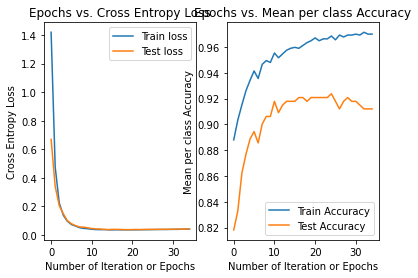

34
training cost: 0.03968475931440559
validation cost: 0.038470732037283406
training accuracy: 0.9699853587115667
validation accuracy: 0.9237536656891495
time elapsed: 0.24773696400006884
learning rate: 0.001
momentum : 0.5
regularization: 0.1


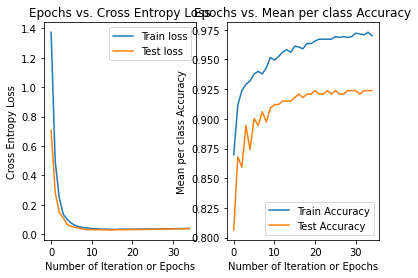

32
training cost: 0.03891656019921387
validation cost: 0.040157301006874785
training accuracy: 0.9663250366032211
validation accuracy: 0.9648093841642229
time elapsed: 0.2290842470001735
learning rate: 0.001
momentum : 0.5
regularization: 0.1


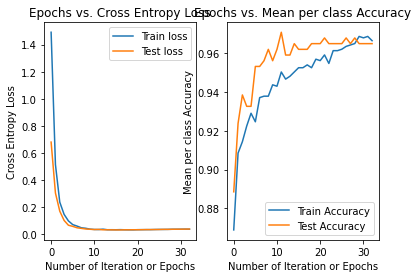

31
training cost: 0.03937025461171005
validation cost: 0.03725576778964463
training accuracy: 0.9714494875549048
validation accuracy: 0.8973607038123167
time elapsed: 0.22687922099976277
learning rate: 0.001
momentum : 0.5
regularization: 0.1


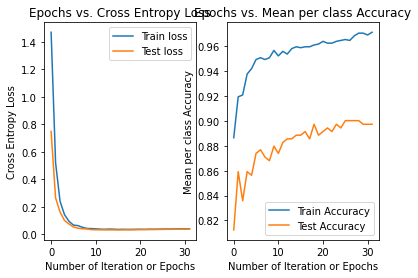

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9222222222222223
26
training cost: 0.13944190548898713
validation cost: 0.132285570262507
training accuracy: 0.9619326500732065
validation accuracy: 0.9325513196480938
time elapsed: 0.1898001380000096
learning rate: 0.001
momentum : 0.5
regularization: 0.5


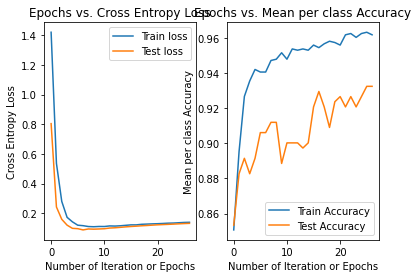

28
training cost: 0.13920881252211098
validation cost: 0.1403271393230425
training accuracy: 0.9663250366032211
validation accuracy: 0.9237536656891495
time elapsed: 0.21454545300002792
learning rate: 0.001
momentum : 0.5
regularization: 0.5


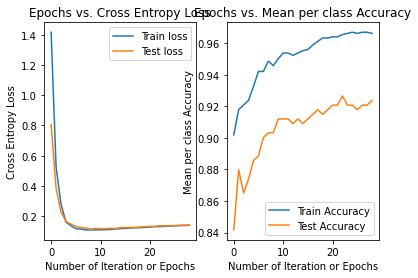

28
training cost: 0.13918391630769175
validation cost: 0.13609818202226265
training accuracy: 0.9685212298682284
validation accuracy: 0.9149560117302052
time elapsed: 0.2087780560000283
learning rate: 0.001
momentum : 0.5
regularization: 0.5


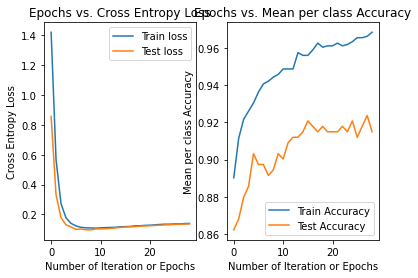

26
training cost: 0.13920615117755442
validation cost: 0.1400078098176681
training accuracy: 0.9604685212298683
validation accuracy: 0.967741935483871
time elapsed: 0.20020756099984283
learning rate: 0.001
momentum : 0.5
regularization: 0.5


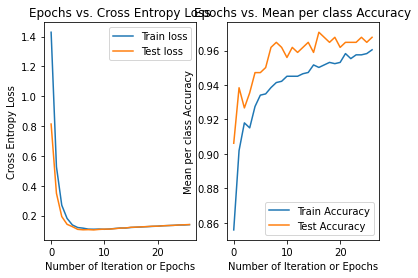

27
training cost: 0.13987756320580397
validation cost: 0.13601241712319023
training accuracy: 0.9663250366032211
validation accuracy: 0.9032258064516129
time elapsed: 0.20358114999999088
learning rate: 0.001
momentum : 0.5
regularization: 0.5


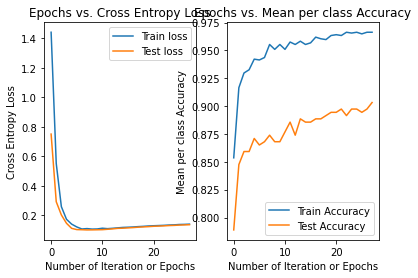

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9111111111111111
25
training cost: 0.20838600893580464
validation cost: 0.19620408211475734
training accuracy: 0.9604685212298683
validation accuracy: 0.9237536656891495
time elapsed: 0.1987624909997976
learning rate: 0.001
momentum : 0.5
regularization: 0.9


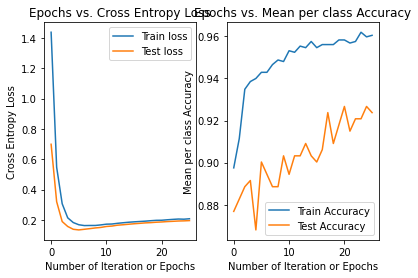

27
training cost: 0.20604709404004615
validation cost: 0.21263118960985103
training accuracy: 0.9663250366032211
validation accuracy: 0.9237536656891495
time elapsed: 0.20312976800005345
learning rate: 0.001
momentum : 0.5
regularization: 0.9


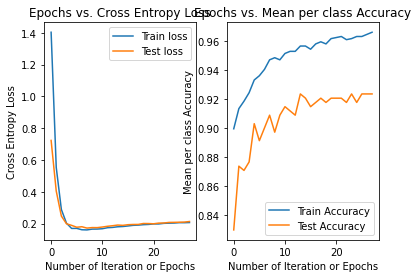

26
training cost: 0.2062275582448046
validation cost: 0.20103311878725783
training accuracy: 0.9604685212298683
validation accuracy: 0.9178885630498533
time elapsed: 0.2000036430004002
learning rate: 0.001
momentum : 0.5
regularization: 0.9


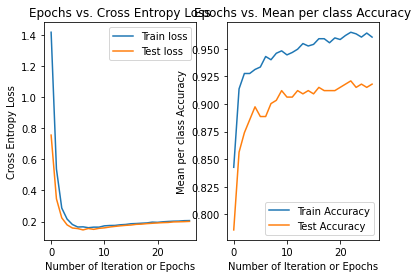

24
training cost: 0.20352246370951152
validation cost: 0.20751470144319645
training accuracy: 0.9553440702781845
validation accuracy: 0.967741935483871
time elapsed: 0.18032072999994853
learning rate: 0.001
momentum : 0.5
regularization: 0.9


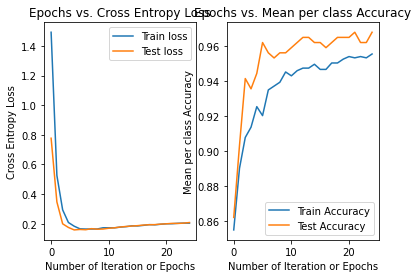

27
training cost: 0.20928079798985927
validation cost: 0.2026363805684505
training accuracy: 0.9633967789165446
validation accuracy: 0.8914956011730205
time elapsed: 0.20725114099968778
learning rate: 0.001
momentum : 0.5
regularization: 0.9


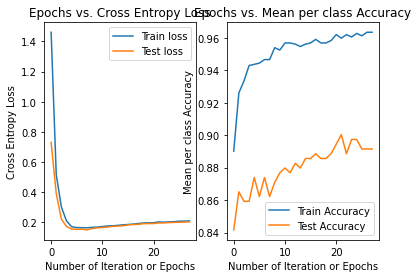

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9222222222222223
33
training cost: 2.3924342732683486
validation cost: 2.115826796301372
training accuracy: 0.7664714494875549
validation accuracy: 0.6950146627565983
time elapsed: 4.544511298000089
learning rate: 0.01
momentum : 0.005
regularization: 0.1


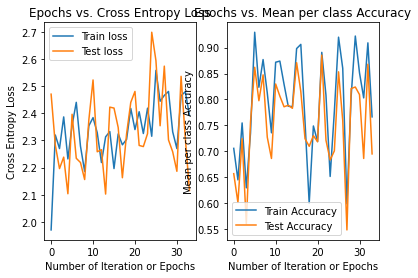

26
training cost: 2.2801106014217902
validation cost: 2.0870866869894384
training accuracy: 0.8550512445095169
validation accuracy: 0.7595307917888563
time elapsed: 3.485291960000268
learning rate: 0.01
momentum : 0.005
regularization: 0.1


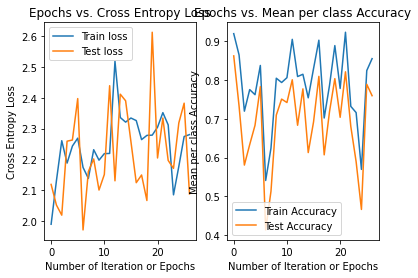

44
training cost: 2.2625499464890027
validation cost: 2.203430007729931
training accuracy: 0.7657393850658858
validation accuracy: 0.7448680351906158
time elapsed: 5.818714602999989
learning rate: 0.01
momentum : 0.005
regularization: 0.1


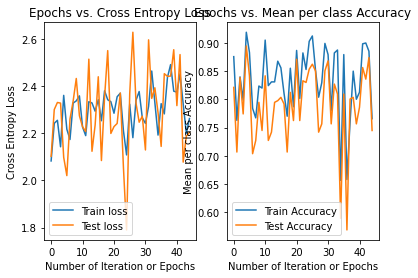

35
training cost: 2.7140139013486126
validation cost: 2.334873905694764
training accuracy: 0.9070278184480234
validation accuracy: 0.8856304985337243
time elapsed: 4.660209788999964
learning rate: 0.01
momentum : 0.005
regularization: 0.1


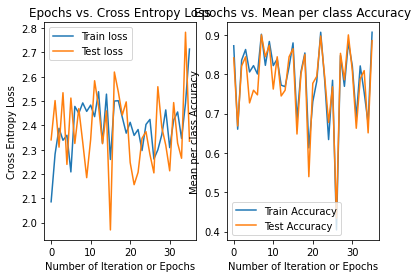

68
training cost: 2.2759991616606166
validation cost: 2.4689905834779653
training accuracy: 0.9011713030746705
validation accuracy: 0.841642228739003
time elapsed: 9.091594867999902
learning rate: 0.01
momentum : 0.005
regularization: 0.1


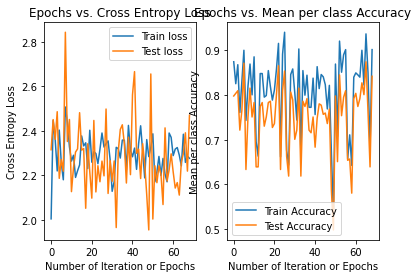

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.8222222222222222
38
training cost: 4.433531325489498
validation cost: 4.460434526321701
training accuracy: 0.8228404099560761
validation accuracy: 0.8563049853372434
time elapsed: 5.06240086400021
learning rate: 0.01
momentum : 0.005
regularization: 0.5


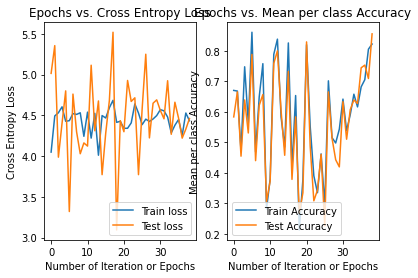

44
training cost: 4.4595558417229935
validation cost: 4.742490878416731
training accuracy: 0.5585651537335286
validation accuracy: 0.5219941348973607
time elapsed: 6.046999156999846
learning rate: 0.01
momentum : 0.005
regularization: 0.5


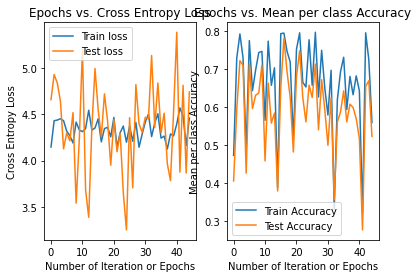

29
training cost: 4.742676237723629
validation cost: 5.161178397392027
training accuracy: 0.47218155197657397
validation accuracy: 0.41055718475073316
time elapsed: 3.988082305000262
learning rate: 0.01
momentum : 0.005
regularization: 0.5


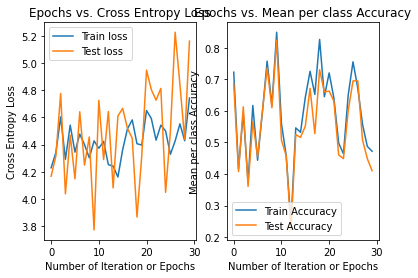

29
training cost: 4.650897664511024
validation cost: 4.467777390332649
training accuracy: 0.5505124450951684
validation accuracy: 0.6041055718475073
time elapsed: 3.8832796310002777
learning rate: 0.01
momentum : 0.005
regularization: 0.5


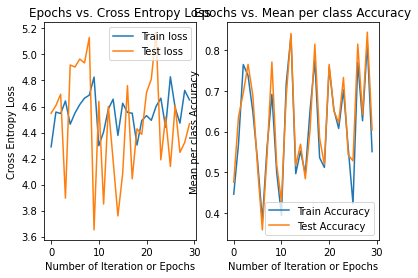

43
training cost: 4.458146754005652
validation cost: 4.7275866675996125
training accuracy: 0.45095168374816985
validation accuracy: 0.41642228739002934
time elapsed: 5.719213663000119
learning rate: 0.01
momentum : 0.005
regularization: 0.5


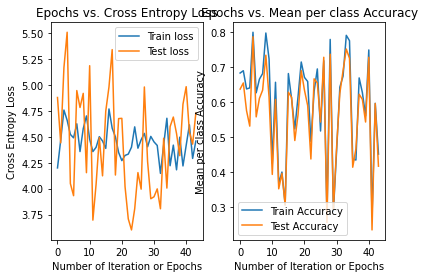

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.5555555555555556
20
training cost: 5.36223048355125
validation cost: 6.624985374955912
training accuracy: 0.3089311859443631
validation accuracy: 0.3782991202346041
time elapsed: 2.9282332630000383
learning rate: 0.01
momentum : 0.005
regularization: 0.9


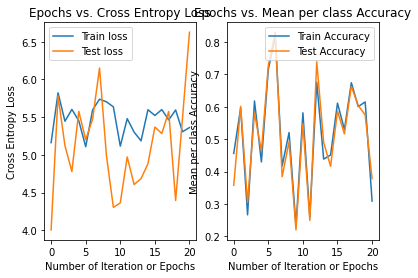

60
training cost: 5.654994219850789
validation cost: 5.679694540659803
training accuracy: 0.46193265007320644
validation accuracy: 0.3724340175953079
time elapsed: 8.089220332999957
learning rate: 0.01
momentum : 0.005
regularization: 0.9


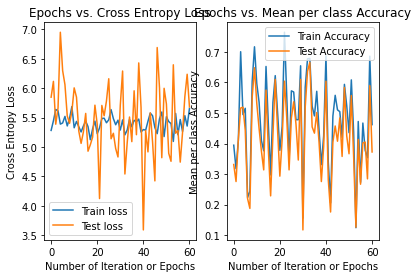

44
training cost: 5.450309799309988
validation cost: 4.873155756752735
training accuracy: 0.6537335285505125
validation accuracy: 0.6099706744868035
time elapsed: 5.964030659999935
learning rate: 0.01
momentum : 0.005
regularization: 0.9


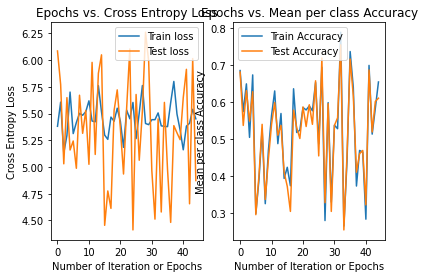

68
training cost: 5.422297281607186
validation cost: 5.067304221668208
training accuracy: 0.3440702781844802
validation accuracy: 0.41642228739002934
time elapsed: 8.947819865999918
learning rate: 0.01
momentum : 0.005
regularization: 0.9


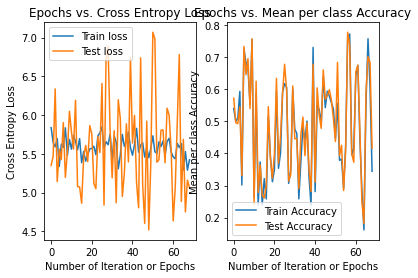

58
training cost: 5.654589711235547
validation cost: 4.3306255175098425
training accuracy: 0.4890190336749634
validation accuracy: 0.4780058651026393
time elapsed: 7.675904455999898
learning rate: 0.01
momentum : 0.005
regularization: 0.9


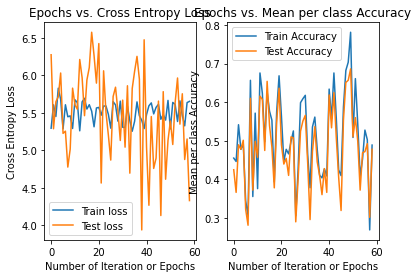

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.4777777777777778
20
training cost: 0.11458053353214519
validation cost: 0.11506528975719106
training accuracy: 0.9699853587115667
validation accuracy: 0.9296187683284457
time elapsed: 0.4267287409998062
learning rate: 0.01
momentum : 0.005
regularization: 0.1


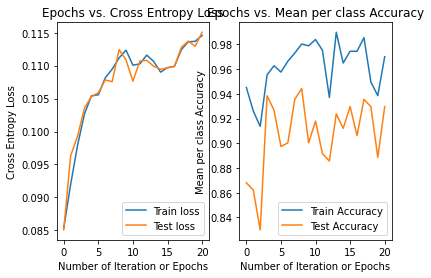

20
training cost: 0.11398103894337393
validation cost: 0.11276042991632106
training accuracy: 0.9575402635431918
validation accuracy: 0.8504398826979472
time elapsed: 0.44793348800021704
learning rate: 0.01
momentum : 0.005
regularization: 0.1


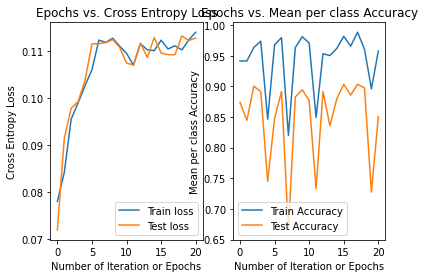

20
training cost: 0.109535197784054
validation cost: 0.11085949799119675
training accuracy: 0.972181551976574
validation accuracy: 0.9002932551319648
time elapsed: 0.45068954099997427
learning rate: 0.01
momentum : 0.005
regularization: 0.1


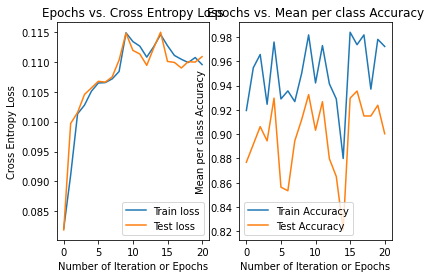

20
training cost: 0.11895617151504359
validation cost: 0.11770079130765657
training accuracy: 0.9816983894582724
validation accuracy: 0.9560117302052786
time elapsed: 0.43782535200034545
learning rate: 0.01
momentum : 0.005
regularization: 0.1


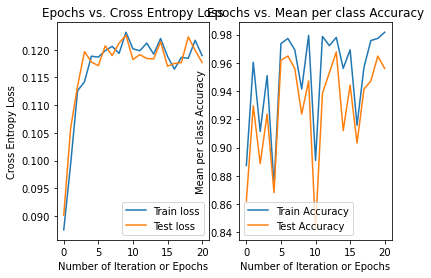

20
training cost: 0.10517225001750928
validation cost: 0.10447922021171283
training accuracy: 0.9655929721815519
validation accuracy: 0.8885630498533724
time elapsed: 0.4211873179997383
learning rate: 0.01
momentum : 0.005
regularization: 0.1


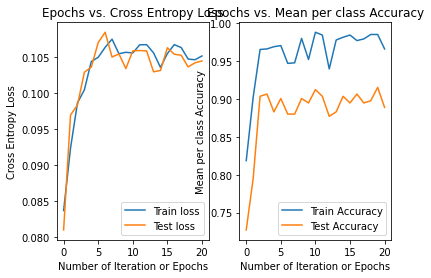

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9222222222222223
22
training cost: 0.2708091772086955
validation cost: 0.2916010900967723
training accuracy: 0.91800878477306
validation accuracy: 0.9002932551319648
time elapsed: 0.4696881439999743
learning rate: 0.01
momentum : 0.005
regularization: 0.5


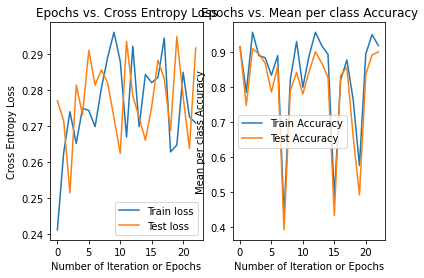

50
training cost: 0.2456111851751467
validation cost: 0.24779870196201467
training accuracy: 0.6185944363103953
validation accuracy: 0.5161290322580645
time elapsed: 1.0300401409999722
learning rate: 0.01
momentum : 0.005
regularization: 0.5


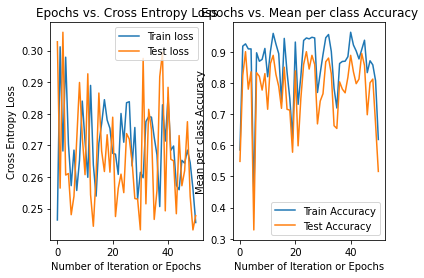

35
training cost: 0.29106688364468924
validation cost: 0.2993921654273584
training accuracy: 0.9443631039531479
validation accuracy: 0.8680351906158358
time elapsed: 0.7345162730002812
learning rate: 0.01
momentum : 0.005
regularization: 0.5


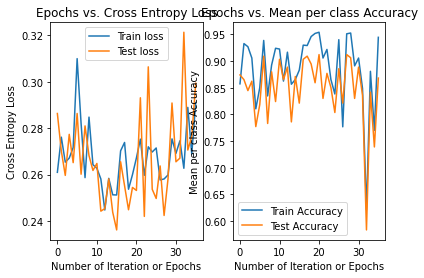

27
training cost: 0.309247391783234
validation cost: 0.27171760856090005
training accuracy: 0.7693997071742313
validation accuracy: 0.7712609970674487
time elapsed: 0.6448352080001314
learning rate: 0.01
momentum : 0.005
regularization: 0.5


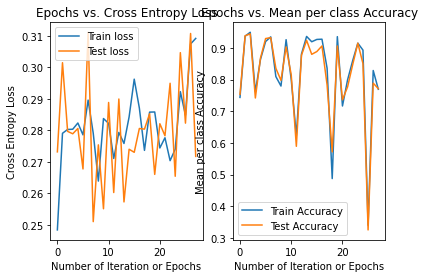

21
training cost: 0.2630388873871018
validation cost: 0.267463262793713
training accuracy: 0.5512445095168375
validation accuracy: 0.5601173020527859
time elapsed: 0.44870618599998124
learning rate: 0.01
momentum : 0.005
regularization: 0.5


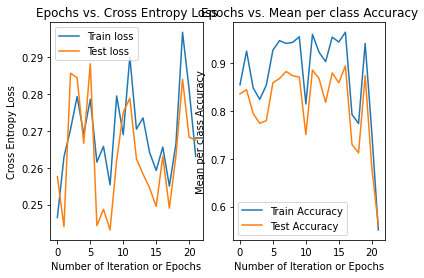

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.6222222222222222
24
training cost: 0.4074794527577645
validation cost: 0.42913295208426594
training accuracy: 0.8323572474377745
validation accuracy: 0.7888563049853372
time elapsed: 0.5209951179999734
learning rate: 0.01
momentum : 0.005
regularization: 0.9


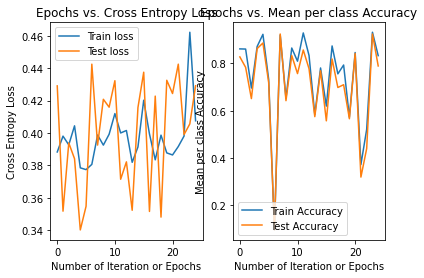

24
training cost: 0.37661308063869414
validation cost: 0.3686404400515414
training accuracy: 0.83601756954612
validation accuracy: 0.7243401759530792
time elapsed: 0.5077487080002356
learning rate: 0.01
momentum : 0.005
regularization: 0.9


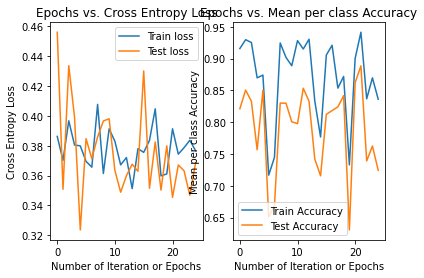

20
training cost: 0.37995307296312153
validation cost: 0.38614649879218554
training accuracy: 0.9472913616398243
validation accuracy: 0.8856304985337243
time elapsed: 0.454882606999945
learning rate: 0.01
momentum : 0.005
regularization: 0.9


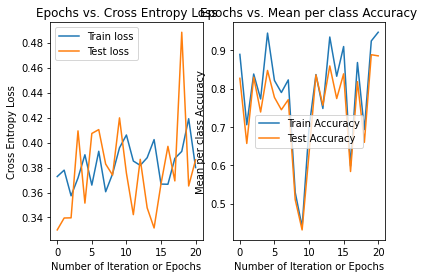

39
training cost: 0.3998860262222246
validation cost: 0.4010204306776367
training accuracy: 0.4663250366032211
validation accuracy: 0.44574780058651026
time elapsed: 0.817275907000294
learning rate: 0.01
momentum : 0.005
regularization: 0.9


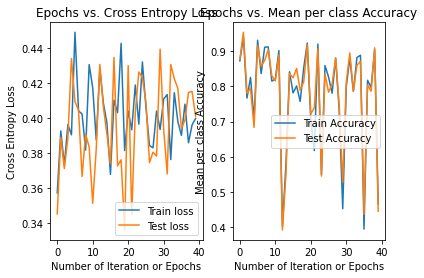

52
training cost: 0.3919668537404109
validation cost: 0.38255563527475905
training accuracy: 0.8330893118594437
validation accuracy: 0.7536656891495601
time elapsed: 1.0812625389999084
learning rate: 0.01
momentum : 0.005
regularization: 0.9


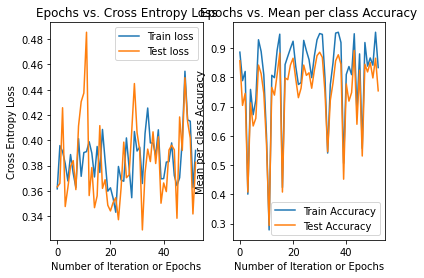

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.8
21
training cost: 0.061918535072986496
validation cost: 0.061452139673065495
training accuracy: 0.9824304538799414
validation accuracy: 0.9354838709677419
time elapsed: 0.17215412999985347
learning rate: 0.01
momentum : 0.005
regularization: 0.1


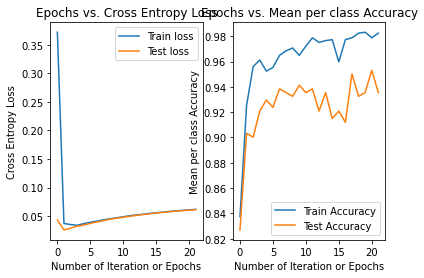

21
training cost: 0.060331965353168406
validation cost: 0.06146197570127391
training accuracy: 0.9831625183016105
validation accuracy: 0.9120234604105572
time elapsed: 0.164474188999975
learning rate: 0.01
momentum : 0.005
regularization: 0.1


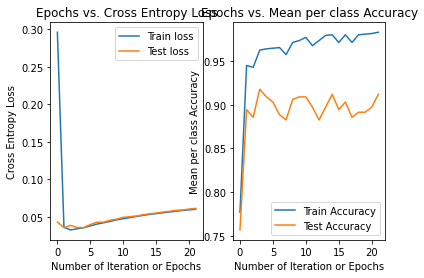

20
training cost: 0.060102219717344064
validation cost: 0.06030096838119322
training accuracy: 0.9787701317715959
validation accuracy: 0.9266862170087976
time elapsed: 0.16451165799981027
learning rate: 0.01
momentum : 0.005
regularization: 0.1


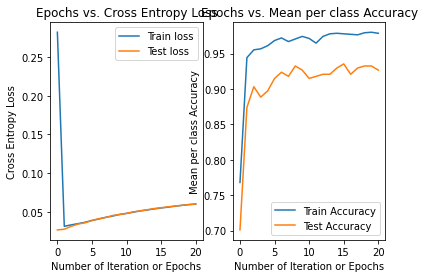

20
training cost: 0.06174538505135862
validation cost: 0.061702637229025914
training accuracy: 0.9809663250366032
validation accuracy: 0.967741935483871
time elapsed: 0.15029829400009476
learning rate: 0.01
momentum : 0.005
regularization: 0.1


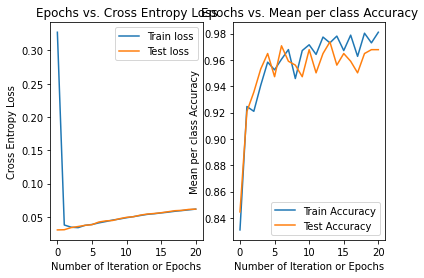

20
training cost: 0.060123424471282265
validation cost: 0.05991559523014089
training accuracy: 0.9846266471449487
validation accuracy: 0.9120234604105572
time elapsed: 0.16069717300024422
learning rate: 0.01
momentum : 0.005
regularization: 0.1


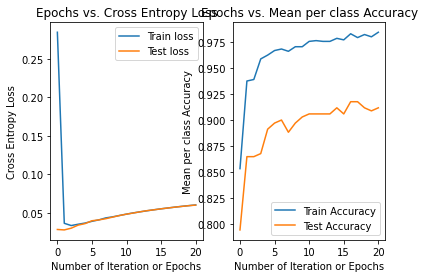

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9222222222222223
20
training cost: 0.17371567334464189
validation cost: 0.16854346604085485
training accuracy: 0.9743777452415813
validation accuracy: 0.9237536656891495
time elapsed: 0.1532881200000702
learning rate: 0.01
momentum : 0.005
regularization: 0.5


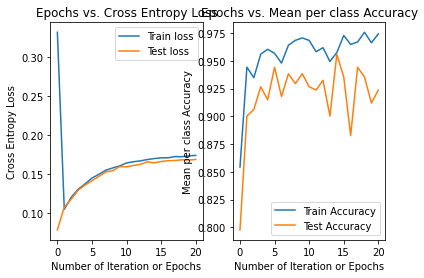

20
training cost: 0.17022015863743975
validation cost: 0.16898142828554566
training accuracy: 0.9677891654465594
validation accuracy: 0.9002932551319648
time elapsed: 0.16356595999968704
learning rate: 0.01
momentum : 0.005
regularization: 0.5


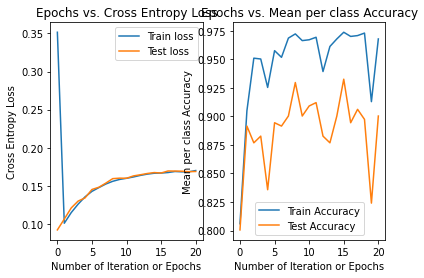

21
training cost: 0.17001991409760112
validation cost: 0.16841337910904874
training accuracy: 0.9648609077598829
validation accuracy: 0.9208211143695014
time elapsed: 0.15667182100014543
learning rate: 0.01
momentum : 0.005
regularization: 0.5


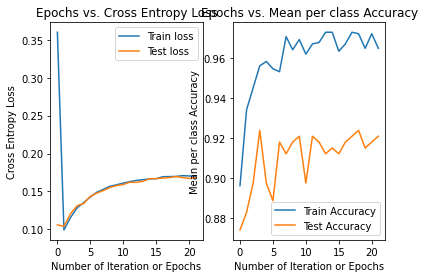

20
training cost: 0.1742825370090453
validation cost: 0.1746189612664883
training accuracy: 0.9743777452415813
validation accuracy: 0.9648093841642229
time elapsed: 0.15352741000015158
learning rate: 0.01
momentum : 0.005
regularization: 0.5


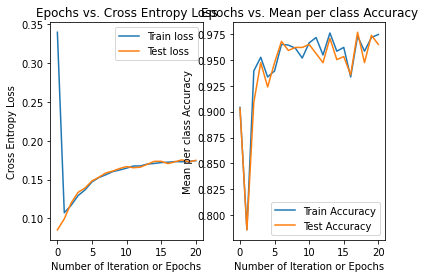

20
training cost: 0.1702287840330861
validation cost: 0.16698346031430567
training accuracy: 0.9714494875549048
validation accuracy: 0.9002932551319648
time elapsed: 0.16199929300000804
learning rate: 0.01
momentum : 0.005
regularization: 0.5


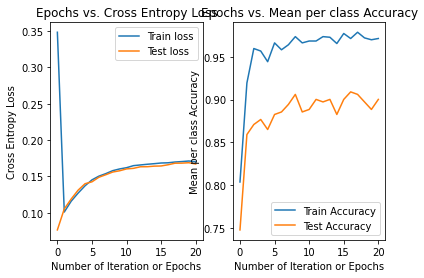

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.8888888888888888
20
training cost: 0.2330565134813824
validation cost: 0.22690969237974645
training accuracy: 0.958272327964861
validation accuracy: 0.9501466275659824
time elapsed: 0.15429762399980973
learning rate: 0.01
momentum : 0.005
regularization: 0.9


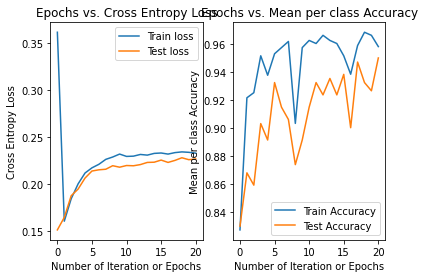

20
training cost: 0.22718226164115451
validation cost: 0.2262381218413605
training accuracy: 0.9370424597364568
validation accuracy: 0.8914956011730205
time elapsed: 0.15922933699994246
learning rate: 0.01
momentum : 0.005
regularization: 0.9


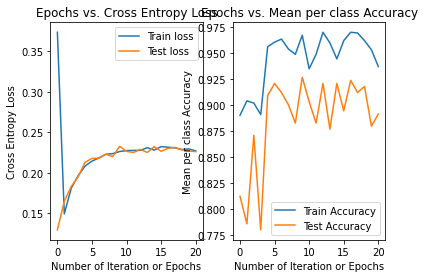

20
training cost: 0.23045372683096257
validation cost: 0.2281330565510364
training accuracy: 0.9597364568081991
validation accuracy: 0.9149560117302052
time elapsed: 0.1553972149999936
learning rate: 0.01
momentum : 0.005
regularization: 0.9


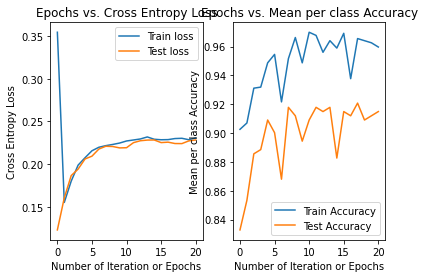

20
training cost: 0.2372296567934436
validation cost: 0.22683515901257736
training accuracy: 0.8843338213762811
validation accuracy: 0.9090909090909091
time elapsed: 0.15079426800002693
learning rate: 0.01
momentum : 0.005
regularization: 0.9


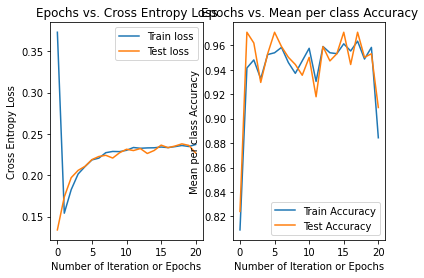

20
training cost: 0.2302332575744011
validation cost: 0.22583830241809977
training accuracy: 0.9604685212298683
validation accuracy: 0.8885630498533724
time elapsed: 0.14737425300018003
learning rate: 0.01
momentum : 0.005
regularization: 0.9


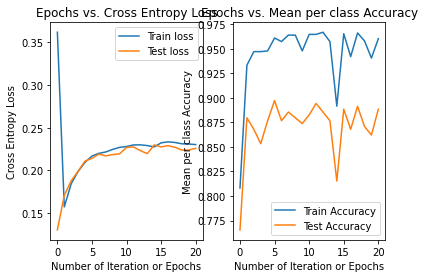

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9111111111111111
59
training cost: 2.6247651411051107
validation cost: 2.3611495869841024
training accuracy: 0.9092240117130308
validation accuracy: 0.8563049853372434
time elapsed: 7.935071136000261
learning rate: 0.01
momentum : 0.05
regularization: 0.1


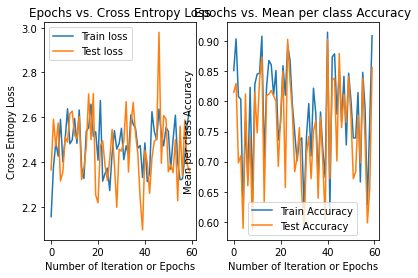

26
training cost: 2.314196585004629
validation cost: 2.1535607930356373
training accuracy: 0.6207906295754027
validation accuracy: 0.4662756598240469
time elapsed: 3.4911104639995756
learning rate: 0.01
momentum : 0.05
regularization: 0.1


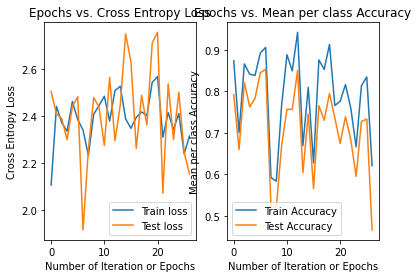

35
training cost: 2.4227943055089023
validation cost: 2.2557188526371506
training accuracy: 0.7664714494875549
validation accuracy: 0.7272727272727273
time elapsed: 4.658623344999796
learning rate: 0.01
momentum : 0.05
regularization: 0.1


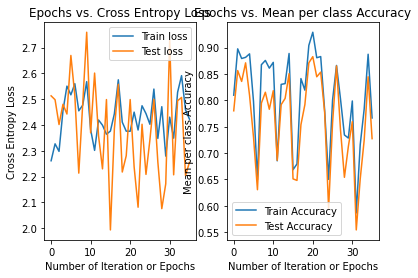

39
training cost: 2.544378565712545
validation cost: 2.252466327129795
training accuracy: 0.7825768667642753
validation accuracy: 0.8475073313782991
time elapsed: 5.269975237999915
learning rate: 0.01
momentum : 0.05
regularization: 0.1


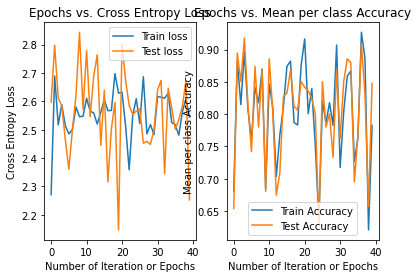

35
training cost: 2.3422786021305293
validation cost: 2.5759700538471058
training accuracy: 0.8206442166910688
validation accuracy: 0.7771260997067448
time elapsed: 4.711852705000183
learning rate: 0.01
momentum : 0.05
regularization: 0.1


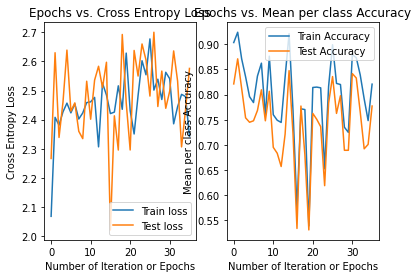

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.7
21
training cost: 4.567465148361399
validation cost: 4.3067773716110285
training accuracy: 0.6427525622254758
validation accuracy: 0.6480938416422287
time elapsed: 2.825936626999919
learning rate: 0.01
momentum : 0.05
regularization: 0.5


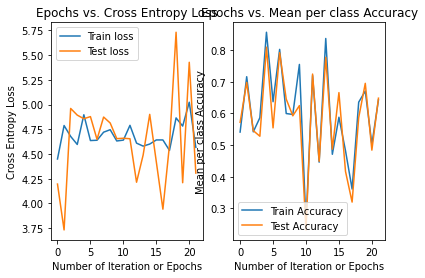

54
training cost: 4.811894817953893
validation cost: 4.16306011359981
training accuracy: 0.6273792093704246
validation accuracy: 0.5806451612903226
time elapsed: 7.201973157999873
learning rate: 0.01
momentum : 0.05
regularization: 0.5


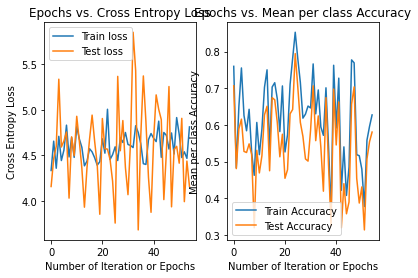

24
training cost: 4.704524611084048
validation cost: 4.5355054701249635
training accuracy: 0.47364568081991215
validation accuracy: 0.4868035190615836
time elapsed: 3.2351975999999922
learning rate: 0.01
momentum : 0.05
regularization: 0.5


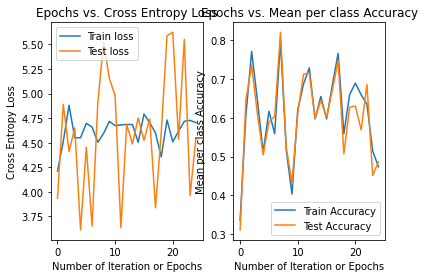

35
training cost: 4.59289454252984
validation cost: 4.724018677301496
training accuracy: 0.6244509516837482
validation accuracy: 0.624633431085044
time elapsed: 4.815773748000083
learning rate: 0.01
momentum : 0.05
regularization: 0.5


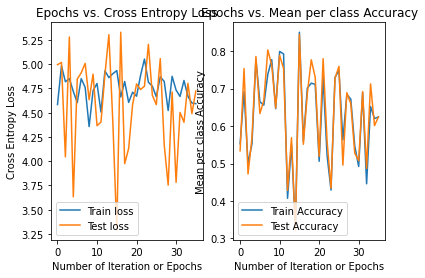

26
training cost: 4.749704713073355
validation cost: 5.238424390706467
training accuracy: 0.7906295754026355
validation accuracy: 0.6832844574780058
time elapsed: 3.6560715020000316
learning rate: 0.01
momentum : 0.05
regularization: 0.5


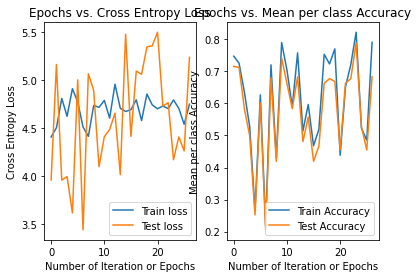

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.7555555555555555
27
training cost: 5.69746469355722
validation cost: 4.957959876412509
training accuracy: 0.48243045387994143
validation accuracy: 0.4252199413489736
time elapsed: 3.7107836380000663
learning rate: 0.01
momentum : 0.05
regularization: 0.9


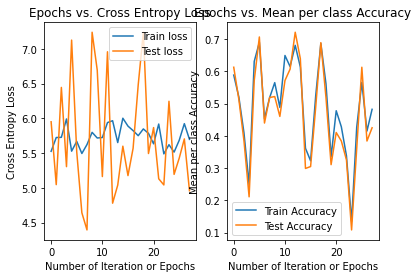

23
training cost: 5.614204047222952
validation cost: 5.928170910664745
training accuracy: 0.49414348462664714
validation accuracy: 0.41348973607038125
time elapsed: 3.2100822639999933
learning rate: 0.01
momentum : 0.05
regularization: 0.9


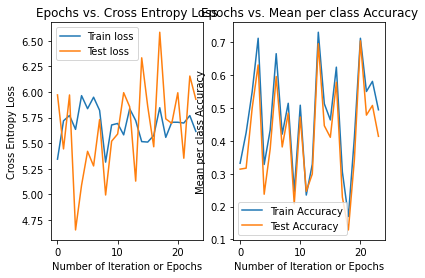

22
training cost: 5.812291974004334
validation cost: 5.4232722282409105
training accuracy: 0.40995607613469986
validation accuracy: 0.4662756598240469
time elapsed: 2.97574125500023
learning rate: 0.01
momentum : 0.05
regularization: 0.9


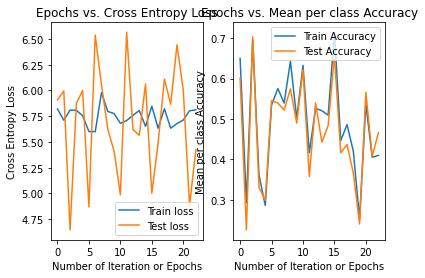

35
training cost: 5.820480946359694
validation cost: 5.548811627512582
training accuracy: 0.5856515373352855
validation accuracy: 0.5571847507331378
time elapsed: 4.648800736999874
learning rate: 0.01
momentum : 0.05
regularization: 0.9


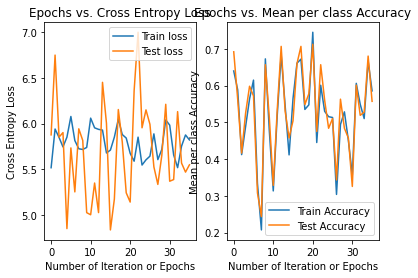

21
training cost: 5.927164347010052
validation cost: 4.99103049312674
training accuracy: 0.7847730600292826
validation accuracy: 0.7096774193548387
time elapsed: 2.8270244810000804
learning rate: 0.01
momentum : 0.05
regularization: 0.9


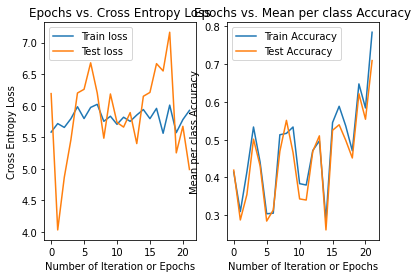

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.6111111111111112
20
training cost: 0.11899666023258272
validation cost: 0.1179113073286231
training accuracy: 0.9407027818448024
validation accuracy: 0.8328445747800587
time elapsed: 0.43650042900026165
learning rate: 0.01
momentum : 0.05
regularization: 0.1


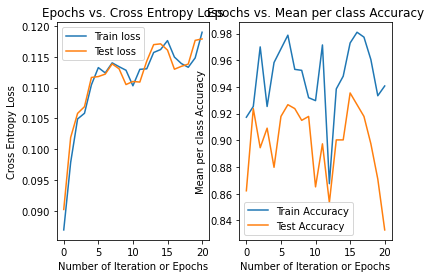

20
training cost: 0.11138969524645986
validation cost: 0.11334110576022066
training accuracy: 0.9685212298682284
validation accuracy: 0.8826979472140762
time elapsed: 0.4268783990000884
learning rate: 0.01
momentum : 0.05
regularization: 0.1


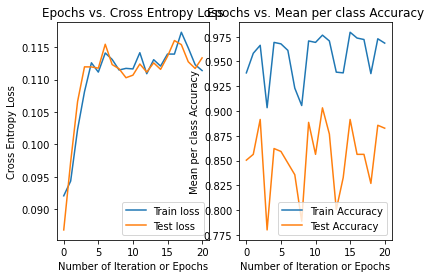

20
training cost: 0.11629594462765731
validation cost: 0.11921687859588295
training accuracy: 0.5505124450951684
validation accuracy: 0.49266862170087977
time elapsed: 0.44819023199988806
learning rate: 0.01
momentum : 0.05
regularization: 0.1


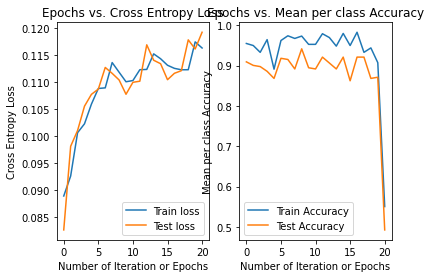

20
training cost: 0.11991431472553651
validation cost: 0.12349290031316162
training accuracy: 0.9699853587115667
validation accuracy: 0.9530791788856305
time elapsed: 0.4303374679998342
learning rate: 0.01
momentum : 0.05
regularization: 0.1


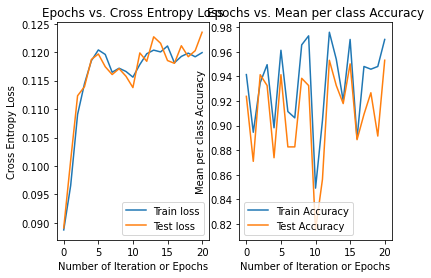

20
training cost: 0.10544365392516973
validation cost: 0.10533195290969052
training accuracy: 0.9780380673499268
validation accuracy: 0.906158357771261
time elapsed: 0.43292436399997314
learning rate: 0.01
momentum : 0.05
regularization: 0.1


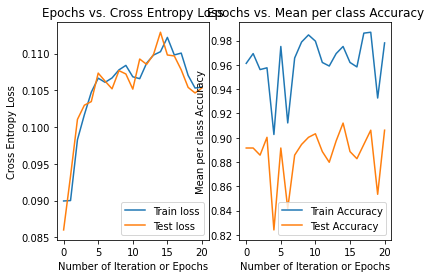

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9222222222222223
27
training cost: 0.2975810261830005
validation cost: 0.26558323837081116
training accuracy: 0.821376281112738
validation accuracy: 0.7302052785923754
time elapsed: 0.5701672320001308
learning rate: 0.01
momentum : 0.05
regularization: 0.5


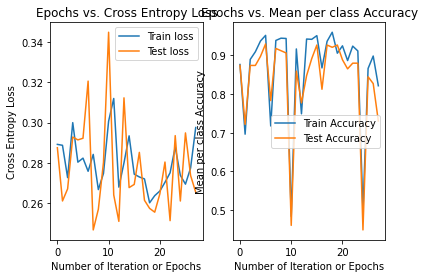

45
training cost: 0.2705288968843676
validation cost: 0.2454464386766037
training accuracy: 0.9260614934114202
validation accuracy: 0.8328445747800587
time elapsed: 0.9506353599999784
learning rate: 0.01
momentum : 0.05
regularization: 0.5


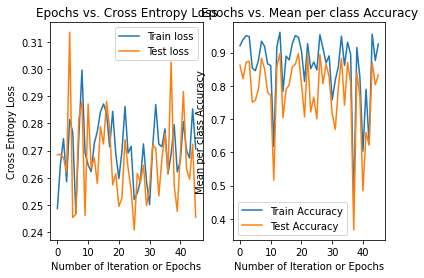

22
training cost: 0.27898345382026396
validation cost: 0.2804745147129203
training accuracy: 0.8265007320644217
validation accuracy: 0.8240469208211144
time elapsed: 0.47330940900019414
learning rate: 0.01
momentum : 0.05
regularization: 0.5


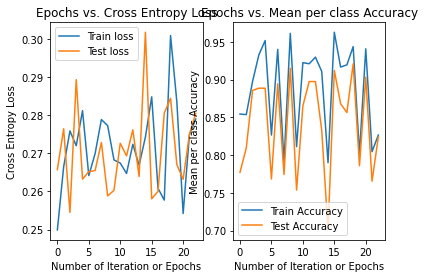

22
training cost: 0.277893404592075
validation cost: 0.27186694126963645
training accuracy: 0.6200585651537335
validation accuracy: 0.6070381231671554
time elapsed: 0.4755545450002501
learning rate: 0.01
momentum : 0.05
regularization: 0.5


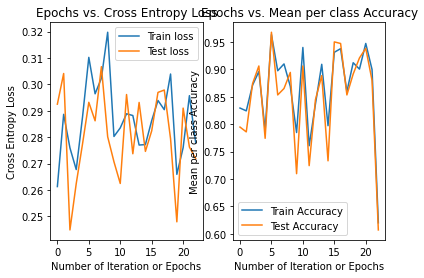

22
training cost: 0.2812268752975033
validation cost: 0.27155255071770107
training accuracy: 0.7174231332357247
validation accuracy: 0.6686217008797654
time elapsed: 0.4747251859998869
learning rate: 0.01
momentum : 0.05
regularization: 0.5


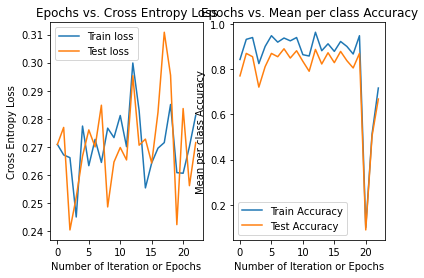

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.6777777777777778
34
training cost: 0.37435684063875063
validation cost: 0.3835533781735247
training accuracy: 0.8323572474377745
validation accuracy: 0.8269794721407625
time elapsed: 0.718916236000041
learning rate: 0.01
momentum : 0.05
regularization: 0.9


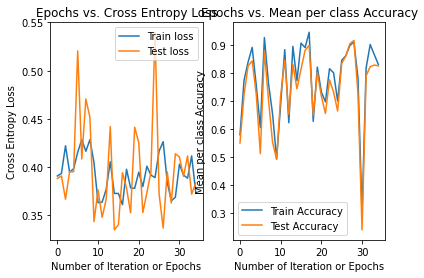

22
training cost: 0.4081204000379587
validation cost: 0.3401800621071172
training accuracy: 0.9392386530014641
validation accuracy: 0.8357771260997068
time elapsed: 0.4765866130001086
learning rate: 0.01
momentum : 0.05
regularization: 0.9


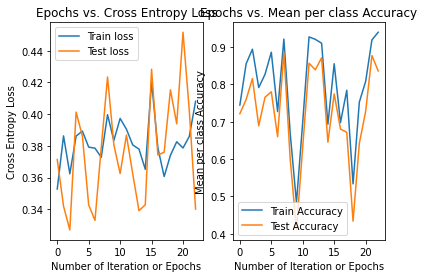

40
training cost: 0.39198842830223934
validation cost: 0.4155547828911928
training accuracy: 0.8682284040995608
validation accuracy: 0.8269794721407625
time elapsed: 0.8346162610000647
learning rate: 0.01
momentum : 0.05
regularization: 0.9


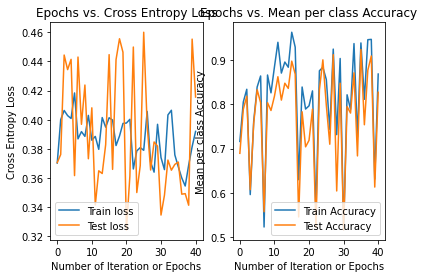

61
training cost: 0.42725647480919887
validation cost: 0.4635706093364712
training accuracy: 0.8023426061493412
validation accuracy: 0.7565982404692082
time elapsed: 1.265987252999821
learning rate: 0.01
momentum : 0.05
regularization: 0.9


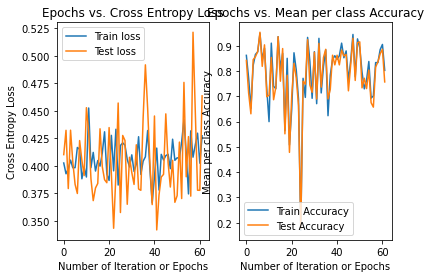

30
training cost: 0.41559811842103367
validation cost: 0.41308753401107806
training accuracy: 0.9355783308931186
validation accuracy: 0.8533724340175953
time elapsed: 0.6232975989996703
learning rate: 0.01
momentum : 0.05
regularization: 0.9


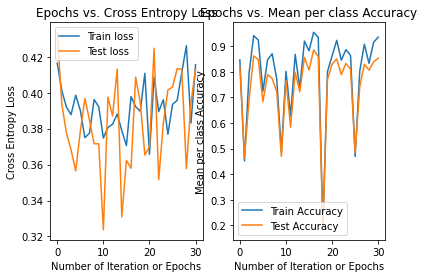

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.8555555555555555
20
training cost: 0.06206979299233192
validation cost: 0.06164425820234036
training accuracy: 0.9816983894582724
validation accuracy: 0.9384164222873901
time elapsed: 0.16079938499979107
learning rate: 0.01
momentum : 0.05
regularization: 0.1


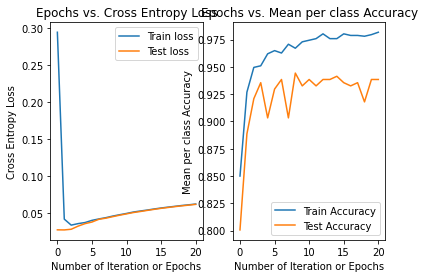

20
training cost: 0.06028793195757891
validation cost: 0.060958042308723176
training accuracy: 0.9824304538799414
validation accuracy: 0.8944281524926686
time elapsed: 0.15958634299977348
learning rate: 0.01
momentum : 0.05
regularization: 0.1


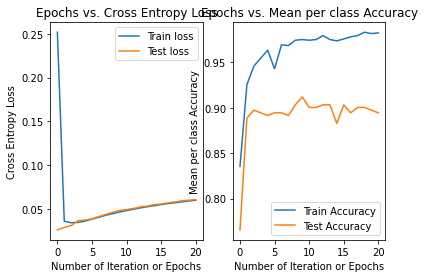

22
training cost: 0.062474708578805174
validation cost: 0.06257345179761219
training accuracy: 0.972913616398243
validation accuracy: 0.9237536656891495
time elapsed: 0.16493846200000917
learning rate: 0.01
momentum : 0.05
regularization: 0.1


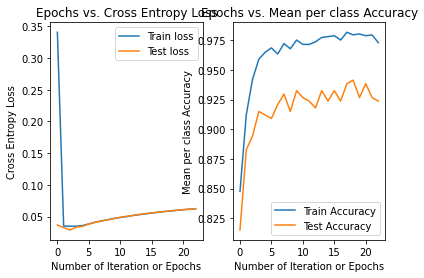

20
training cost: 0.062295319595091665
validation cost: 0.06254314311239213
training accuracy: 0.9758418740849195
validation accuracy: 0.9530791788856305
time elapsed: 0.16664901800004372
learning rate: 0.01
momentum : 0.05
regularization: 0.1


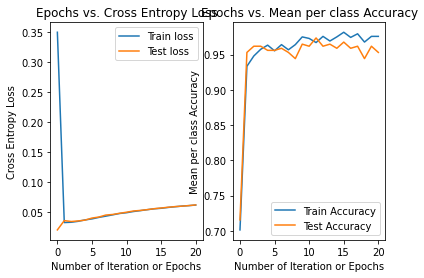

21
training cost: 0.06170449995887074
validation cost: 0.061665805370013725
training accuracy: 0.9838945827232797
validation accuracy: 0.9090909090909091
time elapsed: 0.16037996199975169
learning rate: 0.01
momentum : 0.05
regularization: 0.1


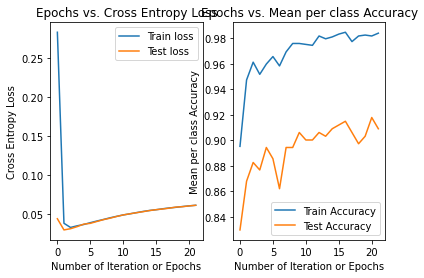

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9333333333333333
20
training cost: 0.17397773966012217
validation cost: 0.16826733471526614
training accuracy: 0.9648609077598829
validation accuracy: 0.9413489736070382
time elapsed: 0.16796853400001055
learning rate: 0.01
momentum : 0.05
regularization: 0.5


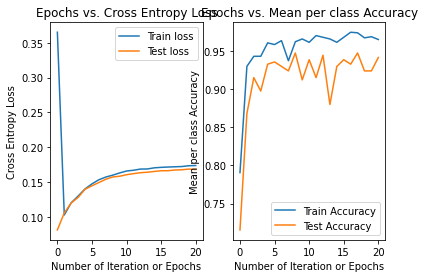

20
training cost: 0.16887868148881666
validation cost: 0.16745593667182318
training accuracy: 0.9743777452415813
validation accuracy: 0.9090909090909091
time elapsed: 0.15794366799991622
learning rate: 0.01
momentum : 0.05
regularization: 0.5


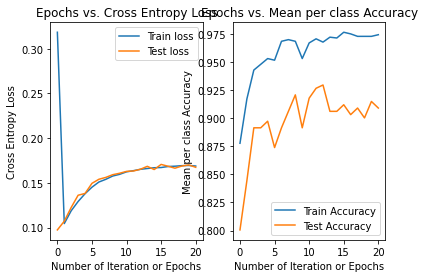

20
training cost: 0.17050434417319513
validation cost: 0.16969414008688918
training accuracy: 0.9699853587115667
validation accuracy: 0.9178885630498533
time elapsed: 0.15761204499995074
learning rate: 0.01
momentum : 0.05
regularization: 0.5


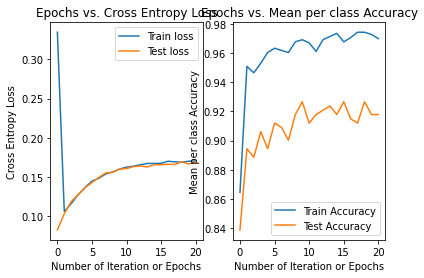

20
training cost: 0.17518766120460466
validation cost: 0.1725288824078235
training accuracy: 0.972181551976574
validation accuracy: 0.9530791788856305
time elapsed: 0.1549716750000698
learning rate: 0.01
momentum : 0.05
regularization: 0.5


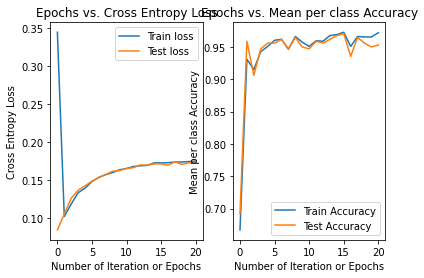

20
training cost: 0.17172726586255757
validation cost: 0.16819480579360488
training accuracy: 0.9502196193265008
validation accuracy: 0.8797653958944281
time elapsed: 0.15698241000018243
learning rate: 0.01
momentum : 0.05
regularization: 0.5


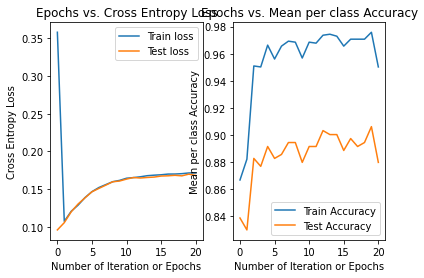

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.8444444444444444
20
training cost: 0.23639890945590944
validation cost: 0.2263027847130306
training accuracy: 0.9619326500732065
validation accuracy: 0.9149560117302052
time elapsed: 0.15092114299977766
learning rate: 0.01
momentum : 0.05
regularization: 0.9


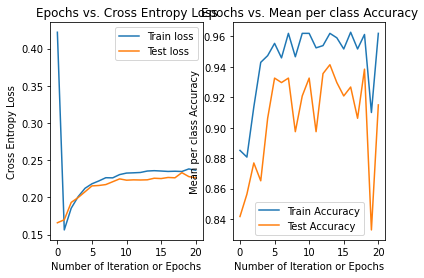

20
training cost: 0.23118726017760874
validation cost: 0.2248711487021685
training accuracy: 0.9633967789165446
validation accuracy: 0.9032258064516129
time elapsed: 0.1531134300003032
learning rate: 0.01
momentum : 0.05
regularization: 0.9


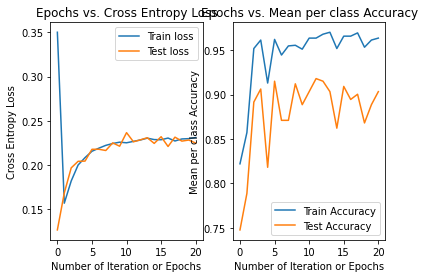

20
training cost: 0.2301343769249915
validation cost: 0.22715730769877848
training accuracy: 0.958272327964861
validation accuracy: 0.9002932551319648
time elapsed: 0.17973820199995316
learning rate: 0.01
momentum : 0.05
regularization: 0.9


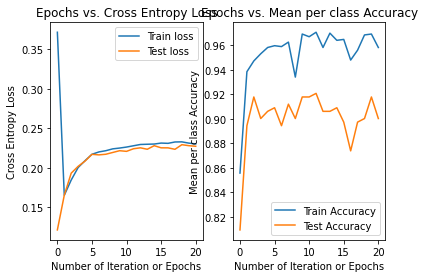

20
training cost: 0.2350629969407065
validation cost: 0.23205174406572596
training accuracy: 0.9538799414348462
validation accuracy: 0.9648093841642229
time elapsed: 0.16900021499986906
learning rate: 0.01
momentum : 0.05
regularization: 0.9


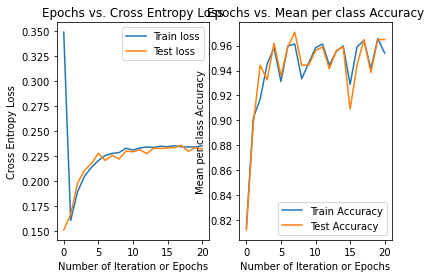

20
training cost: 0.2312486831877498
validation cost: 0.22907276204406452
training accuracy: 0.9633967789165446
validation accuracy: 0.8914956011730205
time elapsed: 0.15016388399999414
learning rate: 0.01
momentum : 0.05
regularization: 0.9


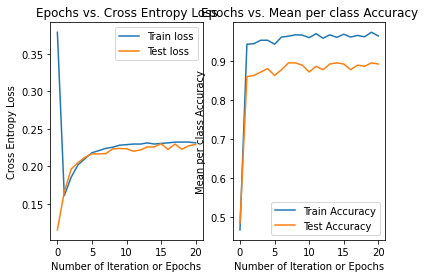

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.8666666666666667
30
training cost: 5.859716436593472
validation cost: 6.079661101156752
training accuracy: 0.8199121522693997
validation accuracy: 0.7419354838709677
time elapsed: 4.026144730999931
learning rate: 0.01
momentum : 0.5
regularization: 0.1


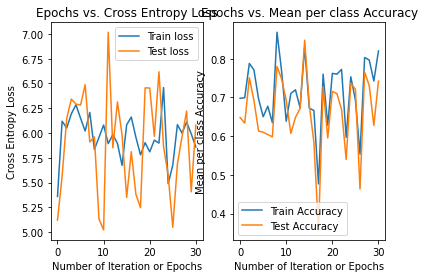

26
training cost: 5.769735434684657
validation cost: 5.608362143757126
training accuracy: 0.5702781844802343
validation accuracy: 0.4868035190615836
time elapsed: 3.57189325499985
learning rate: 0.01
momentum : 0.5
regularization: 0.1


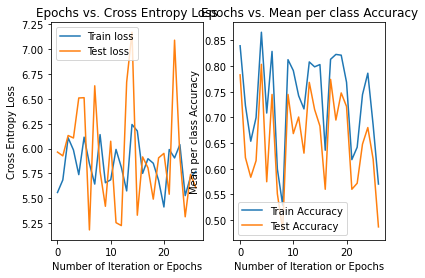

32
training cost: 5.688091299104334
validation cost: 5.7652215934725
training accuracy: 0.691800878477306
validation accuracy: 0.6480938416422287
time elapsed: 4.3727219580000565
learning rate: 0.01
momentum : 0.5
regularization: 0.1


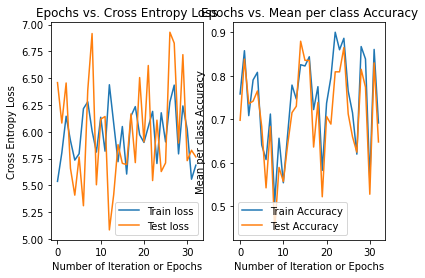

28
training cost: 6.228473650328821
validation cost: 7.00109348699952
training accuracy: 0.8301610541727672
validation accuracy: 0.8504398826979472
time elapsed: 3.7504389350001475
learning rate: 0.01
momentum : 0.5
regularization: 0.1


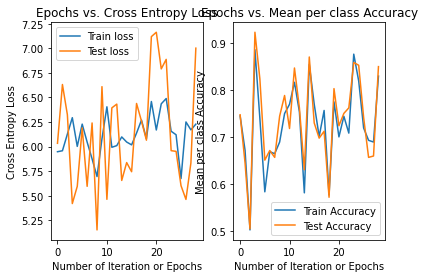

27
training cost: 5.952049826350219
validation cost: 5.819329445381548
training accuracy: 0.7240117130307467
validation accuracy: 0.6686217008797654
time elapsed: 3.6035647850003443
learning rate: 0.01
momentum : 0.5
regularization: 0.1


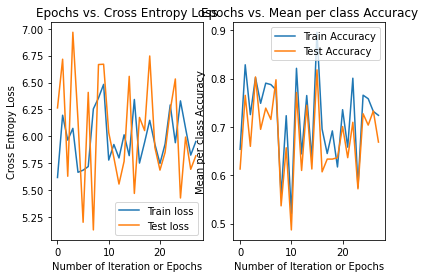

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.6777777777777778
26
training cost: 9.965954513089462
validation cost: 9.585567534861392
training accuracy: 0.5263543191800878
validation accuracy: 0.5542521994134897
time elapsed: 3.623535040000206
learning rate: 0.01
momentum : 0.5
regularization: 0.5


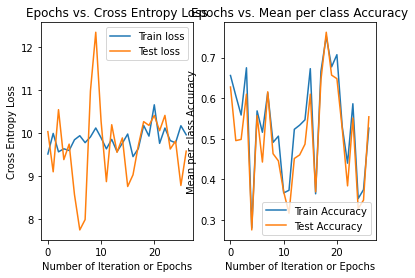

40
training cost: 10.359733565267925
validation cost: 10.84205366457657
training accuracy: 0.46925329428989754
validation accuracy: 0.4398826979472141
time elapsed: 5.370398012000351
learning rate: 0.01
momentum : 0.5
regularization: 0.5


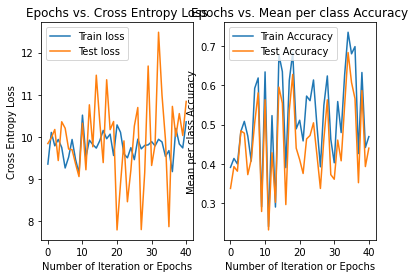

44
training cost: 9.65359643170206
validation cost: 10.256762608011222
training accuracy: 0.45168374816983897
validation accuracy: 0.4340175953079179
time elapsed: 5.90663593499994
learning rate: 0.01
momentum : 0.5
regularization: 0.5


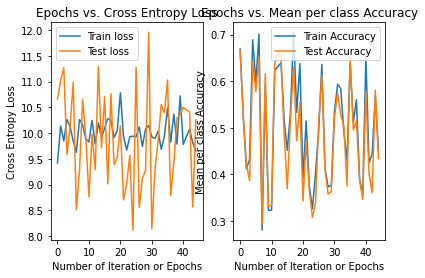

29
training cost: 10.414838077898168
validation cost: 10.618985323475822
training accuracy: 0.5373352855051244
validation accuracy: 0.5659824046920822
time elapsed: 3.9011020999996617
learning rate: 0.01
momentum : 0.5
regularization: 0.5


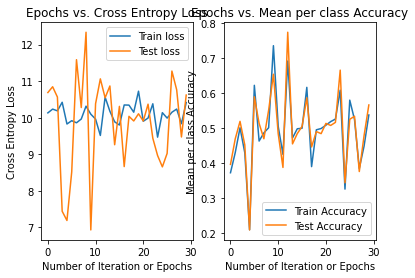

42
training cost: 9.709024485145356
validation cost: 10.622532966798856
training accuracy: 0.445095168374817
validation accuracy: 0.39589442815249265
time elapsed: 5.543233397000222
learning rate: 0.01
momentum : 0.5
regularization: 0.5


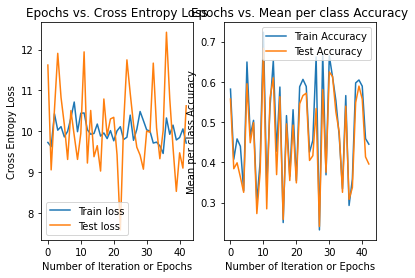

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.4
31
training cost: 11.546786601869075
validation cost: 9.925179143126682
training accuracy: 0.4363103953147877
validation accuracy: 0.3841642228739003
time elapsed: 4.128857181000058
learning rate: 0.01
momentum : 0.5
regularization: 0.9


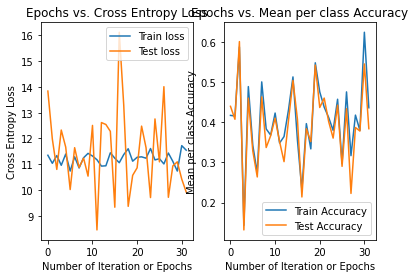

79
training cost: 11.366732070583954
validation cost: 12.429406955257022
training accuracy: 0.2349926793557833
validation accuracy: 0.2404692082111437
time elapsed: 10.643179515000156
learning rate: 0.01
momentum : 0.5
regularization: 0.9


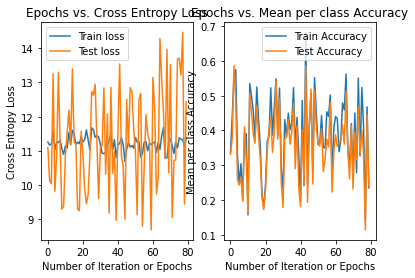

22
training cost: 11.322964414639225
validation cost: 10.95660978947415
training accuracy: 0.3213762811127379
validation accuracy: 0.3020527859237537
time elapsed: 3.08267478200014
learning rate: 0.01
momentum : 0.5
regularization: 0.9


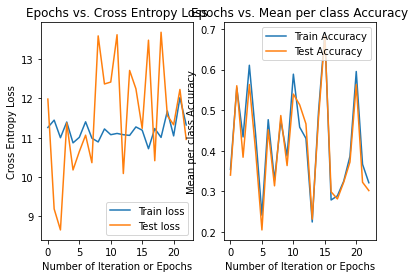

20
training cost: 11.169755477415617
validation cost: 10.588047651224315
training accuracy: 0.37554904831625185
validation accuracy: 0.4750733137829912
time elapsed: 2.7625392149998333
learning rate: 0.01
momentum : 0.5
regularization: 0.9


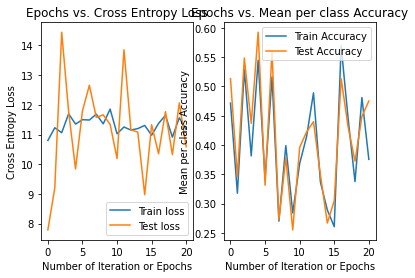

37
training cost: 10.975207414794868
validation cost: 10.790552601978732
training accuracy: 0.5146412884333821
validation accuracy: 0.49266862170087977
time elapsed: 4.92346502800001
learning rate: 0.01
momentum : 0.5
regularization: 0.9


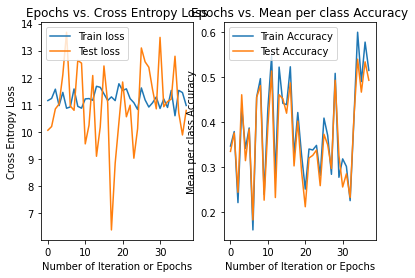

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.6111111111111112
20
training cost: 0.21667743000056794
validation cost: 0.21102851836100217
training accuracy: 0.9458272327964861
validation accuracy: 0.8768328445747801
time elapsed: 0.4415708460001042
learning rate: 0.01
momentum : 0.5
regularization: 0.1


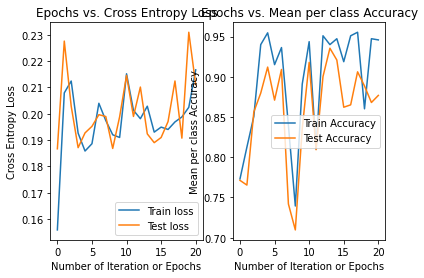

28
training cost: 0.18558472722910663
validation cost: 0.18612692775197745
training accuracy: 0.9363103953147877
validation accuracy: 0.8152492668621701
time elapsed: 0.6046444589997009
learning rate: 0.01
momentum : 0.5
regularization: 0.1


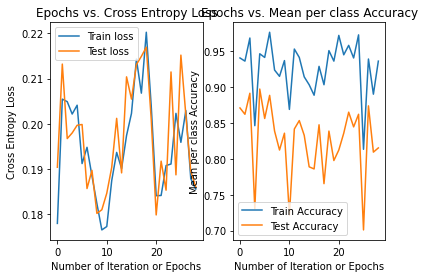

20
training cost: 0.1890491695587115
validation cost: 0.1933399463785055
training accuracy: 0.9619326500732065
validation accuracy: 0.8914956011730205
time elapsed: 0.43432268200012913
learning rate: 0.01
momentum : 0.5
regularization: 0.1


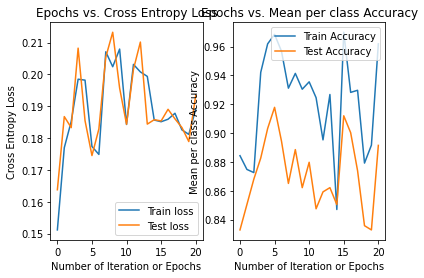

32
training cost: 0.21314180361826787
validation cost: 0.22456910056959792
training accuracy: 0.9553440702781845
validation accuracy: 0.9266862170087976
time elapsed: 0.6981791799998973
learning rate: 0.01
momentum : 0.5
regularization: 0.1


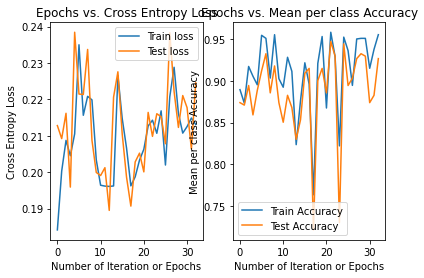

22
training cost: 0.2015575896122066
validation cost: 0.1891104001750508
training accuracy: 0.9275256222547584
validation accuracy: 0.8357771260997068
time elapsed: 0.47201052999980675
learning rate: 0.01
momentum : 0.5
regularization: 0.1


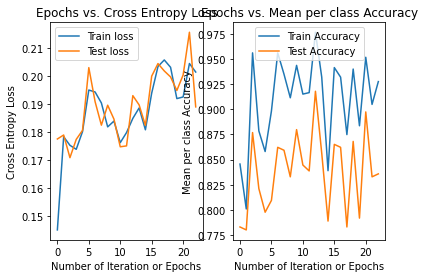

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.8555555555555555
52
training cost: 0.4433883199182412
validation cost: 0.47634000450710395
training accuracy: 0.8155197657393851
validation accuracy: 0.7390029325513197
time elapsed: 1.162701343000208
learning rate: 0.01
momentum : 0.5
regularization: 0.5


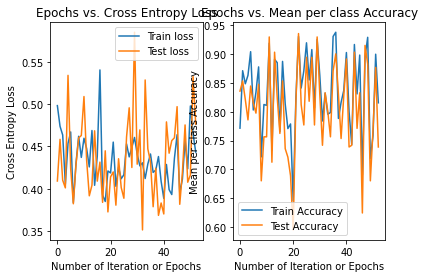

22
training cost: 0.41706565465169726
validation cost: 0.38210720753437655
training accuracy: 0.8469985358711567
validation accuracy: 0.7800586510263929
time elapsed: 0.490026940000007
learning rate: 0.01
momentum : 0.5
regularization: 0.5


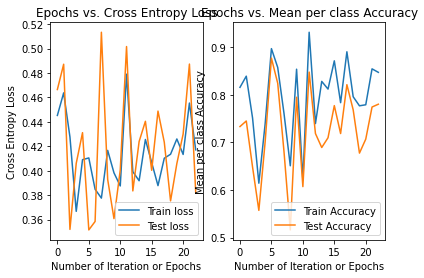

22
training cost: 0.4002702151027445
validation cost: 0.4178782061407572
training accuracy: 0.8660322108345534
validation accuracy: 0.8269794721407625
time elapsed: 0.4761905260002095
learning rate: 0.01
momentum : 0.5
regularization: 0.5


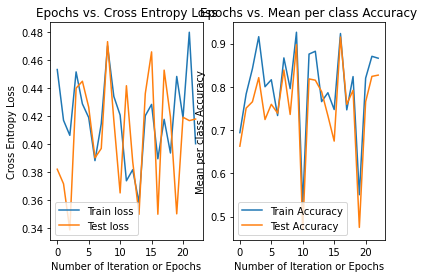

48
training cost: 0.4341809283751903
validation cost: 0.47079264203023524
training accuracy: 0.6632503660322109
validation accuracy: 0.6422287390029325
time elapsed: 0.9851665470000626
learning rate: 0.01
momentum : 0.5
regularization: 0.5


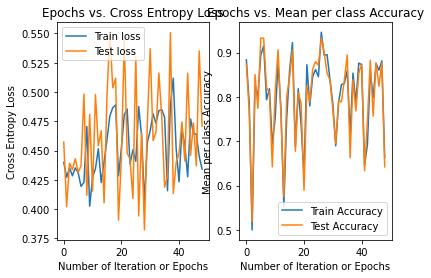

23
training cost: 0.43454752084427667
validation cost: 0.40699459403633537
training accuracy: 0.9524158125915081
validation accuracy: 0.8592375366568915
time elapsed: 0.5011460860000625
learning rate: 0.01
momentum : 0.5
regularization: 0.5


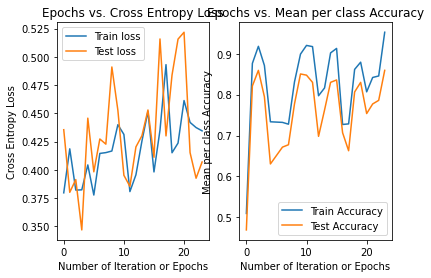

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.8888888888888888
37
training cost: 0.5553796912471621
validation cost: 0.48748978617806177
training accuracy: 0.5900439238653001
validation accuracy: 0.5425219941348973
time elapsed: 0.7810387270001229
learning rate: 0.01
momentum : 0.5
regularization: 0.9


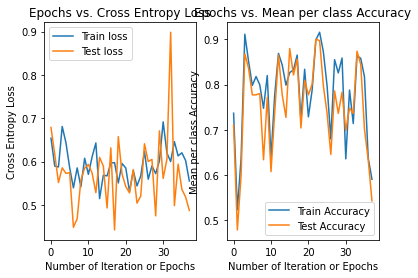

58
training cost: 0.6250993449119499
validation cost: 0.6226684544679978
training accuracy: 0.8301610541727672
validation accuracy: 0.718475073313783
time elapsed: 1.1893626820001373
learning rate: 0.01
momentum : 0.5
regularization: 0.9


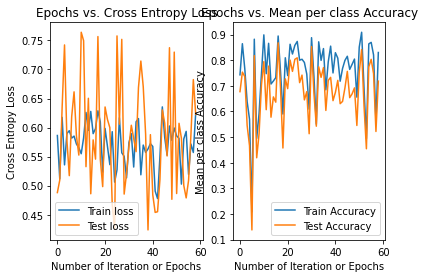

26
training cost: 0.6178293586536165
validation cost: 0.6458461381620632
training accuracy: 0.8499267935578331
validation accuracy: 0.8005865102639296
time elapsed: 0.547816383999816
learning rate: 0.01
momentum : 0.5
regularization: 0.9


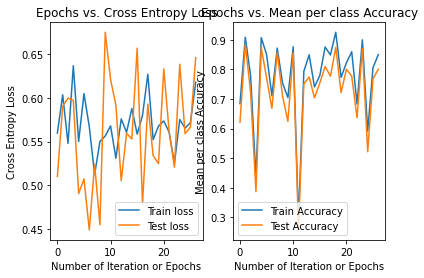

30
training cost: 0.6101621367056861
validation cost: 0.5817864275949367
training accuracy: 0.6705710102489019
validation accuracy: 0.6334310850439883
time elapsed: 0.630635631000132
learning rate: 0.01
momentum : 0.5
regularization: 0.9


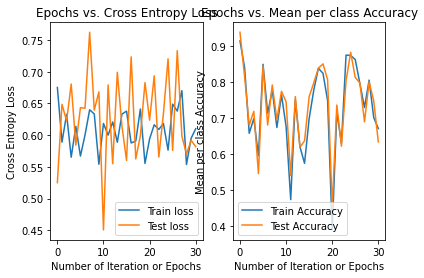

39
training cost: 0.5913439894772512
validation cost: 0.6801669662848858
training accuracy: 0.7789165446559297
validation accuracy: 0.7595307917888563
time elapsed: 0.8167475529999138
learning rate: 0.01
momentum : 0.5
regularization: 0.9


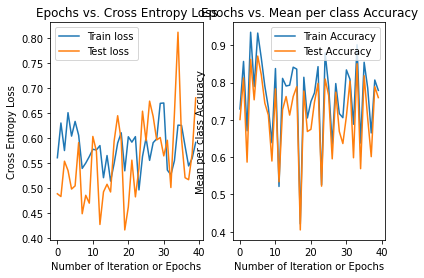

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.7444444444444445
20
training cost: 0.07444681271728963
validation cost: 0.07423363595567212
training accuracy: 0.9846266471449487
validation accuracy: 0.9325513196480938
time elapsed: 0.17245699100021739
learning rate: 0.01
momentum : 0.5
regularization: 0.1


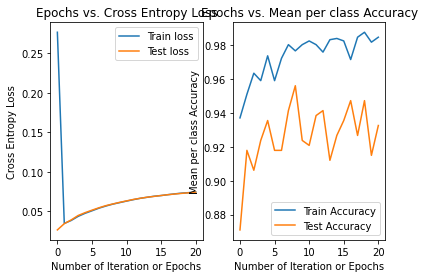

20
training cost: 0.0725675543081357
validation cost: 0.07311216160028637
training accuracy: 0.9838945827232797
validation accuracy: 0.8973607038123167
time elapsed: 0.1568884270000126
learning rate: 0.01
momentum : 0.5
regularization: 0.1


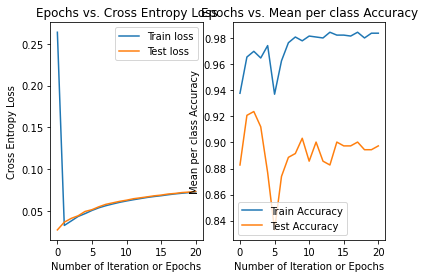

20
training cost: 0.07322248378827148
validation cost: 0.07334755635684369
training accuracy: 0.9831625183016105
validation accuracy: 0.9325513196480938
time elapsed: 0.1524940129997958
learning rate: 0.01
momentum : 0.5
regularization: 0.1


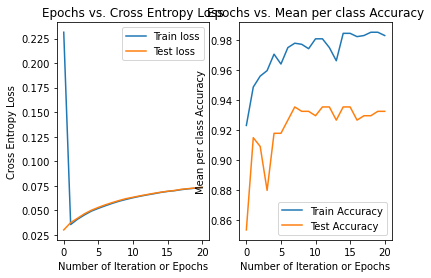

20
training cost: 0.07521521219849563
validation cost: 0.0753812660297359
training accuracy: 0.9802342606149341
validation accuracy: 0.9648093841642229
time elapsed: 0.1635384480000539
learning rate: 0.01
momentum : 0.5
regularization: 0.1


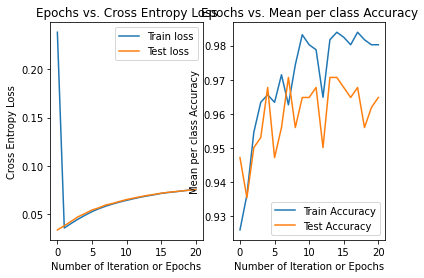

20
training cost: 0.07202015656663373
validation cost: 0.07213831823998676
training accuracy: 0.986822840409956
validation accuracy: 0.9178885630498533
time elapsed: 0.15500857000006363
learning rate: 0.01
momentum : 0.5
regularization: 0.1


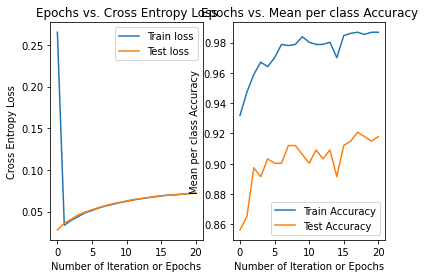

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9222222222222223
20
training cost: 0.17914018468324408
validation cost: 0.17405013287700544
training accuracy: 0.972181551976574
validation accuracy: 0.9208211143695014
time elapsed: 0.1485011059999124
learning rate: 0.01
momentum : 0.5
regularization: 0.5


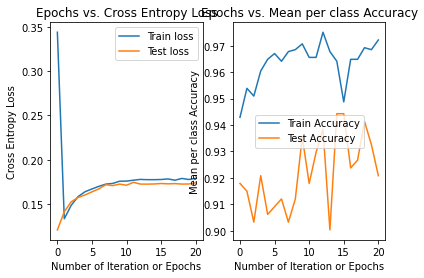

20
training cost: 0.17592615857430077
validation cost: 0.17423188002729925
training accuracy: 0.9619326500732065
validation accuracy: 0.9266862170087976
time elapsed: 0.18089731500003836
learning rate: 0.01
momentum : 0.5
regularization: 0.5


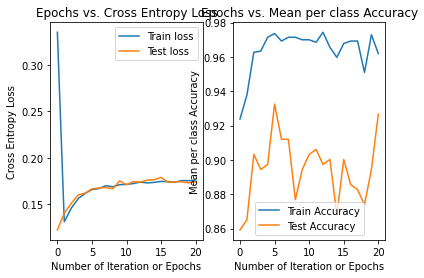

20
training cost: 0.1764512621951042
validation cost: 0.17476328954641773
training accuracy: 0.9780380673499268
validation accuracy: 0.9266862170087976
time elapsed: 0.15665533900028095
learning rate: 0.01
momentum : 0.5
regularization: 0.5


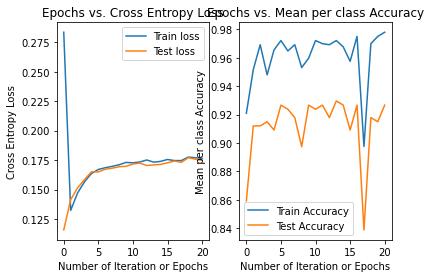

20
training cost: 0.18203515688457886
validation cost: 0.17950240147444824
training accuracy: 0.9641288433382138
validation accuracy: 0.967741935483871
time elapsed: 0.1539901229998577
learning rate: 0.01
momentum : 0.5
regularization: 0.5


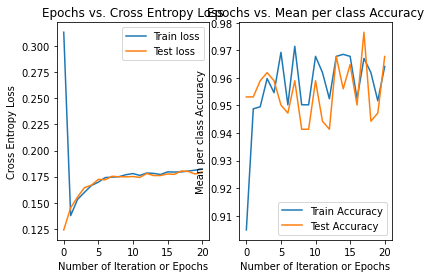

20
training cost: 0.1740350819519548
validation cost: 0.170870296107051
training accuracy: 0.9502196193265008
validation accuracy: 0.8621700879765396
time elapsed: 0.16367888800004948
learning rate: 0.01
momentum : 0.5
regularization: 0.5


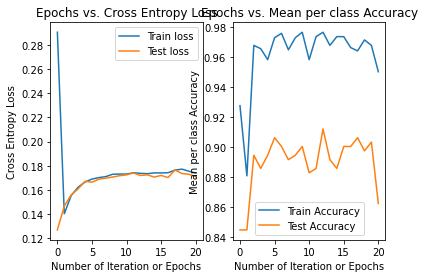

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.9222222222222223
20
training cost: 0.23736140970689076
validation cost: 0.22720949458777406
training accuracy: 0.9597364568081991
validation accuracy: 0.9149560117302052
time elapsed: 0.1727839129998756
learning rate: 0.01
momentum : 0.5
regularization: 0.9


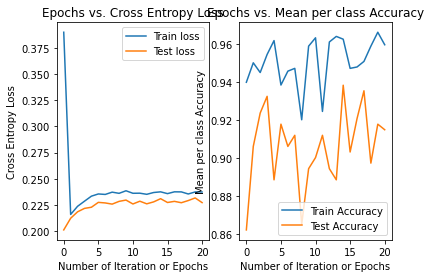

20
training cost: 0.23138685994276717
validation cost: 0.23524439007835207
training accuracy: 0.9626647144948756
validation accuracy: 0.8797653958944281
time elapsed: 0.1588328210000327
learning rate: 0.01
momentum : 0.5
regularization: 0.9


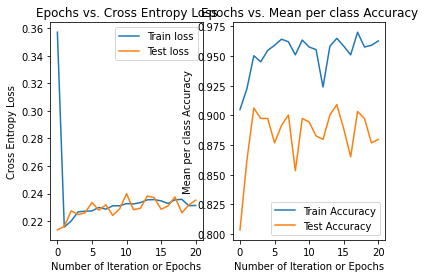

20
training cost: 0.23015335624971414
validation cost: 0.2270882804353679
training accuracy: 0.9568081991215227
validation accuracy: 0.9237536656891495
time elapsed: 0.15595556099970054
learning rate: 0.01
momentum : 0.5
regularization: 0.9


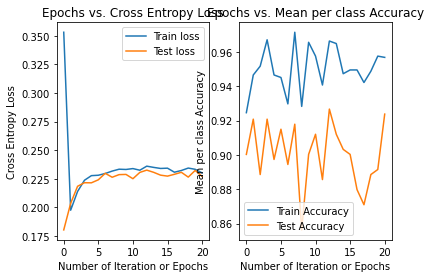

20
training cost: 0.23892126721048235
validation cost: 0.24191969156338303
training accuracy: 0.95900439238653
validation accuracy: 0.9560117302052786
time elapsed: 0.15579446100036876
learning rate: 0.01
momentum : 0.5
regularization: 0.9


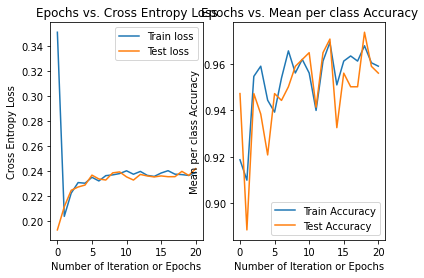

22
training cost: 0.2330758974192622
validation cost: 0.23137489963339097
training accuracy: 0.9326500732064422
validation accuracy: 0.8563049853372434
time elapsed: 0.1656230400003551
learning rate: 0.01
momentum : 0.5
regularization: 0.9


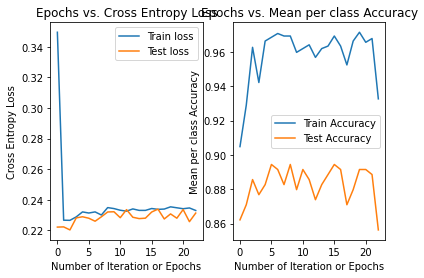

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.8444444444444444
20
training cost: 61.13474982781007
validation cost: 56.28179477750275
training accuracy: 0.5732064421669106
validation accuracy: 0.5865102639296188
time elapsed: 2.7143413409999084
learning rate: 0.1
momentum : 0.005
regularization: 0.1


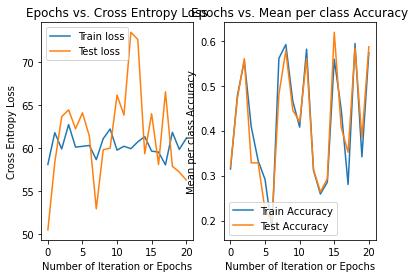

22
training cost: 59.46283224756882
validation cost: 68.10301389365644
training accuracy: 0.40775988286969256
validation accuracy: 0.3782991202346041
time elapsed: 3.2232626909999453
learning rate: 0.1
momentum : 0.005
regularization: 0.1


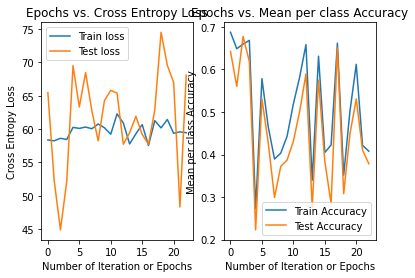

55
training cost: 60.25574518743633
validation cost: 61.32748861221442
training accuracy: 0.5673499267935578
validation accuracy: 0.6070381231671554
time elapsed: 7.335133121000126
learning rate: 0.1
momentum : 0.005
regularization: 0.1


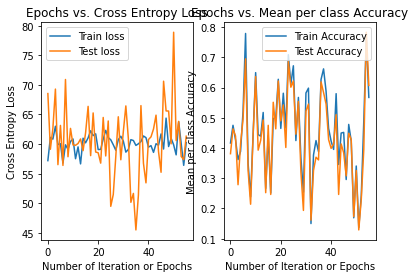

55
training cost: 64.10175824625993
validation cost: 69.99907417243907
training accuracy: 0.49633967789165445
validation accuracy: 0.4281524926686217
time elapsed: 7.238148802000069
learning rate: 0.1
momentum : 0.005
regularization: 0.1


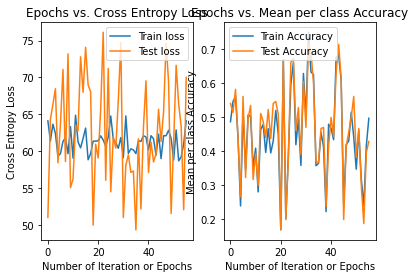

29
training cost: 62.01923403906629
validation cost: 54.05269996535296
training accuracy: 0.1925329428989751
validation accuracy: 0.187683284457478
time elapsed: 3.875233961000049
learning rate: 0.1
momentum : 0.005
regularization: 0.1


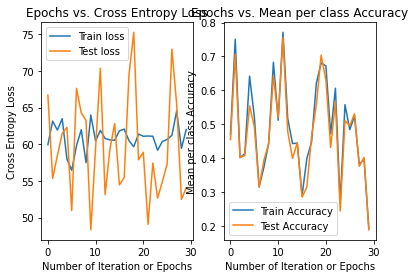

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.17777777777777778
41
training cost: 84.22647764135176
validation cost: 82.20298795830738
training accuracy: 0.09736456808199122
validation accuracy: 0.10850439882697947
time elapsed: 5.536538614999699
learning rate: 0.1
momentum : 0.005
regularization: 0.5


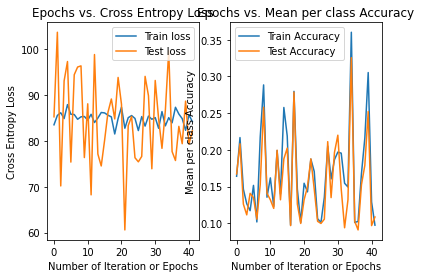

87
training cost: 86.62302813703552
validation cost: 75.94593390510839
training accuracy: 0.2130307467057101
validation accuracy: 0.20821114369501467
time elapsed: 11.427984127999935
learning rate: 0.1
momentum : 0.005
regularization: 0.5


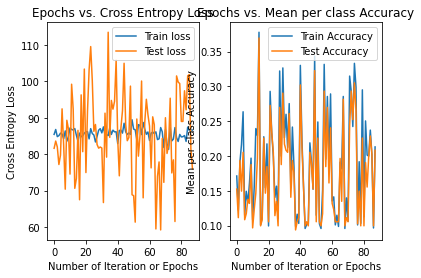

35
training cost: 87.75992039213827
validation cost: 74.93989011981975
training accuracy: 0.1815519765739385
validation accuracy: 0.17888563049853373
time elapsed: 4.675775216999682
learning rate: 0.1
momentum : 0.005
regularization: 0.5


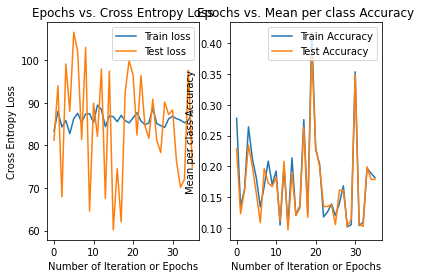

42
training cost: 84.5984874216052
validation cost: 80.82396575445776
training accuracy: 0.26207906295754024
validation accuracy: 0.2697947214076246
time elapsed: 5.687340420000055
learning rate: 0.1
momentum : 0.005
regularization: 0.5


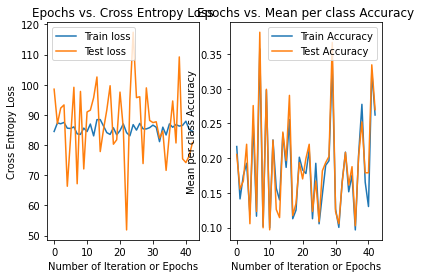

24
training cost: 86.60704461001293
validation cost: 74.5595942385083
training accuracy: 0.15592972181551976
validation accuracy: 0.16715542521994134
time elapsed: 3.2126151180000306
learning rate: 0.1
momentum : 0.005
regularization: 0.5


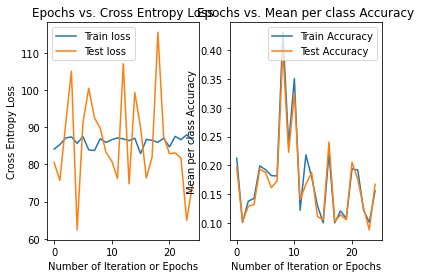

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.13333333333333333
23
training cost: 89.25415613489132
validation cost: 75.58268446327149
training accuracy: 0.09663250366032211
validation accuracy: 0.0967741935483871
time elapsed: 3.1388608410002234
learning rate: 0.1
momentum : 0.005
regularization: 0.9


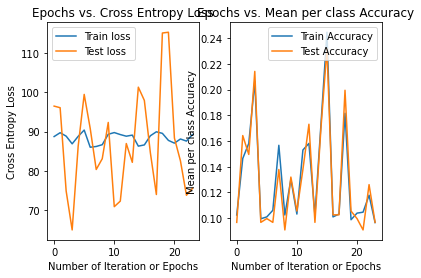

37
training cost: 90.87185894831829
validation cost: 62.579714708372364
training accuracy: 0.10102489019033675
validation accuracy: 0.10263929618768329
time elapsed: 4.9946000239997375
learning rate: 0.1
momentum : 0.005
regularization: 0.9


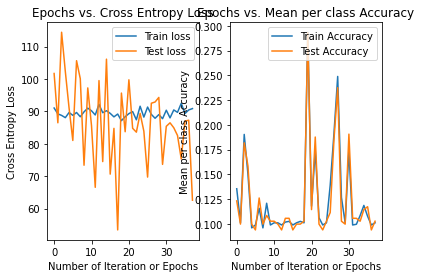

22
training cost: 91.10979357616944
validation cost: 76.68546397985605
training accuracy: 0.09736456808199122
validation accuracy: 0.093841642228739
time elapsed: 2.9752923249998275
learning rate: 0.1
momentum : 0.005
regularization: 0.9


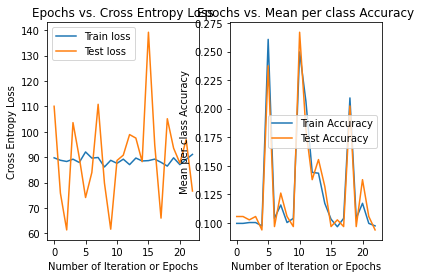

22
training cost: 88.02685875858919
validation cost: 91.49344926332437
training accuracy: 0.116398243045388
validation accuracy: 0.12316715542521994
time elapsed: 3.014331950000269
learning rate: 0.1
momentum : 0.005
regularization: 0.9


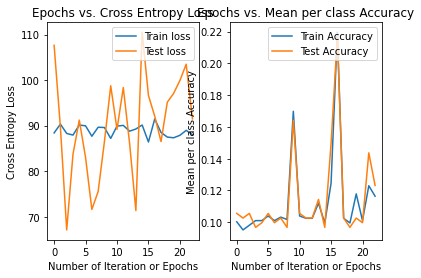

23
training cost: 89.27808184085445
validation cost: 90.44475382344672
training accuracy: 0.11420204978038068
validation accuracy: 0.11436950146627566
time elapsed: 3.179080460000023
learning rate: 0.1
momentum : 0.005
regularization: 0.9


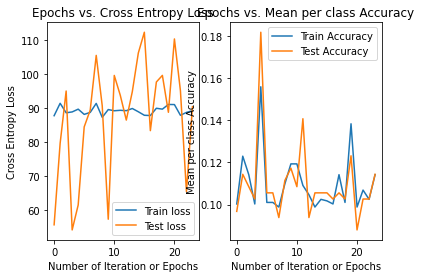

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.1111111111111111
35
training cost: 4.642135627879431
validation cost: 4.462606240411811
training accuracy: 0.7335285505124451
validation accuracy: 0.7038123167155426
time elapsed: 0.7517454419999012
learning rate: 0.1
momentum : 0.005
regularization: 0.1


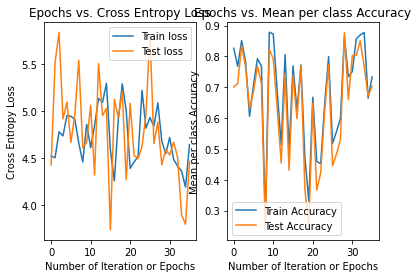

42
training cost: 4.447756070446163
validation cost: 3.871564808480109
training accuracy: 0.8250366032210834
validation accuracy: 0.7917888563049853
time elapsed: 0.8881120850001025
learning rate: 0.1
momentum : 0.005
regularization: 0.1


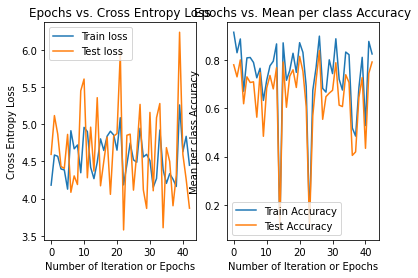

32
training cost: 4.677128429482618
validation cost: 5.579836332466738
training accuracy: 0.7320644216691069
validation accuracy: 0.6304985337243402
time elapsed: 0.6786653090002801
learning rate: 0.1
momentum : 0.005
regularization: 0.1


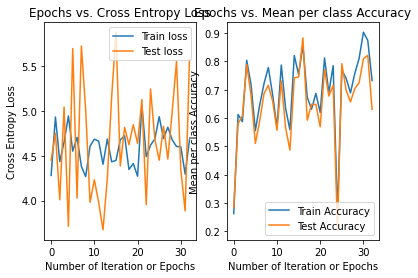

34
training cost: 4.567996345239469
validation cost: 5.655463876092369
training accuracy: 0.7745241581259151
validation accuracy: 0.8240469208211144
time elapsed: 0.7428392790002363
learning rate: 0.1
momentum : 0.005
regularization: 0.1


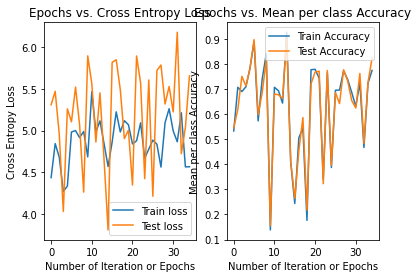

37
training cost: 4.58366861937921
validation cost: 4.7083859688414424
training accuracy: 0.9158125915080527
validation accuracy: 0.8592375366568915
time elapsed: 0.7611150660000021
learning rate: 0.1
momentum : 0.005
regularization: 0.1


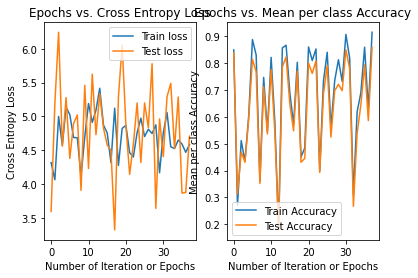

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.7777777777777778
51
training cost: 12.294620592107538
validation cost: 16.162799547452504
training accuracy: 0.17276720351390923
validation accuracy: 0.1378299120234604
time elapsed: 1.168725596999593
learning rate: 0.1
momentum : 0.005
regularization: 0.5


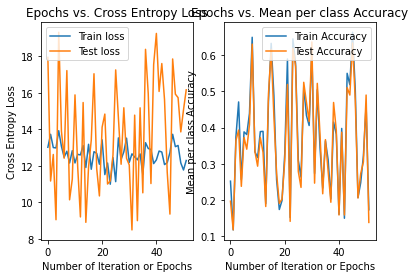

37
training cost: 11.764867755901351
validation cost: 12.772979813237797
training accuracy: 0.25036603221083453
validation accuracy: 0.19941348973607037
time elapsed: 0.7836198919999333
learning rate: 0.1
momentum : 0.005
regularization: 0.5


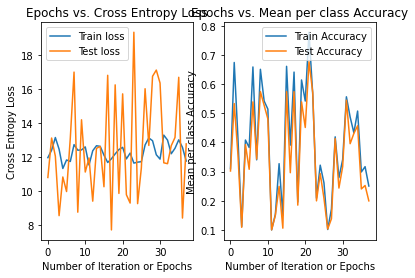

34
training cost: 12.375286395654097
validation cost: 13.9622804177491
training accuracy: 0.6478770131771596
validation accuracy: 0.5982404692082112
time elapsed: 0.7081949950002127
learning rate: 0.1
momentum : 0.005
regularization: 0.5


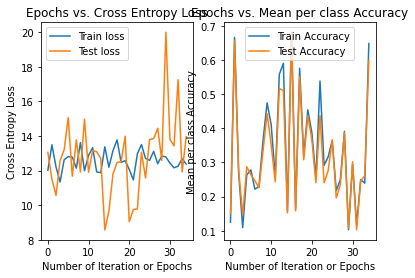

27
training cost: 12.506738230740101
validation cost: 14.716365990778822
training accuracy: 0.42313323572474376
validation accuracy: 0.41935483870967744
time elapsed: 0.5912534839999353
learning rate: 0.1
momentum : 0.005
regularization: 0.5


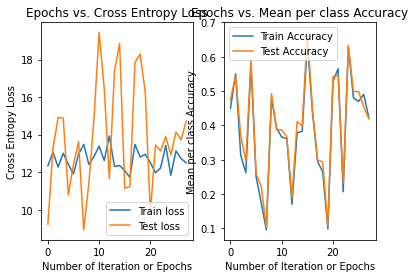

31
training cost: 13.65206127061155
validation cost: 10.041689846938471
training accuracy: 0.62298682284041
validation accuracy: 0.6070381231671554
time elapsed: 0.6648114170002373
learning rate: 0.1
momentum : 0.005
regularization: 0.5


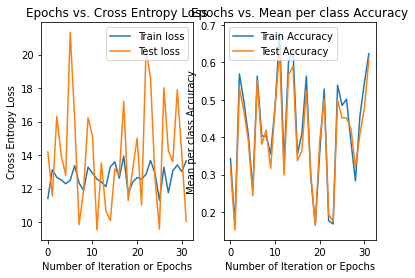

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.5555555555555556
39
training cost: 18.05211010144907
validation cost: 16.071493039570353
training accuracy: 0.39824304538799415
validation accuracy: 0.31378299120234604
time elapsed: 0.8286863570001515
learning rate: 0.1
momentum : 0.005
regularization: 0.9


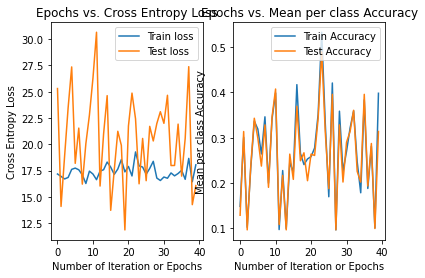

70
training cost: 17.688660699979696
validation cost: 15.412758636001339
training accuracy: 0.38872620790629575
validation accuracy: 0.3255131964809384
time elapsed: 1.5095371789998353
learning rate: 0.1
momentum : 0.005
regularization: 0.9


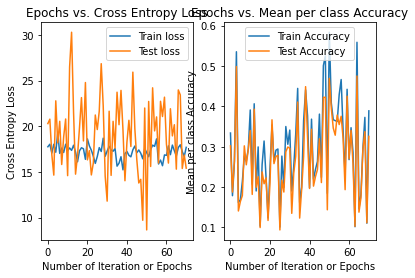

20
training cost: 18.215845941075774
validation cost: 19.245619788057805
training accuracy: 0.27891654465592974
validation accuracy: 0.2756598240469208
time elapsed: 0.4272046570004022
learning rate: 0.1
momentum : 0.005
regularization: 0.9


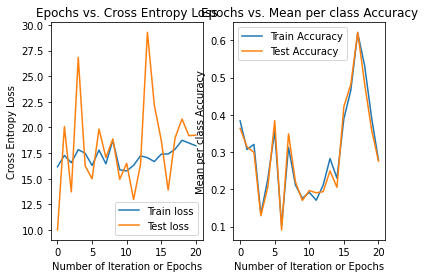

20
training cost: 17.890752738244167
validation cost: 14.187787415301743
training accuracy: 0.17569546120058566
validation accuracy: 0.18475073313782991
time elapsed: 0.4235806850001609
learning rate: 0.1
momentum : 0.005
regularization: 0.9


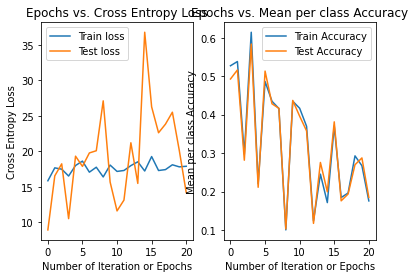

30
training cost: 18.250073282560137
validation cost: 15.204622302461106
training accuracy: 0.431185944363104
validation accuracy: 0.45454545454545453
time elapsed: 0.6247046190001129
learning rate: 0.1
momentum : 0.005
regularization: 0.9


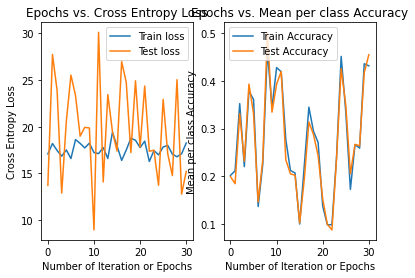

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.4888888888888889
29
training cost: 0.8247271257087119
validation cost: 0.7114985071595776
training accuracy: 0.9363103953147877
validation accuracy: 0.8944281524926686
time elapsed: 0.22066570899960425
learning rate: 0.1
momentum : 0.005
regularization: 0.1


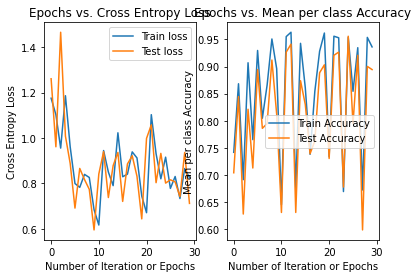

26
training cost: 1.2046484504066755
validation cost: 1.0867496880476517
training accuracy: 0.9165446559297218
validation accuracy: 0.8269794721407625
time elapsed: 0.1891192019998016
learning rate: 0.1
momentum : 0.005
regularization: 0.1


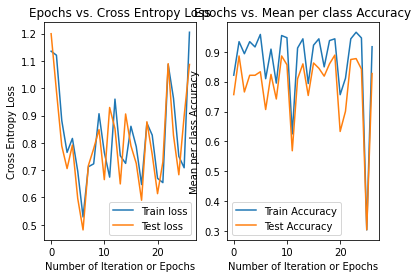

24
training cost: 0.9670823683854879
validation cost: 0.9010523794867293
training accuracy: 0.9099560761346999
validation accuracy: 0.8299120234604106
time elapsed: 0.18278138200003013
learning rate: 0.1
momentum : 0.005
regularization: 0.1


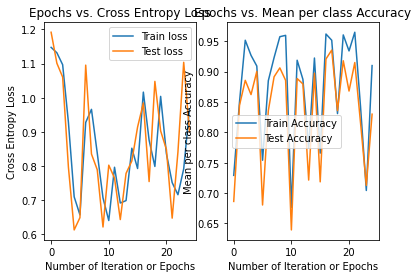

26
training cost: 0.7845899258971573
validation cost: 0.6790459308918868
training accuracy: 0.9575402635431918
validation accuracy: 0.9501466275659824
time elapsed: 0.20252744999970673
learning rate: 0.1
momentum : 0.005
regularization: 0.1


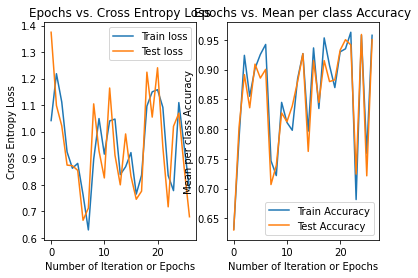

28
training cost: 0.7447528742980009
validation cost: 1.0691986668919824
training accuracy: 0.6178623718887262
validation accuracy: 0.6099706744868035
time elapsed: 0.23389447999988988
learning rate: 0.1
momentum : 0.005
regularization: 0.1


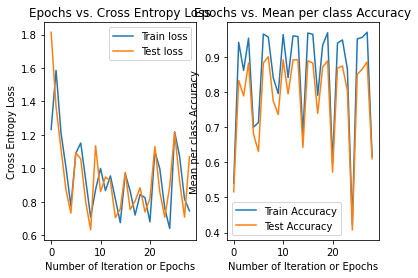

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.6
23
training cost: 3.8908427413403404
validation cost: 4.2511214352208615
training accuracy: 0.5797950219619327
validation accuracy: 0.4780058651026393
time elapsed: 0.1816823869999098
learning rate: 0.1
momentum : 0.005
regularization: 0.5


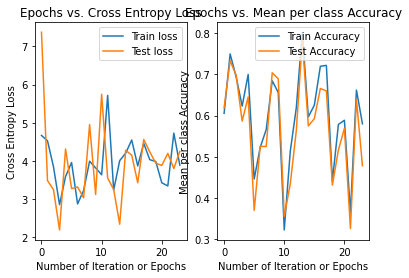

39
training cost: 3.895119556255748
validation cost: 2.4545398066111592
training accuracy: 0.849194729136164
validation accuracy: 0.750733137829912
time elapsed: 0.283148724000057
learning rate: 0.1
momentum : 0.005
regularization: 0.5


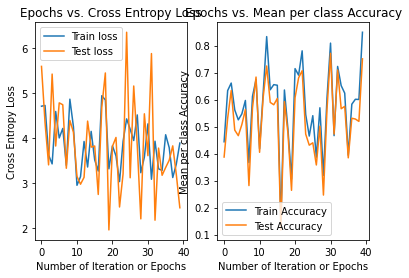

33
training cost: 4.0829740250943
validation cost: 3.968582399914852
training accuracy: 0.46486090775988287
validation accuracy: 0.45161290322580644
time elapsed: 0.25628156299990223
learning rate: 0.1
momentum : 0.005
regularization: 0.5


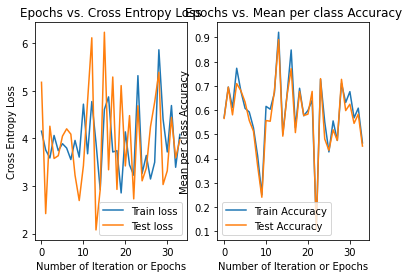

27
training cost: 4.066689468018183
validation cost: 3.892814998317919
training accuracy: 0.6398243045387995
validation accuracy: 0.6363636363636364
time elapsed: 0.21026333100007832
learning rate: 0.1
momentum : 0.005
regularization: 0.5


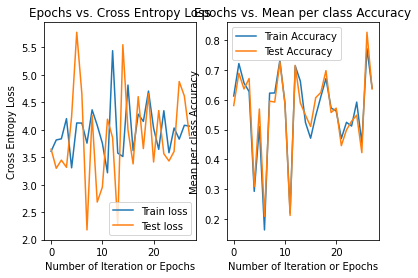

21
training cost: 3.5366831104436804
validation cost: 4.343430341988095
training accuracy: 0.5490483162518301
validation accuracy: 0.5131964809384164
time elapsed: 0.1668667839999216
learning rate: 0.1
momentum : 0.005
regularization: 0.5


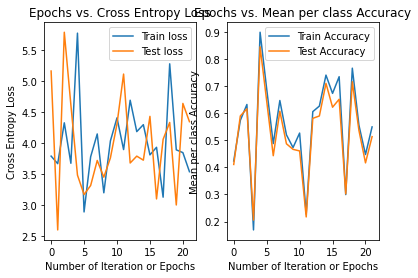

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.6111111111111112
50
training cost: 6.404610353420301
validation cost: 9.37476819866731
training accuracy: 0.5468521229868228
validation accuracy: 0.5454545454545454
time elapsed: 0.36779703799993513
learning rate: 0.1
momentum : 0.005
regularization: 0.9


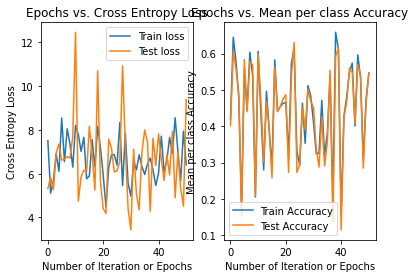

35
training cost: 6.783495260991665
validation cost: 6.289130760058808
training accuracy: 0.31478770131771594
validation accuracy: 0.30791788856304986
time elapsed: 0.267499897000107
learning rate: 0.1
momentum : 0.005
regularization: 0.9


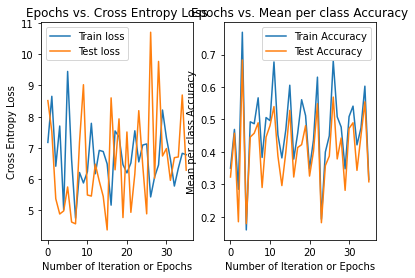

29
training cost: 6.371394817789151
validation cost: 6.146707657489009
training accuracy: 0.33162518301610544
validation accuracy: 0.31671554252199413
time elapsed: 0.225259362000088
learning rate: 0.1
momentum : 0.005
regularization: 0.9


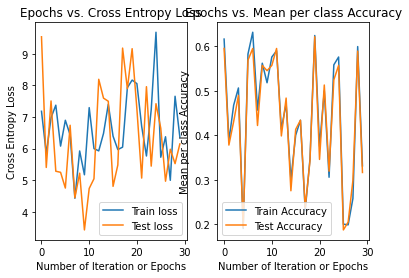

57
training cost: 7.405227527198595
validation cost: 7.4973416506505375
training accuracy: 0.4472913616398243
validation accuracy: 0.4809384164222874
time elapsed: 0.40864902800012715
learning rate: 0.1
momentum : 0.005
regularization: 0.9


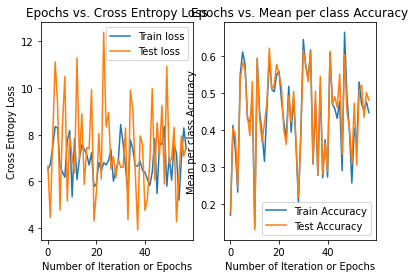

31
training cost: 5.837813733924823
validation cost: 4.620857125072477
training accuracy: 0.3052708638360176
validation accuracy: 0.31085043988269795
time elapsed: 0.23657181899989155
learning rate: 0.1
momentum : 0.005
regularization: 0.9


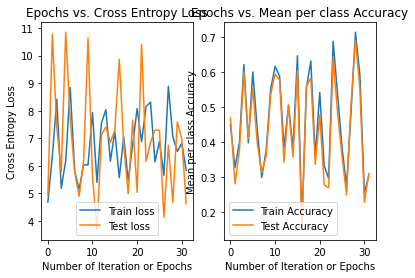

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.36666666666666664
28
training cost: 66.88186390969642
validation cost: 55.6171493583273
training accuracy: 0.45095168374816985
validation accuracy: 0.45454545454545453
time elapsed: 3.7857348720003756
learning rate: 0.1
momentum : 0.05
regularization: 0.1


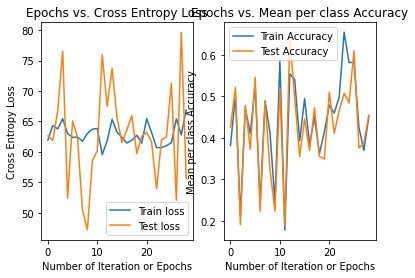

32
training cost: 62.53224703609736
validation cost: 64.52589092420942
training accuracy: 0.5702781844802343
validation accuracy: 0.5865102639296188
time elapsed: 4.440562528999635
learning rate: 0.1
momentum : 0.05
regularization: 0.1


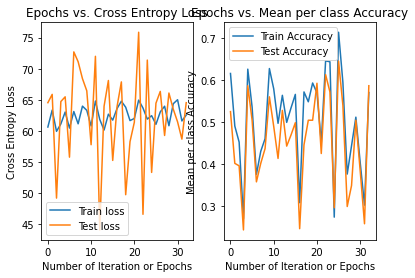

37
training cost: 65.88873506944647
validation cost: 63.82273862662886
training accuracy: 0.40995607613469986
validation accuracy: 0.39002932551319647
time elapsed: 4.969278821999978
learning rate: 0.1
momentum : 0.05
regularization: 0.1


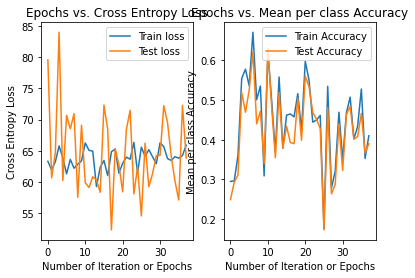

26
training cost: 61.0407447863102
validation cost: 61.986463555716846
training accuracy: 0.4458272327964861
validation accuracy: 0.4750733137829912
time elapsed: 3.52013232399986
learning rate: 0.1
momentum : 0.05
regularization: 0.1


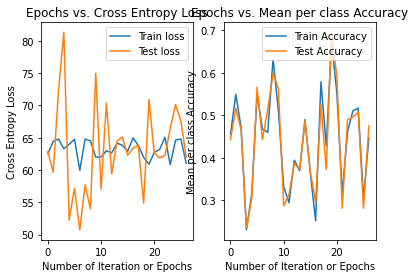

35
training cost: 60.11078089440504
validation cost: 56.5303223093302
training accuracy: 0.31551976573938506
validation accuracy: 0.30791788856304986
time elapsed: 4.804344649999621
learning rate: 0.1
momentum : 0.05
regularization: 0.1


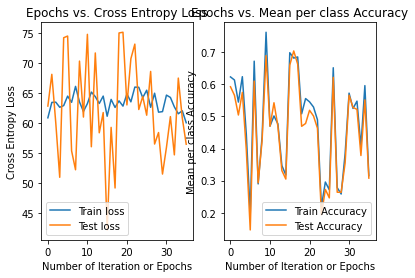

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.3
28
training cost: 86.94550334538427
validation cost: 91.61658506129183
training accuracy: 0.25329428989751096
validation accuracy: 0.25513196480938416
time elapsed: 3.8104866339999717
learning rate: 0.1
momentum : 0.05
regularization: 0.5


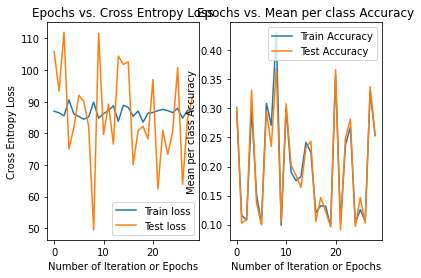

45
training cost: 87.72228958497236
validation cost: 87.50159616028017
training accuracy: 0.1903367496339678
validation accuracy: 0.16422287390029325
time elapsed: 5.97181228799991
learning rate: 0.1
momentum : 0.05
regularization: 0.5


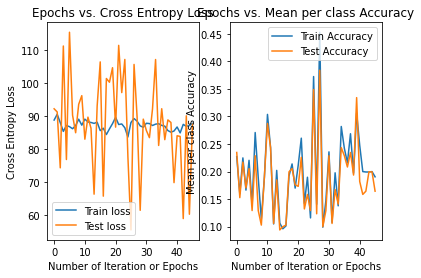

32
training cost: 86.05693410842244
validation cost: 72.9101499820311
training accuracy: 0.3169838945827233
validation accuracy: 0.3196480938416422
time elapsed: 4.305092364999837
learning rate: 0.1
momentum : 0.05
regularization: 0.5


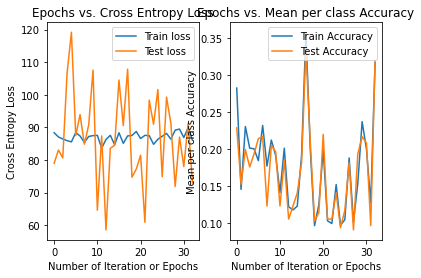

40
training cost: 84.6624666844247
validation cost: 111.15269817060049
training accuracy: 0.1478770131771596
validation accuracy: 0.16129032258064516
time elapsed: 5.532903665000049
learning rate: 0.1
momentum : 0.05
regularization: 0.5


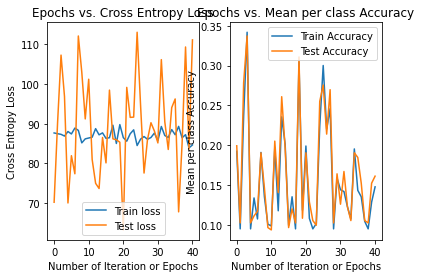

29
training cost: 85.6238501952579
validation cost: 80.03036797708124
training accuracy: 0.17349926793557832
validation accuracy: 0.16715542521994134
time elapsed: 4.011017716999959
learning rate: 0.1
momentum : 0.05
regularization: 0.5


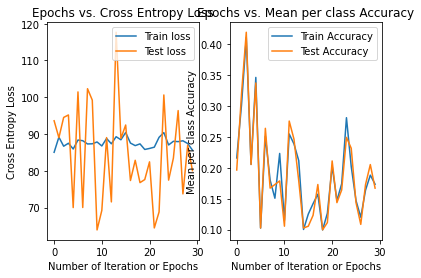

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.17777777777777778
43
training cost: 91.53817414215968
validation cost: 82.77782363262075
training accuracy: 0.18740849194729137
validation accuracy: 0.187683284457478
time elapsed: 5.823994330999994
learning rate: 0.1
momentum : 0.05
regularization: 0.9


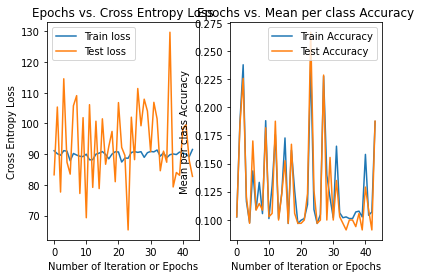

24
training cost: 92.59660114640158
validation cost: 93.94615811328596
training accuracy: 0.09882869692532943
validation accuracy: 0.10557184750733138
time elapsed: 3.3167072490000464
learning rate: 0.1
momentum : 0.05
regularization: 0.9


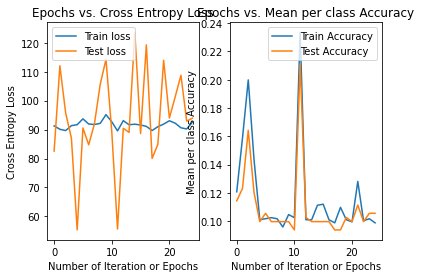

48
training cost: 90.35650433604465
validation cost: 83.16501779279545
training accuracy: 0.10322108345534407
validation accuracy: 0.11436950146627566
time elapsed: 6.384556437000356
learning rate: 0.1
momentum : 0.05
regularization: 0.9


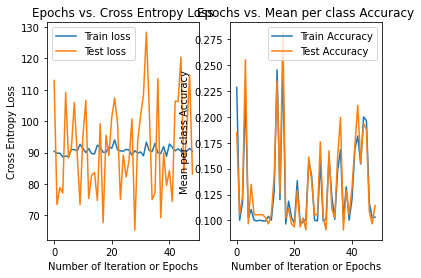

33
training cost: 91.1638129804915
validation cost: 88.20579593258117
training accuracy: 0.0951683748169839
validation accuracy: 0.10263929618768329
time elapsed: 4.445784024000204
learning rate: 0.1
momentum : 0.05
regularization: 0.9


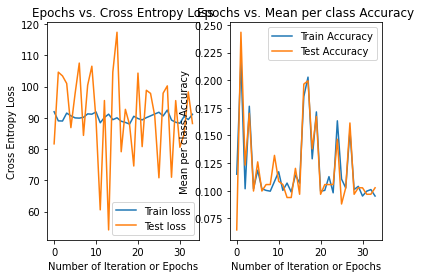

45
training cost: 91.39915095789569
validation cost: 72.56208861086984
training accuracy: 0.10322108345534407
validation accuracy: 0.10557184750733138
time elapsed: 6.05315114799987
learning rate: 0.1
momentum : 0.05
regularization: 0.9


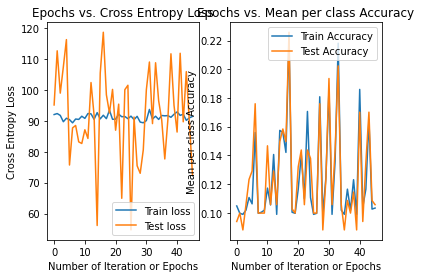

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.07777777777777778
60
training cost: 5.105067693007203
validation cost: 4.709336489800806
training accuracy: 0.7657393850658858
validation accuracy: 0.6862170087976539
time elapsed: 1.2540770559999146
learning rate: 0.1
momentum : 0.05
regularization: 0.1


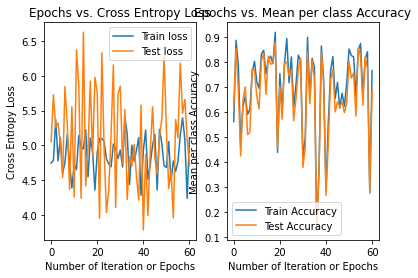

25
training cost: 4.671256238761565
validation cost: 4.744285265030851
training accuracy: 0.5329428989751098
validation accuracy: 0.4252199413489736
time elapsed: 0.5236352249999072
learning rate: 0.1
momentum : 0.05
regularization: 0.1


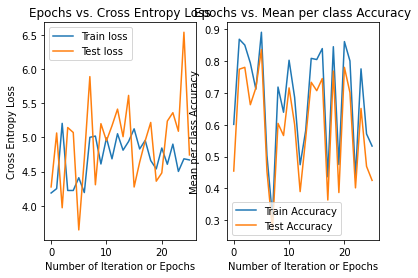

45
training cost: 5.137156633398029
validation cost: 5.441910251440482
training accuracy: 0.9026354319180088
validation accuracy: 0.8387096774193549
time elapsed: 0.9780436959999861
learning rate: 0.1
momentum : 0.05
regularization: 0.1


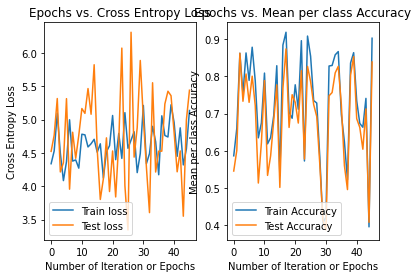

24
training cost: 5.3593396087172325
validation cost: 4.492770900403601
training accuracy: 0.7166910688140556
validation accuracy: 0.7653958944281525
time elapsed: 0.5166554729999007
learning rate: 0.1
momentum : 0.05
regularization: 0.1


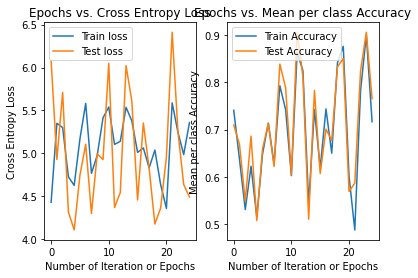

30
training cost: 4.899375111261713
validation cost: 5.362611576570711
training accuracy: 0.8272327964860908
validation accuracy: 0.7624633431085044
time elapsed: 0.6246789659999195
learning rate: 0.1
momentum : 0.05
regularization: 0.1


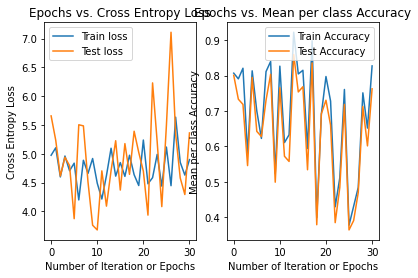

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.7777777777777778
44
training cost: 12.851952161751633
validation cost: 16.854369748102073
training accuracy: 0.35505124450951686
validation accuracy: 0.36656891495601174
time elapsed: 0.938433896999868
learning rate: 0.1
momentum : 0.05
regularization: 0.5


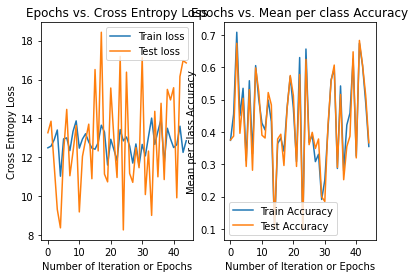

32
training cost: 11.797047004456212
validation cost: 10.893667744169859
training accuracy: 0.35724743777452417
validation accuracy: 0.2727272727272727
time elapsed: 0.6838561239997034
learning rate: 0.1
momentum : 0.05
regularization: 0.5


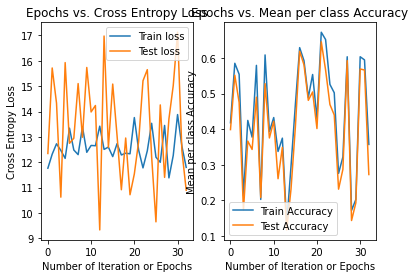

24
training cost: 12.400988799489898
validation cost: 17.241703630065665
training accuracy: 0.5197657393850659
validation accuracy: 0.49560117302052786
time elapsed: 0.506194098999913
learning rate: 0.1
momentum : 0.05
regularization: 0.5


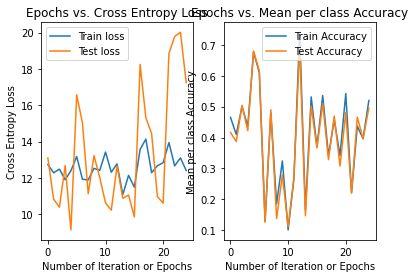

52
training cost: 11.636023247366241
validation cost: 18.257195304146528
training accuracy: 0.3967789165446559
validation accuracy: 0.39589442815249265
time elapsed: 1.0901406909997604
learning rate: 0.1
momentum : 0.05
regularization: 0.5


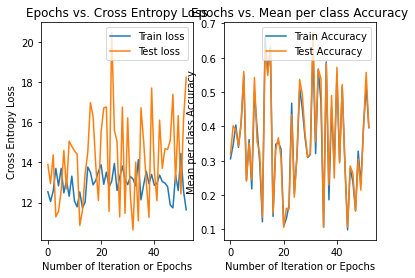

40
training cost: 13.48662780514722
validation cost: 15.849658552725293
training accuracy: 0.6310395314787701
validation accuracy: 0.6070381231671554
time elapsed: 0.8249896480001553
learning rate: 0.1
momentum : 0.05
regularization: 0.5


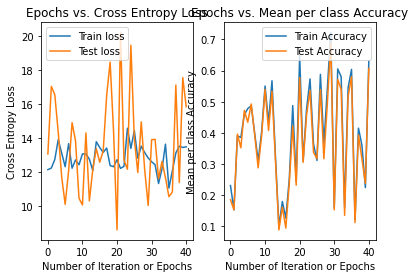

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.6333333333333333
41
training cost: 16.863213534348624
validation cost: 18.028548906152796
training accuracy: 0.47144948755490484
validation accuracy: 0.49853372434017595
time elapsed: 0.8665647869997883
learning rate: 0.1
momentum : 0.05
regularization: 0.9


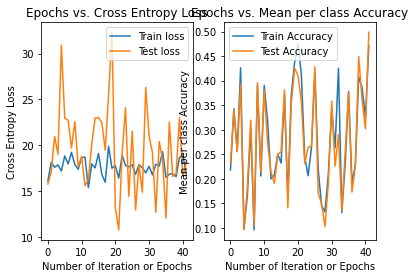

63
training cost: 17.522695072329554
validation cost: 18.973665220474796
training accuracy: 0.2664714494875549
validation accuracy: 0.20821114369501467
time elapsed: 1.3049208910001653
learning rate: 0.1
momentum : 0.05
regularization: 0.9


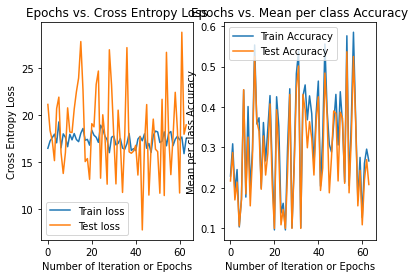

35
training cost: 17.534688087232173
validation cost: 15.89807018872601
training accuracy: 0.37042459736456806
validation accuracy: 0.3870967741935484
time elapsed: 0.739153080000051
learning rate: 0.1
momentum : 0.05
regularization: 0.9


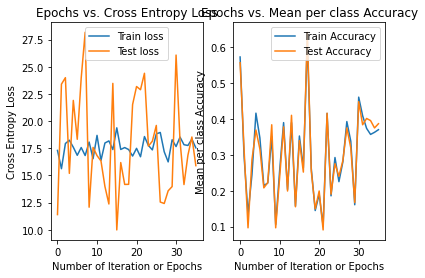

32
training cost: 18.618923041013318
validation cost: 14.515083295392627
training accuracy: 0.10907759882869693
validation accuracy: 0.10263929618768329
time elapsed: 0.6890591589999531
learning rate: 0.1
momentum : 0.05
regularization: 0.9


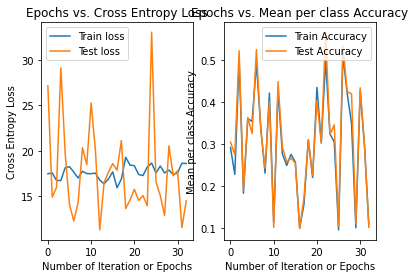

23
training cost: 18.629749734542468
validation cost: 16.694270477364718
training accuracy: 0.36676427525622257
validation accuracy: 0.3812316715542522
time elapsed: 0.49385131700000784
learning rate: 0.1
momentum : 0.05
regularization: 0.9


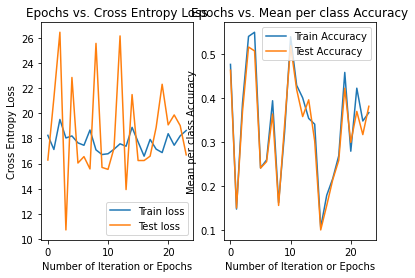

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.36666666666666664
32
training cost: 1.31495898265236
validation cost: 1.441302590049334
training accuracy: 0.945095168374817
validation accuracy: 0.9208211143695014
time elapsed: 0.2338986089998798
learning rate: 0.1
momentum : 0.05
regularization: 0.1


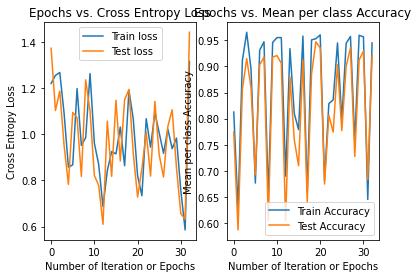

29
training cost: 0.8208041814865107
validation cost: 0.7310912438178302
training accuracy: 0.8740849194729137
validation accuracy: 0.8035190615835777
time elapsed: 0.22352439399992363
learning rate: 0.1
momentum : 0.05
regularization: 0.1


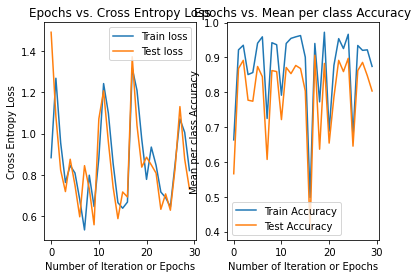

29
training cost: 0.6766980615771198
validation cost: 0.6267640717168551
training accuracy: 0.9114202049780381
validation accuracy: 0.8651026392961877
time elapsed: 0.21546739099994738
learning rate: 0.1
momentum : 0.05
regularization: 0.1


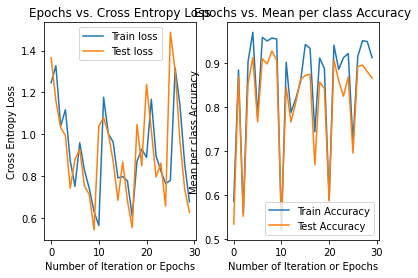

24
training cost: 0.9090548559945605
validation cost: 0.7794948956107178
training accuracy: 0.9641288433382138
validation accuracy: 0.9560117302052786
time elapsed: 0.19303582600014124
learning rate: 0.1
momentum : 0.05
regularization: 0.1


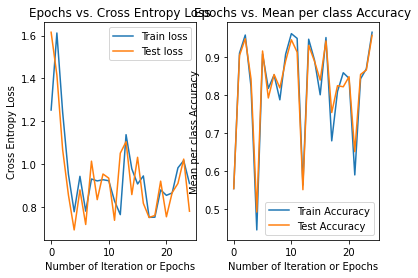

31
training cost: 0.7654936744935729
validation cost: 0.6964182028644493
training accuracy: 0.95900439238653
validation accuracy: 0.8973607038123167
time elapsed: 0.23060270799987848
learning rate: 0.1
momentum : 0.05
regularization: 0.1


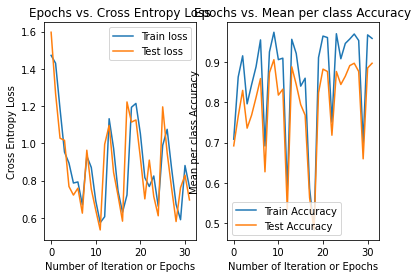

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.8888888888888888
49
training cost: 3.6061053572193194
validation cost: 5.692041992489688
training accuracy: 0.6346998535871157
validation accuracy: 0.6011730205278593
time elapsed: 0.36010623399988617
learning rate: 0.1
momentum : 0.05
regularization: 0.5


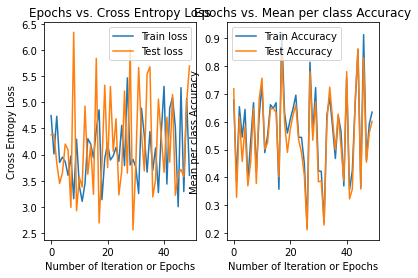

26
training cost: 4.080463000045909
validation cost: 3.1264263822903495
training accuracy: 0.6676427525622255
validation accuracy: 0.5366568914956011
time elapsed: 0.20259441700000025
learning rate: 0.1
momentum : 0.05
regularization: 0.5


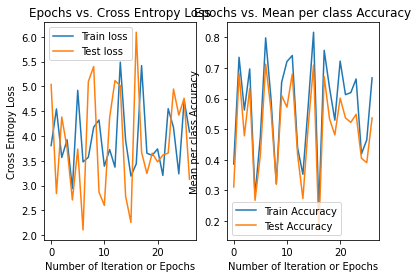

37
training cost: 3.477435690739767
validation cost: 2.6045628532376677
training accuracy: 0.4128843338213763
validation accuracy: 0.4398826979472141
time elapsed: 0.27282718700007536
learning rate: 0.1
momentum : 0.05
regularization: 0.5


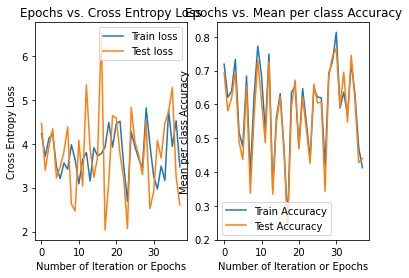

56
training cost: 4.294730918823142
validation cost: 3.204350349986882
training accuracy: 0.7972181551976574
validation accuracy: 0.8005865102639296
time elapsed: 0.4109160240000165
learning rate: 0.1
momentum : 0.05
regularization: 0.5


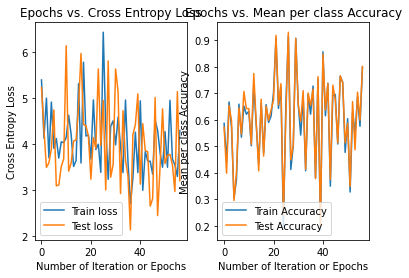

49
training cost: 4.220609446609772
validation cost: 3.4042080790812714
training accuracy: 0.8345534407027818
validation accuracy: 0.7976539589442815
time elapsed: 0.3657269579998683
learning rate: 0.1
momentum : 0.05
regularization: 0.5


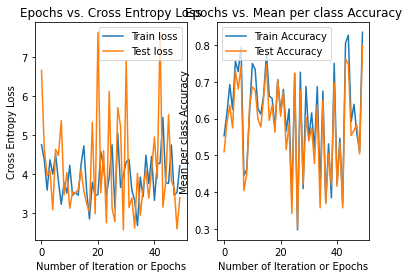

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.8
25
training cost: 7.216421087451704
validation cost: 5.299046413294973
training accuracy: 0.232796486090776
validation accuracy: 0.19941348973607037
time elapsed: 0.18980176299965024
learning rate: 0.1
momentum : 0.05
regularization: 0.9


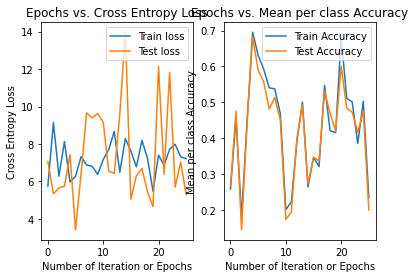

27
training cost: 8.17697686282082
validation cost: 6.263688031627557
training accuracy: 0.41142020497803805
validation accuracy: 0.34017595307917886
time elapsed: 0.212958635999712
learning rate: 0.1
momentum : 0.05
regularization: 0.9


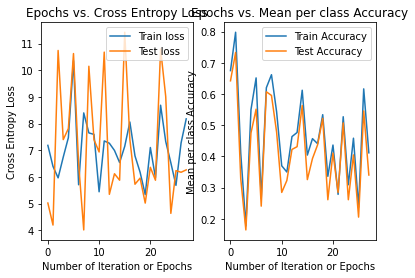

21
training cost: 7.54819891840669
validation cost: 6.62661680841336
training accuracy: 0.3308931185944363
validation accuracy: 0.31671554252199413
time elapsed: 0.1600806790002025
learning rate: 0.1
momentum : 0.05
regularization: 0.9


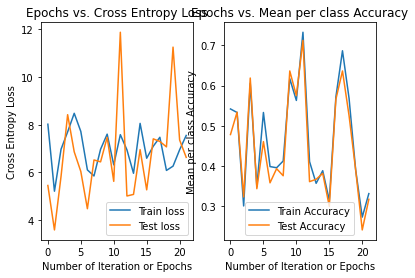

35
training cost: 5.344577135169269
validation cost: 5.1111702616371755
training accuracy: 0.5446559297218155
validation accuracy: 0.5601173020527859
time elapsed: 0.2814906329999758
learning rate: 0.1
momentum : 0.05
regularization: 0.9


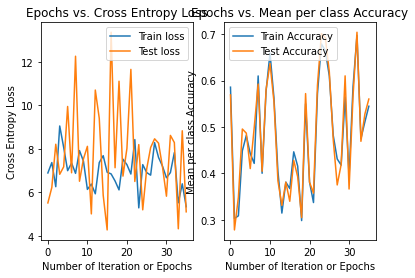

21
training cost: 5.276036975750648
validation cost: 7.3400371269327
training accuracy: 0.3923865300146413
validation accuracy: 0.33724340175953077
time elapsed: 0.1801246249997348
learning rate: 0.1
momentum : 0.05
regularization: 0.9


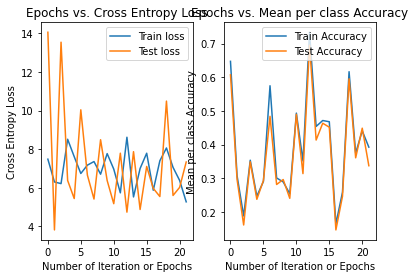

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.3333333333333333
40
training cost: 118.5202802635556
validation cost: 165.40070582458
training accuracy: 0.26939970717423134
validation accuracy: 0.24926686217008798
time elapsed: 5.369385037000029
learning rate: 0.1
momentum : 0.5
regularization: 0.1


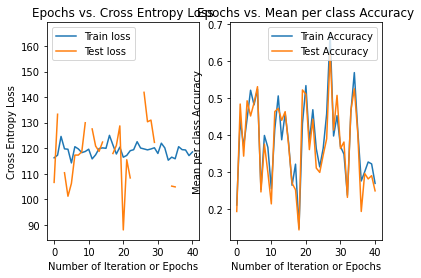

20
training cost: 115.37877345175738
validation cost: 99.40334122020819
training accuracy: 0.4143484626647145
validation accuracy: 0.3519061583577713
time elapsed: 2.7638533610002014
learning rate: 0.1
momentum : 0.5
regularization: 0.1


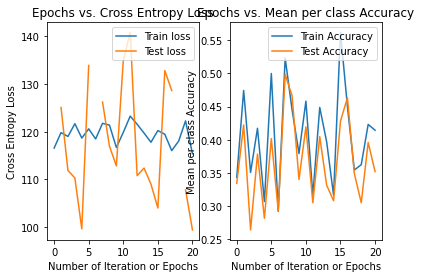

30
training cost: 117.13657152282101
validation cost: 109.65255907703374
training accuracy: 0.20131771595900438
validation accuracy: 0.1906158357771261
time elapsed: 4.222791035000228
learning rate: 0.1
momentum : 0.5
regularization: 0.1


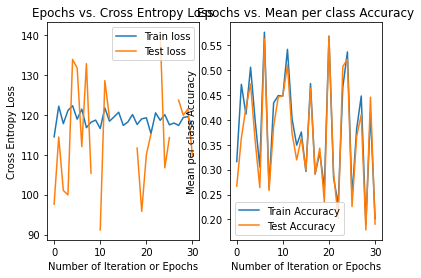

57
training cost: 118.08489685913568
validation cost: 100.97010209229597
training accuracy: 0.2964860907759883
validation accuracy: 0.2991202346041056
time elapsed: 7.872777316999873
learning rate: 0.1
momentum : 0.5
regularization: 0.1


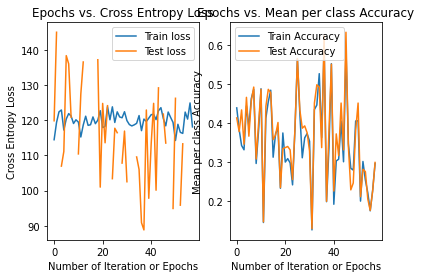

39
training cost: 119.07409632778673
validation cost: 106.0611312805487
training accuracy: 0.5717423133235725
validation accuracy: 0.5219941348973607
time elapsed: 5.457506837999972
learning rate: 0.1
momentum : 0.5
regularization: 0.1


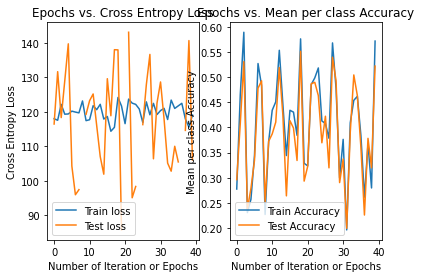

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.5
48
training cost: 137.24215212352448
validation cost: 115.18875566305667
training accuracy: 0.20497803806734993
validation accuracy: 0.1935483870967742
time elapsed: 6.64554720499973
learning rate: 0.1
momentum : 0.5
regularization: 0.5


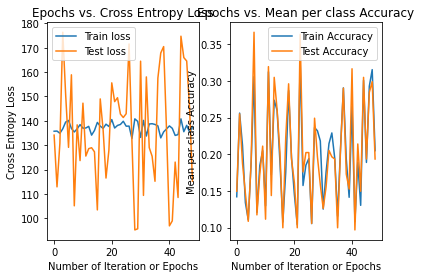

21
training cost: 139.4224505149685
validation cost: 153.88193714934454
training accuracy: 0.23792093704245973
validation accuracy: 0.20527859237536658
time elapsed: 2.9771463080001013
learning rate: 0.1
momentum : 0.5
regularization: 0.5


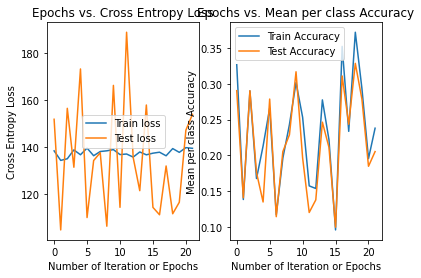

25
training cost: 135.6989645977501
validation cost: 133.39797366644692
training accuracy: 0.21376281112737922
validation accuracy: 0.17302052785923755
time elapsed: 3.4769504149999193
learning rate: 0.1
momentum : 0.5
regularization: 0.5


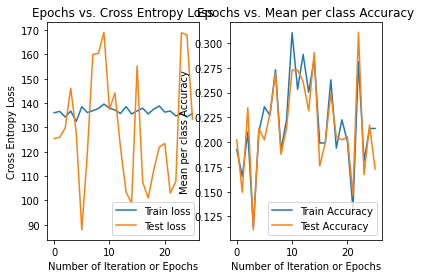

46
training cost: 138.18125704875985
validation cost: 120.78022007956417
training accuracy: 0.17862371888726208
validation accuracy: 0.15542521994134897
time elapsed: 6.255011079999804
learning rate: 0.1
momentum : 0.5
regularization: 0.5


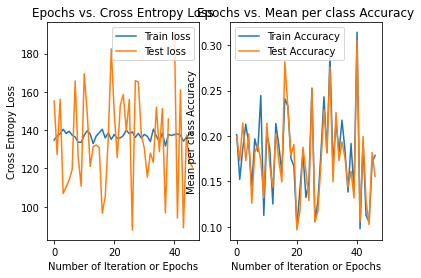

54
training cost: 140.7532943469824
validation cost: 135.9112813750018
training accuracy: 0.20131771595900438
validation accuracy: 0.1935483870967742
time elapsed: 7.332188193000093
learning rate: 0.1
momentum : 0.5
regularization: 0.5


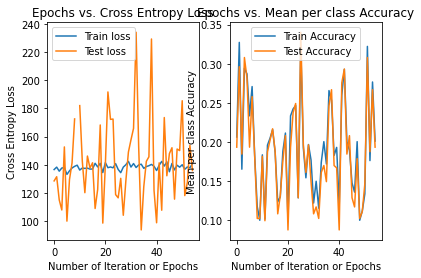

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.23333333333333334
20
training cost: 145.5024369936794
validation cost: 130.52693166004187
training accuracy: 0.2972181551976574
validation accuracy: 0.31085043988269795
time elapsed: 2.7868824629999835
learning rate: 0.1
momentum : 0.5
regularization: 0.9


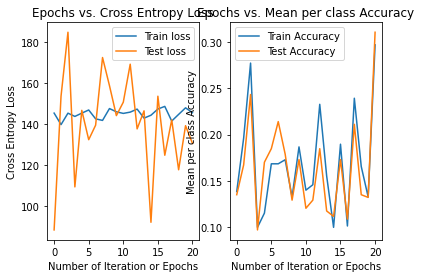

27
training cost: 145.8926585168154
validation cost: 132.86907492904103
training accuracy: 0.09956076134699854
validation accuracy: 0.10557184750733138
time elapsed: 3.668243600000096
learning rate: 0.1
momentum : 0.5
regularization: 0.9


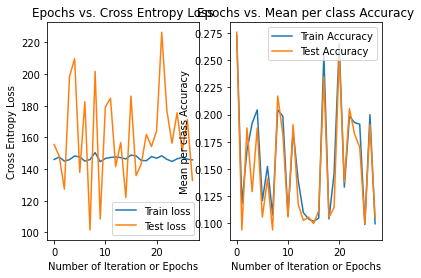

22
training cost: 142.5639582134839
validation cost: 156.85572812067727
training accuracy: 0.1617862371888726
validation accuracy: 0.12316715542521994
time elapsed: 3.036497725999652
learning rate: 0.1
momentum : 0.5
regularization: 0.9


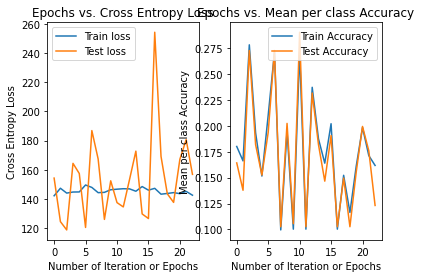

24
training cost: 145.2333913004862
validation cost: 200.23658309682406
training accuracy: 0.10175695461200586
validation accuracy: 0.09970674486803519
time elapsed: 3.3010410530000627
learning rate: 0.1
momentum : 0.5
regularization: 0.9


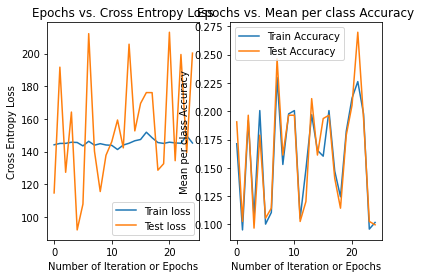

57
training cost: 147.29940194153278
validation cost: 131.225525814338
training accuracy: 0.12298682284040996
validation accuracy: 0.1348973607038123
time elapsed: 7.902534998999727
learning rate: 0.1
momentum : 0.5
regularization: 0.9


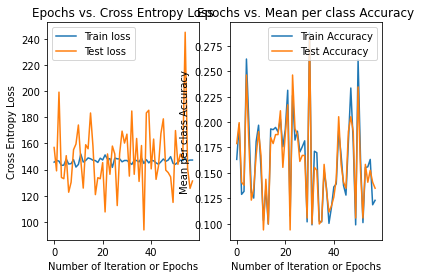

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.08888888888888889
37
training cost: 8.78407248953633
validation cost: 8.742784110597716
training accuracy: 0.6734992679355783
validation accuracy: 0.5894428152492669
time elapsed: 0.7830378089997794
learning rate: 0.1
momentum : 0.5
regularization: 0.1


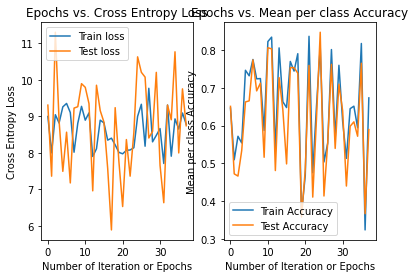

57
training cost: 8.853048637714299
validation cost: 8.112437424435482
training accuracy: 0.7445095168374817
validation accuracy: 0.656891495601173
time elapsed: 1.1973900190000677
learning rate: 0.1
momentum : 0.5
regularization: 0.1


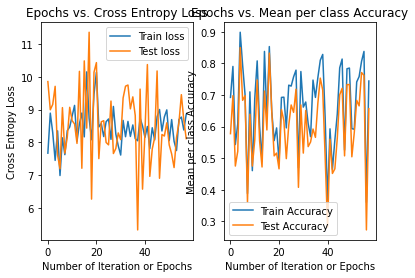

20
training cost: 8.160804791961606
validation cost: 6.703455796589077
training accuracy: 0.8316251830161054
validation accuracy: 0.8064516129032258
time elapsed: 0.43632862399999794
learning rate: 0.1
momentum : 0.5
regularization: 0.1


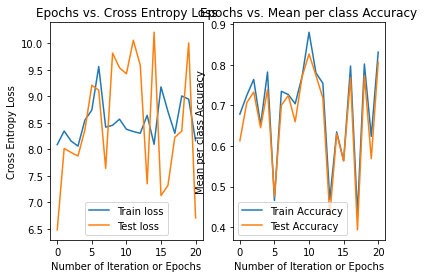

55
training cost: 9.540535229215987
validation cost: 9.577658837640376
training accuracy: 0.6449487554904831
validation accuracy: 0.6217008797653959
time elapsed: 1.1433674580002844
learning rate: 0.1
momentum : 0.5
regularization: 0.1


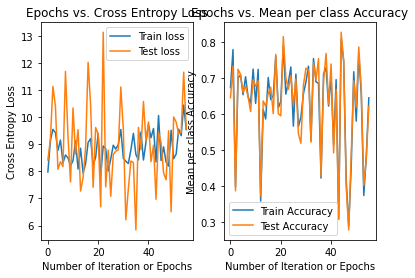

29
training cost: 8.559868781583743
validation cost: 8.241914310895602
training accuracy: 0.7284040995607614
validation accuracy: 0.6774193548387096
time elapsed: 0.609172646999923
learning rate: 0.1
momentum : 0.5
regularization: 0.1


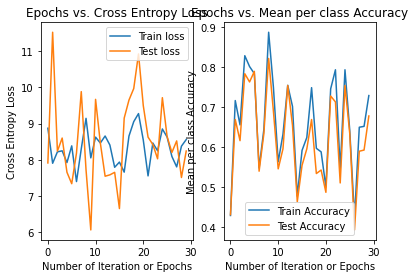

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.5666666666666667
63
training cost: 19.434928085520937
validation cost: 19.718409874415563
training accuracy: 0.17496339677891654
validation accuracy: 0.17595307917888564
time elapsed: 1.311693871999978
learning rate: 0.1
momentum : 0.5
regularization: 0.5


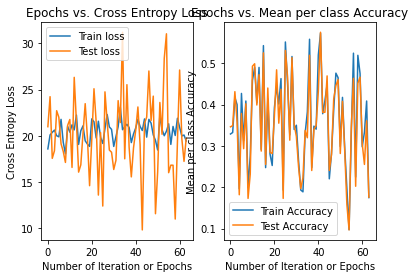

22
training cost: 20.519921109320467
validation cost: 16.27017238520877
training accuracy: 0.4172767203513909
validation accuracy: 0.3489736070381232
time elapsed: 0.4772817129996838
learning rate: 0.1
momentum : 0.5
regularization: 0.5


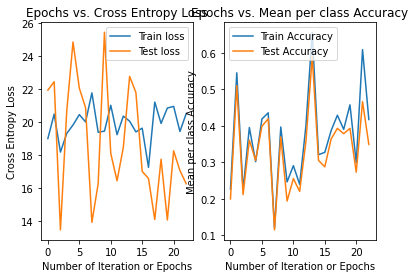

48
training cost: 20.346890473960944
validation cost: 28.01357425581825
training accuracy: 0.2935578330893119
validation accuracy: 0.2697947214076246
time elapsed: 1.0545122180001272
learning rate: 0.1
momentum : 0.5
regularization: 0.5


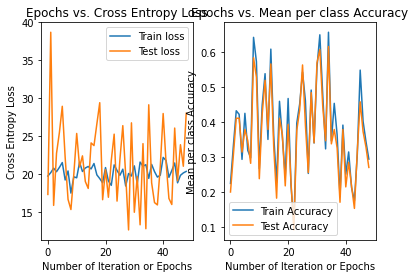

28
training cost: 20.168090785368552
validation cost: 20.750751306835127
training accuracy: 0.3462664714494876
validation accuracy: 0.36656891495601174
time elapsed: 0.6222881849998885
learning rate: 0.1
momentum : 0.5
regularization: 0.5


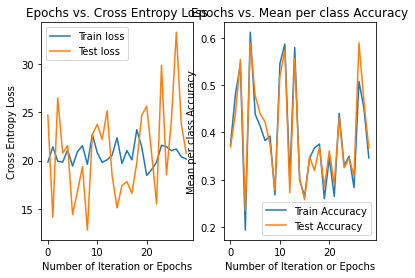

30
training cost: 18.637477104484017
validation cost: 22.755046643701775
training accuracy: 0.15080527086383602
validation accuracy: 0.10850439882697947
time elapsed: 0.6303953050000928
learning rate: 0.1
momentum : 0.5
regularization: 0.5


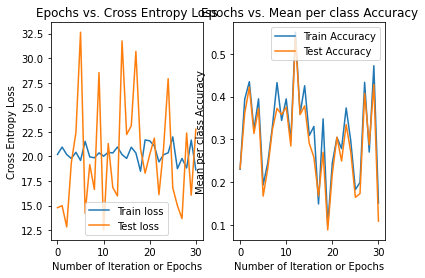

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.15555555555555556
21
training cost: 28.017415746803646
validation cost: 28.20820690927791
training accuracy: 0.10102489019033675
validation accuracy: 0.09970674486803519
time elapsed: 0.4978937370001404
learning rate: 0.1
momentum : 0.5
regularization: 0.9


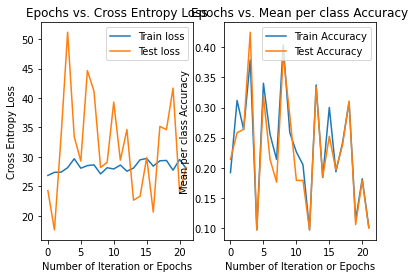

66
training cost: 29.225504166144468
validation cost: 30.596353744524567
training accuracy: 0.3396778916544656
validation accuracy: 0.31085043988269795
time elapsed: 1.3964953609997792
learning rate: 0.1
momentum : 0.5
regularization: 0.9


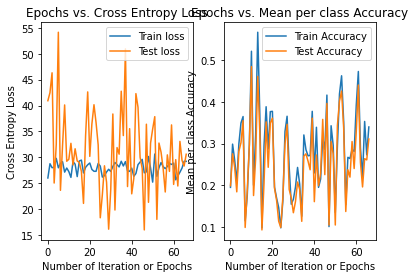

27
training cost: 27.58674669083902
validation cost: 42.77954960465858
training accuracy: 0.10029282576866765
validation accuracy: 0.10557184750733138
time elapsed: 0.5542991259999326
learning rate: 0.1
momentum : 0.5
regularization: 0.9


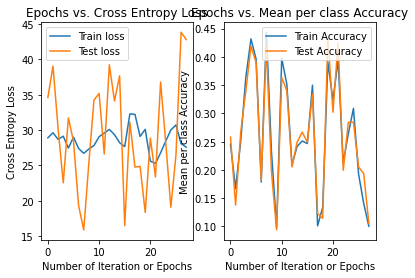

23
training cost: 29.070114566805483
validation cost: 39.19252581842063
training accuracy: 0.49487554904831627
validation accuracy: 0.5102639296187683
time elapsed: 0.5102341739998337
learning rate: 0.1
momentum : 0.5
regularization: 0.9


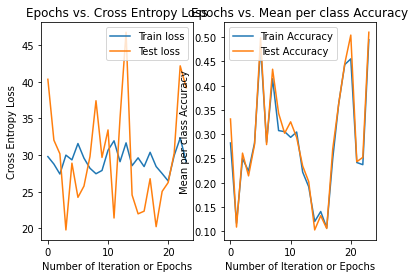

104
training cost: 29.463688220375133
validation cost: 18.425830555762303
training accuracy: 0.3740849194729136
validation accuracy: 0.3225806451612903
time elapsed: 2.260284526000305
learning rate: 0.1
momentum : 0.5
regularization: 0.9


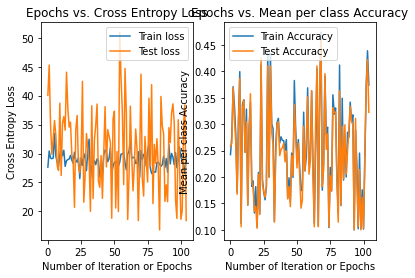

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.32222222222222224
50
training cost: 0.9691733360799006
validation cost: 0.9918326601953745
training accuracy: 0.8667642752562226
validation accuracy: 0.8240469208211144
time elapsed: 0.36400933499999155
learning rate: 0.1
momentum : 0.5
regularization: 0.1


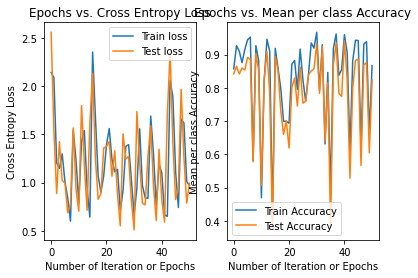

42
training cost: 0.8557934087324763
validation cost: 0.8588692899320941
training accuracy: 0.8967789165446559
validation accuracy: 0.8592375366568915
time elapsed: 0.31783188999997947
learning rate: 0.1
momentum : 0.5
regularization: 0.1


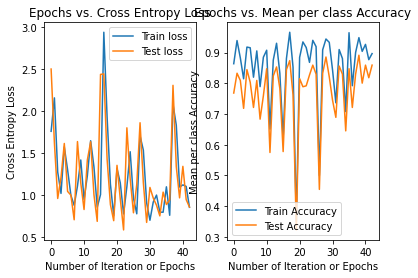

44
training cost: 1.1227943384290586
validation cost: 1.487635884109734
training accuracy: 0.8960468521229868
validation accuracy: 0.8621700879765396
time elapsed: 0.31716356300012194
learning rate: 0.1
momentum : 0.5
regularization: 0.1


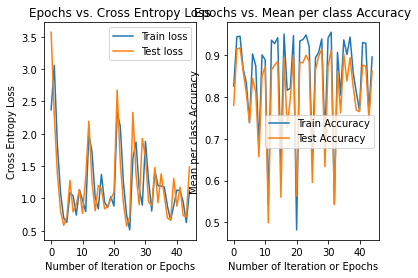

57
training cost: 1.2172002871002745
validation cost: 1.1457917332811973
training accuracy: 0.9275256222547584
validation accuracy: 0.9325513196480938
time elapsed: 0.4240556879999531
learning rate: 0.1
momentum : 0.5
regularization: 0.1


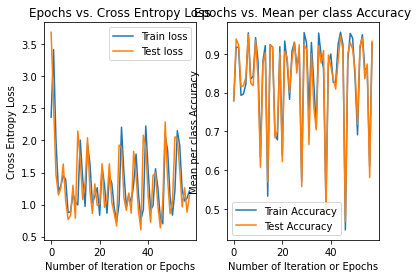

23
training cost: 1.2683463283129421
validation cost: 1.0203026210451178
training accuracy: 0.9143484626647145
validation accuracy: 0.8533724340175953
time elapsed: 0.19012599799998497
learning rate: 0.1
momentum : 0.5
regularization: 0.1


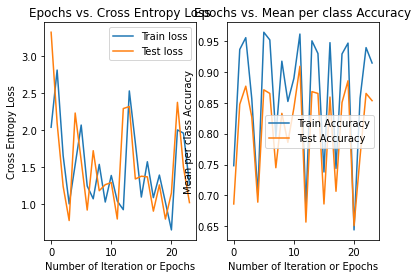

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.8222222222222222
32
training cost: 4.848542464469641
validation cost: 8.189366988580803
training accuracy: 0.3279648609077599
validation accuracy: 0.3548387096774194
time elapsed: 0.24775445899967963
learning rate: 0.1
momentum : 0.5
regularization: 0.5


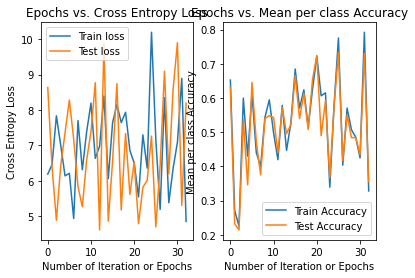

30
training cost: 7.421155622410315
validation cost: 10.680147235640575
training accuracy: 0.5636896046852123
validation accuracy: 0.5278592375366569
time elapsed: 0.227813771000001
learning rate: 0.1
momentum : 0.5
regularization: 0.5


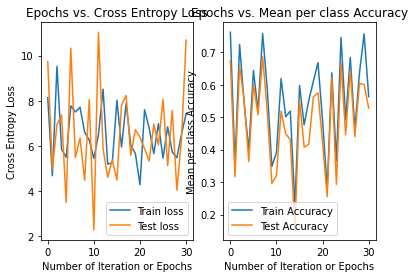

61
training cost: 5.369470899682424
validation cost: 8.404956242420722
training accuracy: 0.3191800878477306
validation accuracy: 0.2756598240469208
time elapsed: 0.43918958399990515
learning rate: 0.1
momentum : 0.5
regularization: 0.5


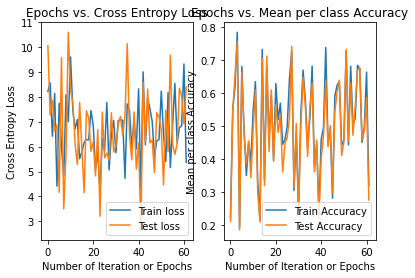

21
training cost: 8.908942583980037
validation cost: 11.72087245333785
training accuracy: 0.6222547584187409
validation accuracy: 0.5865102639296188
time elapsed: 0.16922911600022417
learning rate: 0.1
momentum : 0.5
regularization: 0.5


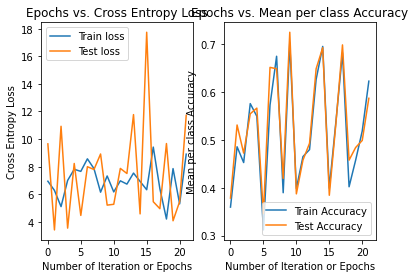

54
training cost: 6.689460313818204
validation cost: 6.122708363352396
training accuracy: 0.4685212298682284
validation accuracy: 0.45161290322580644
time elapsed: 0.40059738599984485
learning rate: 0.1
momentum : 0.5
regularization: 0.5


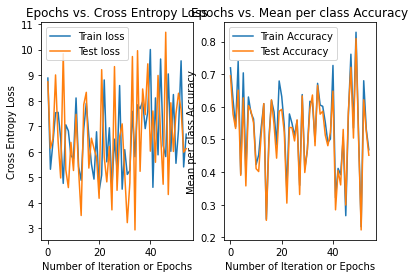

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.4
27
training cost: 11.162445956789355
validation cost: 9.155945460770859
training accuracy: 0.5073206442166911
validation accuracy: 0.4838709677419355
time elapsed: 0.21203253599969685
learning rate: 0.1
momentum : 0.5
regularization: 0.9


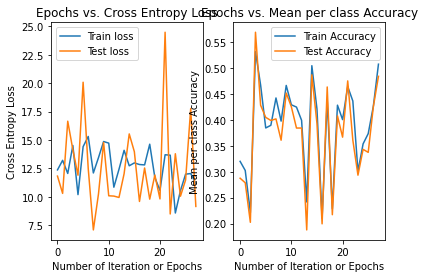

49
training cost: 11.392797200500658
validation cost: 13.223389230240098
training accuracy: 0.43045387994143486
validation accuracy: 0.41055718475073316
time elapsed: 0.3497866999996404
learning rate: 0.1
momentum : 0.5
regularization: 0.9


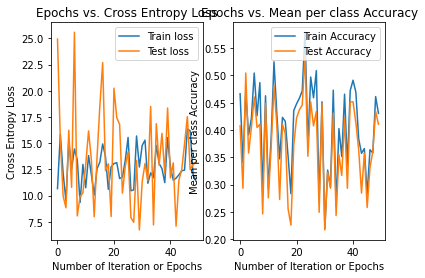

49
training cost: 11.502662743854856
validation cost: 8.735854194797446
training accuracy: 0.29282576866764276
validation accuracy: 0.31671554252199413
time elapsed: 0.3753185390000908
learning rate: 0.1
momentum : 0.5
regularization: 0.9


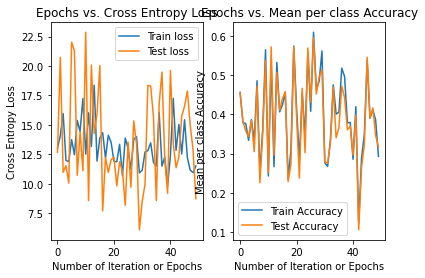

20
training cost: 10.689052705113685
validation cost: 18.09350978224271
training accuracy: 0.47144948755490484
validation accuracy: 0.4574780058651026
time elapsed: 0.15872931600006268
learning rate: 0.1
momentum : 0.5
regularization: 0.9


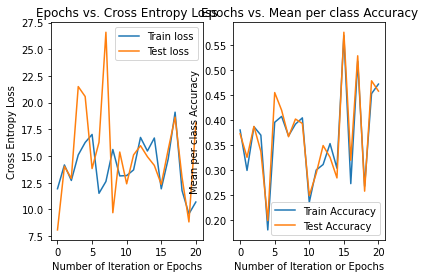

46
training cost: 11.230713815819573
validation cost: 12.169343805726836
training accuracy: 0.3623718887262079
validation accuracy: 0.3460410557184751
time elapsed: 0.33727763900014907
learning rate: 0.1
momentum : 0.5
regularization: 0.9


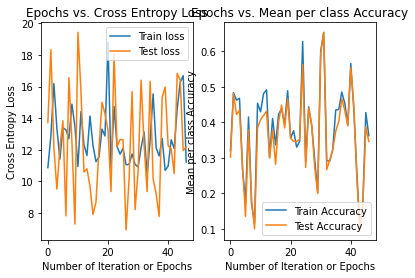

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.9736070381231672
Average cross validation score: 0.9545454545454546
Accuracy on test: 0.36666666666666664


In [12]:
trainOnData(digits)

34
training cost: 1.2916195504337324
validation cost: 0.7349257729288827
training accuracy: 0.7071290944123314
validation accuracy: 0.5503875968992248
time elapsed: 1.9671214790000704
learning rate: 0.001
momentum : 0.005
regularization: 0.1


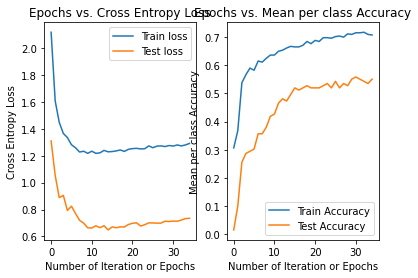

33
training cost: 1.270883296722961
validation cost: 0.7814712909696602
training accuracy: 0.8015414258188824
validation accuracy: 0.5736434108527132
time elapsed: 1.933461411999815
learning rate: 0.001
momentum : 0.005
regularization: 0.1


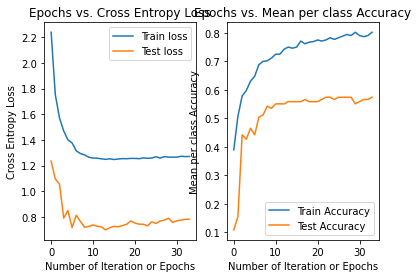

31
training cost: 1.277468916321136
validation cost: 0.8119746718668794
training accuracy: 0.7726396917148363
validation accuracy: 0.5503875968992248
time elapsed: 1.8263993870000377
learning rate: 0.001
momentum : 0.005
regularization: 0.1


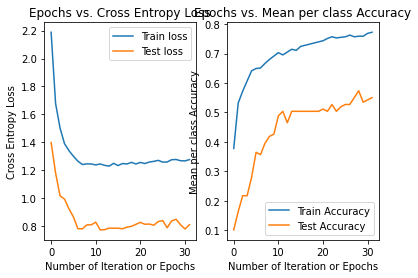

24
training cost: 1.1545801501324156
validation cost: 0.9149230982986911
training accuracy: 0.7263969171483622
validation accuracy: 0.34108527131782945
time elapsed: 1.413208678999581
learning rate: 0.001
momentum : 0.005
regularization: 0.1


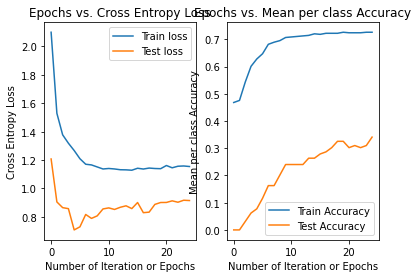

28
training cost: 1.3723720686500853
validation cost: 0.8788610804160764
training accuracy: 0.791907514450867
validation accuracy: 0.7286821705426356
time elapsed: 1.641329553000105
learning rate: 0.001
momentum : 0.005
regularization: 0.1


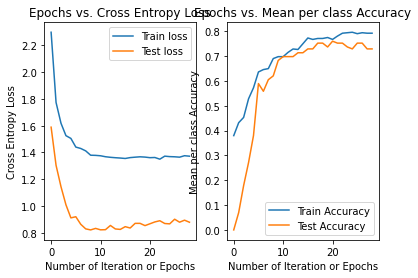

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7286821705426356
Average cross validation score: 0.6175710594315246
Accuracy on test: 0.02857142857142857
22
training cost: 1.7553589197107242
validation cost: 1.3112756149097815
training accuracy: 0.5703275529865125
validation accuracy: 0.26356589147286824
time elapsed: 1.2910488059997078
learning rate: 0.001
momentum : 0.005
regularization: 0.5


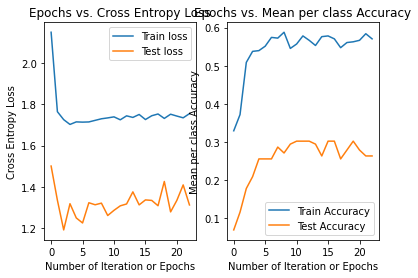

32
training cost: 1.8821008494373366
validation cost: 1.3191959337930204
training accuracy: 0.6011560693641619
validation accuracy: 0.4496124031007752
time elapsed: 1.8410059160000856
learning rate: 0.001
momentum : 0.005
regularization: 0.5


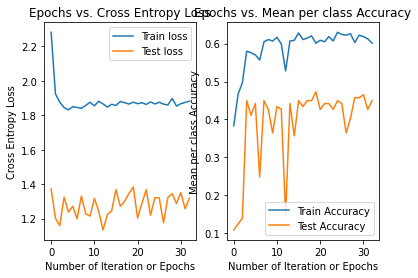

23
training cost: 1.7815403575408941
validation cost: 1.4093026034262262
training accuracy: 0.6107899807321773
validation accuracy: 0.21705426356589147
time elapsed: 1.3301265999998577
learning rate: 0.001
momentum : 0.005
regularization: 0.5


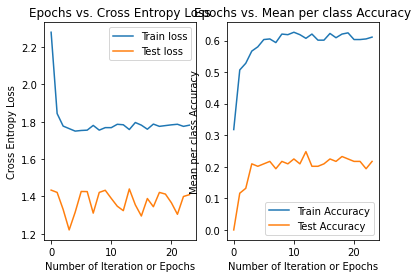

39
training cost: 1.7014439105511199
validation cost: 1.2206610093706756
training accuracy: 0.6146435452793835
validation accuracy: 0.06976744186046512
time elapsed: 2.334418364999692
learning rate: 0.001
momentum : 0.005
regularization: 0.5


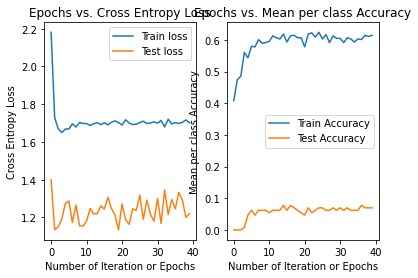

34
training cost: 1.9367664183941606
validation cost: 1.4863820933104084
training accuracy: 0.5337186897880539
validation accuracy: 0.32558139534883723
time elapsed: 1.9633668480000779
learning rate: 0.001
momentum : 0.005
regularization: 0.5


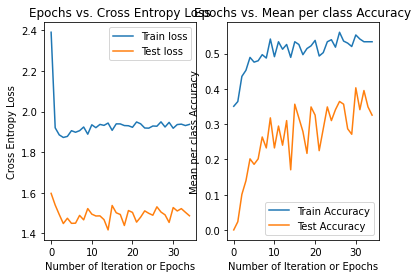

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7286821705426356
Average cross validation score: 0.6175710594315246
Accuracy on test: 0.0
41
training cost: 1.91754318170609
validation cost: 1.3899564282698398
training accuracy: 0.47398843930635837
validation accuracy: 0.17829457364341086
time elapsed: 2.395258836999801
learning rate: 0.001
momentum : 0.005
regularization: 0.9


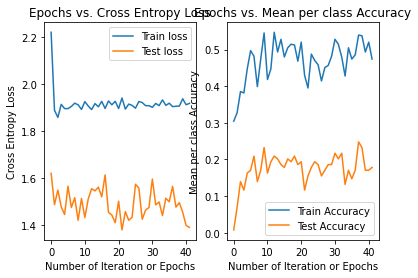

33
training cost: 2.050577428449915
validation cost: 1.3969204751443898
training accuracy: 0.5067437379576107
validation accuracy: 0.13953488372093023
time elapsed: 1.896267005000027
learning rate: 0.001
momentum : 0.005
regularization: 0.9


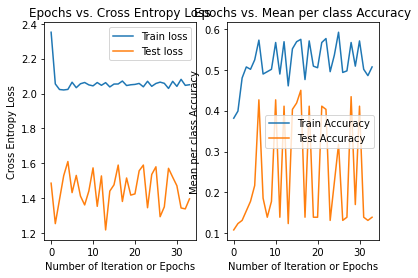

43
training cost: 1.9594581276626761
validation cost: 1.6376556503569857
training accuracy: 0.5761078998073218
validation accuracy: 0.18604651162790697
time elapsed: 2.5209617119999166
learning rate: 0.001
momentum : 0.005
regularization: 0.9


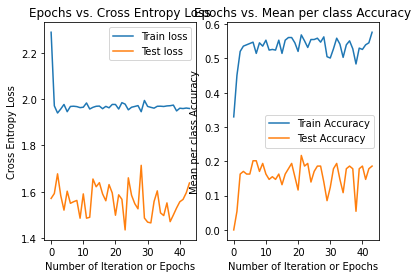

30
training cost: 1.8780678760492382
validation cost: 1.4134214469043545
training accuracy: 0.5337186897880539
validation accuracy: 0.007751937984496124
time elapsed: 1.7287914570001703
learning rate: 0.001
momentum : 0.005
regularization: 0.9


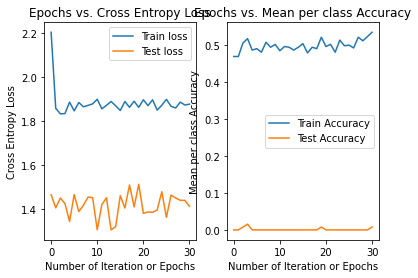

24
training cost: 2.0791582865408897
validation cost: 1.6999674478860813
training accuracy: 0.43352601156069365
validation accuracy: 0.08527131782945736
time elapsed: 1.6548023640002612
learning rate: 0.001
momentum : 0.005
regularization: 0.9


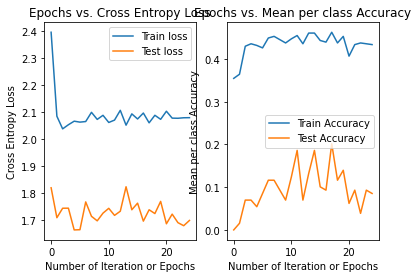

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7286821705426356
Average cross validation score: 0.6175710594315246
Accuracy on test: 0.0
154
training cost: 0.7270113667298221
validation cost: 0.6668425313740176
training accuracy: 0.6647398843930635
validation accuracy: 0.5038759689922481
time elapsed: 1.2918493090000993
learning rate: 0.001
momentum : 0.005
regularization: 0.1


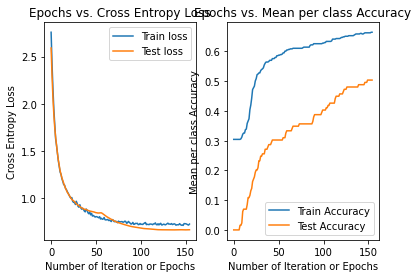

133
training cost: 0.6845439246592624
validation cost: 0.7203439809395922
training accuracy: 0.74373795761079
validation accuracy: 0.5581395348837209
time elapsed: 1.123986959999911
learning rate: 0.001
momentum : 0.005
regularization: 0.1


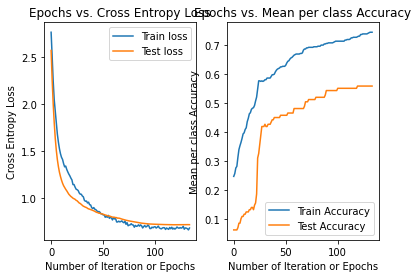

124
training cost: 0.7077720007537973
validation cost: 0.775896617704531
training accuracy: 0.7109826589595376
validation accuracy: 0.4883720930232558
time elapsed: 1.0367666289998851
learning rate: 0.001
momentum : 0.005
regularization: 0.1


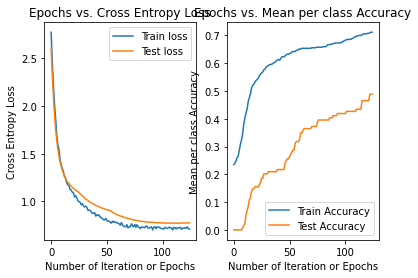

73
training cost: 0.6672363952511642
validation cost: 0.7863756636449191
training accuracy: 0.6897880539499036
validation accuracy: 0.16279069767441862
time elapsed: 0.6123181920002025
learning rate: 0.001
momentum : 0.005
regularization: 0.1


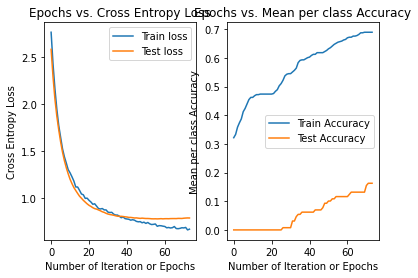

128
training cost: 0.715935183931424
validation cost: 0.819937747238566
training accuracy: 0.7321772639691715
validation accuracy: 0.7054263565891473
time elapsed: 1.0711400380000669
learning rate: 0.001
momentum : 0.005
regularization: 0.1


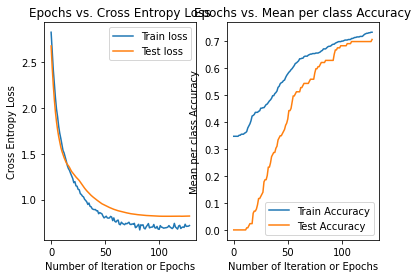

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7286821705426356
Average cross validation score: 0.6175710594315246
Accuracy on test: 0.0
62
training cost: 1.2381579158739298
validation cost: 1.262868309277377
training accuracy: 0.5375722543352601
validation accuracy: 0.24806201550387597
time elapsed: 0.5598156029996062
learning rate: 0.001
momentum : 0.005
regularization: 0.5


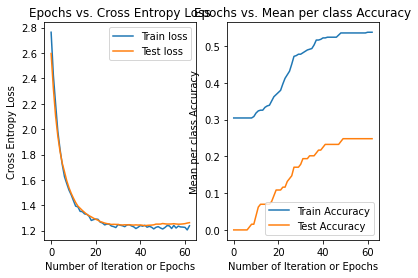

50
training cost: 1.364565457255109
validation cost: 1.2456091817606014
training accuracy: 0.581888246628131
validation accuracy: 0.4186046511627907
time elapsed: 0.43781444499973077
learning rate: 0.001
momentum : 0.005
regularization: 0.5


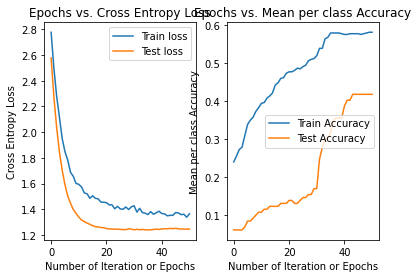

52
training cost: 1.2713111270411683
validation cost: 1.3663444179906241
training accuracy: 0.5915221579961464
validation accuracy: 0.20930232558139536
time elapsed: 0.4400903149999067
learning rate: 0.001
momentum : 0.005
regularization: 0.5


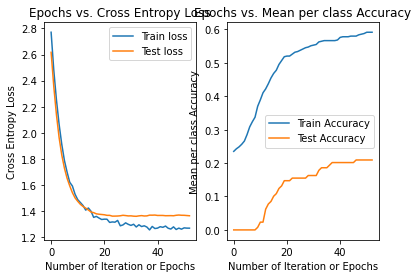

58
training cost: 1.1938242560353451
validation cost: 1.1969097605075432
training accuracy: 0.5684007707129094
validation accuracy: 0.046511627906976744
time elapsed: 0.49636192900015885
learning rate: 0.001
momentum : 0.005
regularization: 0.5


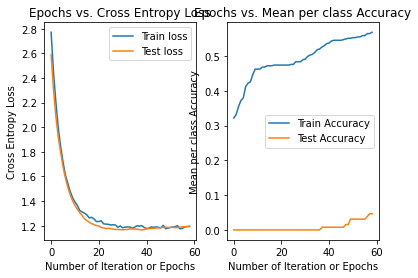

90
training cost: 1.3391904351941584
validation cost: 1.4770280941634588
training accuracy: 0.5048169556840078
validation accuracy: 0.2713178294573643
time elapsed: 0.7606387690002521
learning rate: 0.001
momentum : 0.005
regularization: 0.5


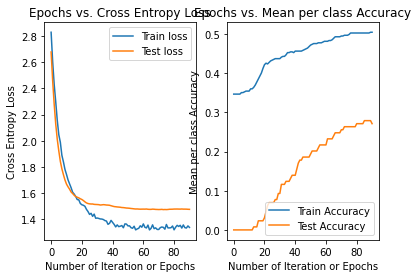

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7286821705426356
Average cross validation score: 0.6175710594315246
Accuracy on test: 0.0
54
training cost: 1.447065989618114
validation cost: 1.4682551408647089
training accuracy: 0.4605009633911368
validation accuracy: 0.17054263565891473
time elapsed: 0.4723598700002185
learning rate: 0.001
momentum : 0.005
regularization: 0.9


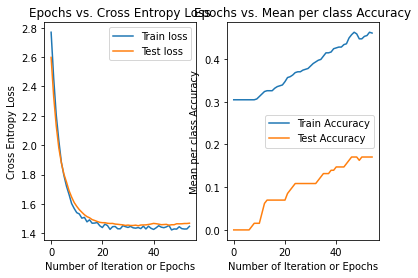

40
training cost: 1.5898538184230209
validation cost: 1.4327816218034028
training accuracy: 0.48747591522157996
validation accuracy: 0.13178294573643412
time elapsed: 0.4318009990001883
learning rate: 0.001
momentum : 0.005
regularization: 0.9


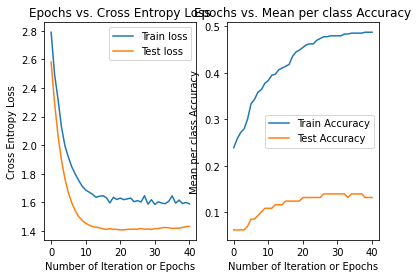

40
training cost: 1.4819209396202881
validation cost: 1.5469705360882249
training accuracy: 0.5337186897880539
validation accuracy: 0.15503875968992248
time elapsed: 0.34717588300009083
learning rate: 0.001
momentum : 0.005
regularization: 0.9


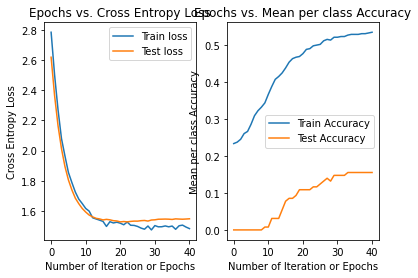

47
training cost: 1.4207371542973808
validation cost: 1.4019875218067812
training accuracy: 0.4836223506743738
validation accuracy: 0.0
time elapsed: 0.4125004419997822
learning rate: 0.001
momentum : 0.005
regularization: 0.9


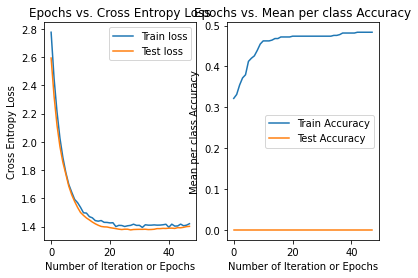

40
training cost: 1.6573571211425517
validation cost: 1.728665455061134
training accuracy: 0.43545279383429675
validation accuracy: 0.06976744186046512
time elapsed: 0.3479012450002301
learning rate: 0.001
momentum : 0.005
regularization: 0.9


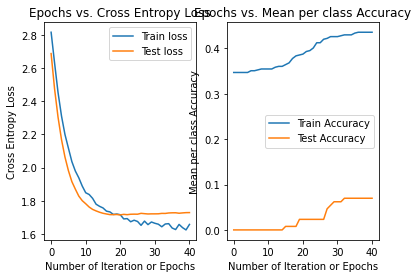

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7286821705426356
Average cross validation score: 0.6175710594315246
Accuracy on test: 0.0
training cost: 0.7826029114555152
validation cost: 0.9068629876769375
training accuracy: 0.5433526011560693
validation accuracy: 0.2558139534883721
time elapsed: 1.0369956780000393
learning rate: 0.001
momentum : 0.005
regularization: 0.1


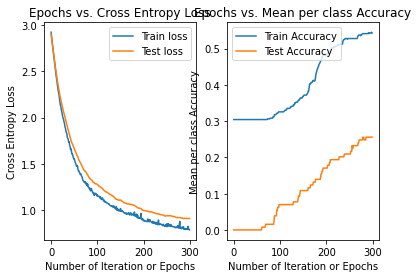

training cost: 0.8364218436001744
validation cost: 0.9243795957097238
training accuracy: 0.5838150289017341
validation accuracy: 0.4418604651162791
time elapsed: 0.977862864999679
learning rate: 0.001
momentum : 0.005
regularization: 0.1


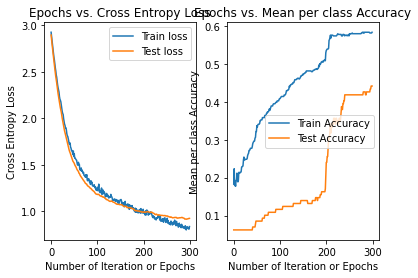

training cost: 0.7652514756941581
validation cost: 1.004006404817038
training accuracy: 0.5953757225433526
validation accuracy: 0.20930232558139536
time elapsed: 0.9887093130000721
learning rate: 0.001
momentum : 0.005
regularization: 0.1


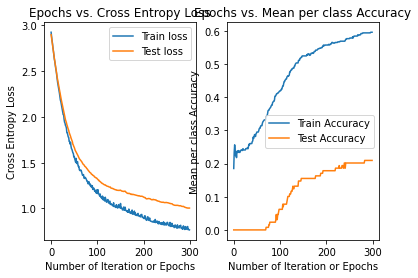

training cost: 0.7167882804269315
validation cost: 0.8225666760136341
training accuracy: 0.5780346820809249
validation accuracy: 0.05426356589147287
time elapsed: 0.9828097120002894
learning rate: 0.001
momentum : 0.005
regularization: 0.1


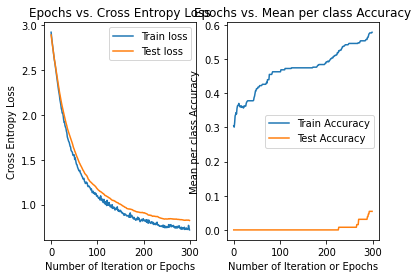

training cost: 0.8091796945699192
validation cost: 1.0845134813151271
training accuracy: 0.4836223506743738
validation accuracy: 0.24031007751937986
time elapsed: 1.0682740289998947
learning rate: 0.001
momentum : 0.005
regularization: 0.1


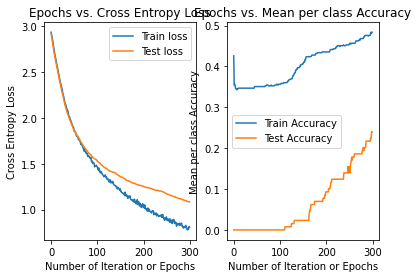

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7286821705426356
Average cross validation score: 0.6175710594315246
Accuracy on test: 0.0
253
training cost: 1.1300326021471718
validation cost: 1.2546455168905013
training accuracy: 0.47784200385356457
validation accuracy: 0.17054263565891473
time elapsed: 0.8419502110000394
learning rate: 0.001
momentum : 0.005
regularization: 0.5


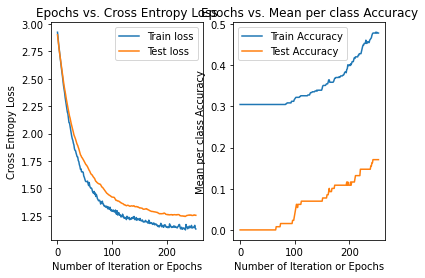

185
training cost: 1.2631908319585683
validation cost: 1.250502547155357
training accuracy: 0.47784200385356457
validation accuracy: 0.13953488372093023
time elapsed: 0.6248169119999147
learning rate: 0.001
momentum : 0.005
regularization: 0.5


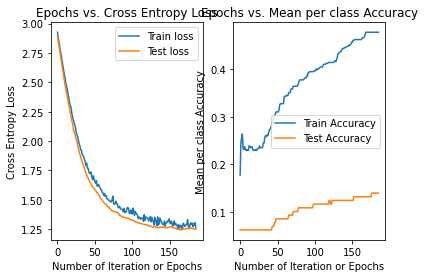

185
training cost: 1.1663432684375705
validation cost: 1.361503129191714
training accuracy: 0.5240847784200385
validation accuracy: 0.15503875968992248
time elapsed: 0.6430729479998263
learning rate: 0.001
momentum : 0.005
regularization: 0.5


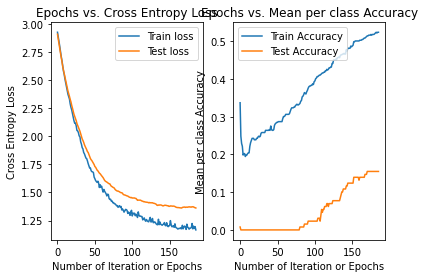

197
training cost: 1.0969509298629194
validation cost: 1.1816889965670396
training accuracy: 0.47398843930635837
validation accuracy: 0.0
time elapsed: 0.675541179999982
learning rate: 0.001
momentum : 0.005
regularization: 0.5


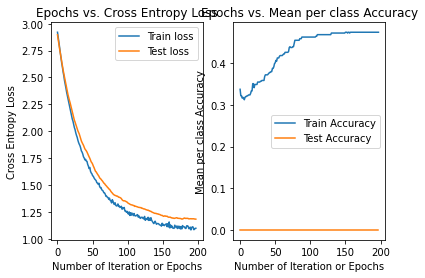

184
training cost: 1.379810145789364
validation cost: 1.5519790208214046
training accuracy: 0.4258188824662813
validation accuracy: 0.046511627906976744
time elapsed: 0.6082857720002721
learning rate: 0.001
momentum : 0.005
regularization: 0.5


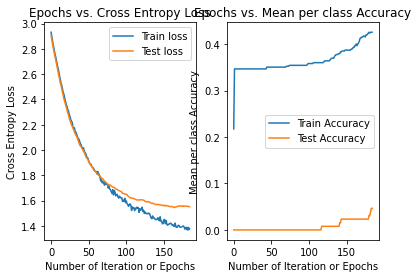

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7286821705426356
Average cross validation score: 0.6175710594315246
Accuracy on test: 0.0
238
training cost: 1.3322097135254873
validation cost: 1.4507184316883734
training accuracy: 0.37572254335260113
validation accuracy: 0.10852713178294573
time elapsed: 0.8040568219998931
learning rate: 0.001
momentum : 0.005
regularization: 0.9


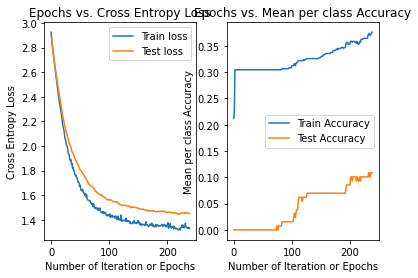

208
training cost: 1.4496171756808633
validation cost: 1.406713043656671
training accuracy: 0.4624277456647399
validation accuracy: 0.13178294573643412
time elapsed: 0.6893226909996883
learning rate: 0.001
momentum : 0.005
regularization: 0.9


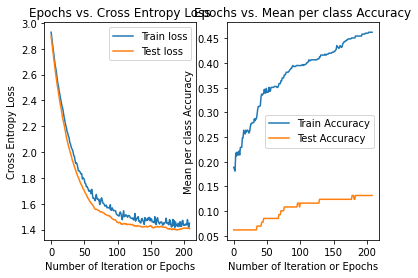

154
training cost: 1.3761959233952712
validation cost: 1.5380660205593117
training accuracy: 0.4624277456647399
validation accuracy: 0.08527131782945736
time elapsed: 0.5163301050001792
learning rate: 0.001
momentum : 0.005
regularization: 0.9


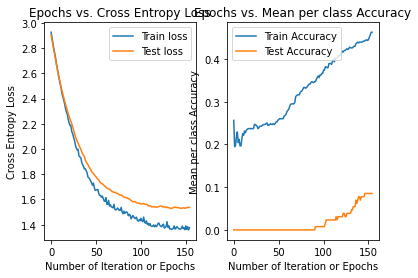

197
training cost: 1.3013566362488909
validation cost: 1.3943635553116804
training accuracy: 0.47398843930635837
validation accuracy: 0.0
time elapsed: 0.6484425650000958
learning rate: 0.001
momentum : 0.005
regularization: 0.9


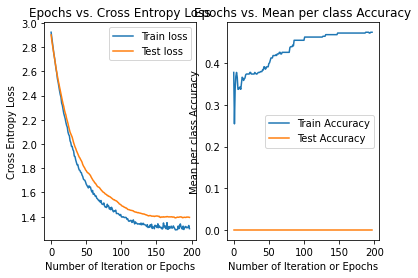

190
training cost: 1.6117712517519696
validation cost: 1.725953082313458
training accuracy: 0.3930635838150289
validation accuracy: 0.023255813953488372
time elapsed: 0.6267461349998484
learning rate: 0.001
momentum : 0.005
regularization: 0.9


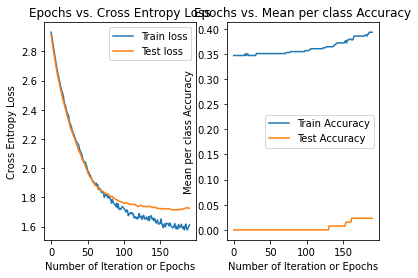

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7286821705426356
Average cross validation score: 0.6175710594315246
Accuracy on test: 0.0
33
training cost: 1.286301063151337
validation cost: 0.7249793988944324
training accuracy: 0.7109826589595376
validation accuracy: 0.5426356589147286
time elapsed: 2.0885250020000967
learning rate: 0.001
momentum : 0.05
regularization: 0.1


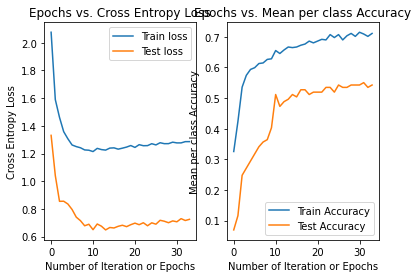

26
training cost: 1.2648459809543389
validation cost: 0.7692177932383958
training accuracy: 0.7842003853564548
validation accuracy: 0.5736434108527132
time elapsed: 1.5193648790000225
learning rate: 0.001
momentum : 0.05
regularization: 0.1


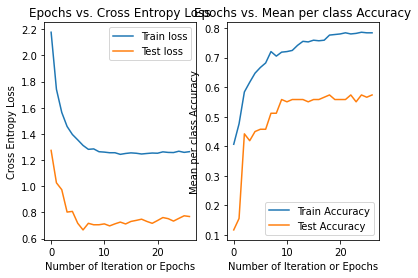

30
training cost: 1.2766364191679065
validation cost: 0.8556313129234366
training accuracy: 0.7649325626204239
validation accuracy: 0.5736434108527132
time elapsed: 1.7675069480001184
learning rate: 0.001
momentum : 0.05
regularization: 0.1


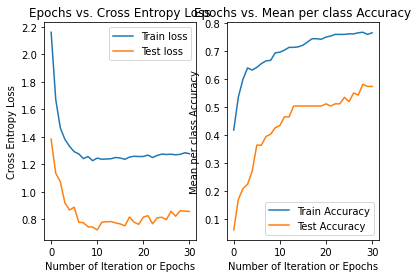

25
training cost: 1.160676818532376
validation cost: 0.8846459826973229
training accuracy: 0.7244701348747592
validation accuracy: 0.32558139534883723
time elapsed: 1.4620221550003407
learning rate: 0.001
momentum : 0.05
regularization: 0.1


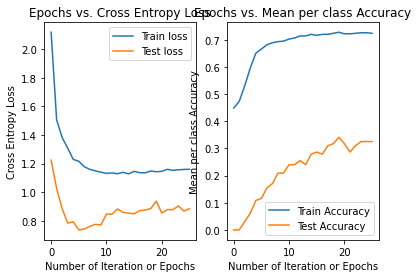

30
training cost: 1.3791408571937571
validation cost: 0.9045911141592966
training accuracy: 0.8015414258188824
validation accuracy: 0.7364341085271318
time elapsed: 1.7136206520003725
learning rate: 0.001
momentum : 0.05
regularization: 0.1


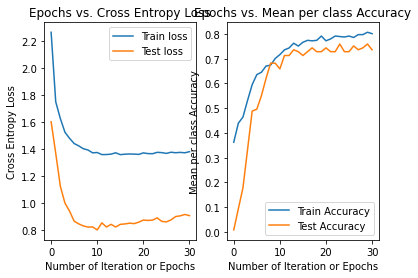

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7364341085271318
Average cross validation score: 0.6472868217054264
Accuracy on test: 0.02857142857142857
23
training cost: 1.7390779246554817
validation cost: 1.2887966775453708
training accuracy: 0.5857418111753372
validation accuracy: 0.31007751937984496
time elapsed: 1.3461601479998535
learning rate: 0.001
momentum : 0.05
regularization: 0.5


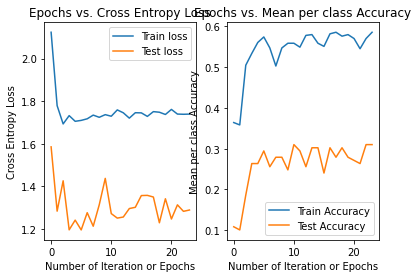

23
training cost: 1.8746019015834556
validation cost: 1.2926485966515395
training accuracy: 0.6107899807321773
validation accuracy: 0.4496124031007752
time elapsed: 1.5626841110001806
learning rate: 0.001
momentum : 0.05
regularization: 0.5


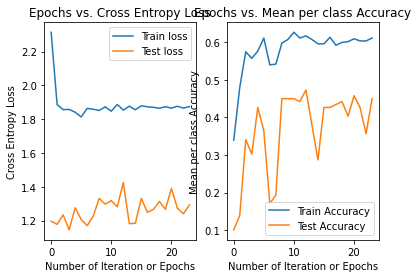

32
training cost: 1.7782120918009807
validation cost: 1.4364632337704486
training accuracy: 0.626204238921002
validation accuracy: 0.21705426356589147
time elapsed: 1.8515100879999409
learning rate: 0.001
momentum : 0.05
regularization: 0.5


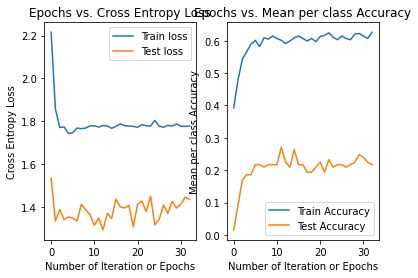

23
training cost: 1.7122671165140475
validation cost: 1.3070531206523732
training accuracy: 0.6088631984585742
validation accuracy: 0.06976744186046512
time elapsed: 1.3384398429998328
learning rate: 0.001
momentum : 0.05
regularization: 0.5


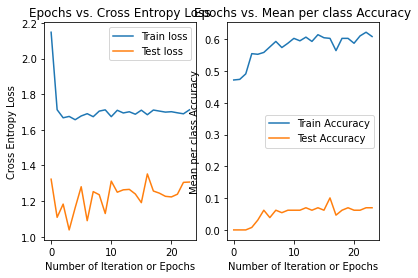

21
training cost: 1.9173130948940056
validation cost: 1.5205417489521222
training accuracy: 0.5606936416184971
validation accuracy: 0.3488372093023256
time elapsed: 1.2319147030002568
learning rate: 0.001
momentum : 0.05
regularization: 0.5


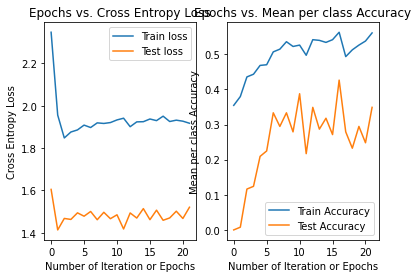

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7364341085271318
Average cross validation score: 0.6472868217054264
Accuracy on test: 0.0
37
training cost: 1.9396842823151812
validation cost: 1.4344684262733132
training accuracy: 0.41811175337186895
validation accuracy: 0.13953488372093023
time elapsed: 2.368551547000152
learning rate: 0.001
momentum : 0.05
regularization: 0.9


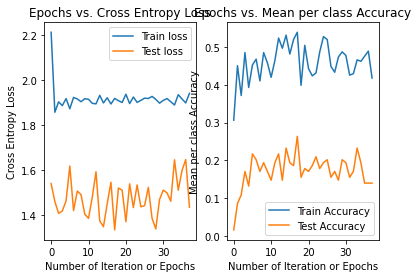

30
training cost: 2.042114050033343
validation cost: 1.5813797139954422
training accuracy: 0.5664739884393064
validation accuracy: 0.3643410852713178
time elapsed: 1.7381751569996595
learning rate: 0.001
momentum : 0.05
regularization: 0.9


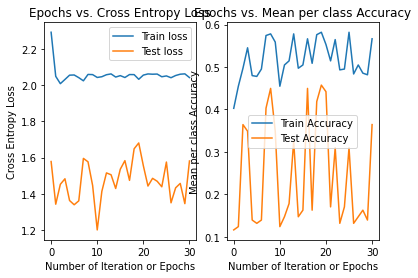

21
training cost: 1.9622279766851973
validation cost: 1.6287796416089466
training accuracy: 0.5703275529865125
validation accuracy: 0.20930232558139536
time elapsed: 1.2235655469999074
learning rate: 0.001
momentum : 0.05
regularization: 0.9


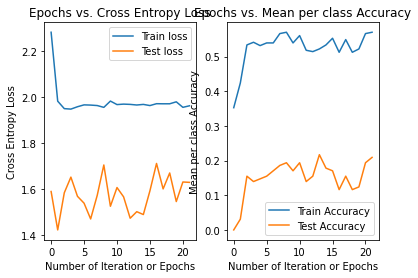

23
training cost: 1.8800368513270604
validation cost: 1.3579081262244697
training accuracy: 0.5510597302504817
validation accuracy: 0.015503875968992248
time elapsed: 1.343953660000352
learning rate: 0.001
momentum : 0.05
regularization: 0.9


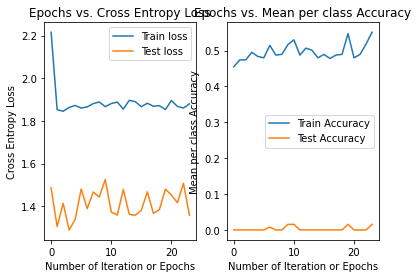

38
training cost: 2.0754603099122604
validation cost: 1.769360169983016
training accuracy: 0.44508670520231214
validation accuracy: 0.11627906976744186
time elapsed: 2.28851978099965
learning rate: 0.001
momentum : 0.05
regularization: 0.9


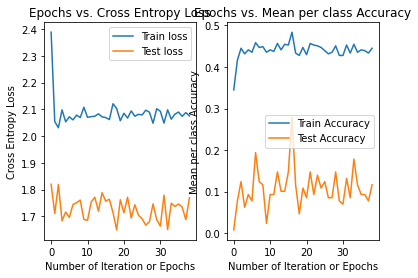

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7364341085271318
Average cross validation score: 0.6472868217054264
Accuracy on test: 0.0
155
training cost: 0.7313774855637625
validation cost: 0.6688617304161402
training accuracy: 0.6685934489402697
validation accuracy: 0.5116279069767442
time elapsed: 1.3040743299998212
learning rate: 0.001
momentum : 0.05
regularization: 0.1


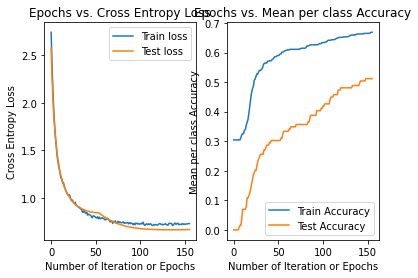

128
training cost: 0.6929728019569603
validation cost: 0.7217355623813029
training accuracy: 0.74373795761079
validation accuracy: 0.5581395348837209
time elapsed: 1.107853637000062
learning rate: 0.001
momentum : 0.05
regularization: 0.1


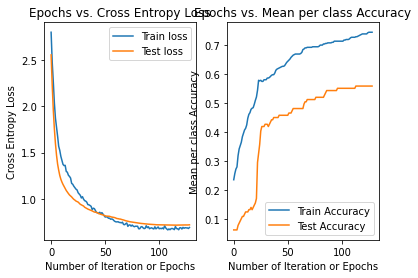

120
training cost: 0.7094964554280939
validation cost: 0.7798854317430439
training accuracy: 0.7109826589595376
validation accuracy: 0.4883720930232558
time elapsed: 1.0769189789998563
learning rate: 0.001
momentum : 0.05
regularization: 0.1


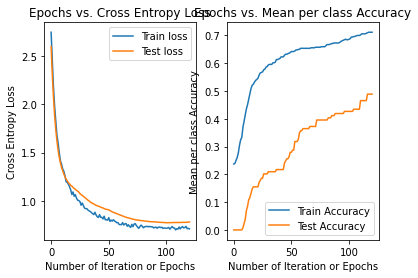

77
training cost: 0.6613479821693152
validation cost: 0.7959214619258714
training accuracy: 0.6917148362235067
validation accuracy: 0.16279069767441862
time elapsed: 0.6552344169999742
learning rate: 0.001
momentum : 0.05
regularization: 0.1


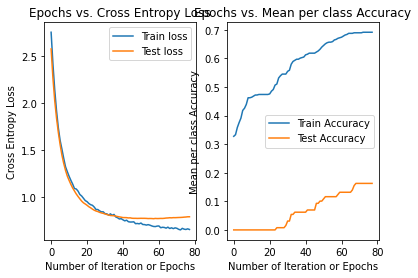

123
training cost: 0.691323360465591
validation cost: 0.8185636577508717
training accuracy: 0.7360308285163777
validation accuracy: 0.7131782945736435
time elapsed: 1.0157156379996195
learning rate: 0.001
momentum : 0.05
regularization: 0.1


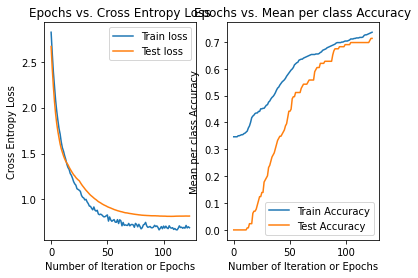

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7364341085271318
Average cross validation score: 0.6472868217054264
Accuracy on test: 0.0
56
training cost: 1.2346249066461303
validation cost: 1.2564284743249519
training accuracy: 0.535645472061657
validation accuracy: 0.24806201550387597
time elapsed: 0.47993733000021166
learning rate: 0.001
momentum : 0.05
regularization: 0.5


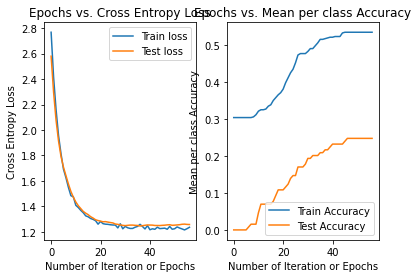

50
training cost: 1.3412514065261785
validation cost: 1.25086241952497
training accuracy: 0.5838150289017341
validation accuracy: 0.4186046511627907
time elapsed: 0.42753675799986013
learning rate: 0.001
momentum : 0.05
regularization: 0.5


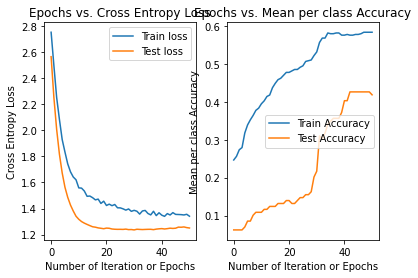

42
training cost: 1.2689011134386021
validation cost: 1.3715604794201433
training accuracy: 0.5799614643545279
validation accuracy: 0.20930232558139536
time elapsed: 0.36914189299977807
learning rate: 0.001
momentum : 0.05
regularization: 0.5


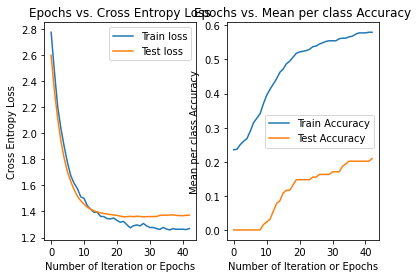

53
training cost: 1.1795947510595268
validation cost: 1.198807138076575
training accuracy: 0.5645472061657033
validation accuracy: 0.03875968992248062
time elapsed: 0.4508618450004178
learning rate: 0.001
momentum : 0.05
regularization: 0.5


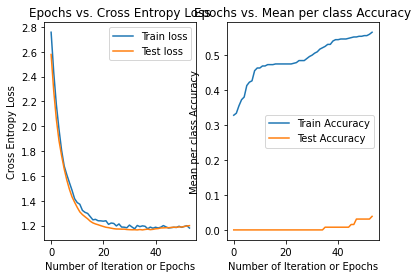

83
training cost: 1.3407126030412853
validation cost: 1.4785045052308523
training accuracy: 0.5028901734104047
validation accuracy: 0.27906976744186046
time elapsed: 0.695622874000037
learning rate: 0.001
momentum : 0.05
regularization: 0.5


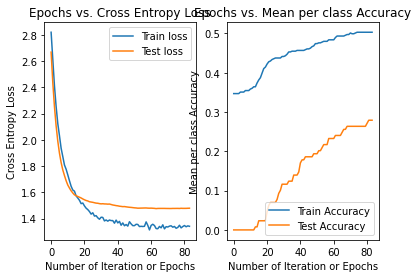

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7364341085271318
Average cross validation score: 0.6472868217054264
Accuracy on test: 0.0
58
training cost: 1.4472219339203116
validation cost: 1.467397094768689
training accuracy: 0.4662813102119461
validation accuracy: 0.17054263565891473
time elapsed: 0.5054415390000031
learning rate: 0.001
momentum : 0.05
regularization: 0.9


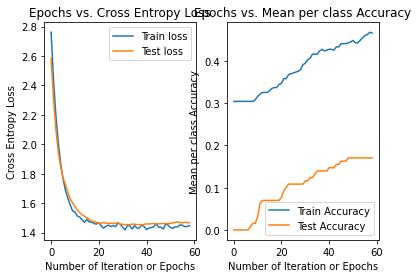

38
training cost: 1.6107799852969529
validation cost: 1.4275829278391017
training accuracy: 0.48747591522157996
validation accuracy: 0.13178294573643412
time elapsed: 0.33334790200024145
learning rate: 0.001
momentum : 0.05
regularization: 0.9


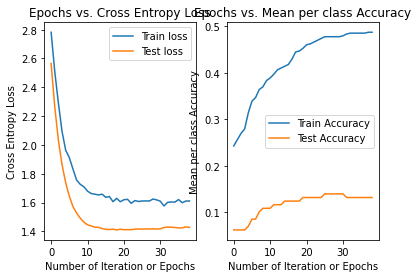

42
training cost: 1.5082756773710277
validation cost: 1.5527478495144331
training accuracy: 0.5414258188824663
validation accuracy: 0.16279069767441862
time elapsed: 0.37639407500000743
learning rate: 0.001
momentum : 0.05
regularization: 0.9


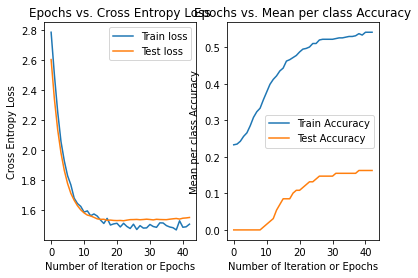

43
training cost: 1.4160532636102845
validation cost: 1.39261008763327
training accuracy: 0.4836223506743738
validation accuracy: 0.0
time elapsed: 0.4157471510002324
learning rate: 0.001
momentum : 0.05
regularization: 0.9


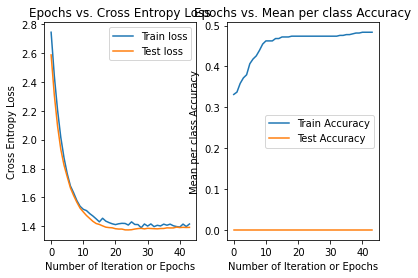

37
training cost: 1.6526770694959798
validation cost: 1.727375684521247
training accuracy: 0.43545279383429675
validation accuracy: 0.06976744186046512
time elapsed: 0.32518174899996666
learning rate: 0.001
momentum : 0.05
regularization: 0.9


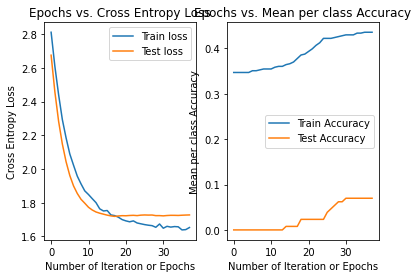

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7364341085271318
Average cross validation score: 0.6472868217054264
Accuracy on test: 0.0
training cost: 0.7784329428049918
validation cost: 0.890190809894612
training accuracy: 0.5606936416184971
validation accuracy: 0.26356589147286824
time elapsed: 1.070993608000208
learning rate: 0.001
momentum : 0.05
regularization: 0.1


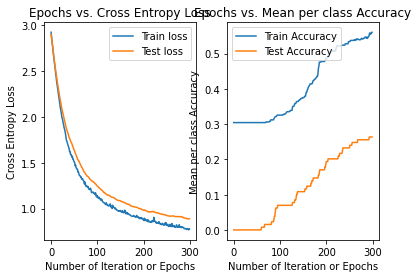

training cost: 0.7833503258696687
validation cost: 0.8927736020757203
training accuracy: 0.5876685934489403
validation accuracy: 0.43410852713178294
time elapsed: 1.0022192500000529
learning rate: 0.001
momentum : 0.05
regularization: 0.1


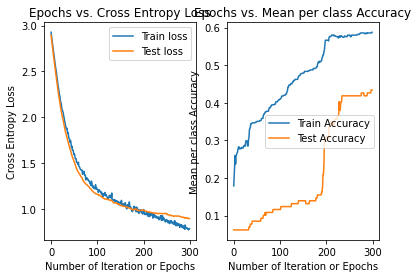

training cost: 0.7580460448667177
validation cost: 0.9810089258174
training accuracy: 0.5973025048169557
validation accuracy: 0.20930232558139536
time elapsed: 1.020889840000109
learning rate: 0.001
momentum : 0.05
regularization: 0.1


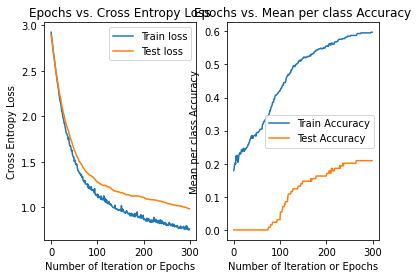

training cost: 0.6900285338484765
validation cost: 0.7988968371649708
training accuracy: 0.5915221579961464
validation accuracy: 0.06201550387596899
time elapsed: 1.0298608870002681
learning rate: 0.001
momentum : 0.05
regularization: 0.1


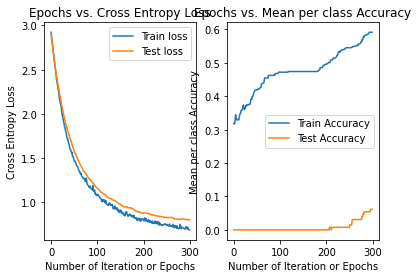

training cost: 0.7745688230614017
validation cost: 1.0686601314218236
training accuracy: 0.48940269749518306
validation accuracy: 0.26356589147286824
time elapsed: 0.9803627380001672
learning rate: 0.001
momentum : 0.05
regularization: 0.1


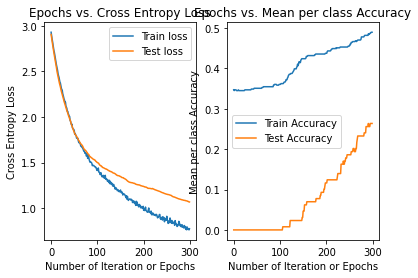

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7364341085271318
Average cross validation score: 0.6472868217054264
Accuracy on test: 0.0
267
training cost: 1.155599531997835
validation cost: 1.2534958949558002
training accuracy: 0.48940269749518306
validation accuracy: 0.1937984496124031
time elapsed: 0.8909876149996308
learning rate: 0.001
momentum : 0.05
regularization: 0.5


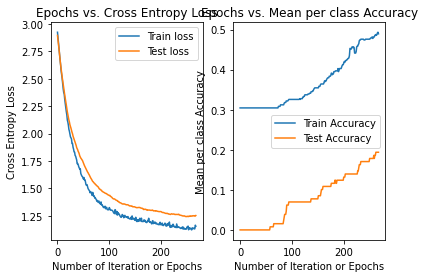

181
training cost: 1.294178714385169
validation cost: 1.253414639281193
training accuracy: 0.4836223506743738
validation accuracy: 0.13178294573643412
time elapsed: 0.6093508799999654
learning rate: 0.001
momentum : 0.05
regularization: 0.5


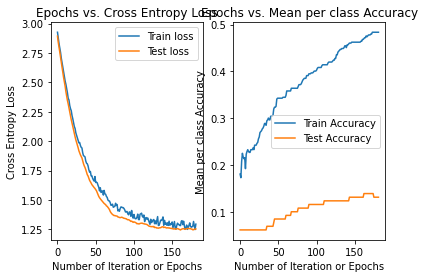

179
training cost: 1.1753351535639565
validation cost: 1.3752395834657876
training accuracy: 0.5221579961464354
validation accuracy: 0.14728682170542637
time elapsed: 0.5950714780001363
learning rate: 0.001
momentum : 0.05
regularization: 0.5


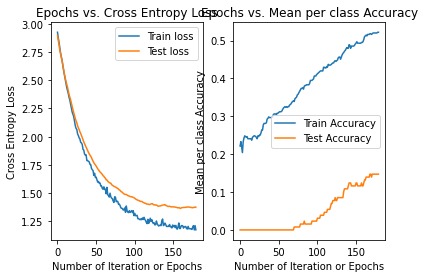

233
training cost: 1.0772162680436106
validation cost: 1.1585206825754681
training accuracy: 0.4836223506743738
validation accuracy: 0.0
time elapsed: 0.7852484790000744
learning rate: 0.001
momentum : 0.05
regularization: 0.5


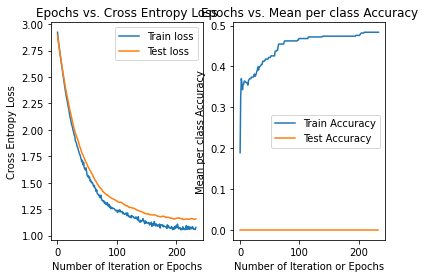

171
training cost: 1.3839184850742468
validation cost: 1.557810860185218
training accuracy: 0.41811175337186895
validation accuracy: 0.023255813953488372
time elapsed: 0.5710412810003618
learning rate: 0.001
momentum : 0.05
regularization: 0.5


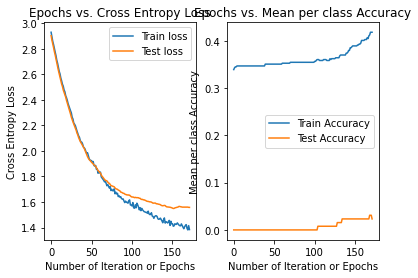

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7364341085271318
Average cross validation score: 0.6472868217054264
Accuracy on test: 0.0
161
training cost: 1.3702050525673126
validation cost: 1.498342665925523
training accuracy: 0.3371868978805395
validation accuracy: 0.06976744186046512
time elapsed: 0.5393900710000707
learning rate: 0.001
momentum : 0.05
regularization: 0.9


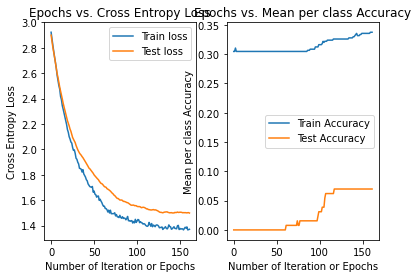

161
training cost: 1.4395129210414848
validation cost: 1.408068413642838
training accuracy: 0.4373795761078998
validation accuracy: 0.12403100775193798
time elapsed: 0.533491125999717
learning rate: 0.001
momentum : 0.05
regularization: 0.9


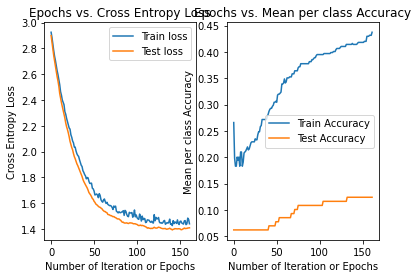

156
training cost: 1.3764474196506153
validation cost: 1.5257566450974351
training accuracy: 0.4605009633911368
validation accuracy: 0.08527131782945736
time elapsed: 0.53551352400018
learning rate: 0.001
momentum : 0.05
regularization: 0.9


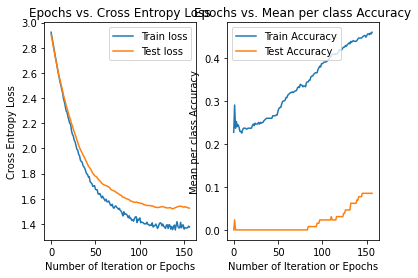

209
training cost: 1.2936147630066348
validation cost: 1.3864386225626304
training accuracy: 0.47398843930635837
validation accuracy: 0.0
time elapsed: 0.6953643949996149
learning rate: 0.001
momentum : 0.05
regularization: 0.9


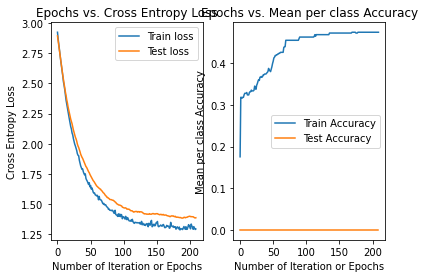

178
training cost: 1.5778278374575943
validation cost: 1.7014473179500726
training accuracy: 0.3853564547206166
validation accuracy: 0.023255813953488372
time elapsed: 0.5925706680000076
learning rate: 0.001
momentum : 0.05
regularization: 0.9


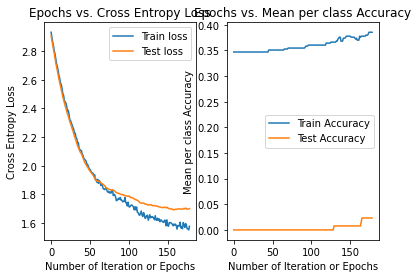

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7364341085271318
Average cross validation score: 0.6472868217054264
Accuracy on test: 0.0
25
training cost: 1.3076984175639401
validation cost: 0.706236712316556
training accuracy: 0.7302504816955684
validation accuracy: 0.5891472868217055
time elapsed: 1.4768944150000607
learning rate: 0.001
momentum : 0.5
regularization: 0.1


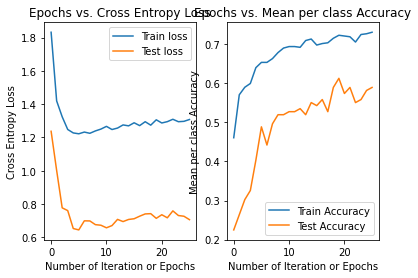

24
training cost: 1.2752198194899604
validation cost: 0.7763066631761331
training accuracy: 0.791907514450867
validation accuracy: 0.5736434108527132
time elapsed: 1.3984412550003071
learning rate: 0.001
momentum : 0.5
regularization: 0.1


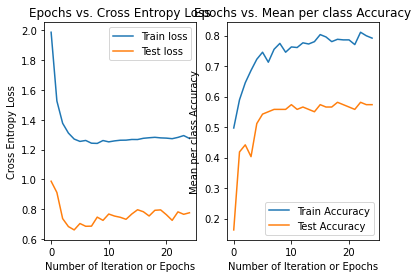

21
training cost: 1.2780498031597998
validation cost: 0.792310784532607
training accuracy: 0.791907514450867
validation accuracy: 0.5581395348837209
time elapsed: 1.2133200519997445
learning rate: 0.001
momentum : 0.5
regularization: 0.1


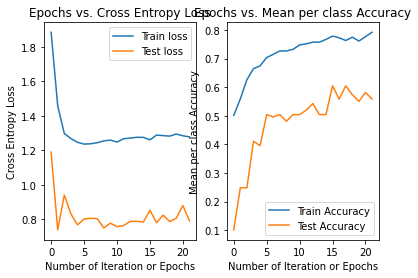

22
training cost: 1.1882732328967742
validation cost: 0.8901512398651162
training accuracy: 0.74373795761079
validation accuracy: 0.4263565891472868
time elapsed: 1.2793930689999797
learning rate: 0.001
momentum : 0.5
regularization: 0.1


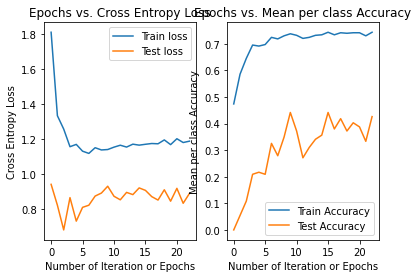

23
training cost: 1.379666821923216
validation cost: 0.9348943371384607
training accuracy: 0.8208092485549133
validation accuracy: 0.7674418604651163
time elapsed: 1.4554670739998983
learning rate: 0.001
momentum : 0.5
regularization: 0.1


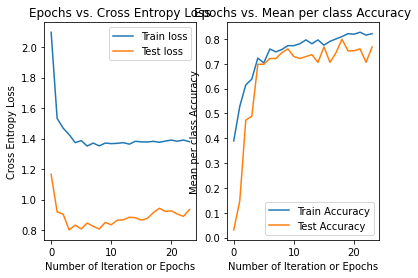

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.2
26
training cost: 1.7593169960507737
validation cost: 1.2983015075611195
training accuracy: 0.6011560693641619
validation accuracy: 0.3178294573643411
time elapsed: 1.5036106840002503
learning rate: 0.001
momentum : 0.5
regularization: 0.5


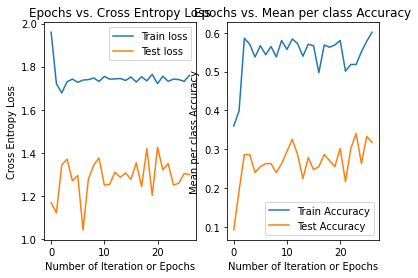

21
training cost: 1.87128454841564
validation cost: 1.4163508474045061
training accuracy: 0.5895953757225434
validation accuracy: 0.4728682170542636
time elapsed: 1.2324652170000263
learning rate: 0.001
momentum : 0.5
regularization: 0.5


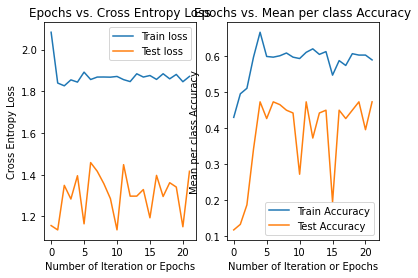

40
training cost: 1.7735912400391376
validation cost: 1.4241594656600187
training accuracy: 0.6223506743737958
validation accuracy: 0.26356589147286824
time elapsed: 2.309119991999978
learning rate: 0.001
momentum : 0.5
regularization: 0.5


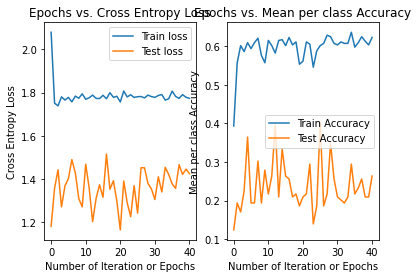

28
training cost: 1.7074516460974865
validation cost: 1.127271793765433
training accuracy: 0.5626204238921002
validation accuracy: 0.046511627906976744
time elapsed: 1.6121828730001653
learning rate: 0.001
momentum : 0.5
regularization: 0.5


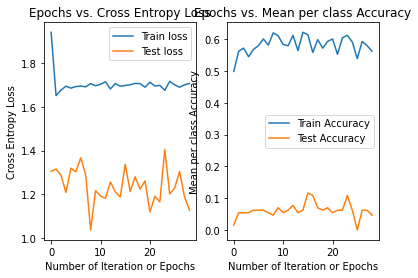

49
training cost: 1.9332966226546449
validation cost: 1.523723334721979
training accuracy: 0.5317919075144508
validation accuracy: 0.4186046511627907
time elapsed: 2.8327417119999154
learning rate: 0.001
momentum : 0.5
regularization: 0.5


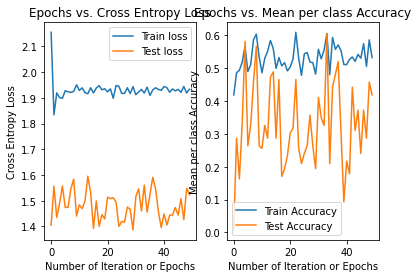

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.0
25
training cost: 1.916702629924692
validation cost: 1.6397929279839125
training accuracy: 0.5048169556840078
validation accuracy: 0.2248062015503876
time elapsed: 1.4749158060003538
learning rate: 0.001
momentum : 0.5
regularization: 0.9


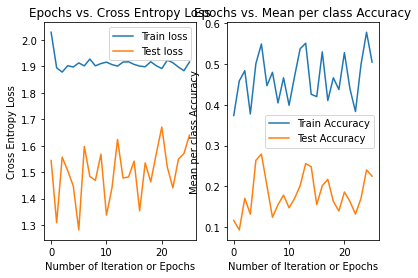

23
training cost: 2.0367674478357167
validation cost: 1.559915796655071
training accuracy: 0.5009633911368016
validation accuracy: 0.16279069767441862
time elapsed: 1.3686787169999661
learning rate: 0.001
momentum : 0.5
regularization: 0.9


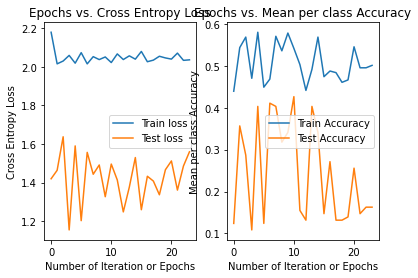

37
training cost: 1.9617254156375976
validation cost: 1.4887822883808963
training accuracy: 0.4932562620423892
validation accuracy: 0.10852713178294573
time elapsed: 2.1777670770006807
learning rate: 0.001
momentum : 0.5
regularization: 0.9


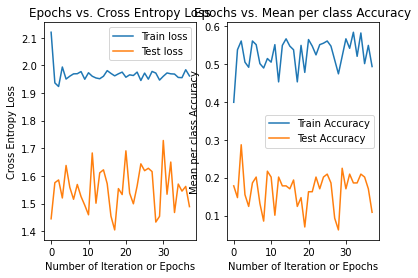

40
training cost: 1.858975448794171
validation cost: 1.3707241654709967
training accuracy: 0.535645472061657
validation accuracy: 0.015503875968992248
time elapsed: 2.272967769000388
learning rate: 0.001
momentum : 0.5
regularization: 0.9


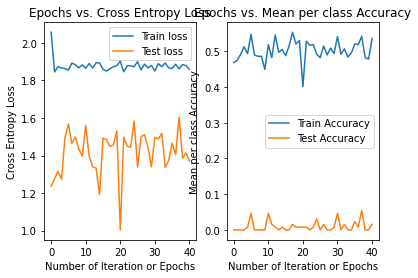

34
training cost: 2.0954032195085808
validation cost: 1.7686349577974634
training accuracy: 0.4624277456647399
validation accuracy: 0.24806201550387597
time elapsed: 1.9582193239994012
learning rate: 0.001
momentum : 0.5
regularization: 0.9


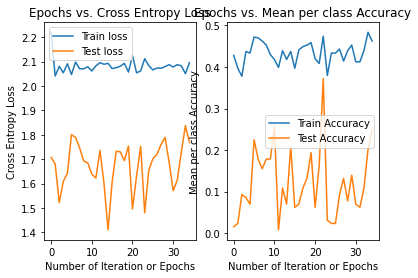

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.0
80
training cost: 0.7339247921807763
validation cost: 0.670011834022624
training accuracy: 0.6666666666666666
validation accuracy: 0.5116279069767442
time elapsed: 0.6858802140004627
learning rate: 0.001
momentum : 0.5
regularization: 0.1


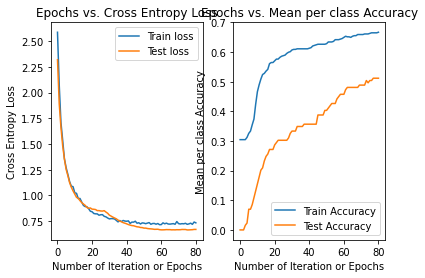

76
training cost: 0.6994825543105723
validation cost: 0.7257070299473746
training accuracy: 0.7572254335260116
validation accuracy: 0.5581395348837209
time elapsed: 0.6393626899998708
learning rate: 0.001
momentum : 0.5
regularization: 0.1


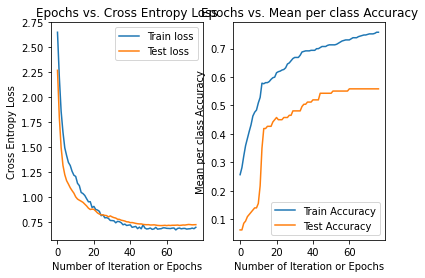

74
training cost: 0.7363254201226314
validation cost: 0.7938052033506423
training accuracy: 0.7148362235067437
validation accuracy: 0.5038759689922481
time elapsed: 0.6292046500002471
learning rate: 0.001
momentum : 0.5
regularization: 0.1


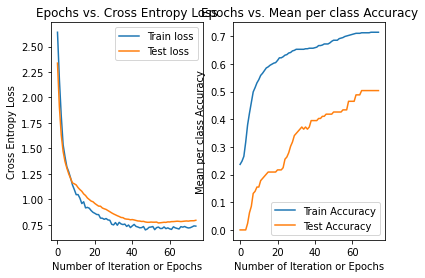

43
training cost: 0.6411146381071254
validation cost: 0.7966854961429812
training accuracy: 0.6936416184971098
validation accuracy: 0.1937984496124031
time elapsed: 0.3691958400004296
learning rate: 0.001
momentum : 0.5
regularization: 0.1


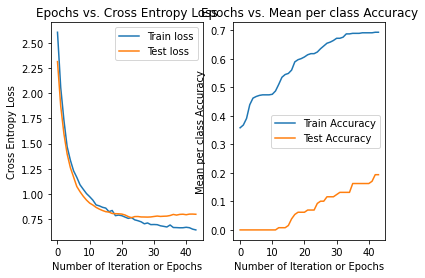

81
training cost: 0.6902738371406821
validation cost: 0.834991940595044
training accuracy: 0.7630057803468208
validation accuracy: 0.7209302325581395
time elapsed: 0.6919406739998522
learning rate: 0.001
momentum : 0.5
regularization: 0.1


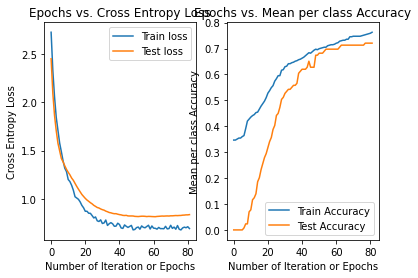

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.0
41
training cost: 1.2316690965812092
validation cost: 1.278977128509756
training accuracy: 0.558766859344894
validation accuracy: 0.2713178294573643
time elapsed: 0.3564713619998656
learning rate: 0.001
momentum : 0.5
regularization: 0.5


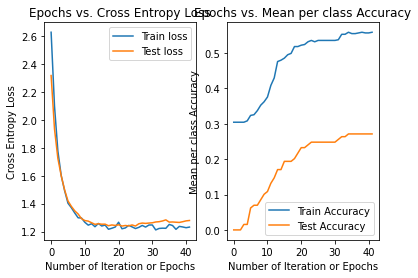

30
training cost: 1.3400770247576606
validation cost: 1.2718426517501569
training accuracy: 0.5838150289017341
validation accuracy: 0.4263565891472868
time elapsed: 0.26081928800067544
learning rate: 0.001
momentum : 0.5
regularization: 0.5


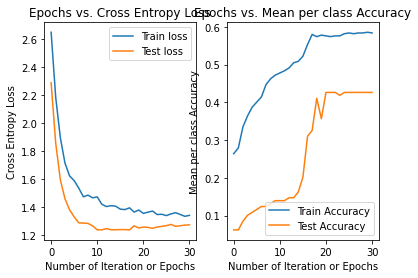

35
training cost: 1.2818489843731118
validation cost: 1.3791280745369687
training accuracy: 0.5992292870905588
validation accuracy: 0.20930232558139536
time elapsed: 0.29852960200059897
learning rate: 0.001
momentum : 0.5
regularization: 0.5


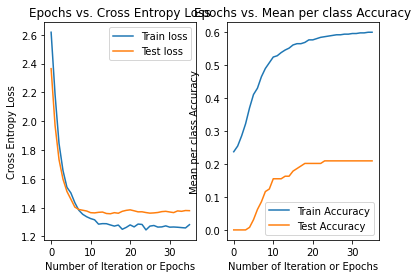

35
training cost: 1.1943470046141178
validation cost: 1.2071128394534671
training accuracy: 0.5799614643545279
validation accuracy: 0.06201550387596899
time elapsed: 0.3088691110006039
learning rate: 0.001
momentum : 0.5
regularization: 0.5


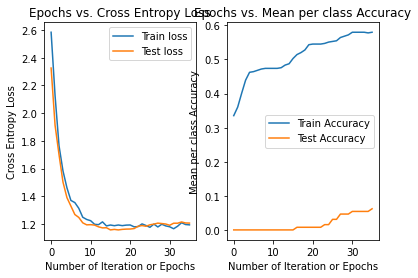

54
training cost: 1.3560098646368606
validation cost: 1.483867617608492
training accuracy: 0.5183044315992292
validation accuracy: 0.3023255813953488
time elapsed: 0.4604019629996401
learning rate: 0.001
momentum : 0.5
regularization: 0.5


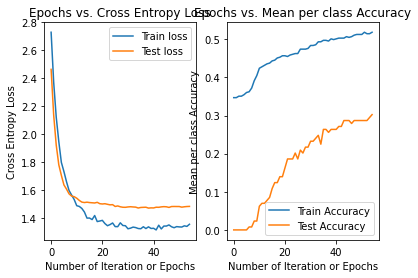

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.0
30
training cost: 1.4413096047965521
validation cost: 1.463117639675706
training accuracy: 0.464354527938343
validation accuracy: 0.17054263565891473
time elapsed: 0.2634668660002717
learning rate: 0.001
momentum : 0.5
regularization: 0.9


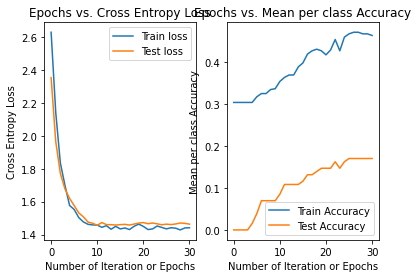

33
training cost: 1.592236407416299
validation cost: 1.4534566389439798
training accuracy: 0.5086705202312138
validation accuracy: 0.16279069767441862
time elapsed: 0.2848512290001963
learning rate: 0.001
momentum : 0.5
regularization: 0.9


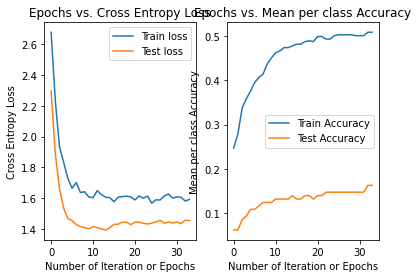

30
training cost: 1.5048348959206914
validation cost: 1.5658513724794332
training accuracy: 0.5606936416184971
validation accuracy: 0.17054263565891473
time elapsed: 0.2653433790001145
learning rate: 0.001
momentum : 0.5
regularization: 0.9


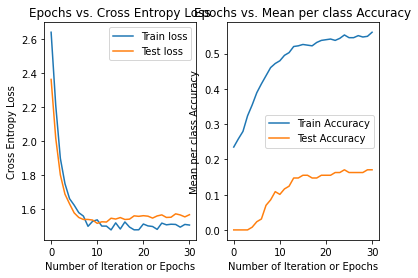

32
training cost: 1.4131520224708232
validation cost: 1.3984551938860614
training accuracy: 0.4913294797687861
validation accuracy: 0.0
time elapsed: 0.2973763419995521
learning rate: 0.001
momentum : 0.5
regularization: 0.9


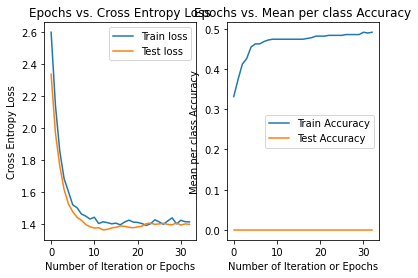

30
training cost: 1.6284330724779585
validation cost: 1.7310198793144775
training accuracy: 0.4373795761078998
validation accuracy: 0.09302325581395349
time elapsed: 0.2635171920001085
learning rate: 0.001
momentum : 0.5
regularization: 0.9


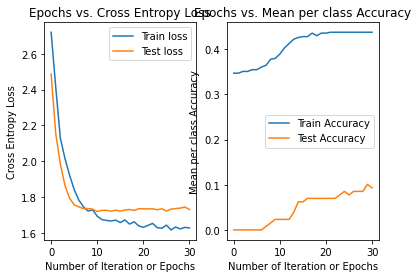

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.0
255
training cost: 0.6874722602016776
validation cost: 0.8421988088916441
training accuracy: 0.5915221579961464
validation accuracy: 0.31007751937984496
time elapsed: 0.8595541960003175
learning rate: 0.001
momentum : 0.5
regularization: 0.1


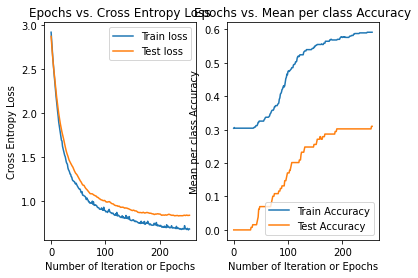

training cost: 0.5684836519054274
validation cost: 0.7770238823664395
training accuracy: 0.6820809248554913
validation accuracy: 0.4806201550387597
time elapsed: 0.9847003210006733
learning rate: 0.001
momentum : 0.5
regularization: 0.1


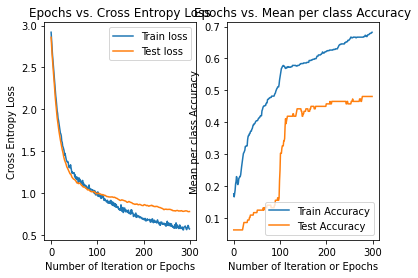

training cost: 0.6210189557823679
validation cost: 0.8340146045145237
training accuracy: 0.653179190751445
validation accuracy: 0.3643410852713178
time elapsed: 0.9824311580005087
learning rate: 0.001
momentum : 0.5
regularization: 0.1


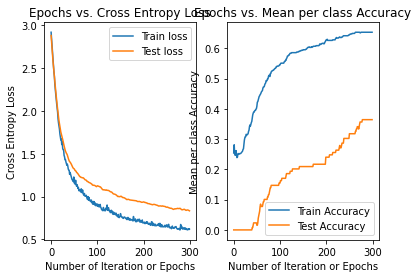

203
training cost: 0.6367010378518608
validation cost: 0.7792603774038217
training accuracy: 0.6184971098265896
validation accuracy: 0.06976744186046512
time elapsed: 0.6939790019996508
learning rate: 0.001
momentum : 0.5
regularization: 0.1


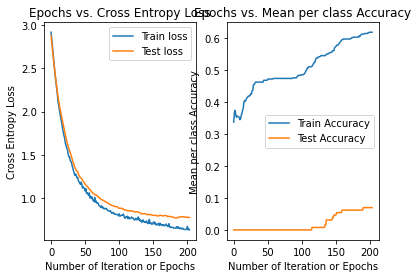

training cost: 0.5754563184179774
validation cost: 0.8656385182258027
training accuracy: 0.6454720616570327
validation accuracy: 0.5426356589147286
time elapsed: 0.9958174869998402
learning rate: 0.001
momentum : 0.5
regularization: 0.1


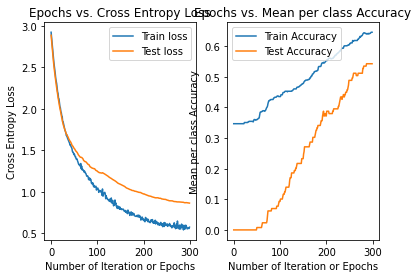

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.0
184
training cost: 1.1252120456128916
validation cost: 1.247048852649256
training accuracy: 0.5240847784200385
validation accuracy: 0.20155038759689922
time elapsed: 0.6294616870000027
learning rate: 0.001
momentum : 0.5
regularization: 0.5


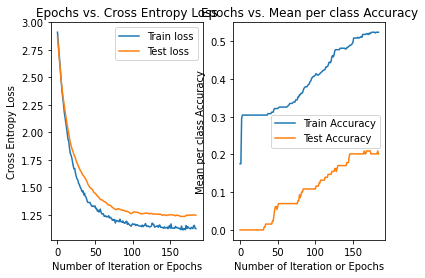

99
training cost: 1.2475869586585349
validation cost: 1.2424464963751356
training accuracy: 0.47784200385356457
validation accuracy: 0.13953488372093023
time elapsed: 0.33322840400069254
learning rate: 0.001
momentum : 0.5
regularization: 0.5


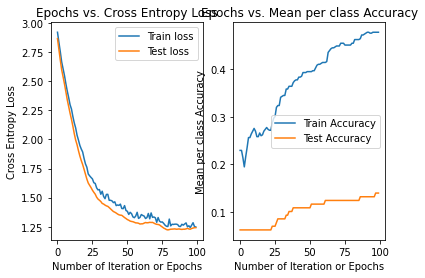

120
training cost: 1.173146994325389
validation cost: 1.3607080514247956
training accuracy: 0.5472061657032755
validation accuracy: 0.16279069767441862
time elapsed: 0.414078236000023
learning rate: 0.001
momentum : 0.5
regularization: 0.5


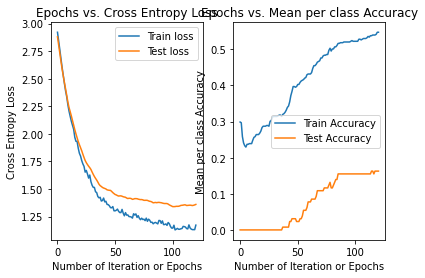

128
training cost: 1.0727679653897286
validation cost: 1.1674020319642893
training accuracy: 0.48554913294797686
validation accuracy: 0.0
time elapsed: 0.4310873879994688
learning rate: 0.001
momentum : 0.5
regularization: 0.5


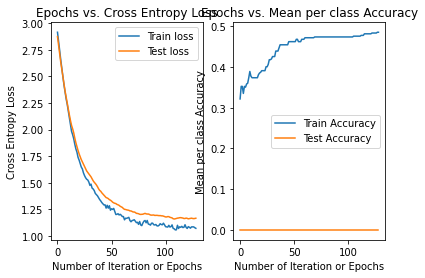

158
training cost: 1.2209730634240266
validation cost: 1.4910720195788767
training accuracy: 0.4489402697495183
validation accuracy: 0.12403100775193798
time elapsed: 0.525025101999745
learning rate: 0.001
momentum : 0.5
regularization: 0.5


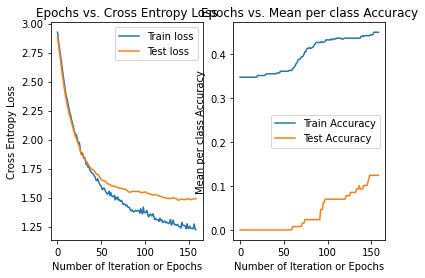

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.0
136
training cost: 1.333303471329028
validation cost: 1.450154199947158
training accuracy: 0.3969171483622351
validation accuracy: 0.10852713178294573
time elapsed: 0.4661684679995233
learning rate: 0.001
momentum : 0.5
regularization: 0.9


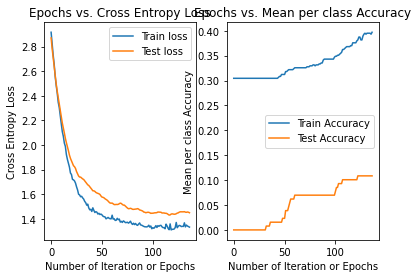

87
training cost: 1.4485633464720031
validation cost: 1.3999108754520186
training accuracy: 0.4508670520231214
validation accuracy: 0.12403100775193798
time elapsed: 0.3001944329998878
learning rate: 0.001
momentum : 0.5
regularization: 0.9


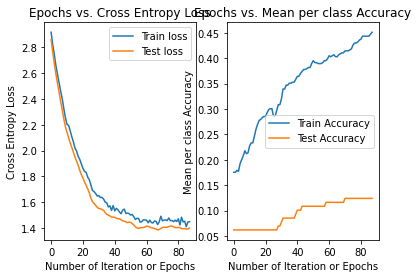

104
training cost: 1.340475203558512
validation cost: 1.5282870162563666
training accuracy: 0.5028901734104047
validation accuracy: 0.12403100775193798
time elapsed: 0.35336363300029916
learning rate: 0.001
momentum : 0.5
regularization: 0.9


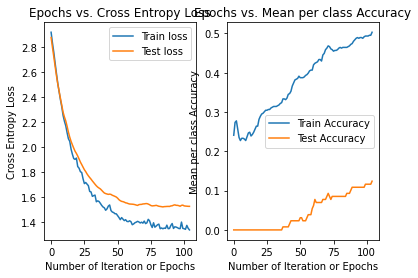

130
training cost: 1.2950952167989167
validation cost: 1.392209135511129
training accuracy: 0.47398843930635837
validation accuracy: 0.0
time elapsed: 0.4427813199999946
learning rate: 0.001
momentum : 0.5
regularization: 0.9


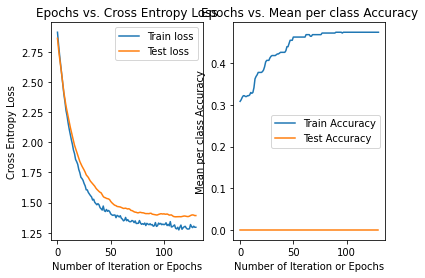

119
training cost: 1.5603429028633
validation cost: 1.7006480271335636
training accuracy: 0.4161849710982659
validation accuracy: 0.023255813953488372
time elapsed: 0.4013215209997725
learning rate: 0.001
momentum : 0.5
regularization: 0.9


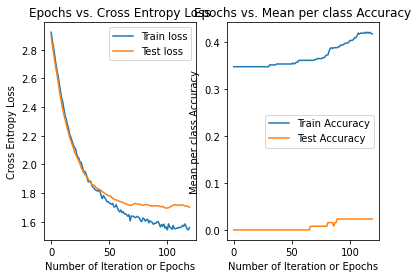

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.0
21
training cost: 1.3094435146647518
validation cost: 0.6936578072775135
training accuracy: 0.7129094412331407
validation accuracy: 0.5581395348837209
time elapsed: 1.224688956999671
learning rate: 0.01
momentum : 0.005
regularization: 0.1


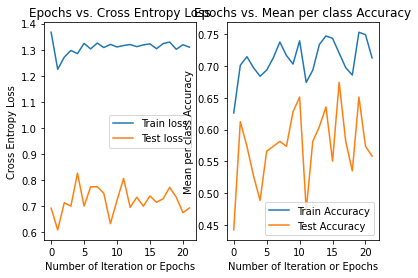

20
training cost: 1.3006556565382044
validation cost: 0.736335536608635
training accuracy: 0.7398843930635838
validation accuracy: 0.5891472868217055
time elapsed: 1.2221236850000423
learning rate: 0.01
momentum : 0.005
regularization: 0.1


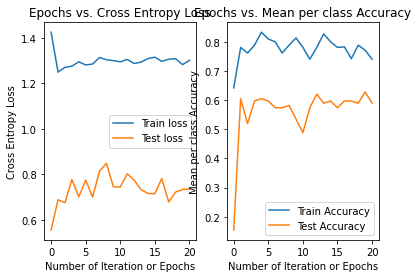

20
training cost: 1.3043102560311581
validation cost: 0.6488712369656373
training accuracy: 0.8111753371868978
validation accuracy: 0.627906976744186
time elapsed: 1.1740996870003073
learning rate: 0.01
momentum : 0.005
regularization: 0.1


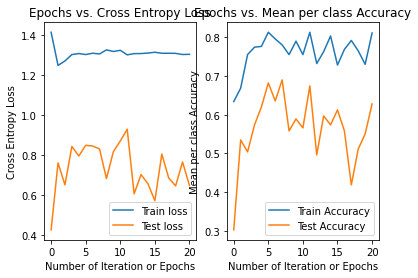

29
training cost: 1.2155667351938368
validation cost: 0.8891061916816534
training accuracy: 0.7707129094412332
validation accuracy: 0.49612403100775193
time elapsed: 1.7188347860001159
learning rate: 0.01
momentum : 0.005
regularization: 0.1


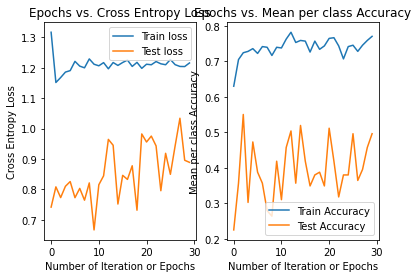

22
training cost: 1.3990945503793857
validation cost: 0.9295052641492643
training accuracy: 0.7880539499036608
validation accuracy: 0.6511627906976745
time elapsed: 1.2982386230005432
learning rate: 0.01
momentum : 0.005
regularization: 0.1


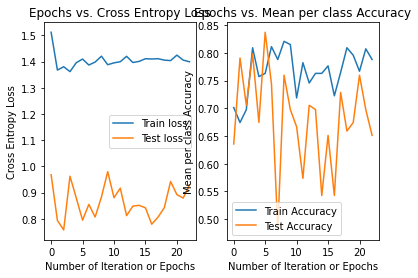

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.37142857142857144
54
training cost: 1.7381878628880194
validation cost: 1.1314010168829092
training accuracy: 0.41040462427745666
validation accuracy: 0.29457364341085274
time elapsed: 3.0969437759995344
learning rate: 0.01
momentum : 0.005
regularization: 0.5


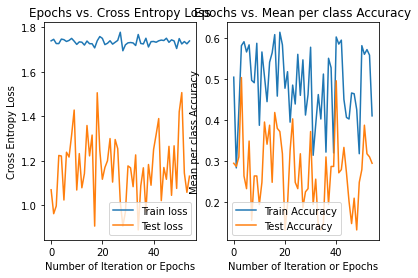

81
training cost: 1.8385447470194827
validation cost: 1.116121964820782
training accuracy: 0.5799614643545279
validation accuracy: 0.46511627906976744
time elapsed: 4.6595342269993125
learning rate: 0.01
momentum : 0.005
regularization: 0.5


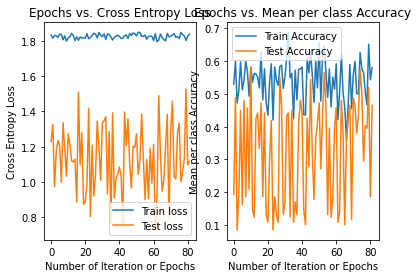

22
training cost: 1.759520940396883
validation cost: 1.4228788756428936
training accuracy: 0.558766859344894
validation accuracy: 0.20930232558139536
time elapsed: 1.2789743020002788
learning rate: 0.01
momentum : 0.005
regularization: 0.5


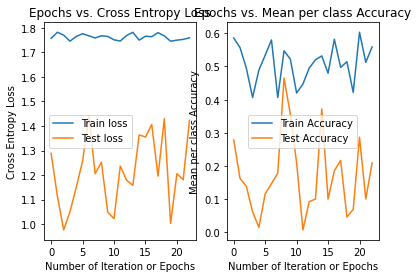

30
training cost: 1.6904803848623342
validation cost: 1.1634251724432416
training accuracy: 0.5414258188824663
validation accuracy: 0.046511627906976744
time elapsed: 1.7582465269997556
learning rate: 0.01
momentum : 0.005
regularization: 0.5


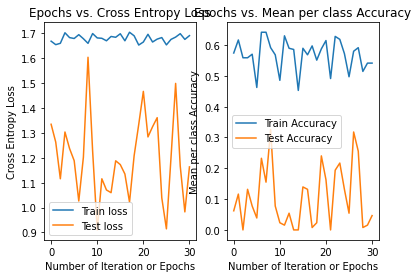

30
training cost: 1.9227958932737703
validation cost: 1.4215276583710594
training accuracy: 0.49710982658959535
validation accuracy: 0.23255813953488372
time elapsed: 1.7554698710000594
learning rate: 0.01
momentum : 0.005
regularization: 0.5


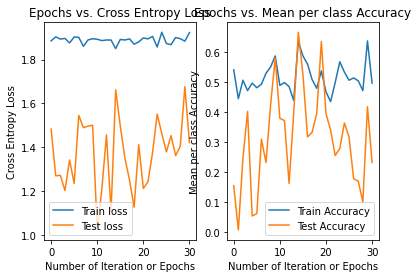

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.0
32
training cost: 1.8506565765072696
validation cost: 1.4604159779714876
training accuracy: 0.5606936416184971
validation accuracy: 0.20930232558139536
time elapsed: 1.866901733999839
learning rate: 0.01
momentum : 0.005
regularization: 0.9


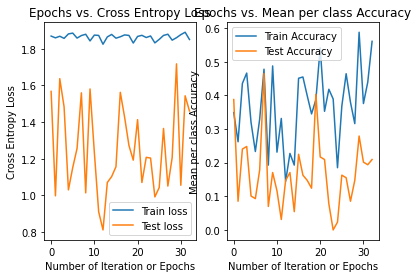

26
training cost: 1.9835167593131848
validation cost: 1.2632990128896973
training accuracy: 0.441233140655106
validation accuracy: 0.11627906976744186
time elapsed: 1.5024779020004644
learning rate: 0.01
momentum : 0.005
regularization: 0.9


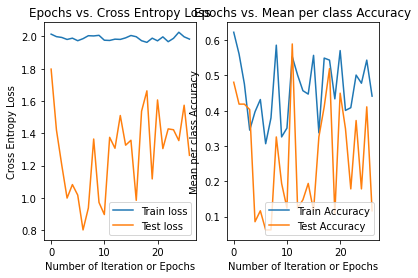

32
training cost: 1.8998768825302719
validation cost: 1.3073412636859623
training accuracy: 0.3699421965317919
validation accuracy: 0.17829457364341086
time elapsed: 1.8376326009993136
learning rate: 0.01
momentum : 0.005
regularization: 0.9


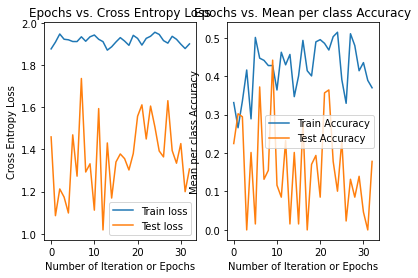

32
training cost: 1.8241866543405822
validation cost: 1.0043072682248886
training accuracy: 0.5105973025048169
validation accuracy: 0.0
time elapsed: 1.840315630999612
learning rate: 0.01
momentum : 0.005
regularization: 0.9


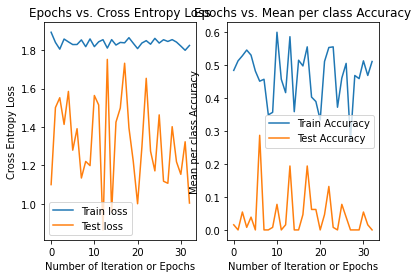

24
training cost: 2.030523081471696
validation cost: 1.8705290326218376
training accuracy: 0.4913294797687861
validation accuracy: 0.007751937984496124
time elapsed: 1.3827933130005476
learning rate: 0.01
momentum : 0.005
regularization: 0.9


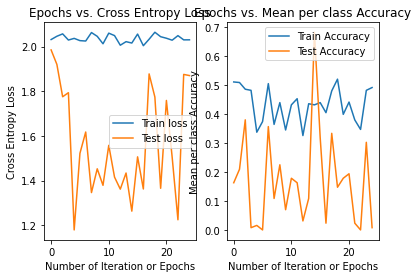

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.0
29
training cost: 0.7562237331807974
validation cost: 0.711212534553436
training accuracy: 0.7109826589595376
validation accuracy: 0.5503875968992248
time elapsed: 0.28529867899942474
learning rate: 0.01
momentum : 0.005
regularization: 0.1


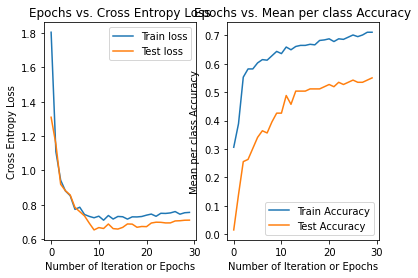

30
training cost: 0.729698722486255
validation cost: 0.7718791877824887
training accuracy: 0.7996146435452793
validation accuracy: 0.5736434108527132
time elapsed: 0.2623858160004602
learning rate: 0.01
momentum : 0.005
regularization: 0.1


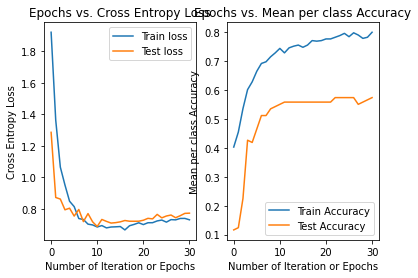

31
training cost: 0.8018724325888607
validation cost: 0.8300267914471535
training accuracy: 0.7591522157996147
validation accuracy: 0.5581395348837209
time elapsed: 0.27281427000070835
learning rate: 0.01
momentum : 0.005
regularization: 0.1


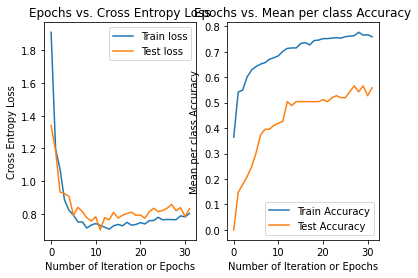

25
training cost: 0.675593067314743
validation cost: 0.9158274957908001
training accuracy: 0.7283236994219653
validation accuracy: 0.3488372093023256
time elapsed: 0.23534941699927003
learning rate: 0.01
momentum : 0.005
regularization: 0.1


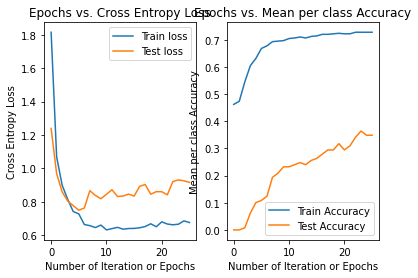

28
training cost: 0.7938681942274941
validation cost: 0.9071097342076974
training accuracy: 0.7938342967244701
validation accuracy: 0.751937984496124
time elapsed: 0.24571655999989162
learning rate: 0.01
momentum : 0.005
regularization: 0.1


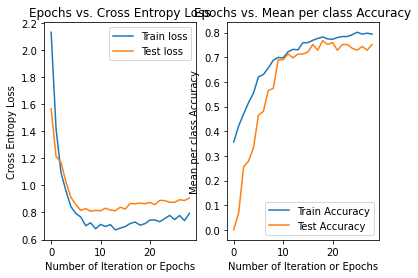

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.0
31
training cost: 1.2652466961388447
validation cost: 1.2957448208715696
training accuracy: 0.5684007707129094
validation accuracy: 0.3023255813953488
time elapsed: 0.29145077300017874
learning rate: 0.01
momentum : 0.005
regularization: 0.5


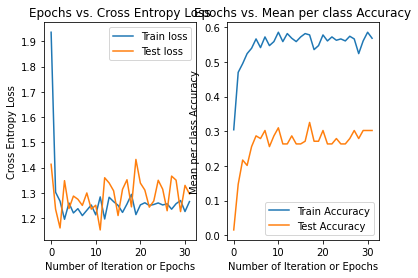

70
training cost: 1.3646977828219664
validation cost: 1.2780423416293778
training accuracy: 0.6011560693641619
validation accuracy: 0.4108527131782946
time elapsed: 0.618106419000469
learning rate: 0.01
momentum : 0.005
regularization: 0.5


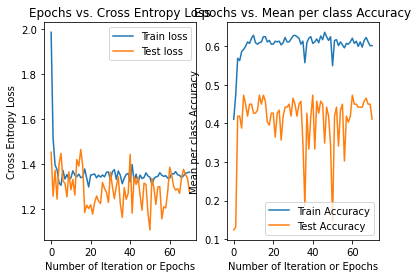

41
training cost: 1.2942001794380238
validation cost: 1.363633716066929
training accuracy: 0.628131021194605
validation accuracy: 0.2868217054263566
time elapsed: 0.35457038399999874
learning rate: 0.01
momentum : 0.005
regularization: 0.5


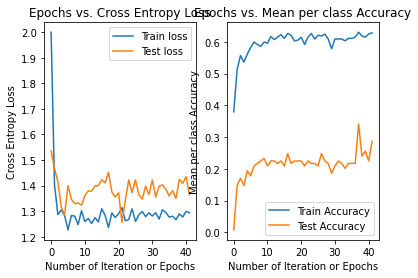

23
training cost: 1.1987520807120675
validation cost: 1.266924802231725
training accuracy: 0.6069364161849711
validation accuracy: 0.07751937984496124
time elapsed: 0.20391641599962895
learning rate: 0.01
momentum : 0.005
regularization: 0.5


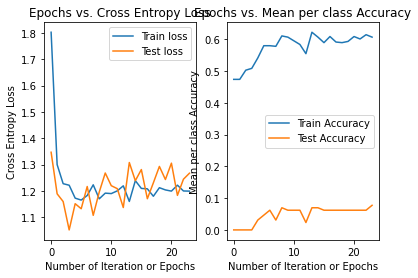

26
training cost: 1.3489314667954038
validation cost: 1.442379077568503
training accuracy: 0.5183044315992292
validation accuracy: 0.24806201550387597
time elapsed: 0.23823193699990952
learning rate: 0.01
momentum : 0.005
regularization: 0.5


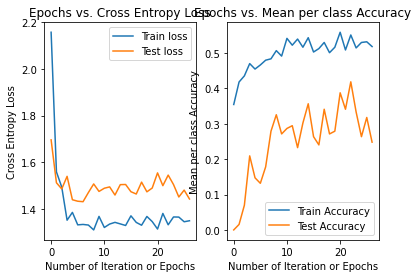

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.0
27
training cost: 1.4360711446755394
validation cost: 1.4707193492464188
training accuracy: 0.45857418111753373
validation accuracy: 0.20155038759689922
time elapsed: 0.23827316599999904
learning rate: 0.01
momentum : 0.005
regularization: 0.9


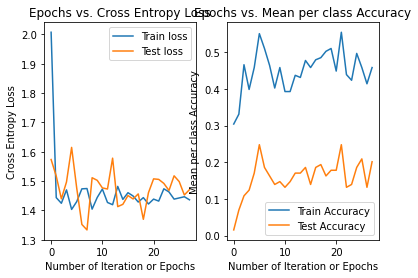

45
training cost: 1.615650696302875
validation cost: 1.4278340461425816
training accuracy: 0.5433526011560693
validation accuracy: 0.24031007751937986
time elapsed: 0.3986559289996876
learning rate: 0.01
momentum : 0.005
regularization: 0.9


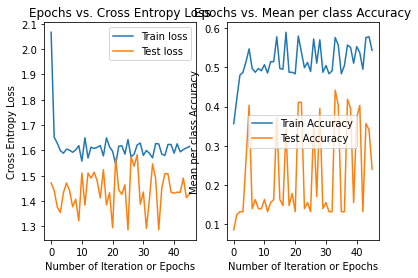

32
training cost: 1.4479212543966933
validation cost: 1.6377750744066524
training accuracy: 0.5626204238921002
validation accuracy: 0.1937984496124031
time elapsed: 0.2882714750003288
learning rate: 0.01
momentum : 0.005
regularization: 0.9


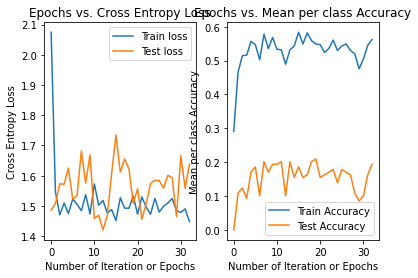

31
training cost: 1.3963208375229959
validation cost: 1.4659047987235443
training accuracy: 0.4932562620423892
validation accuracy: 0.0
time elapsed: 0.271201628000199
learning rate: 0.01
momentum : 0.005
regularization: 0.9


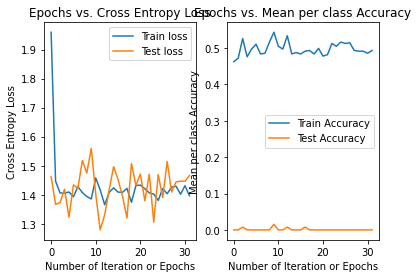

22
training cost: 1.632734393818843
validation cost: 1.7567775489769646
training accuracy: 0.4508670520231214
validation accuracy: 0.09302325581395349
time elapsed: 0.19796196799961763
learning rate: 0.01
momentum : 0.005
regularization: 0.9


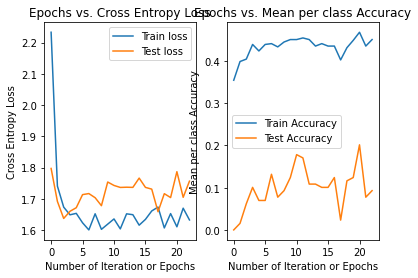

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.0
117
training cost: 0.6361832121351041
validation cost: 0.6706749666132046
training accuracy: 0.6454720616570327
validation accuracy: 0.4806201550387597
time elapsed: 0.39265478200013604
learning rate: 0.01
momentum : 0.005
regularization: 0.1


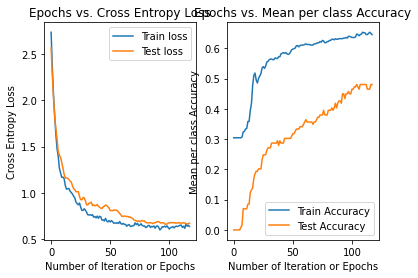

92
training cost: 0.5245422887066372
validation cost: 0.719091760348223
training accuracy: 0.7186897880539499
validation accuracy: 0.5503875968992248
time elapsed: 0.32170691800001805
learning rate: 0.01
momentum : 0.005
regularization: 0.1


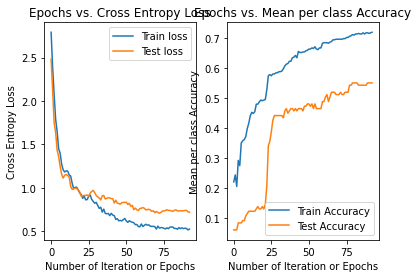

103
training cost: 0.5867541339987531
validation cost: 0.7779977007749338
training accuracy: 0.7013487475915221
validation accuracy: 0.43410852713178294
time elapsed: 0.3855616579994603
learning rate: 0.01
momentum : 0.005
regularization: 0.1


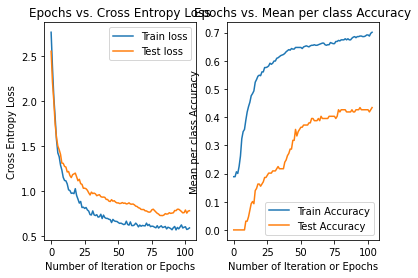

73
training cost: 0.5406335230879792
validation cost: 0.784565940532123
training accuracy: 0.6917148362235067
validation accuracy: 0.17829457364341086
time elapsed: 0.249067173000185
learning rate: 0.01
momentum : 0.005
regularization: 0.1


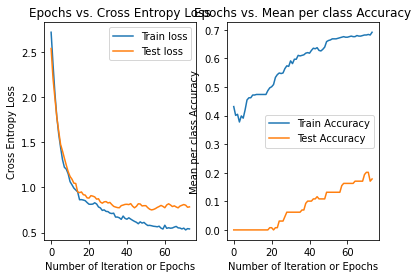

108
training cost: 0.5525804127641439
validation cost: 0.8156124811234222
training accuracy: 0.7263969171483622
validation accuracy: 0.689922480620155
time elapsed: 0.3661822200001552
learning rate: 0.01
momentum : 0.005
regularization: 0.1


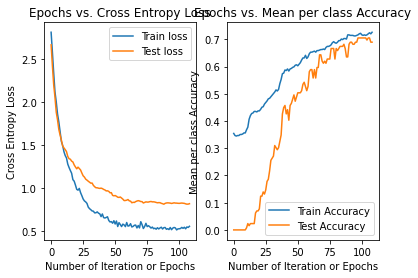

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.0
46
training cost: 1.1219560203588341
validation cost: 1.2739528755998968
training accuracy: 0.5221579961464354
validation accuracy: 0.2713178294573643
time elapsed: 0.1633928979999837
learning rate: 0.01
momentum : 0.005
regularization: 0.5


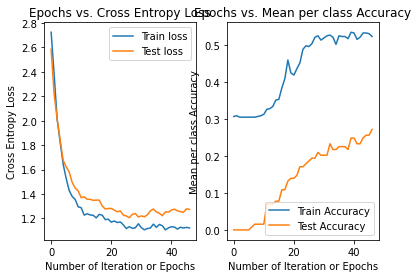

52
training cost: 1.1894268288410743
validation cost: 1.3590392748413251
training accuracy: 0.603082851637765
validation accuracy: 0.4573643410852713
time elapsed: 0.17867863799983752
learning rate: 0.01
momentum : 0.005
regularization: 0.5


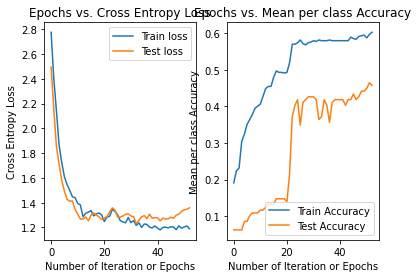

41
training cost: 1.093388630252263
validation cost: 1.369380945136557
training accuracy: 0.5838150289017341
validation accuracy: 0.20155038759689922
time elapsed: 0.15018813400001818
learning rate: 0.01
momentum : 0.005
regularization: 0.5


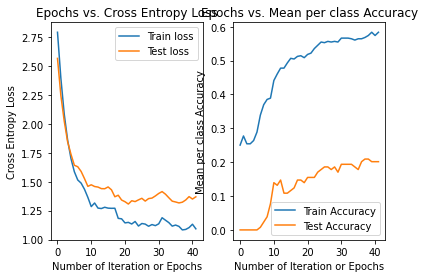

39
training cost: 1.0803642176613393
validation cost: 1.184065361358053
training accuracy: 0.5510597302504817
validation accuracy: 0.031007751937984496
time elapsed: 0.14988322600038373
learning rate: 0.01
momentum : 0.005
regularization: 0.5


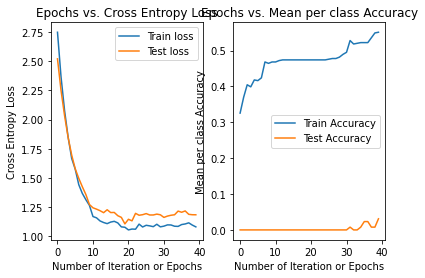

59
training cost: 1.1550576102900447
validation cost: 1.4776493217068487
training accuracy: 0.47398843930635837
validation accuracy: 0.21705426356589147
time elapsed: 0.22189873600018473
learning rate: 0.01
momentum : 0.005
regularization: 0.5


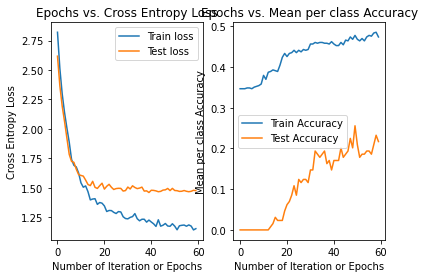

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.0
38
training cost: 1.3622410881175497
validation cost: 1.4737137077224782
training accuracy: 0.43545279383429675
validation accuracy: 0.13953488372093023
time elapsed: 0.1361692660002518
learning rate: 0.01
momentum : 0.005
regularization: 0.9


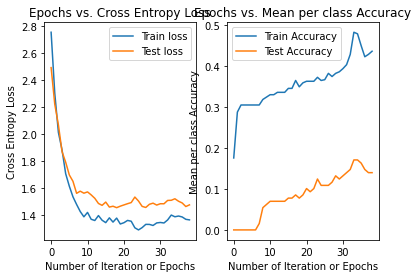

45
training cost: 1.4564840377747628
validation cost: 1.4200965352851744
training accuracy: 0.48554913294797686
validation accuracy: 0.13953488372093023
time elapsed: 0.17955958200036548
learning rate: 0.01
momentum : 0.005
regularization: 0.9


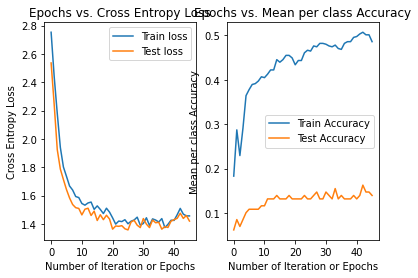

49
training cost: 1.3768076085324619
validation cost: 1.607731132638194
training accuracy: 0.558766859344894
validation accuracy: 0.17829457364341086
time elapsed: 0.19885059699936392
learning rate: 0.01
momentum : 0.005
regularization: 0.9


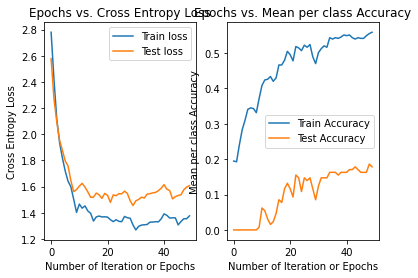

44
training cost: 1.2962946012761558
validation cost: 1.3992913664599185
training accuracy: 0.4836223506743738
validation accuracy: 0.0
time elapsed: 0.16092515399941476
learning rate: 0.01
momentum : 0.005
regularization: 0.9


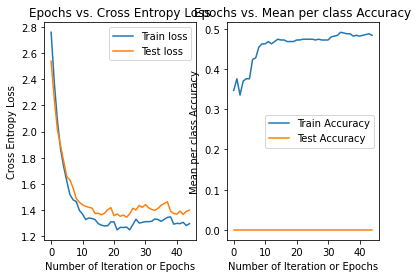

45
training cost: 1.4535281147205132
validation cost: 1.7074682940941155
training accuracy: 0.43545279383429675
validation accuracy: 0.08527131782945736
time elapsed: 0.1731477109997286
learning rate: 0.01
momentum : 0.005
regularization: 0.9


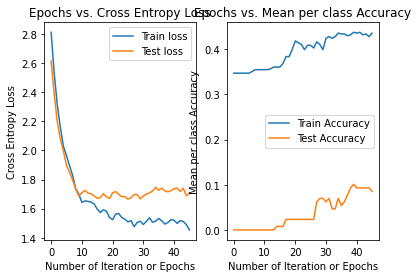

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.7674418604651163
Average cross validation score: 0.6713178294573644
Accuracy on test: 0.0
43
training cost: 1.3177121483413023
validation cost: 0.7123690942298642
training accuracy: 0.7244701348747592
validation accuracy: 0.5581395348837209
time elapsed: 2.4998813840002185
learning rate: 0.01
momentum : 0.05
regularization: 0.1


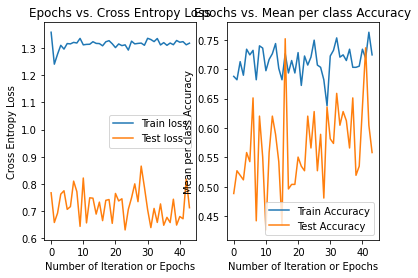

59
training cost: 1.2982467696585647
validation cost: 0.7382128506205483
training accuracy: 0.789980732177264
validation accuracy: 0.6046511627906976
time elapsed: 3.3961930579998807
learning rate: 0.01
momentum : 0.05
regularization: 0.1


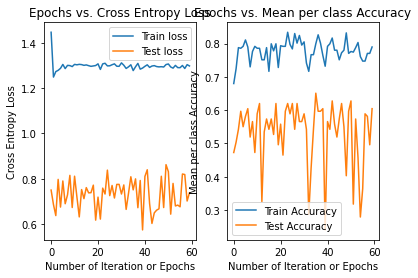

22
training cost: 1.3007689635313935
validation cost: 0.6848258483272989
training accuracy: 0.7764932562620424
validation accuracy: 0.7674418604651163
time elapsed: 1.2822372320006252
learning rate: 0.01
momentum : 0.05
regularization: 0.1


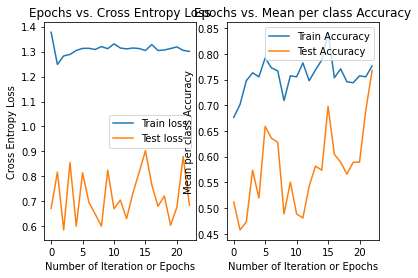

20
training cost: 1.2007774618938067
validation cost: 0.8249816951650335
training accuracy: 0.7263969171483622
validation accuracy: 0.37209302325581395
time elapsed: 1.167036926000037
learning rate: 0.01
momentum : 0.05
regularization: 0.1


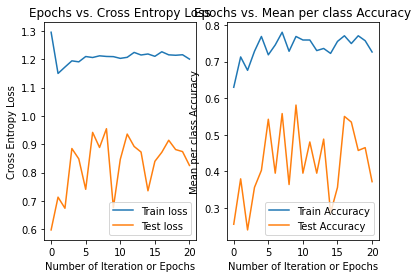

33
training cost: 1.405950325003713
validation cost: 0.8143573281832375
training accuracy: 0.8535645472061657
validation accuracy: 0.813953488372093
time elapsed: 1.9598340469992763
learning rate: 0.01
momentum : 0.05
regularization: 0.1


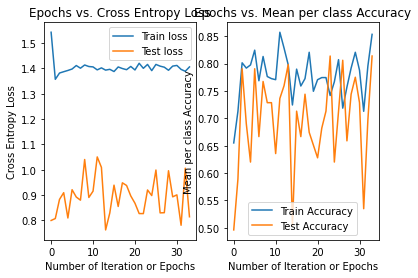

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.45714285714285713
30
training cost: 1.7325955801679307
validation cost: 1.2519665131098359
training accuracy: 0.5144508670520231
validation accuracy: 0.3023255813953488
time elapsed: 1.7524823929998092
learning rate: 0.01
momentum : 0.05
regularization: 0.5


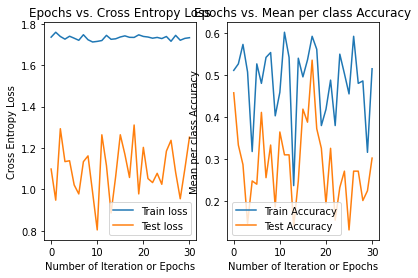

26
training cost: 1.837036508388164
validation cost: 1.15678227235056
training accuracy: 0.5105973025048169
validation accuracy: 0.17054263565891473
time elapsed: 1.4937942919996203
learning rate: 0.01
momentum : 0.05
regularization: 0.5


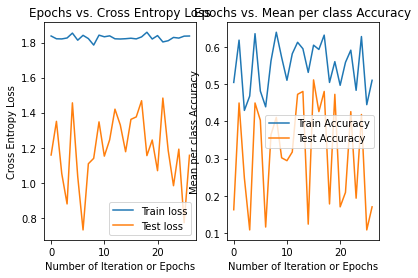

23
training cost: 1.7548368390787779
validation cost: 1.0035902867485404
training accuracy: 0.6184971098265896
validation accuracy: 0.3875968992248062
time elapsed: 1.3328572039999926
learning rate: 0.01
momentum : 0.05
regularization: 0.5


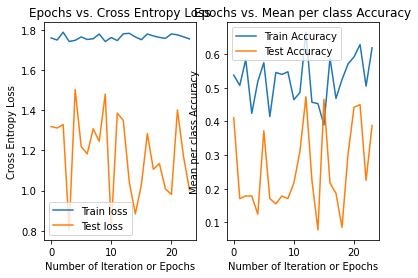

29
training cost: 1.6707186454942646
validation cost: 1.2178791101832733
training accuracy: 0.5973025048169557
validation accuracy: 0.16279069767441862
time elapsed: 1.6704487879997032
learning rate: 0.01
momentum : 0.05
regularization: 0.5


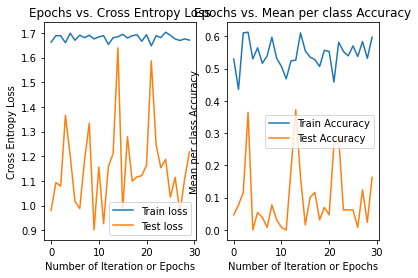

29
training cost: 1.8908922805847148
validation cost: 1.449445322730357
training accuracy: 0.5163776493256262
validation accuracy: 0.1937984496124031
time elapsed: 1.7164343899994492
learning rate: 0.01
momentum : 0.05
regularization: 0.5


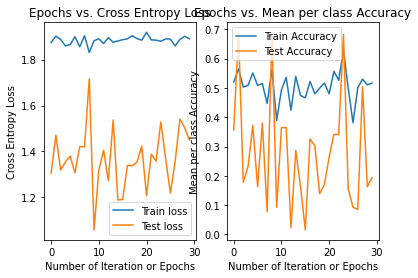

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
20
training cost: 1.8584123882017405
validation cost: 1.3070965929301377
training accuracy: 0.28516377649325625
validation accuracy: 0.12403100775193798
time elapsed: 1.3304040270004407
learning rate: 0.01
momentum : 0.05
regularization: 0.9


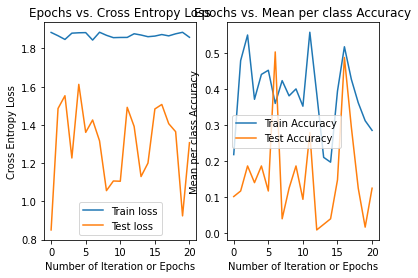

35
training cost: 2.0093029172343293
validation cost: 1.4220649746179304
training accuracy: 0.4624277456647399
validation accuracy: 0.18604651162790697
time elapsed: 1.9952805889997762
learning rate: 0.01
momentum : 0.05
regularization: 0.9


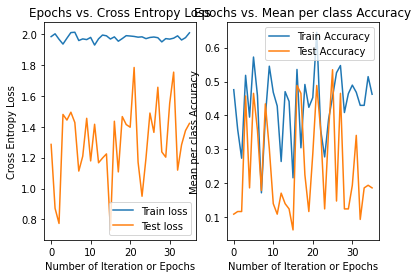

49
training cost: 1.944468219000859
validation cost: 1.2032407635132802
training accuracy: 0.36416184971098264
validation accuracy: 0.007751937984496124
time elapsed: 2.7953051049998976
learning rate: 0.01
momentum : 0.05
regularization: 0.9


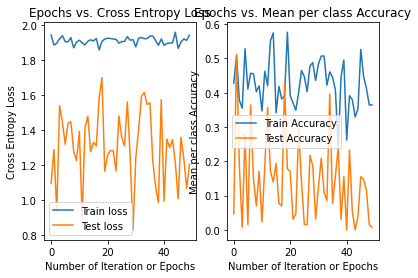

31
training cost: 1.833016307995361
validation cost: 1.0689483202458865
training accuracy: 0.31213872832369943
validation accuracy: 0.0
time elapsed: 1.7998496780001005
learning rate: 0.01
momentum : 0.05
regularization: 0.9


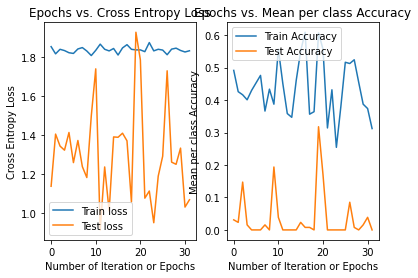

73
training cost: 2.023052080080137
validation cost: 1.4050641724296762
training accuracy: 0.4393063583815029
validation accuracy: 0.3953488372093023
time elapsed: 4.196592427999349
learning rate: 0.01
momentum : 0.05
regularization: 0.9


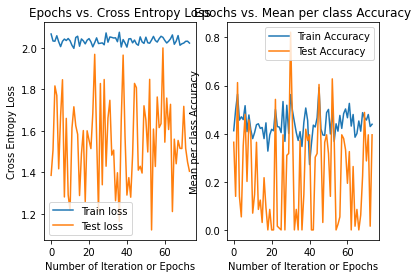

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
34
training cost: 0.7698471899949806
validation cost: 0.7215029377827323
training accuracy: 0.720616570327553
validation accuracy: 0.5736434108527132
time elapsed: 0.3094235110002046
learning rate: 0.01
momentum : 0.05
regularization: 0.1


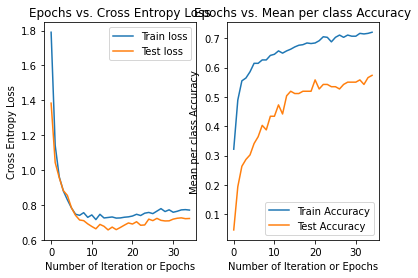

32
training cost: 0.7260288428239718
validation cost: 0.7830386620133404
training accuracy: 0.8034682080924855
validation accuracy: 0.5736434108527132
time elapsed: 0.29159058400000504
learning rate: 0.01
momentum : 0.05
regularization: 0.1


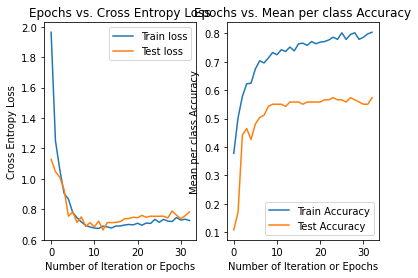

35
training cost: 0.7813512761279999
validation cost: 0.8607816422230812
training accuracy: 0.7842003853564548
validation accuracy: 0.6124031007751938
time elapsed: 0.29391162600040843
learning rate: 0.01
momentum : 0.05
regularization: 0.1


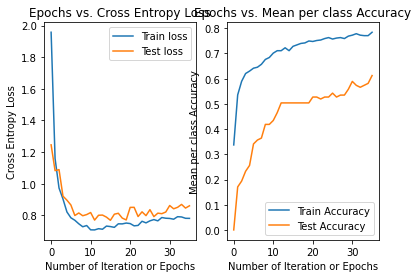

23
training cost: 0.6834093617468439
validation cost: 0.8945623741423648
training accuracy: 0.7321772639691715
validation accuracy: 0.3488372093023256
time elapsed: 0.20366972099964187
learning rate: 0.01
momentum : 0.05
regularization: 0.1


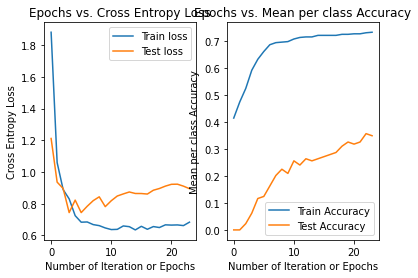

30
training cost: 0.7625137305990055
validation cost: 0.8847562664481361
training accuracy: 0.8188824662813102
validation accuracy: 0.7286821705426356
time elapsed: 0.26501116899999033
learning rate: 0.01
momentum : 0.05
regularization: 0.1


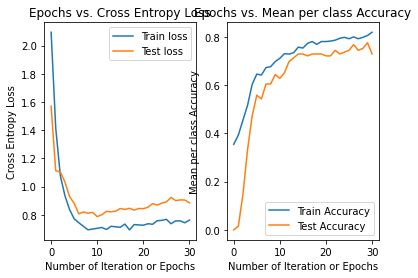

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.02857142857142857
24
training cost: 1.273183181569497
validation cost: 1.3505405872720475
training accuracy: 0.5491329479768786
validation accuracy: 0.3023255813953488
time elapsed: 0.21291029599979083
learning rate: 0.01
momentum : 0.05
regularization: 0.5


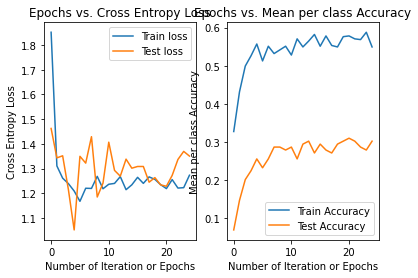

35
training cost: 1.344798392348936
validation cost: 1.2936442486217774
training accuracy: 0.6165703275529865
validation accuracy: 0.4418604651162791
time elapsed: 0.33222350899995945
learning rate: 0.01
momentum : 0.05
regularization: 0.5


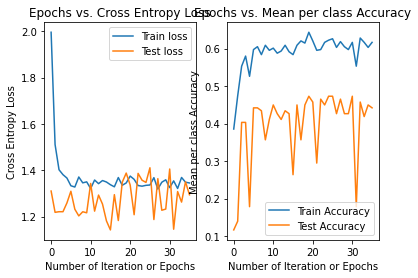

24
training cost: 1.2615095073667086
validation cost: 1.3726952280451965
training accuracy: 0.6088631984585742
validation accuracy: 0.21705426356589147
time elapsed: 0.21437377799975366
learning rate: 0.01
momentum : 0.05
regularization: 0.5


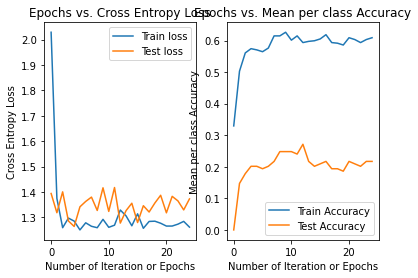

21
training cost: 1.1978281344051722
validation cost: 1.2462538384622124
training accuracy: 0.6011560693641619
validation accuracy: 0.06201550387596899
time elapsed: 0.20060186799946678
learning rate: 0.01
momentum : 0.05
regularization: 0.5


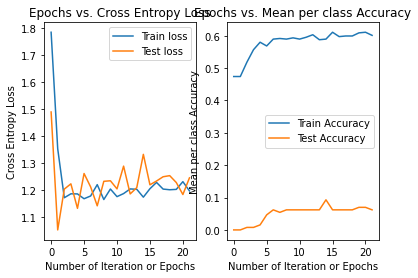

35
training cost: 1.3240270389103501
validation cost: 1.5095621271742832
training accuracy: 0.5394990366088632
validation accuracy: 0.35658914728682173
time elapsed: 0.3060460679998869
learning rate: 0.01
momentum : 0.05
regularization: 0.5


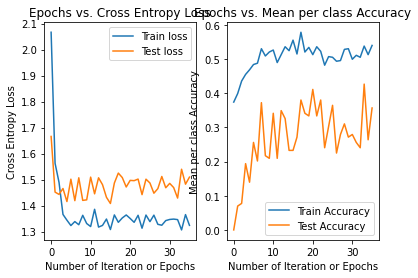

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
45
training cost: 1.4334551810182001
validation cost: 1.483542690266486
training accuracy: 0.5240847784200385
validation accuracy: 0.20930232558139536
time elapsed: 0.3923103519991855
learning rate: 0.01
momentum : 0.05
regularization: 0.9


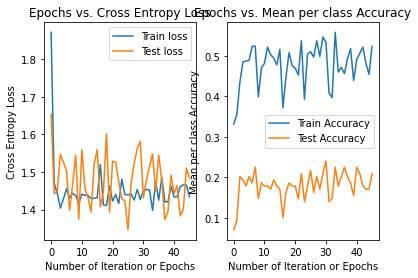

31
training cost: 1.6255715527742427
validation cost: 1.4960913356800547
training accuracy: 0.5067437379576107
validation accuracy: 0.17054263565891473
time elapsed: 0.29481904700060113
learning rate: 0.01
momentum : 0.05
regularization: 0.9


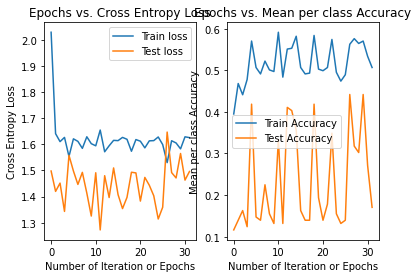

21
training cost: 1.4957055678674704
validation cost: 1.6301069539333242
training accuracy: 0.5298651252408478
validation accuracy: 0.13178294573643412
time elapsed: 0.19236569999975472
learning rate: 0.01
momentum : 0.05
regularization: 0.9


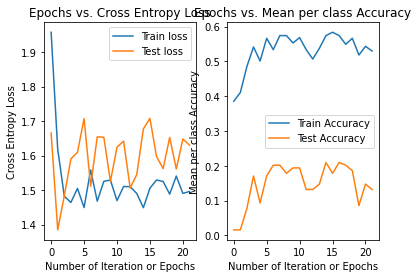

32
training cost: 1.4044310195971472
validation cost: 1.3624441673029632
training accuracy: 0.5048169556840078
validation accuracy: 0.007751937984496124
time elapsed: 0.27848106600049505
learning rate: 0.01
momentum : 0.05
regularization: 0.9


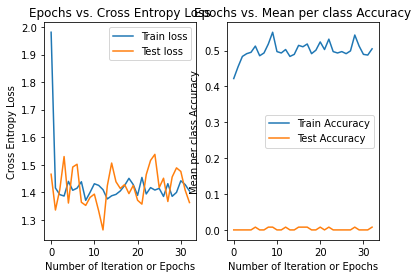

22
training cost: 1.6678986921132366
validation cost: 1.759893703322297
training accuracy: 0.45664739884393063
validation accuracy: 0.13178294573643412
time elapsed: 0.199070675999792
learning rate: 0.01
momentum : 0.05
regularization: 0.9


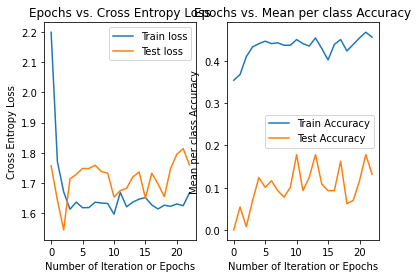

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
110
training cost: 0.622224708303255
validation cost: 0.6783023204502179
training accuracy: 0.653179190751445
validation accuracy: 0.4806201550387597
time elapsed: 0.4070560039999691
learning rate: 0.01
momentum : 0.05
regularization: 0.1


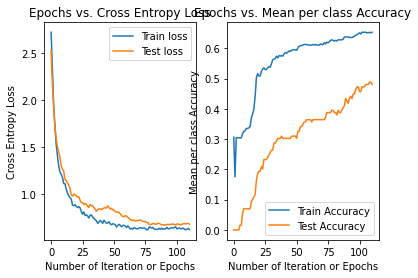

114
training cost: 0.5497350284183562
validation cost: 0.7180462949694276
training accuracy: 0.7533718689788054
validation accuracy: 0.5581395348837209
time elapsed: 0.3900895289998516
learning rate: 0.01
momentum : 0.05
regularization: 0.1


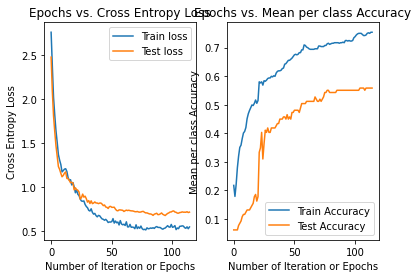

95
training cost: 0.6070771512039705
validation cost: 0.7970450923285126
training accuracy: 0.7071290944123314
validation accuracy: 0.46511627906976744
time elapsed: 0.33638066299954517
learning rate: 0.01
momentum : 0.05
regularization: 0.1


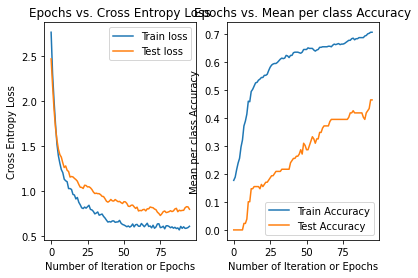

50
training cost: 0.5806137101064304
validation cost: 0.7719805378681223
training accuracy: 0.6685934489402697
validation accuracy: 0.12403100775193798
time elapsed: 0.20956649999970978
learning rate: 0.01
momentum : 0.05
regularization: 0.1


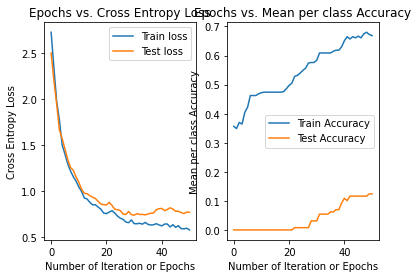

109
training cost: 0.5489423589141825
validation cost: 0.8217300628446829
training accuracy: 0.7360308285163777
validation accuracy: 0.7131782945736435
time elapsed: 0.38238581499990687
learning rate: 0.01
momentum : 0.05
regularization: 0.1


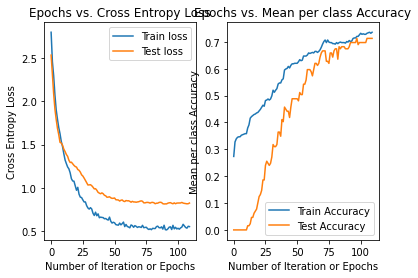

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
42
training cost: 1.0741233184337573
validation cost: 1.2385839929969424
training accuracy: 0.5298651252408478
validation accuracy: 0.2713178294573643
time elapsed: 0.1535245399991254
learning rate: 0.01
momentum : 0.05
regularization: 0.5


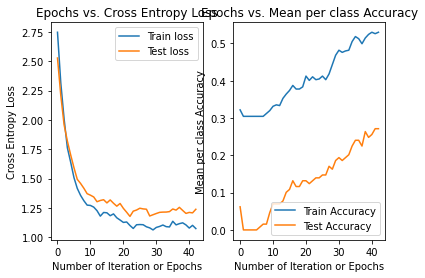

38
training cost: 1.2168936399022696
validation cost: 1.2709897777217947
training accuracy: 0.5838150289017341
validation accuracy: 0.4186046511627907
time elapsed: 0.1391703099998267
learning rate: 0.01
momentum : 0.05
regularization: 0.5


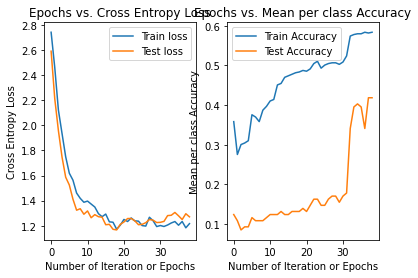

40
training cost: 1.0757754111125486
validation cost: 1.31241395722299
training accuracy: 0.5799614643545279
validation accuracy: 0.1937984496124031
time elapsed: 0.14262134000000515
learning rate: 0.01
momentum : 0.05
regularization: 0.5


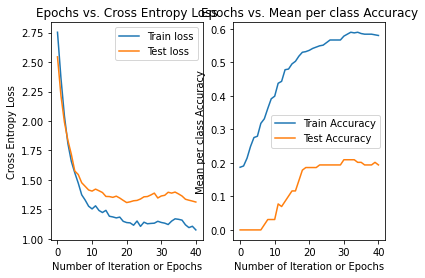

43
training cost: 1.0885917962064586
validation cost: 1.2199638178797043
training accuracy: 0.5472061657032755
validation accuracy: 0.031007751937984496
time elapsed: 0.16563955699984945
learning rate: 0.01
momentum : 0.05
regularization: 0.5


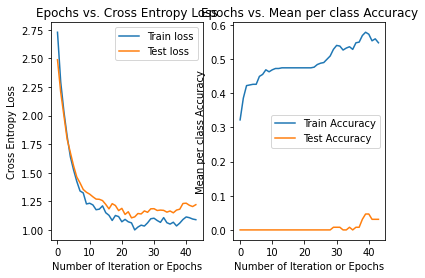

61
training cost: 1.1654749339944415
validation cost: 1.5014020725162744
training accuracy: 0.49710982658959535
validation accuracy: 0.2868217054263566
time elapsed: 0.2147733320007319
learning rate: 0.01
momentum : 0.05
regularization: 0.5


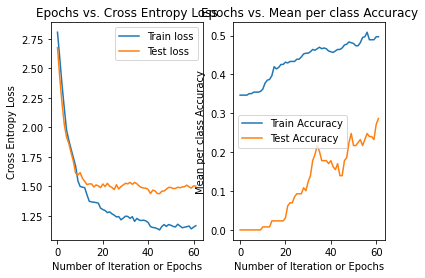

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
44
training cost: 1.3392086829094954
validation cost: 1.4650163292642293
training accuracy: 0.4816955684007707
validation accuracy: 0.17054263565891473
time elapsed: 0.16552586199941288
learning rate: 0.01
momentum : 0.05
regularization: 0.9


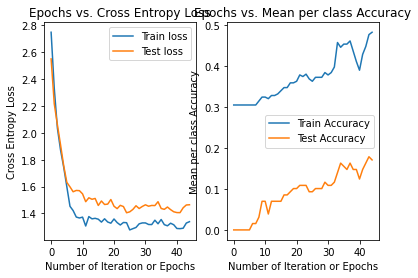

53
training cost: 1.490789698095738
validation cost: 1.4770841060253228
training accuracy: 0.5703275529865125
validation accuracy: 0.32558139534883723
time elapsed: 0.18730186700031481
learning rate: 0.01
momentum : 0.05
regularization: 0.9


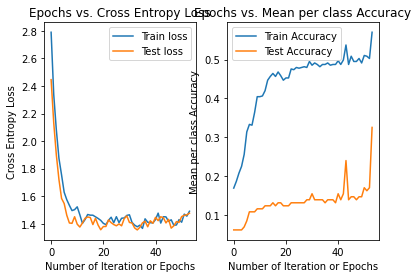

48
training cost: 1.344532434325255
validation cost: 1.57407642901231
training accuracy: 0.5433526011560693
validation accuracy: 0.17054263565891473
time elapsed: 0.16568179699970642
learning rate: 0.01
momentum : 0.05
regularization: 0.9


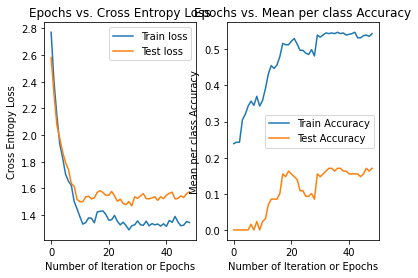

39
training cost: 1.2759614832058794
validation cost: 1.3978137854511932
training accuracy: 0.4797687861271676
validation accuracy: 0.0
time elapsed: 0.14835892199971568
learning rate: 0.01
momentum : 0.05
regularization: 0.9


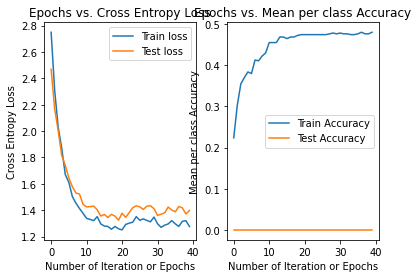

39
training cost: 1.5151688599352735
validation cost: 1.7172596967596205
training accuracy: 0.4489402697495183
validation accuracy: 0.09302325581395349
time elapsed: 0.13985083800071152
learning rate: 0.01
momentum : 0.05
regularization: 0.9


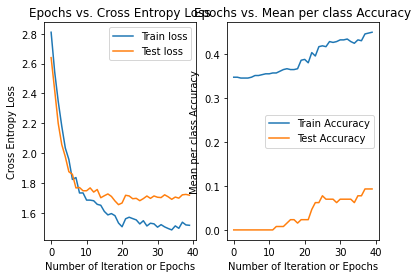

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
37
training cost: 1.324955801797394
validation cost: 0.6538746229895014
training accuracy: 0.7225433526011561
validation accuracy: 0.689922480620155
time elapsed: 2.1437495860000126
learning rate: 0.01
momentum : 0.5
regularization: 0.1


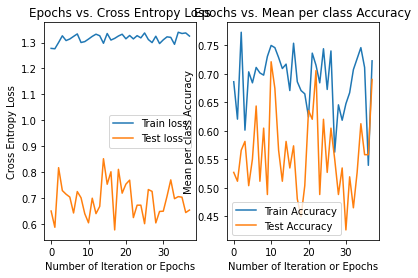

20
training cost: 1.2852637805788447
validation cost: 0.77297417293667
training accuracy: 0.7475915221579962
validation accuracy: 0.5658914728682171
time elapsed: 1.2036515930003588
learning rate: 0.01
momentum : 0.5
regularization: 0.1


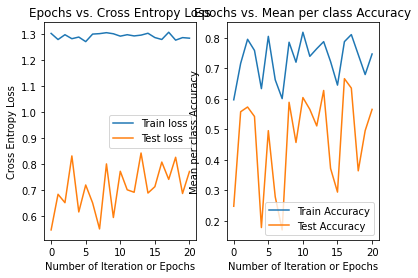

20
training cost: 1.330603179096016
validation cost: 0.8014636853831002
training accuracy: 0.7822736030828517
validation accuracy: 0.6589147286821705
time elapsed: 1.1686373299999104
learning rate: 0.01
momentum : 0.5
regularization: 0.1


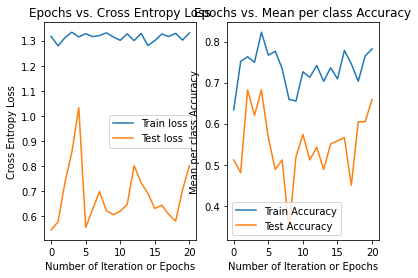

38
training cost: 1.2317921292401681
validation cost: 0.7430285029154348
training accuracy: 0.7707129094412332
validation accuracy: 0.5426356589147286
time elapsed: 2.2152768639998612
learning rate: 0.01
momentum : 0.5
regularization: 0.1


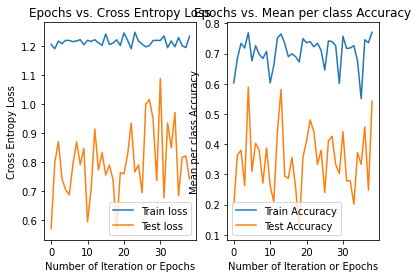

25
training cost: 1.383104264641232
validation cost: 1.0919272010980778
training accuracy: 0.7957610789980732
validation accuracy: 0.5581395348837209
time elapsed: 1.4776562249999188
learning rate: 0.01
momentum : 0.5
regularization: 0.1


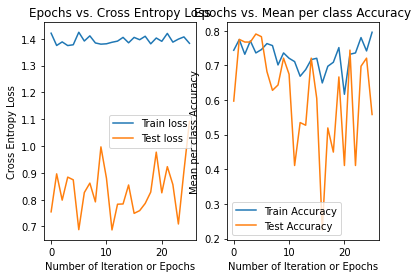

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
25
training cost: 1.7195041522503032
validation cost: 0.9959001220169341
training accuracy: 0.4605009633911368
validation accuracy: 0.37209302325581395
time elapsed: 1.5620390120002412
learning rate: 0.01
momentum : 0.5
regularization: 0.5


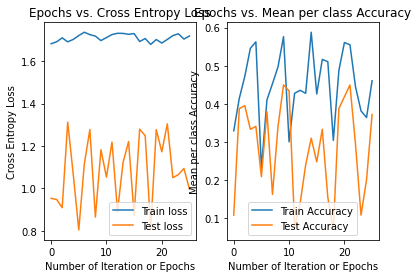

20
training cost: 1.7815414458806063
validation cost: 1.04732279165394
training accuracy: 0.48747591522157996
validation accuracy: 0.46511627906976744
time elapsed: 1.165010521000113
learning rate: 0.01
momentum : 0.5
regularization: 0.5


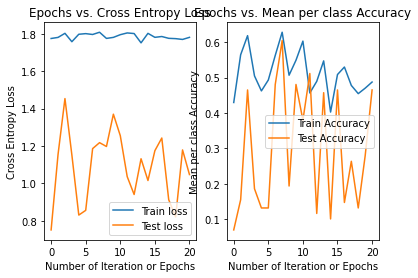

22
training cost: 1.7162454097864341
validation cost: 1.1267832972191023
training accuracy: 0.5144508670520231
validation accuracy: 0.2558139534883721
time elapsed: 1.3004645599994547
learning rate: 0.01
momentum : 0.5
regularization: 0.5


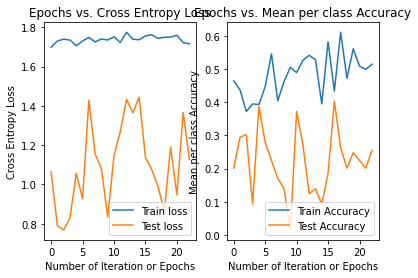

47
training cost: 1.6554998732557644
validation cost: 1.2147430298035664
training accuracy: 0.5510597302504817
validation accuracy: 0.11627906976744186
time elapsed: 2.69834123200053
learning rate: 0.01
momentum : 0.5
regularization: 0.5


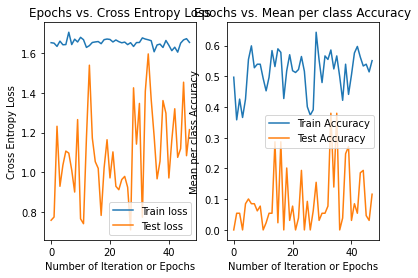

44
training cost: 1.8579936043999645
validation cost: 1.112857578871914
training accuracy: 0.43545279383429675
validation accuracy: 0.37209302325581395
time elapsed: 2.5485673809998843
learning rate: 0.01
momentum : 0.5
regularization: 0.5


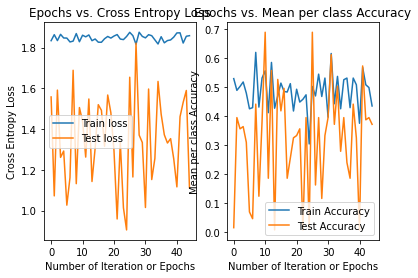

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
32
training cost: 1.8335471406410986
validation cost: 1.6048739737465598
training accuracy: 0.4373795761078998
validation accuracy: 0.40310077519379844
time elapsed: 2.077965306000806
learning rate: 0.01
momentum : 0.5
regularization: 0.9


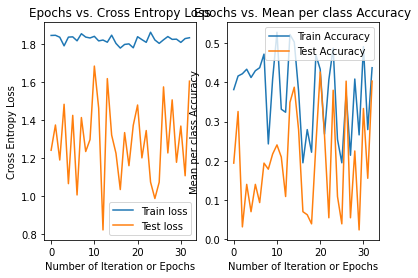

22
training cost: 1.9523633380095924
validation cost: 1.2685758310933575
training accuracy: 0.44508670520231214
validation accuracy: 0.13178294573643412
time elapsed: 1.2800640980003664
learning rate: 0.01
momentum : 0.5
regularization: 0.9


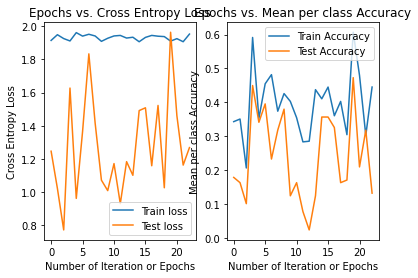

54
training cost: 1.820365629464711
validation cost: 1.2949982996511793
training accuracy: 0.4682080924855491
validation accuracy: 0.24031007751937986
time elapsed: 3.112126036000518
learning rate: 0.01
momentum : 0.5
regularization: 0.9


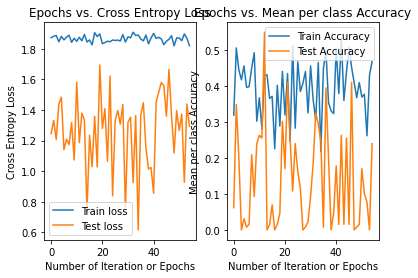

23
training cost: 1.76193537669871
validation cost: 1.3768611578048886
training accuracy: 0.45472061657032753
validation accuracy: 0.0
time elapsed: 1.3390714349998234
learning rate: 0.01
momentum : 0.5
regularization: 0.9


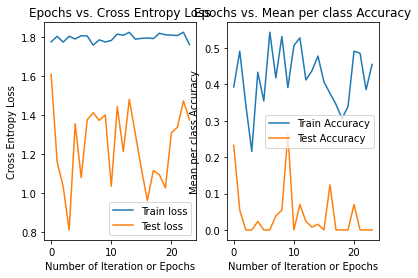

48
training cost: 1.950854610639152
validation cost: 1.1455993884371445
training accuracy: 0.29672447013487474
validation accuracy: 0.015503875968992248
time elapsed: 2.742603763000261
learning rate: 0.01
momentum : 0.5
regularization: 0.9


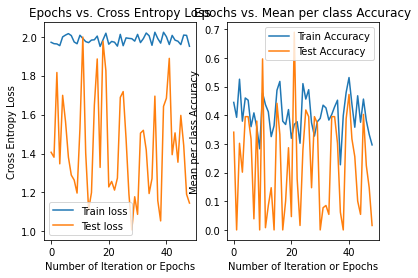

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
23
training cost: 0.7662398632984654
validation cost: 0.7044676555233281
training accuracy: 0.7148362235067437
validation accuracy: 0.5581395348837209
time elapsed: 0.20669547999932547
learning rate: 0.01
momentum : 0.5
regularization: 0.1


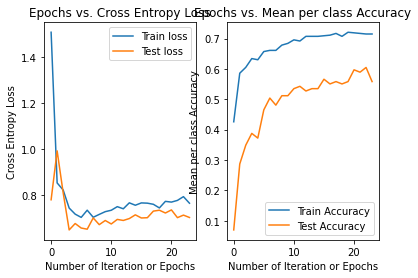

28
training cost: 0.7464658965247286
validation cost: 0.7838256691778398
training accuracy: 0.8131021194605009
validation accuracy: 0.5813953488372093
time elapsed: 0.3132907469998827
learning rate: 0.01
momentum : 0.5
regularization: 0.1


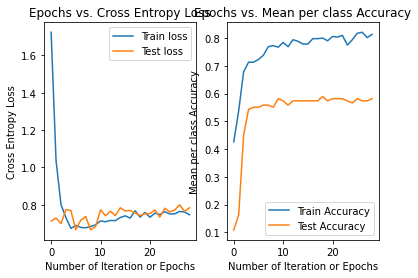

25
training cost: 0.820823509152445
validation cost: 0.7858868906178533
training accuracy: 0.7784200385356455
validation accuracy: 0.5891472868217055
time elapsed: 0.22159340899997915
learning rate: 0.01
momentum : 0.5
regularization: 0.1


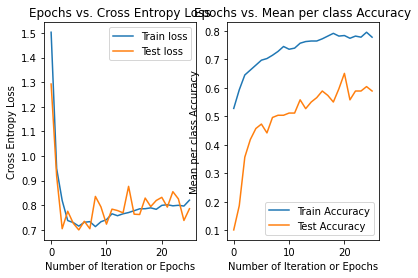

23
training cost: 0.7068264328978084
validation cost: 0.9226496402512663
training accuracy: 0.7398843930635838
validation accuracy: 0.3798449612403101
time elapsed: 0.2131178519994137
learning rate: 0.01
momentum : 0.5
regularization: 0.1


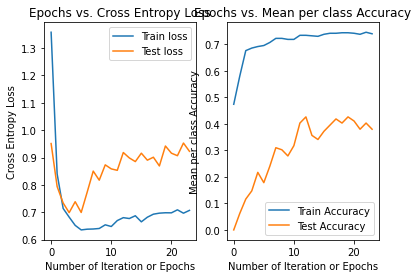

27
training cost: 0.8172863338756176
validation cost: 0.8955650820611938
training accuracy: 0.8111753371868978
validation accuracy: 0.7209302325581395
time elapsed: 0.23545089299932442
learning rate: 0.01
momentum : 0.5
regularization: 0.1


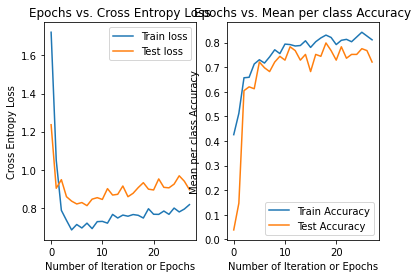

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.08571428571428572
34
training cost: 1.2318442382246197
validation cost: 1.4142540024183277
training accuracy: 0.5394990366088632
validation accuracy: 0.3023255813953488
time elapsed: 0.30479942399961146
learning rate: 0.01
momentum : 0.5
regularization: 0.5


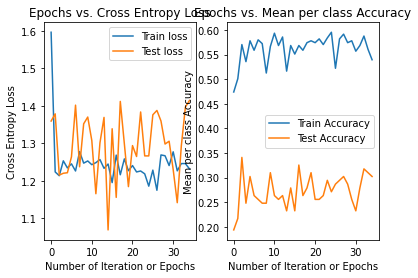

20
training cost: 1.291551662892479
validation cost: 1.3339827701751792
training accuracy: 0.6358381502890174
validation accuracy: 0.4496124031007752
time elapsed: 0.17932348199974513
learning rate: 0.01
momentum : 0.5
regularization: 0.5


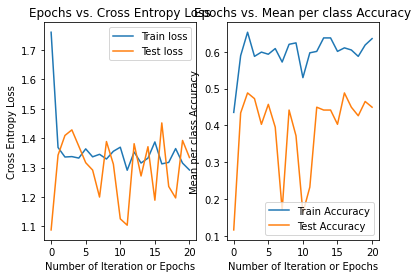

48
training cost: 1.2920877478486037
validation cost: 1.3636008975990437
training accuracy: 0.6146435452793835
validation accuracy: 0.2248062015503876
time elapsed: 0.43093399800000043
learning rate: 0.01
momentum : 0.5
regularization: 0.5


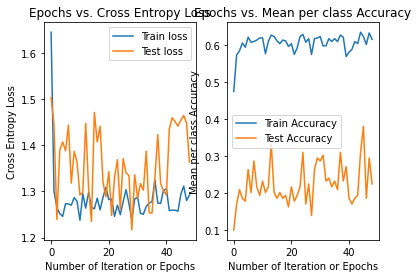

28
training cost: 1.19237982337363
validation cost: 1.2072791050800165
training accuracy: 0.5799614643545279
validation accuracy: 0.06201550387596899
time elapsed: 0.25828823800020473
learning rate: 0.01
momentum : 0.5
regularization: 0.5


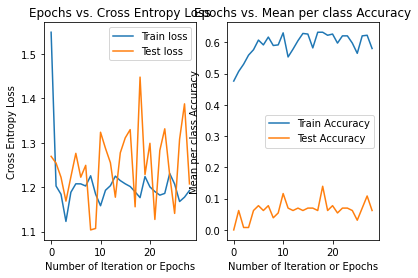

40
training cost: 1.3331011645821884
validation cost: 1.496820942498346
training accuracy: 0.5414258188824663
validation accuracy: 0.4108527131782946
time elapsed: 0.34584987800008093
learning rate: 0.01
momentum : 0.5
regularization: 0.5


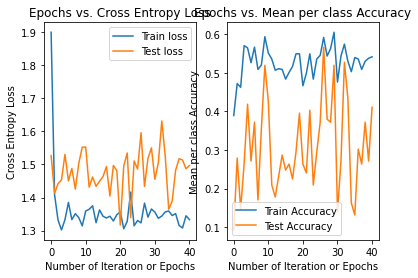

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
31
training cost: 1.4426840765097566
validation cost: 1.3820829651694317
training accuracy: 0.43545279383429675
validation accuracy: 0.24031007751937986
time elapsed: 0.2852465080004549
learning rate: 0.01
momentum : 0.5
regularization: 0.9


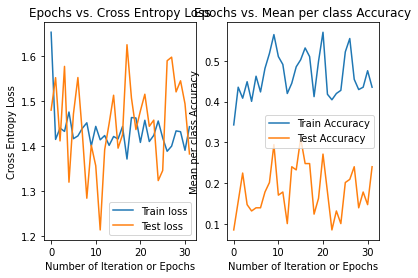

29
training cost: 1.55583534718251
validation cost: 1.5634542073434148
training accuracy: 0.5703275529865125
validation accuracy: 0.3953488372093023
time elapsed: 0.2605908489995272
learning rate: 0.01
momentum : 0.5
regularization: 0.9


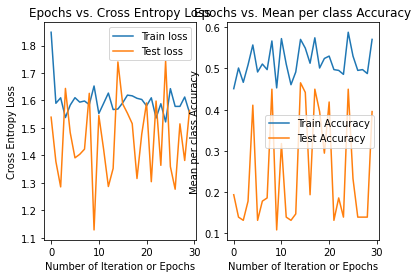

29
training cost: 1.5402988063107965
validation cost: 1.5382492185192886
training accuracy: 0.4913294797687861
validation accuracy: 0.09302325581395349
time elapsed: 0.2615769789999831
learning rate: 0.01
momentum : 0.5
regularization: 0.9


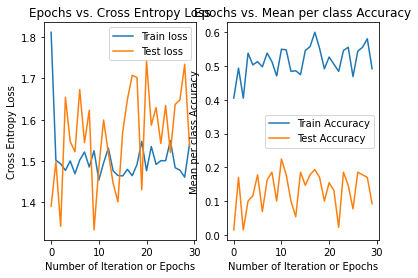

20
training cost: 1.4118780753104132
validation cost: 1.273438623661967
training accuracy: 0.5202312138728323
validation accuracy: 0.007751937984496124
time elapsed: 0.19614732399986679
learning rate: 0.01
momentum : 0.5
regularization: 0.9


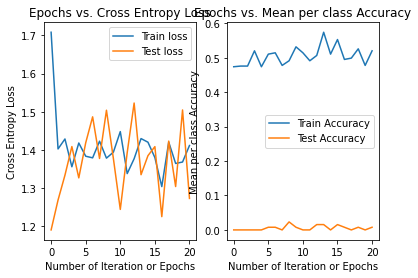

40
training cost: 1.6127487108839422
validation cost: 1.6656293170474785
training accuracy: 0.4489402697495183
validation accuracy: 0.10077519379844961
time elapsed: 0.349286081000173
learning rate: 0.01
momentum : 0.5
regularization: 0.9


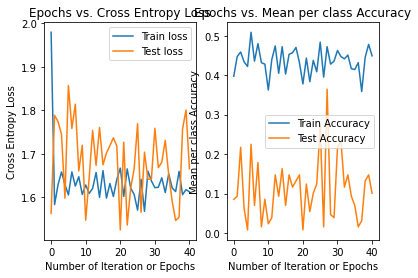

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
72
training cost: 0.6576601163654213
validation cost: 0.6632967503982059
training accuracy: 0.6763005780346821
validation accuracy: 0.5348837209302325
time elapsed: 0.26182118900032947
learning rate: 0.01
momentum : 0.5
regularization: 0.1


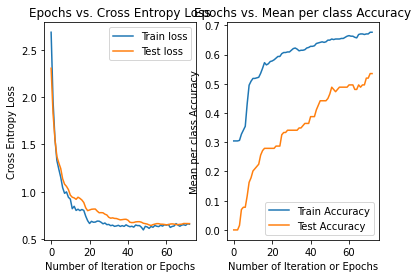

78
training cost: 0.557174731866598
validation cost: 0.7310780287033197
training accuracy: 0.7687861271676301
validation accuracy: 0.5581395348837209
time elapsed: 0.2693859439996231
learning rate: 0.01
momentum : 0.5
regularization: 0.1


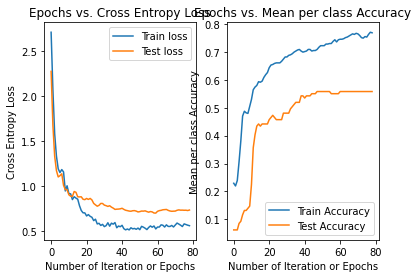

64
training cost: 0.59913326007968
validation cost: 0.782778677451786
training accuracy: 0.7263969171483622
validation accuracy: 0.5038759689922481
time elapsed: 0.22634668899991084
learning rate: 0.01
momentum : 0.5
regularization: 0.1


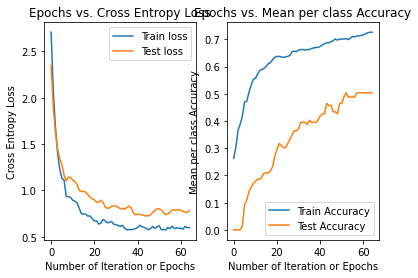

47
training cost: 0.5064914249014298
validation cost: 0.804081433889989
training accuracy: 0.6994219653179191
validation accuracy: 0.2248062015503876
time elapsed: 0.17426680300013686
learning rate: 0.01
momentum : 0.5
regularization: 0.1


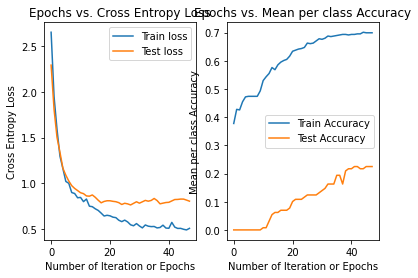

68
training cost: 0.5474376435597677
validation cost: 0.8438738318070418
training accuracy: 0.7649325626204239
validation accuracy: 0.7286821705426356
time elapsed: 0.23386053400008677
learning rate: 0.01
momentum : 0.5
regularization: 0.1


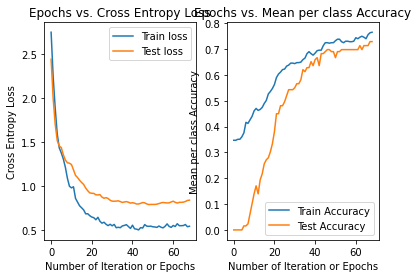

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
45
training cost: 1.1286497547490086
validation cost: 1.2600938517229894
training accuracy: 0.5529865125240848
validation accuracy: 0.2713178294573643
time elapsed: 0.17200250799942296
learning rate: 0.01
momentum : 0.5
regularization: 0.5


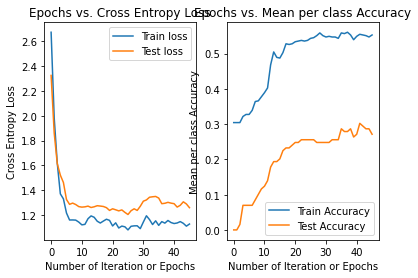

40
training cost: 1.1762958295250794
validation cost: 1.3426930106702573
training accuracy: 0.5934489402697495
validation accuracy: 0.4496124031007752
time elapsed: 0.14283405500009394
learning rate: 0.01
momentum : 0.5
regularization: 0.5


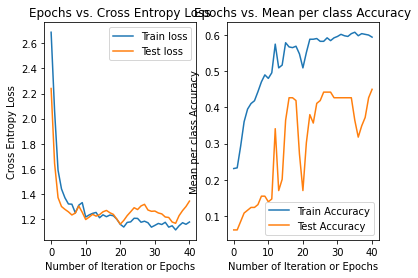

33
training cost: 1.171938831882871
validation cost: 1.3614907806972303
training accuracy: 0.6069364161849711
validation accuracy: 0.20930232558139536
time elapsed: 0.13203687999975955
learning rate: 0.01
momentum : 0.5
regularization: 0.5


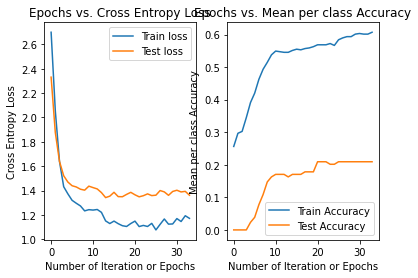

34
training cost: 1.1022385765820288
validation cost: 1.2395090986757933
training accuracy: 0.5953757225433526
validation accuracy: 0.06201550387596899
time elapsed: 0.1237774340006581
learning rate: 0.01
momentum : 0.5
regularization: 0.5


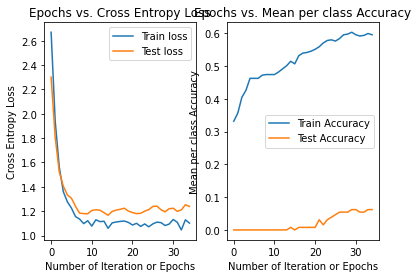

54
training cost: 1.1708815139278446
validation cost: 1.4569546233101964
training accuracy: 0.5086705202312138
validation accuracy: 0.2713178294573643
time elapsed: 0.19674764199953643
learning rate: 0.01
momentum : 0.5
regularization: 0.5


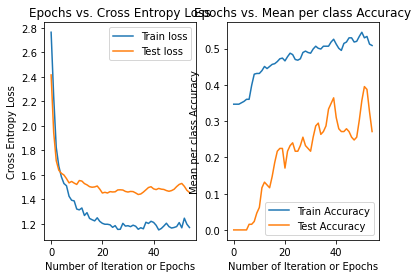

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
33
training cost: 1.3332449285539674
validation cost: 1.5034371562518114
training accuracy: 0.45472061657032753
validation accuracy: 0.13953488372093023
time elapsed: 0.12721602599958715
learning rate: 0.01
momentum : 0.5
regularization: 0.9


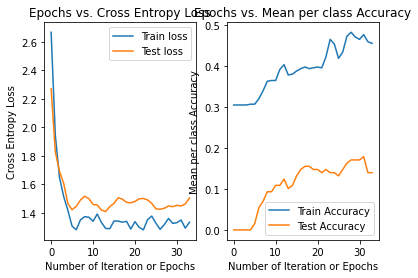

31
training cost: 1.4866963201280123
validation cost: 1.5274862624625474
training accuracy: 0.5761078998073218
validation accuracy: 0.3488372093023256
time elapsed: 0.11954844600040815
learning rate: 0.01
momentum : 0.5
regularization: 0.9


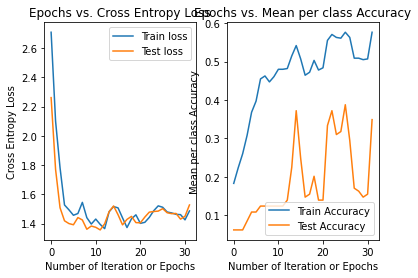

59
training cost: 1.3263419597692383
validation cost: 1.5685867429584246
training accuracy: 0.5491329479768786
validation accuracy: 0.17829457364341086
time elapsed: 0.2046920200000386
learning rate: 0.01
momentum : 0.5
regularization: 0.9


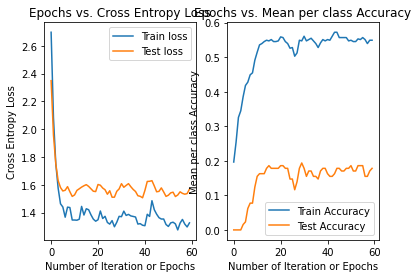

30
training cost: 1.3211054450077044
validation cost: 1.4148726757679757
training accuracy: 0.5048169556840078
validation accuracy: 0.0
time elapsed: 0.11745836199952464
learning rate: 0.01
momentum : 0.5
regularization: 0.9


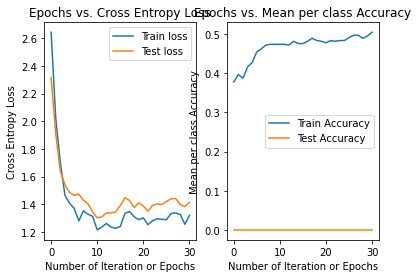

31
training cost: 1.4874185118993364
validation cost: 1.708621539958872
training accuracy: 0.43352601156069365
validation accuracy: 0.08527131782945736
time elapsed: 0.11232953299986548
learning rate: 0.01
momentum : 0.5
regularization: 0.9


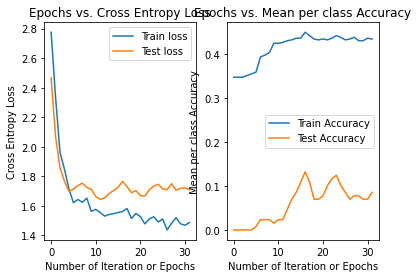

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
39
training cost: 1.3068079422896204
validation cost: 0.6887555844921113
training accuracy: 0.35260115606936415
validation accuracy: 0.4883720930232558
time elapsed: 2.24660176999987
learning rate: 0.1
momentum : 0.005
regularization: 0.1


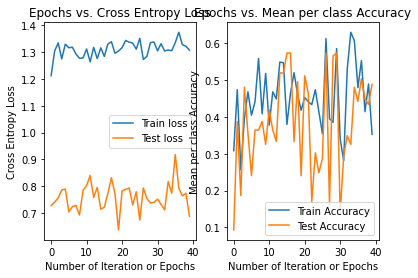

30
training cost: 1.2895034372101875
validation cost: 0.7345045395418732
training accuracy: 0.3969171483622351
validation accuracy: 0.07751937984496124
time elapsed: 1.7165174100000513
learning rate: 0.1
momentum : 0.005
regularization: 0.1


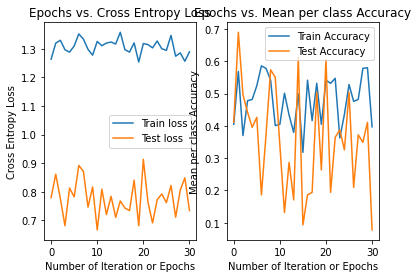

32
training cost: 1.3084860216954932
validation cost: 0.7762697781509382
training accuracy: 0.4123314065510597
validation accuracy: 0.43410852713178294
time elapsed: 1.851867964000121
learning rate: 0.1
momentum : 0.005
regularization: 0.1


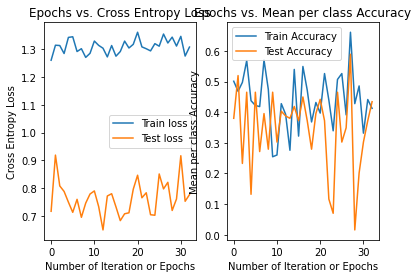

20
training cost: 1.2715790590778395
validation cost: 0.7911660988716023
training accuracy: 0.5838150289017341
validation accuracy: 0.2248062015503876
time elapsed: 1.1609453370001575
learning rate: 0.1
momentum : 0.005
regularization: 0.1


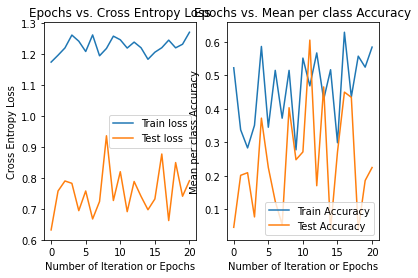

42
training cost: 1.3647214956508784
validation cost: 0.7739292887478604
training accuracy: 0.3969171483622351
validation accuracy: 0.5426356589147286
time elapsed: 2.409721813000033
learning rate: 0.1
momentum : 0.005
regularization: 0.1


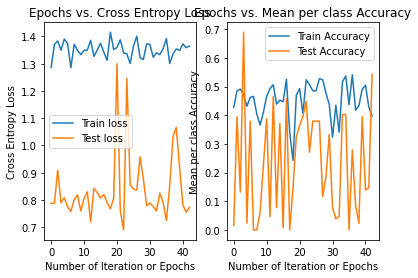

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.05714285714285714
35
training cost: 1.457227784956979
validation cost: 0.9806544660884897
training accuracy: 0.27167630057803466
validation accuracy: 0.1937984496124031
time elapsed: 2.0467052849999163
learning rate: 0.1
momentum : 0.005
regularization: 0.5


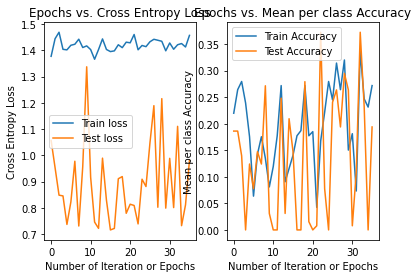

20
training cost: 1.4645979733793555
validation cost: 0.7944107990696321
training accuracy: 0.20809248554913296
validation accuracy: 0.11627906976744186
time elapsed: 1.181825406999451
learning rate: 0.1
momentum : 0.005
regularization: 0.5


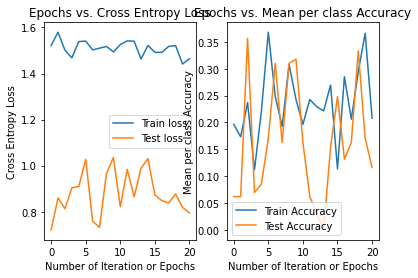

39
training cost: 1.4578035174371033
validation cost: 0.7402888265118582
training accuracy: 0.08092485549132948
validation accuracy: 0.0
time elapsed: 2.222056571000394
learning rate: 0.1
momentum : 0.005
regularization: 0.5


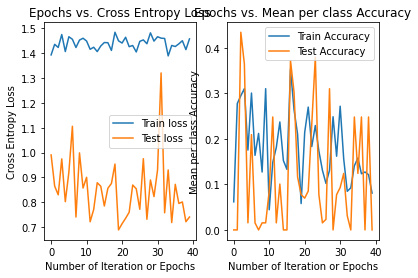

42
training cost: 1.4344433396302245
validation cost: 0.7908608329729166
training accuracy: 0.4662813102119461
validation accuracy: 0.03875968992248062
time elapsed: 2.5786838269996224
learning rate: 0.1
momentum : 0.005
regularization: 0.5


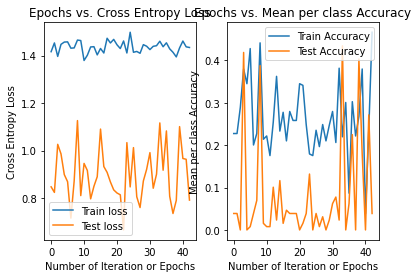

34
training cost: 1.5535698227564196
validation cost: 0.8485672617263862
training accuracy: 0.28901734104046245
validation accuracy: 0.0
time elapsed: 1.985473820000152
learning rate: 0.1
momentum : 0.005
regularization: 0.5


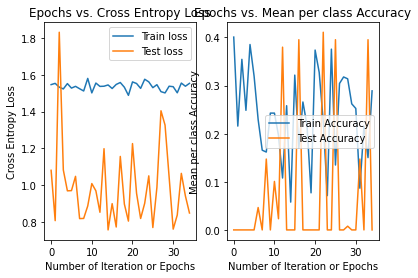

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
49
training cost: 1.4486246931892097
validation cost: 1.0097019285709268
training accuracy: 0.05009633911368015
validation accuracy: 0.20155038759689922
time elapsed: 2.9149220919998697
learning rate: 0.1
momentum : 0.005
regularization: 0.9


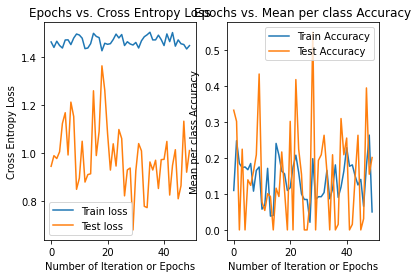

30
training cost: 1.5548378743923448
validation cost: 0.8971536367314885
training accuracy: 0.13680154142581888
validation accuracy: 0.31007751937984496
time elapsed: 1.745634078999501
learning rate: 0.1
momentum : 0.005
regularization: 0.9


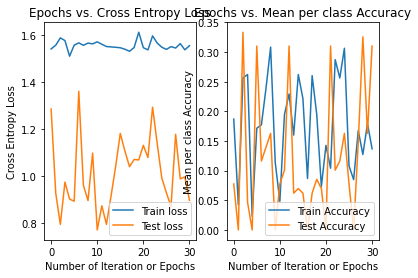

23
training cost: 1.5123905355699168
validation cost: 1.0682647933787481
training accuracy: 0.057803468208092484
validation accuracy: 0.031007751937984496
time elapsed: 1.3597309690003385
learning rate: 0.1
momentum : 0.005
regularization: 0.9


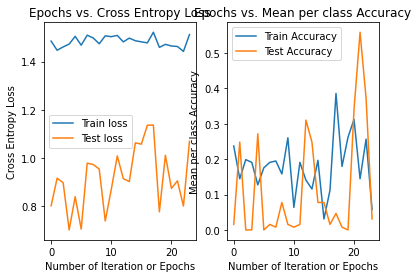

35
training cost: 1.491771785670004
validation cost: 0.9694729858969723
training accuracy: 0.03275529865125241
validation accuracy: 0.05426356589147287
time elapsed: 2.0634293160001107
learning rate: 0.1
momentum : 0.005
regularization: 0.9


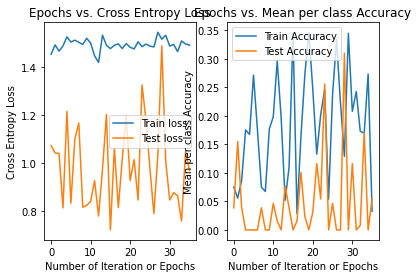

63
training cost: 1.5908880967166297
validation cost: 1.1423315651185002
training accuracy: 0.1926782273603083
validation accuracy: 0.0
time elapsed: 3.597388987999693
learning rate: 0.1
momentum : 0.005
regularization: 0.9


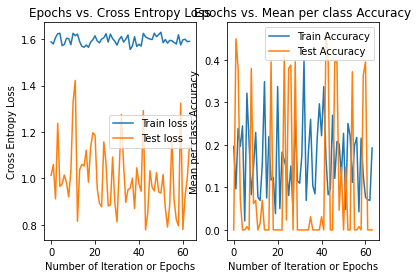

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
22
training cost: 0.7967243115355824
validation cost: 0.6734682150937052
training accuracy: 0.7013487475915221
validation accuracy: 0.5658914728682171
time elapsed: 0.21402194900019822
learning rate: 0.1
momentum : 0.005
regularization: 0.1


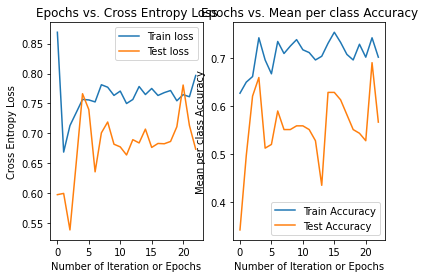

20
training cost: 0.7513398342634507
validation cost: 0.6798535537142196
training accuracy: 0.7880539499036608
validation accuracy: 0.5193798449612403
time elapsed: 0.1832829730001322
learning rate: 0.1
momentum : 0.005
regularization: 0.1


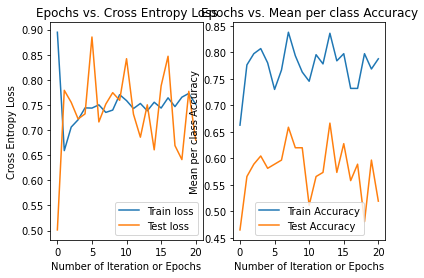

35
training cost: 0.7905034105803005
validation cost: 0.8160467928756684
training accuracy: 0.7456647398843931
validation accuracy: 0.5813953488372093
time elapsed: 0.3086305580000044
learning rate: 0.1
momentum : 0.005
regularization: 0.1


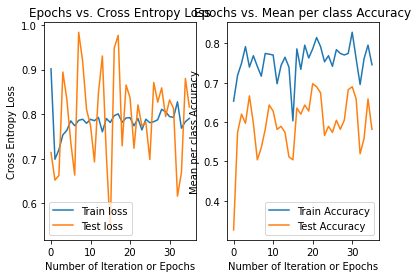

20
training cost: 0.7106221887909183
validation cost: 0.6963730223129305
training accuracy: 0.7052023121387283
validation accuracy: 0.3953488372093023
time elapsed: 0.18911185799970553
learning rate: 0.1
momentum : 0.005
regularization: 0.1


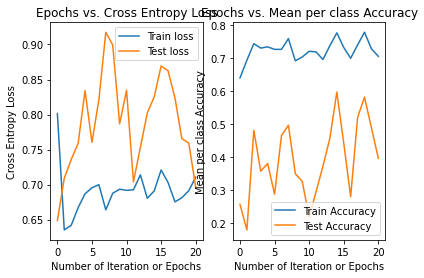

41
training cost: 0.789879188707913
validation cost: 0.929303776605384
training accuracy: 0.8188824662813102
validation accuracy: 0.7829457364341085
time elapsed: 0.3534455640001397
learning rate: 0.1
momentum : 0.005
regularization: 0.1


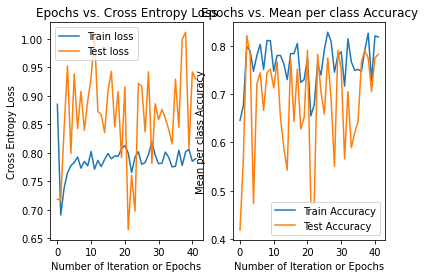

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.17142857142857143
26
training cost: 1.1451738703470402
validation cost: 1.1879642071674557
training accuracy: 0.51252408477842
validation accuracy: 0.2248062015503876
time elapsed: 0.25011423300020397
learning rate: 0.1
momentum : 0.005
regularization: 0.5


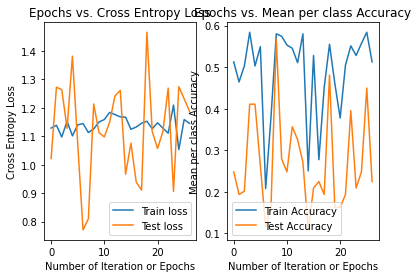

34
training cost: 1.25438770309925
validation cost: 0.997432025422319
training accuracy: 0.5568400770712909
validation accuracy: 0.35658914728682173
time elapsed: 0.3022654460000922
learning rate: 0.1
momentum : 0.005
regularization: 0.5


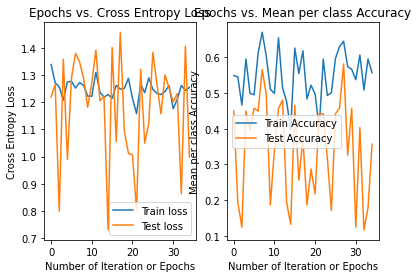

38
training cost: 1.203870911667836
validation cost: 1.3381741720725033
training accuracy: 0.48940269749518306
validation accuracy: 0.4186046511627907
time elapsed: 0.33561744800044835
learning rate: 0.1
momentum : 0.005
regularization: 0.5


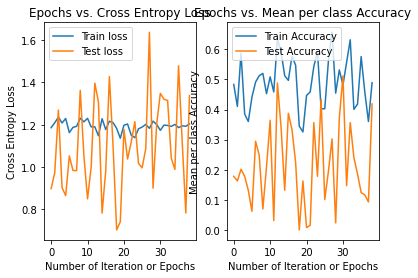

24
training cost: 1.1552103942116827
validation cost: 1.0878106564845216
training accuracy: 0.558766859344894
validation accuracy: 0.06976744186046512
time elapsed: 0.21924614899944572
learning rate: 0.1
momentum : 0.005
regularization: 0.5


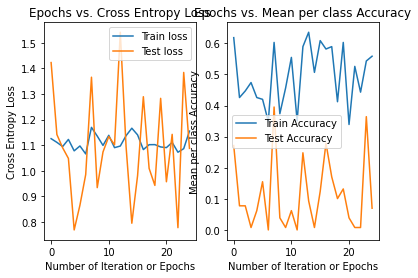

43
training cost: 1.3372447995659682
validation cost: 1.3856903684209674
training accuracy: 0.5048169556840078
validation accuracy: 0.27906976744186046
time elapsed: 0.37139466300050117
learning rate: 0.1
momentum : 0.005
regularization: 0.5


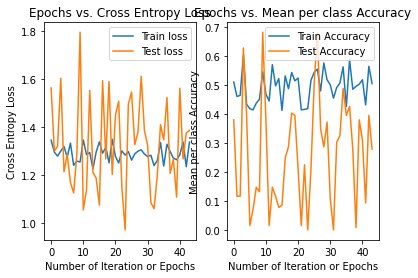

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
33
training cost: 1.284611235707081
validation cost: 1.833483710938339
training accuracy: 0.5664739884393064
validation accuracy: 0.32558139534883723
time elapsed: 0.3001435099995433
learning rate: 0.1
momentum : 0.005
regularization: 0.9


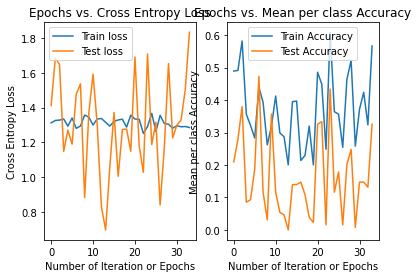

34
training cost: 1.3965414660506021
validation cost: 1.2097277863709401
training accuracy: 0.3217726396917148
validation accuracy: 0.15503875968992248
time elapsed: 0.30905899399931513
learning rate: 0.1
momentum : 0.005
regularization: 0.9


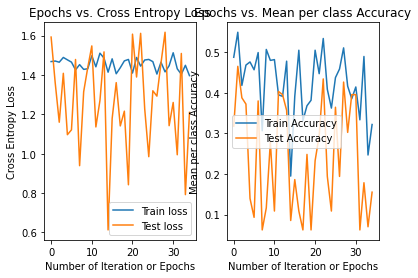

25
training cost: 1.3617361190136885
validation cost: 1.1230786422184575
training accuracy: 0.3872832369942196
validation accuracy: 0.17829457364341086
time elapsed: 0.22411589300008927
learning rate: 0.1
momentum : 0.005
regularization: 0.9


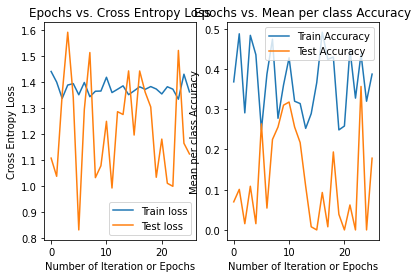

20
training cost: 1.280588330120517
validation cost: 1.2250421436941556
training accuracy: 0.47784200385356457
validation accuracy: 0.0
time elapsed: 0.18520659399928263
learning rate: 0.1
momentum : 0.005
regularization: 0.9


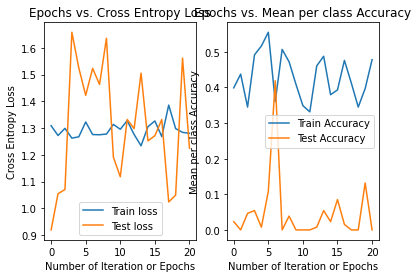

38
training cost: 1.5499556051664798
validation cost: 1.453362982425994
training accuracy: 0.3988439306358382
validation accuracy: 0.007751937984496124
time elapsed: 0.32838290099971346
learning rate: 0.1
momentum : 0.005
regularization: 0.9


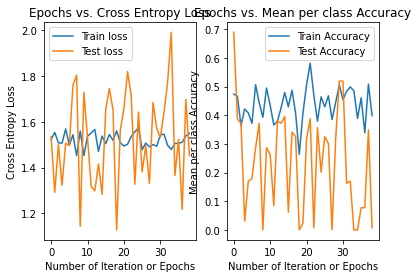

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
26
training cost: 0.6744197997502677
validation cost: 0.7335094146363983
training accuracy: 0.6782273603082851
validation accuracy: 0.5038759689922481
time elapsed: 0.12630247699962638
learning rate: 0.1
momentum : 0.005
regularization: 0.1


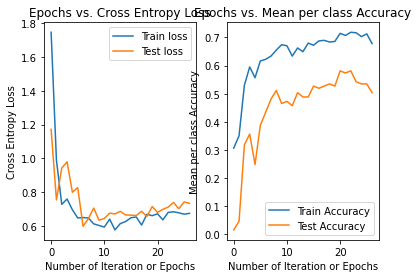

28
training cost: 0.6471202047166594
validation cost: 0.7199410568836058
training accuracy: 0.7764932562620424
validation accuracy: 0.5813953488372093
time elapsed: 0.11735047299953294
learning rate: 0.1
momentum : 0.005
regularization: 0.1


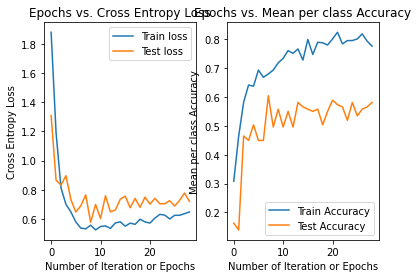

25
training cost: 0.6374550934259519
validation cost: 0.7399081354255364
training accuracy: 0.7360308285163777
validation accuracy: 0.6434108527131783
time elapsed: 0.10085368700038089
learning rate: 0.1
momentum : 0.005
regularization: 0.1


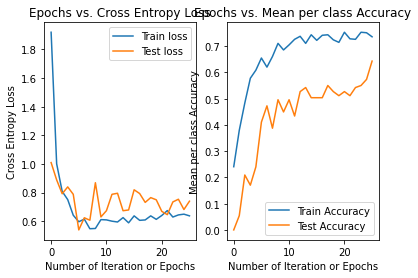

26
training cost: 0.5682553650520096
validation cost: 0.8477491955941254
training accuracy: 0.720616570327553
validation accuracy: 0.3178294573643411
time elapsed: 0.10377414300000964
learning rate: 0.1
momentum : 0.005
regularization: 0.1


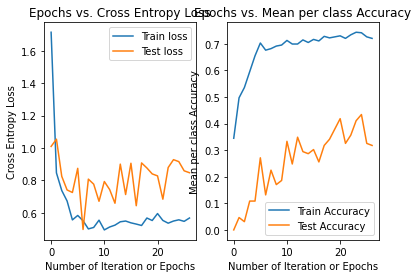

24
training cost: 0.6480823050099566
validation cost: 0.8514637128634539
training accuracy: 0.7996146435452793
validation accuracy: 0.7131782945736435
time elapsed: 0.09697970199977135
learning rate: 0.1
momentum : 0.005
regularization: 0.1


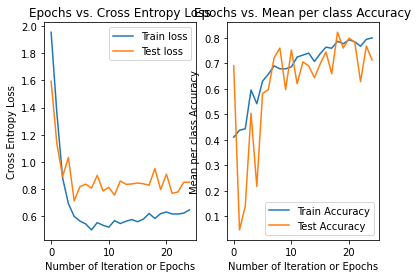

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.14285714285714285
36
training cost: 1.117218292313847
validation cost: 1.3339586532799337
training accuracy: 0.5915221579961464
validation accuracy: 0.27906976744186046
time elapsed: 0.1329945930001486
learning rate: 0.1
momentum : 0.005
regularization: 0.5


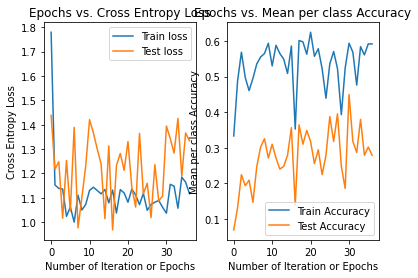

46
training cost: 1.2316115753133636
validation cost: 1.2531246356797916
training accuracy: 0.5472061657032755
validation accuracy: 0.4496124031007752
time elapsed: 0.17040303500016307
learning rate: 0.1
momentum : 0.005
regularization: 0.5


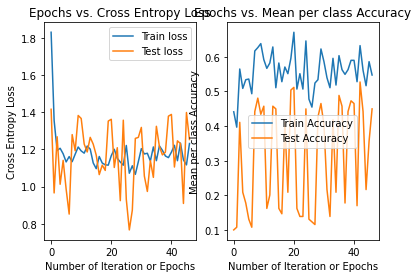

21
training cost: 1.1732803311876914
validation cost: 1.227202237108021
training accuracy: 0.48940269749518306
validation accuracy: 0.06201550387596899
time elapsed: 0.08527283799958241
learning rate: 0.1
momentum : 0.005
regularization: 0.5


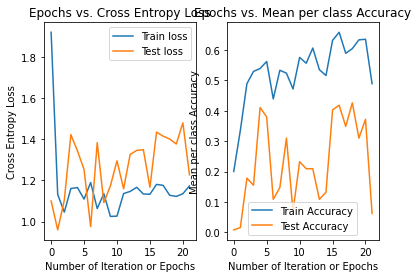

21
training cost: 1.1017157952038161
validation cost: 1.1578332122581165
training accuracy: 0.5741811175337187
validation accuracy: 0.05426356589147287
time elapsed: 0.08787240099991322
learning rate: 0.1
momentum : 0.005
regularization: 0.5


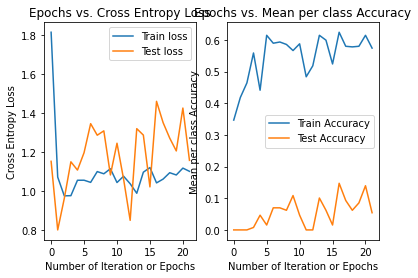

20
training cost: 1.158683114253375
validation cost: 1.5385924135603304
training accuracy: 0.5606936416184971
validation accuracy: 0.5116279069767442
time elapsed: 0.07921993200034194
learning rate: 0.1
momentum : 0.005
regularization: 0.5


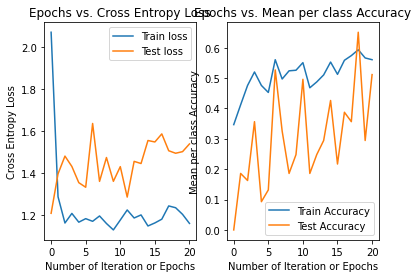

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
33
training cost: 1.2285100290481685
validation cost: 1.5887878008221905
training accuracy: 0.44508670520231214
validation accuracy: 0.13953488372093023
time elapsed: 0.12206698299996788
learning rate: 0.1
momentum : 0.005
regularization: 0.9


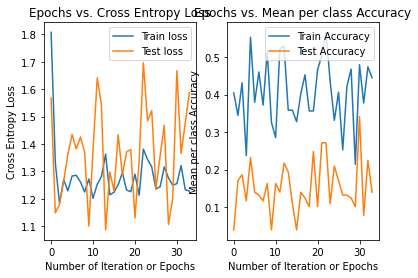

27
training cost: 1.4991294881527233
validation cost: 1.5335718677545975
training accuracy: 0.5337186897880539
validation accuracy: 0.4418604651162791
time elapsed: 0.1090737230006198
learning rate: 0.1
momentum : 0.005
regularization: 0.9


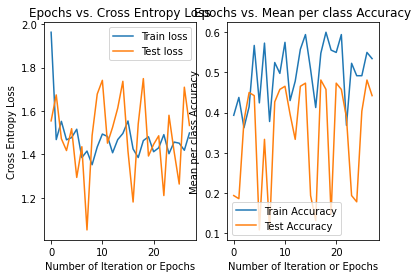

38
training cost: 1.474910788562464
validation cost: 1.484737425449695
training accuracy: 0.4913294797687861
validation accuracy: 0.14728682170542637
time elapsed: 0.13343728000018018
learning rate: 0.1
momentum : 0.005
regularization: 0.9


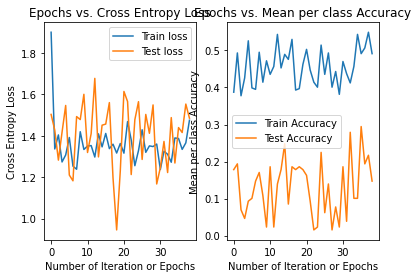

36
training cost: 1.1713911096364107
validation cost: 1.5160434810581922
training accuracy: 0.4816955684007707
validation accuracy: 0.007751937984496124
time elapsed: 0.15747955799997726
learning rate: 0.1
momentum : 0.005
regularization: 0.9


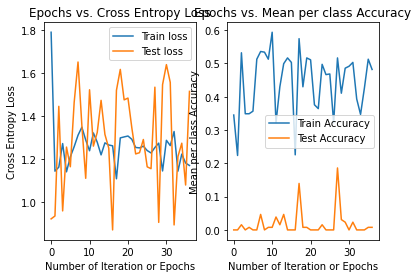

45
training cost: 1.4061019999943063
validation cost: 1.9446072052149739
training accuracy: 0.5568400770712909
validation accuracy: 0.3643410852713178
time elapsed: 0.1643181019999247
learning rate: 0.1
momentum : 0.005
regularization: 0.9


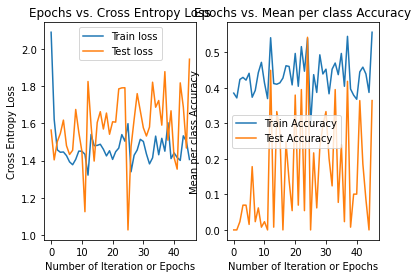

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
28
training cost: 1.3565499802352532
validation cost: 0.8072430345803009
training accuracy: 0.3044315992292871
validation accuracy: 0.31007751937984496
time elapsed: 1.6323363989995414
learning rate: 0.1
momentum : 0.05
regularization: 0.1


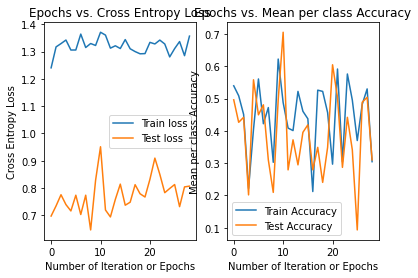

33
training cost: 1.3467480094578967
validation cost: 0.7176166141844939
training accuracy: 0.5337186897880539
validation accuracy: 0.1937984496124031
time elapsed: 2.0997255909996966
learning rate: 0.1
momentum : 0.05
regularization: 0.1


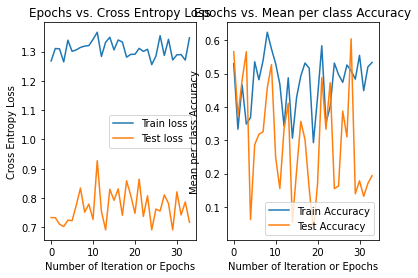

33
training cost: 1.350729444487809
validation cost: 0.911328420323838
training accuracy: 0.5086705202312138
validation accuracy: 0.2713178294573643
time elapsed: 2.040060669000013
learning rate: 0.1
momentum : 0.05
regularization: 0.1


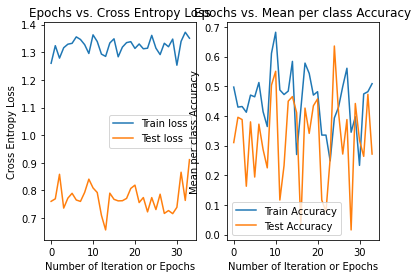

38
training cost: 1.26211125643444
validation cost: 0.7978802525576592
training accuracy: 0.33140655105973027
validation accuracy: 0.17054263565891473
time elapsed: 2.2093557829994097
learning rate: 0.1
momentum : 0.05
regularization: 0.1


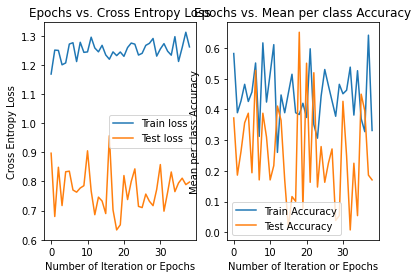

30
training cost: 1.3883542316919388
validation cost: 0.9692030919054551
training accuracy: 0.5183044315992292
validation accuracy: 0.14728682170542637
time elapsed: 1.720365166999727
learning rate: 0.1
momentum : 0.05
regularization: 0.1


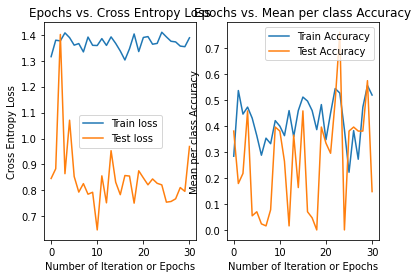

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.05714285714285714
45
training cost: 1.421907157544401
validation cost: 0.9894550796000932
training accuracy: 0.23892100192678228
validation accuracy: 0.17054263565891473
time elapsed: 2.6111620050005513
learning rate: 0.1
momentum : 0.05
regularization: 0.5


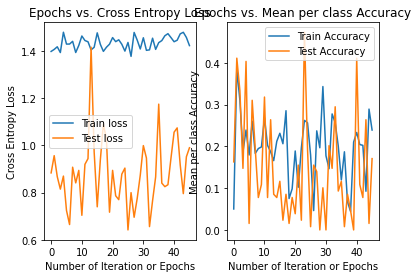

48
training cost: 1.4925494065137874
validation cost: 0.96456706417715
training accuracy: 0.325626204238921
validation accuracy: 0.15503875968992248
time elapsed: 2.7717508120003913
learning rate: 0.1
momentum : 0.05
regularization: 0.5


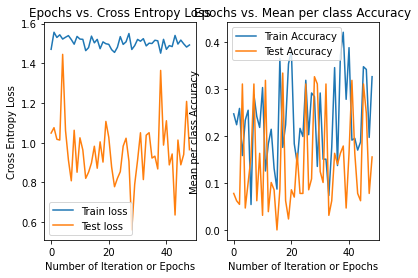

58
training cost: 1.4165916615621728
validation cost: 0.8935662754098125
training accuracy: 0.26204238921001927
validation accuracy: 0.17054263565891473
time elapsed: 3.3102096180000444
learning rate: 0.1
momentum : 0.05
regularization: 0.5


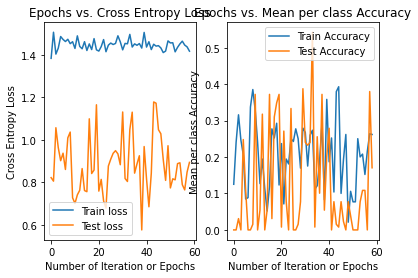

21
training cost: 1.4350401789301674
validation cost: 0.936067004120336
training accuracy: 0.19653179190751446
validation accuracy: 0.21705426356589147
time elapsed: 1.2377825140001733
learning rate: 0.1
momentum : 0.05
regularization: 0.5


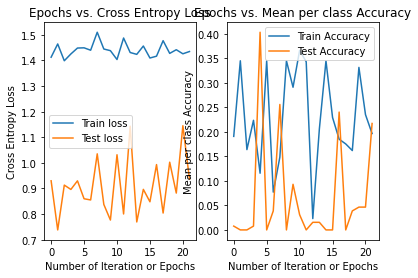

26
training cost: 1.5265323210521824
validation cost: 0.8919227659145617
training accuracy: 0.19653179190751446
validation accuracy: 0.0
time elapsed: 1.507476423999833
learning rate: 0.1
momentum : 0.05
regularization: 0.5


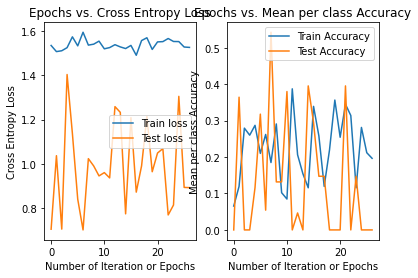

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
36
training cost: 1.4721309593374041
validation cost: 1.0612020134171543
training accuracy: 0.13872832369942195
validation accuracy: 0.3798449612403101
time elapsed: 2.2897593759998927
learning rate: 0.1
momentum : 0.05
regularization: 0.9


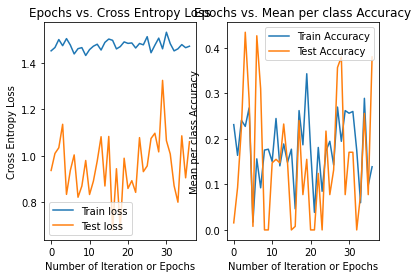

27
training cost: 1.5722706201775511
validation cost: 0.7535364656868992
training accuracy: 0.1599229287090559
validation accuracy: 0.06201550387596899
time elapsed: 1.5765445959996214
learning rate: 0.1
momentum : 0.05
regularization: 0.9


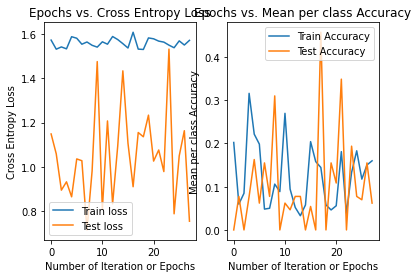

43
training cost: 1.4946436033769461
validation cost: 1.0675241140884237
training accuracy: 0.023121387283236993
validation accuracy: 0.07751937984496124
time elapsed: 2.4808707680003863
learning rate: 0.1
momentum : 0.05
regularization: 0.9


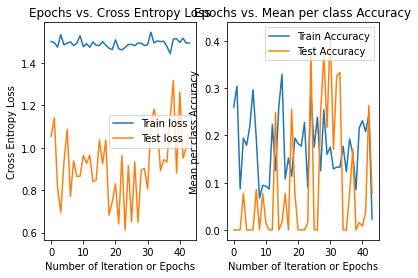

50
training cost: 1.535363375004235
validation cost: 0.9233927125897157
training accuracy: 0.18304431599229287
validation accuracy: 0.10077519379844961
time elapsed: 2.8550654109994866
learning rate: 0.1
momentum : 0.05
regularization: 0.9


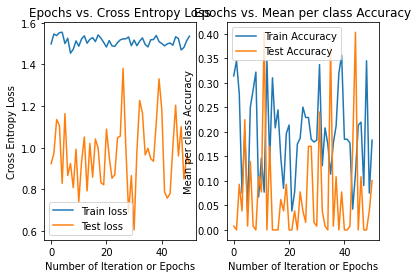

25
training cost: 1.6090648840776602
validation cost: 0.9453898762856046
training accuracy: 0.21001926782273603
validation accuracy: 0.0
time elapsed: 1.4551770119996945
learning rate: 0.1
momentum : 0.05
regularization: 0.9


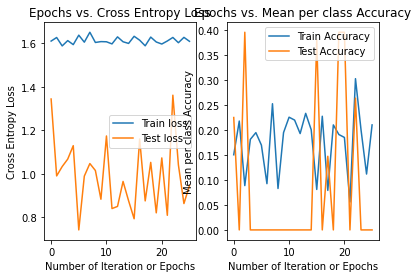

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
42
training cost: 0.766624862115771
validation cost: 0.7167101999801352
training accuracy: 0.720616570327553
validation accuracy: 0.6434108527131783
time elapsed: 0.37189655200018024
learning rate: 0.1
momentum : 0.05
regularization: 0.1


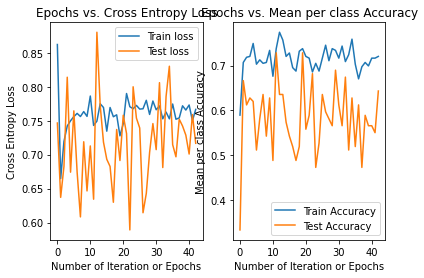

20
training cost: 0.7879531353470559
validation cost: 0.761090564888336
training accuracy: 0.7957610789980732
validation accuracy: 0.5968992248062015
time elapsed: 0.2218732400006047
learning rate: 0.1
momentum : 0.05
regularization: 0.1


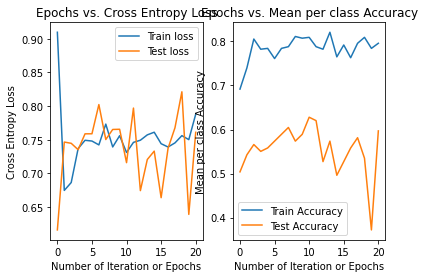

20
training cost: 0.8060760980327709
validation cost: 0.9553770648074864
training accuracy: 0.8188824662813102
validation accuracy: 0.6046511627906976
time elapsed: 0.18287962199974572
learning rate: 0.1
momentum : 0.05
regularization: 0.1


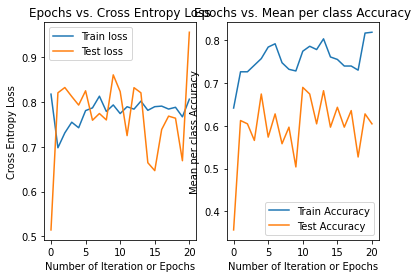

28
training cost: 0.6969558644219245
validation cost: 0.7378825815502547
training accuracy: 0.7167630057803468
validation accuracy: 0.2558139534883721
time elapsed: 0.24986375800017413
learning rate: 0.1
momentum : 0.05
regularization: 0.1


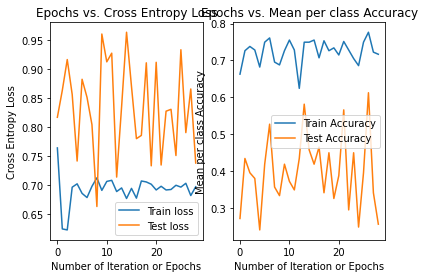

22
training cost: 0.7854901408691499
validation cost: 0.9360648925631034
training accuracy: 0.791907514450867
validation accuracy: 0.689922480620155
time elapsed: 0.20294036100040103
learning rate: 0.1
momentum : 0.05
regularization: 0.1


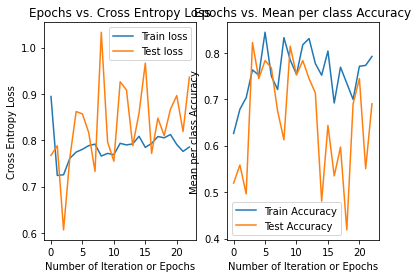

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.2
21
training cost: 1.137249545796117
validation cost: 1.3117127533937862
training accuracy: 0.535645472061657
validation accuracy: 0.27906976744186046
time elapsed: 0.235774345000209
learning rate: 0.1
momentum : 0.05
regularization: 0.5


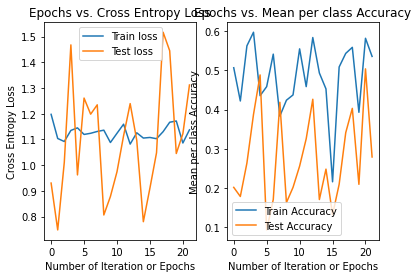

25
training cost: 1.2310556860550494
validation cost: 1.1630528758131082
training accuracy: 0.4932562620423892
validation accuracy: 0.17829457364341086
time elapsed: 0.22861542999999074
learning rate: 0.1
momentum : 0.05
regularization: 0.5


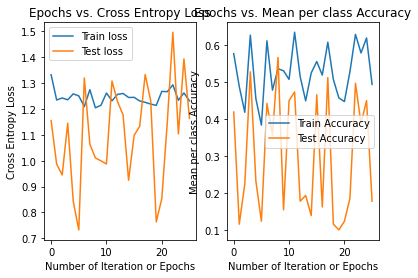

34
training cost: 1.215507882598815
validation cost: 1.297719376628473
training accuracy: 0.6011560693641619
validation accuracy: 0.5348837209302325
time elapsed: 0.30026140100017074
learning rate: 0.1
momentum : 0.05
regularization: 0.5


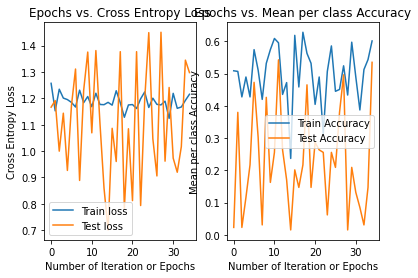

37
training cost: 1.0667797729349624
validation cost: 0.9342038188336634
training accuracy: 0.674373795761079
validation accuracy: 0.20930232558139536
time elapsed: 0.33036548599920934
learning rate: 0.1
momentum : 0.05
regularization: 0.5


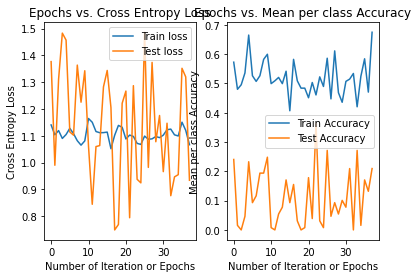

22
training cost: 1.2631735808962588
validation cost: 1.4217898303355778
training accuracy: 0.4836223506743738
validation accuracy: 0.14728682170542637
time elapsed: 0.2000458840002466
learning rate: 0.1
momentum : 0.05
regularization: 0.5


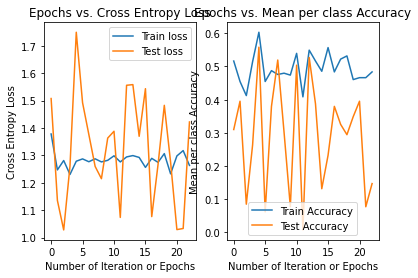

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
25
training cost: 1.302169765601141
validation cost: 1.1619059883303016
training accuracy: 0.33911368015414256
validation accuracy: 0.06976744186046512
time elapsed: 0.23147303899986582
learning rate: 0.1
momentum : 0.05
regularization: 0.9


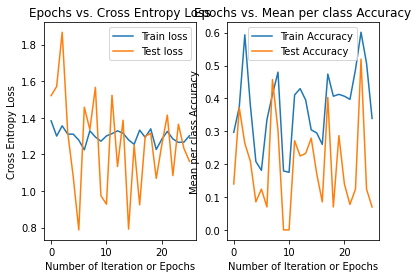

27
training cost: 1.4304424410227379
validation cost: 1.1774647499282025
training accuracy: 0.3583815028901734
validation accuracy: 0.16279069767441862
time elapsed: 0.24343051300002116
learning rate: 0.1
momentum : 0.05
regularization: 0.9


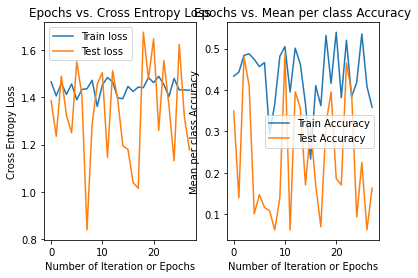

24
training cost: 1.3561301130649324
validation cost: 1.3134233475049135
training accuracy: 0.2947976878612717
validation accuracy: 0.015503875968992248
time elapsed: 0.21819028499976412
learning rate: 0.1
momentum : 0.05
regularization: 0.9


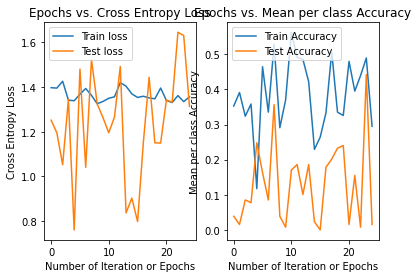

31
training cost: 1.2877025083530247
validation cost: 0.9746123928663233
training accuracy: 0.394990366088632
validation accuracy: 0.015503875968992248
time elapsed: 0.27993590400001267
learning rate: 0.1
momentum : 0.05
regularization: 0.9


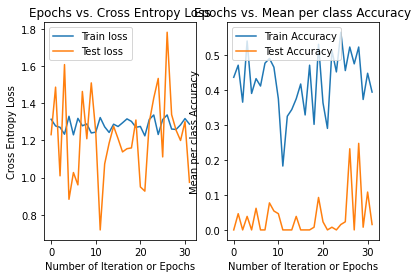

28
training cost: 1.528476809050137
validation cost: 1.4370021334449983
training accuracy: 0.4277456647398844
validation accuracy: 0.3953488372093023
time elapsed: 0.2596055489993887
learning rate: 0.1
momentum : 0.05
regularization: 0.9


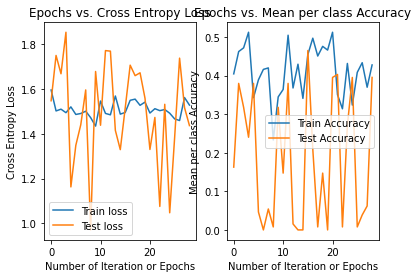

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
31
training cost: 0.6901338191904332
validation cost: 0.7411184287979582
training accuracy: 0.6724470134874759
validation accuracy: 0.49612403100775193
time elapsed: 0.1318721319994438
learning rate: 0.1
momentum : 0.05
regularization: 0.1


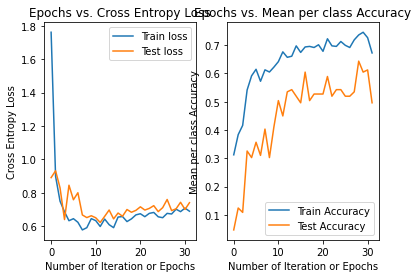

35
training cost: 0.6476857648394866
validation cost: 0.7908270483846565
training accuracy: 0.7707129094412332
validation accuracy: 0.5736434108527132
time elapsed: 0.14226756999960344
learning rate: 0.1
momentum : 0.05
regularization: 0.1


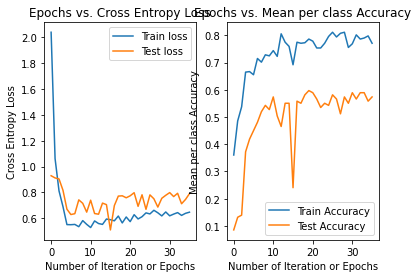

25
training cost: 0.6415215327300189
validation cost: 0.8743993117017735
training accuracy: 0.7861271676300579
validation accuracy: 0.5503875968992248
time elapsed: 0.10178476399960346
learning rate: 0.1
momentum : 0.05
regularization: 0.1


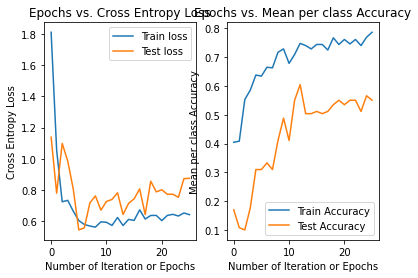

22
training cost: 0.5703099800537094
validation cost: 0.8826988898268547
training accuracy: 0.7418111753371869
validation accuracy: 0.5038759689922481
time elapsed: 0.09258569399935368
learning rate: 0.1
momentum : 0.05
regularization: 0.1


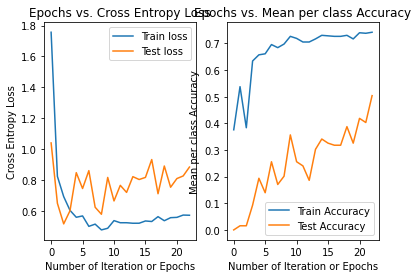

23
training cost: 0.6138941545070417
validation cost: 0.8372286051465835
training accuracy: 0.7495183044315993
validation accuracy: 0.6744186046511628
time elapsed: 0.09183800299979339
learning rate: 0.1
momentum : 0.05
regularization: 0.1


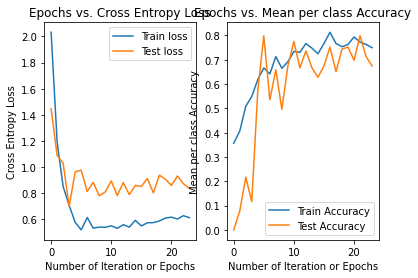

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.08571428571428572
22
training cost: 1.1556096593391474
validation cost: 1.1401665272210757
training accuracy: 0.35260115606936415
validation accuracy: 0.27906976744186046
time elapsed: 0.08884637800019846
learning rate: 0.1
momentum : 0.05
regularization: 0.5


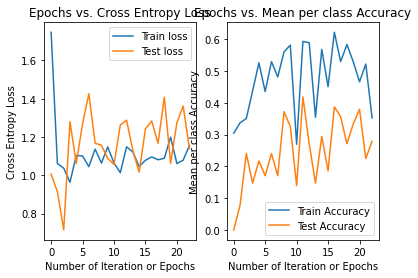

23
training cost: 1.1991519990055155
validation cost: 0.9348793223350211
training accuracy: 0.5202312138728323
validation accuracy: 0.11627906976744186
time elapsed: 0.08912919999966107
learning rate: 0.1
momentum : 0.05
regularization: 0.5


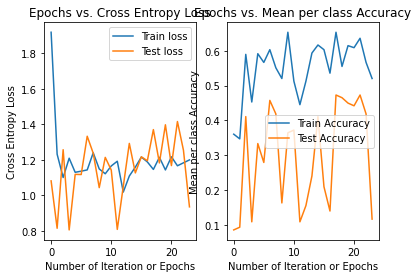

25
training cost: 1.095647796151554
validation cost: 1.2384674364981851
training accuracy: 0.6165703275529865
validation accuracy: 0.4883720930232558
time elapsed: 0.101515493000079
learning rate: 0.1
momentum : 0.05
regularization: 0.5


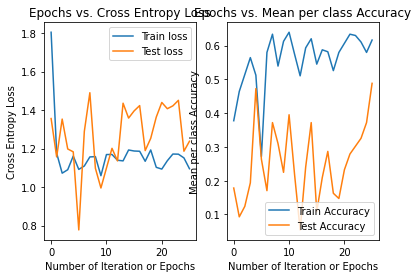

35
training cost: 1.1080072555485059
validation cost: 1.1877495250132262
training accuracy: 0.5799614643545279
validation accuracy: 0.13953488372093023
time elapsed: 0.1357257950003259
learning rate: 0.1
momentum : 0.05
regularization: 0.5


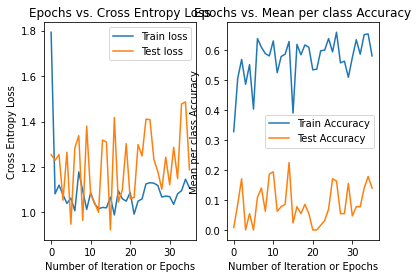

25
training cost: 1.1054605986625334
validation cost: 1.3485331474001496
training accuracy: 0.5240847784200385
validation accuracy: 0.13953488372093023
time elapsed: 0.10067120900021109
learning rate: 0.1
momentum : 0.05
regularization: 0.5


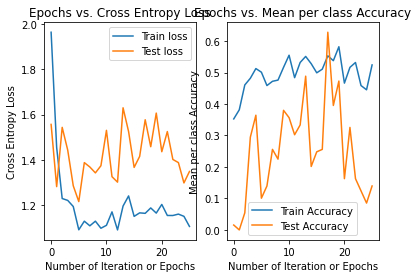

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
26
training cost: 1.2623014997983415
validation cost: 1.135294708490207
training accuracy: 0.3217726396917148
validation accuracy: 0.031007751937984496
time elapsed: 0.10617096599980869
learning rate: 0.1
momentum : 0.05
regularization: 0.9


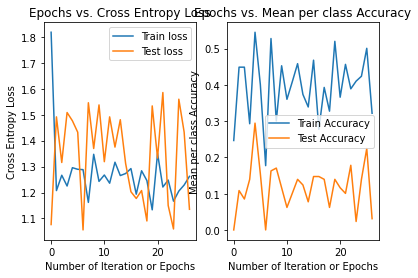

41
training cost: 1.5241560121047035
validation cost: 1.5333280522256238
training accuracy: 0.5973025048169557
validation accuracy: 0.43410852713178294
time elapsed: 0.15875936599968554
learning rate: 0.1
momentum : 0.05
regularization: 0.9


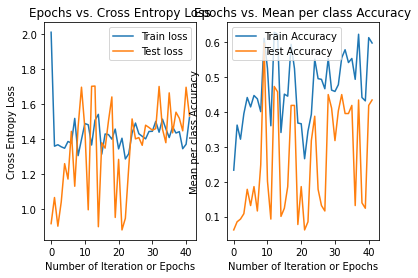

23
training cost: 1.4246727830336419
validation cost: 1.3360270576954159
training accuracy: 0.3969171483622351
validation accuracy: 0.0
time elapsed: 0.103411404000326
learning rate: 0.1
momentum : 0.05
regularization: 0.9


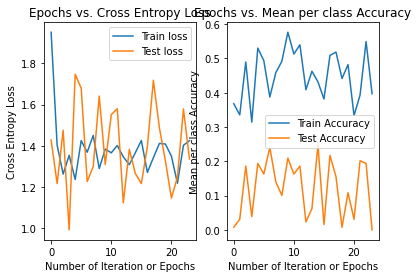

36
training cost: 1.2334003707329744
validation cost: 1.4495513970821798
training accuracy: 0.5221579961464354
validation accuracy: 0.0
time elapsed: 0.12718346300061967
learning rate: 0.1
momentum : 0.05
regularization: 0.9


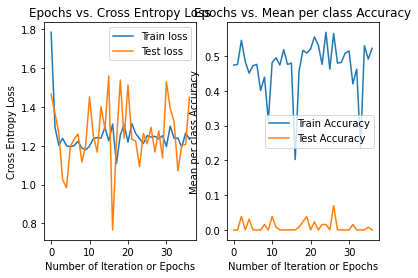

22
training cost: 1.4261388424236454
validation cost: 1.6245859121550512
training accuracy: 0.441233140655106
validation accuracy: 0.05426356589147287
time elapsed: 0.09780464100003883
learning rate: 0.1
momentum : 0.05
regularization: 0.9


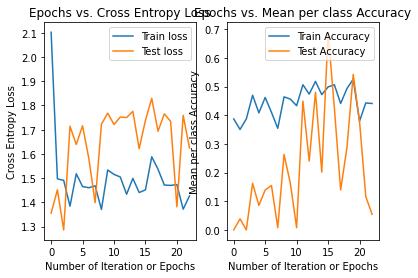

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
30
training cost: 1.5718962996257908
validation cost: 1.0086597138676523
training accuracy: 0.2909441233140655
validation accuracy: 0.12403100775193798
time elapsed: 1.7447634939999261
learning rate: 0.1
momentum : 0.5
regularization: 0.1


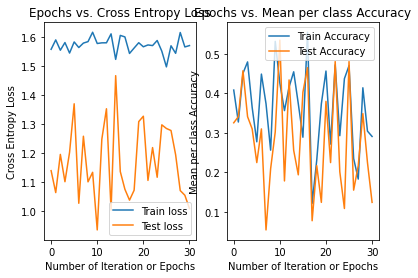

55
training cost: 1.6180740386117296
validation cost: 1.2968262866415794
training accuracy: 0.19653179190751446
validation accuracy: 0.17829457364341086
time elapsed: 3.147711468000125
learning rate: 0.1
momentum : 0.5
regularization: 0.1


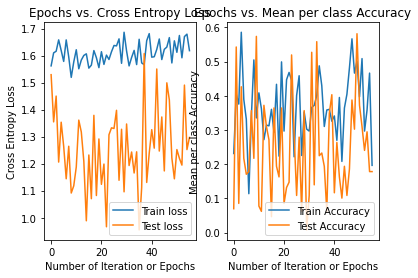

44
training cost: 1.5991754786222467
validation cost: 1.3831570245197002
training accuracy: 0.3217726396917148
validation accuracy: 0.2868217054263566
time elapsed: 2.513211735999903
learning rate: 0.1
momentum : 0.5
regularization: 0.1


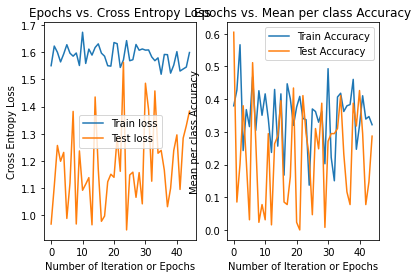

32
training cost: 1.5708562742683567
validation cost: 1.194546089280587
training accuracy: 0.5529865125240848
validation accuracy: 0.23255813953488372
time elapsed: 1.854758832000698
learning rate: 0.1
momentum : 0.5
regularization: 0.1


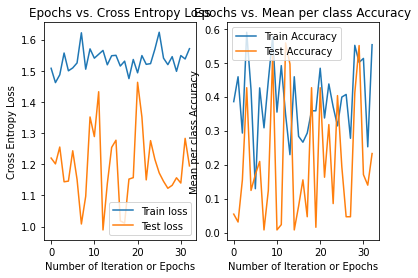

35
training cost: 1.6187852184335327
validation cost: 1.3336755662209032
training accuracy: 0.28709055876685935
validation accuracy: 0.3798449612403101
time elapsed: 2.0362239360001695
learning rate: 0.1
momentum : 0.5
regularization: 0.1


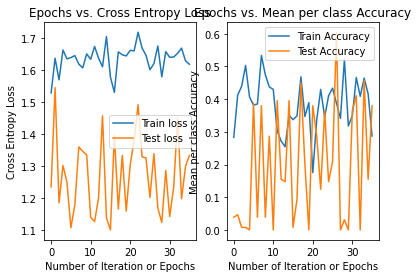

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.17142857142857143
32
training cost: 1.7699225916997916
validation cost: 1.105709829224694
training accuracy: 0.12716763005780346
validation accuracy: 0.17829457364341086
time elapsed: 1.879319927999859
learning rate: 0.1
momentum : 0.5
regularization: 0.5


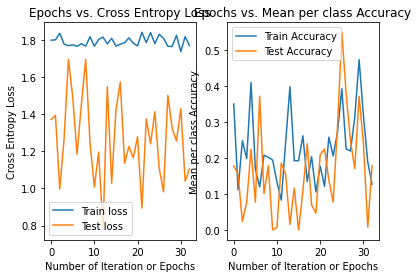

31
training cost: 1.9195949225386346
validation cost: 1.4920041961161756
training accuracy: 0.30828516377649323
validation accuracy: 0.08527131782945736
time elapsed: 1.8055707399998937
learning rate: 0.1
momentum : 0.5
regularization: 0.5


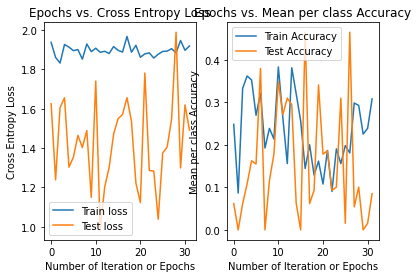

35
training cost: 1.8230788135109364
validation cost: 1.315933335173756
training accuracy: 0.18882466281310212
validation accuracy: 0.26356589147286824
time elapsed: 2.0262256400001206
learning rate: 0.1
momentum : 0.5
regularization: 0.5


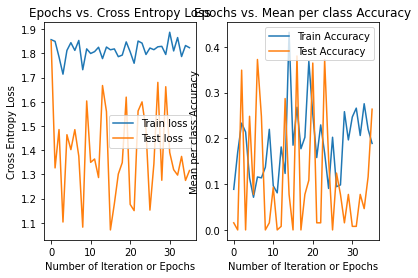

30
training cost: 1.8157793707035157
validation cost: 1.3978496573007813
training accuracy: 0.2350674373795761
validation accuracy: 0.3488372093023256
time elapsed: 1.748802439999963
learning rate: 0.1
momentum : 0.5
regularization: 0.5


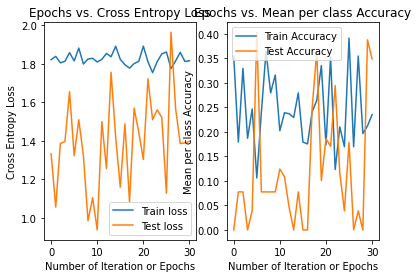

35
training cost: 1.9380531131472478
validation cost: 1.5984094125458723
training accuracy: 0.2697495183044316
validation accuracy: 0.0
time elapsed: 2.065664828000081
learning rate: 0.1
momentum : 0.5
regularization: 0.5


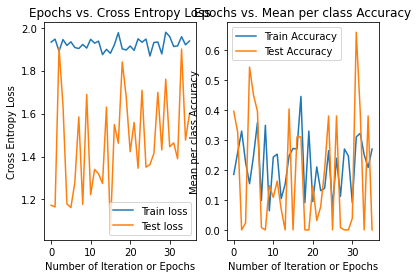

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
40
training cost: 1.9062835203972894
validation cost: 1.2765318484251291
training accuracy: 0.1464354527938343
validation accuracy: 0.0
time elapsed: 2.3799063020005633
learning rate: 0.1
momentum : 0.5
regularization: 0.9


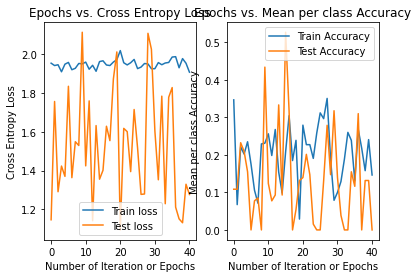

29
training cost: 2.093620881708131
validation cost: 1.4541998970016154
training accuracy: 0.17533718689788053
validation accuracy: 0.16279069767441862
time elapsed: 1.7914539029998195
learning rate: 0.1
momentum : 0.5
regularization: 0.9


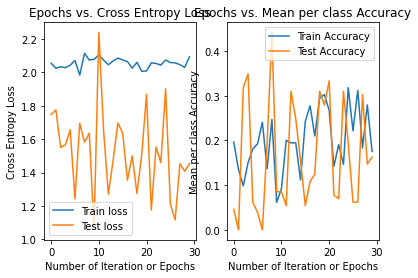

23
training cost: 1.9733526429317942
validation cost: 1.5925817014985482
training accuracy: 0.24084778420038536
validation accuracy: 0.4186046511627907
time elapsed: 1.3370699799997965
learning rate: 0.1
momentum : 0.5
regularization: 0.9


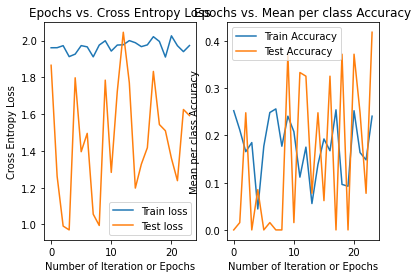

61
training cost: 2.020538790368255
validation cost: 2.076919330283423
training accuracy: 0.21965317919075145
validation accuracy: 0.0
time elapsed: 3.476664499000435
learning rate: 0.1
momentum : 0.5
regularization: 0.9


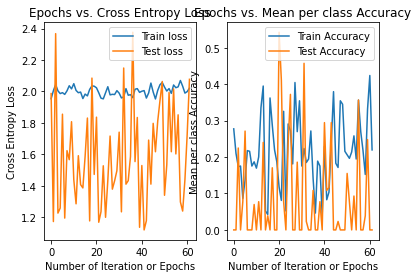

26
training cost: 2.036518324913683
validation cost: 1.5360632551223845
training accuracy: 0.23314065510597304
validation accuracy: 0.5038759689922481
time elapsed: 1.5169840070002465
learning rate: 0.1
momentum : 0.5
regularization: 0.9


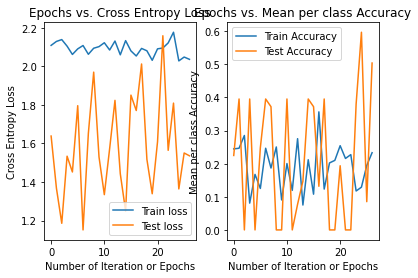

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
84
training cost: 0.7256391294307956
validation cost: 0.6563704934906466
training accuracy: 0.6454720616570327
validation accuracy: 0.5581395348837209
time elapsed: 0.7367300309997518
learning rate: 0.1
momentum : 0.5
regularization: 0.1


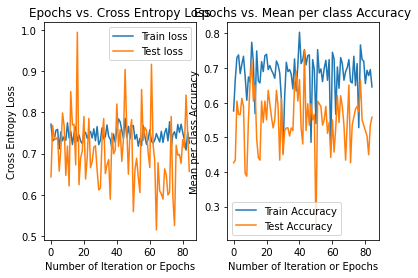

21
training cost: 0.7283195407018302
validation cost: 0.6291427209664575
training accuracy: 0.7745664739884393
validation accuracy: 0.5426356589147286
time elapsed: 0.1938380949995917
learning rate: 0.1
momentum : 0.5
regularization: 0.1


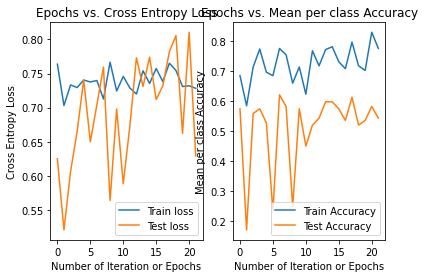

22
training cost: 0.7506789399594596
validation cost: 0.8592167554882612
training accuracy: 0.7572254335260116
validation accuracy: 0.5193798449612403
time elapsed: 0.20694956999977876
learning rate: 0.1
momentum : 0.5
regularization: 0.1


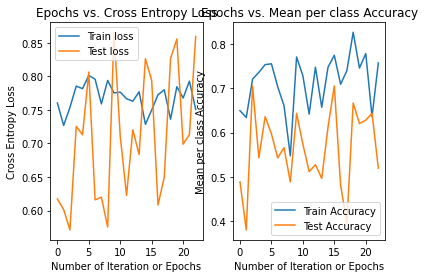

27
training cost: 0.6835950575338803
validation cost: 0.6423221903840733
training accuracy: 0.6878612716763006
validation accuracy: 0.32558139534883723
time elapsed: 0.24791096999979345
learning rate: 0.1
momentum : 0.5
regularization: 0.1


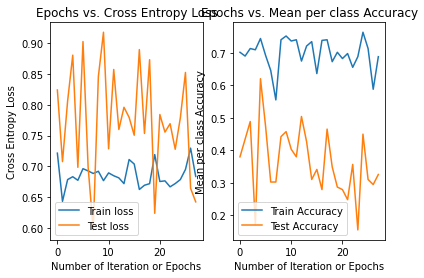

25
training cost: 0.8150575760774325
validation cost: 0.8258412445496782
training accuracy: 0.7013487475915221
validation accuracy: 0.5426356589147286
time elapsed: 0.2221682929994131
learning rate: 0.1
momentum : 0.5
regularization: 0.1


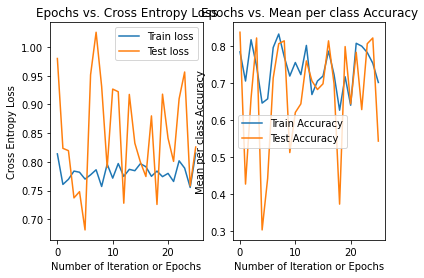

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.42857142857142855
24
training cost: 1.0574477400799618
validation cost: 0.9463445849015291
training accuracy: 0.4258188824662813
validation accuracy: 0.40310077519379844
time elapsed: 0.22525599199980206
learning rate: 0.1
momentum : 0.5
regularization: 0.5


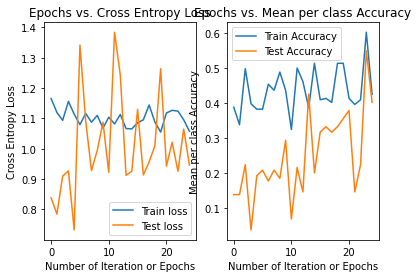

55
training cost: 1.2147734166514788
validation cost: 0.9666152522939406
training accuracy: 0.5028901734104047
validation accuracy: 0.4418604651162791
time elapsed: 0.46831221699994785
learning rate: 0.1
momentum : 0.5
regularization: 0.5


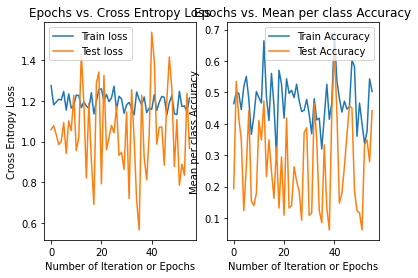

47
training cost: 1.1866185211363707
validation cost: 1.2340749744731596
training accuracy: 0.5260115606936416
validation accuracy: 0.2868217054263566
time elapsed: 0.49451777000012953
learning rate: 0.1
momentum : 0.5
regularization: 0.5


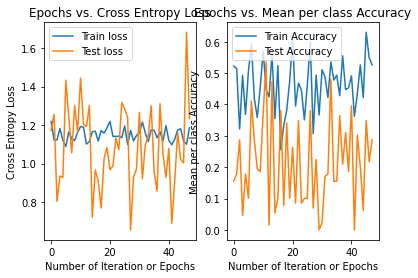

20
training cost: 1.0317723093861166
validation cost: 0.8911953323817197
training accuracy: 0.4932562620423892
validation accuracy: 0.10077519379844961
time elapsed: 0.19166025899994565
learning rate: 0.1
momentum : 0.5
regularization: 0.5


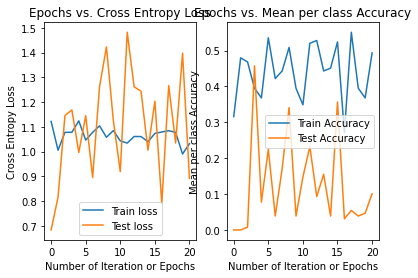

27
training cost: 1.173347788681046
validation cost: 1.321901453449197
training accuracy: 0.43545279383429675
validation accuracy: 0.23255813953488372
time elapsed: 0.23900413199953618
learning rate: 0.1
momentum : 0.5
regularization: 0.5


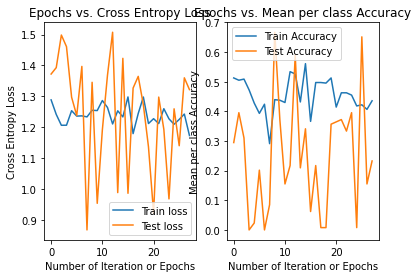

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
46
training cost: 1.2249025215287634
validation cost: 1.4739939444405215
training accuracy: 0.3603082851637765
validation accuracy: 0.49612403100775193
time elapsed: 0.407929676999629
learning rate: 0.1
momentum : 0.5
regularization: 0.9


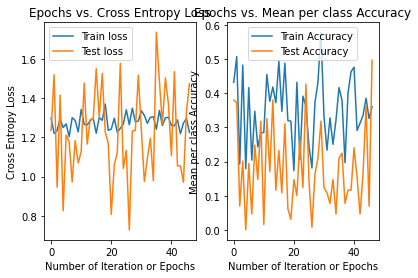

31
training cost: 1.3658762648495175
validation cost: 1.4714633206071293
training accuracy: 0.4951830443159923
validation accuracy: 0.31007751937984496
time elapsed: 0.27486646399938763
learning rate: 0.1
momentum : 0.5
regularization: 0.9


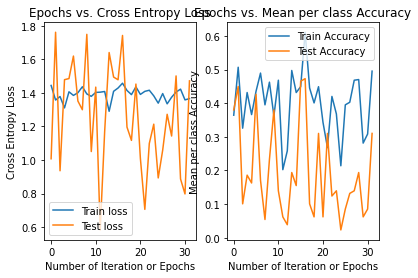

39
training cost: 1.3280931171607682
validation cost: 1.4767879676652447
training accuracy: 0.3834296724470135
validation accuracy: 0.37209302325581395
time elapsed: 0.3413140579996252
learning rate: 0.1
momentum : 0.5
regularization: 0.9


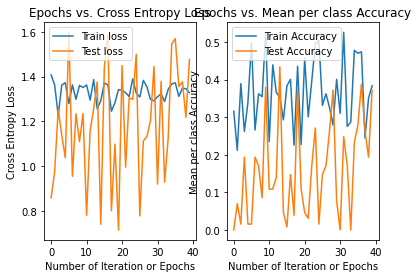

34
training cost: 1.2794298000905695
validation cost: 1.0545832048368995
training accuracy: 0.32755298651252407
validation accuracy: 0.05426356589147287
time elapsed: 0.3087584960003369
learning rate: 0.1
momentum : 0.5
regularization: 0.9


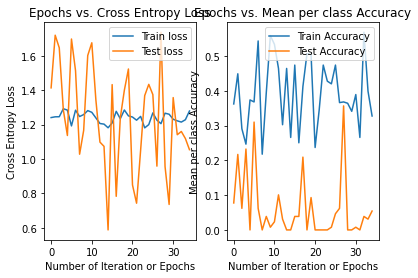

66
training cost: 1.4174104767719296
validation cost: 2.0380045080223055
training accuracy: 0.5568400770712909
validation accuracy: 0.3023255813953488
time elapsed: 0.5721447050000279
learning rate: 0.1
momentum : 0.5
regularization: 0.9


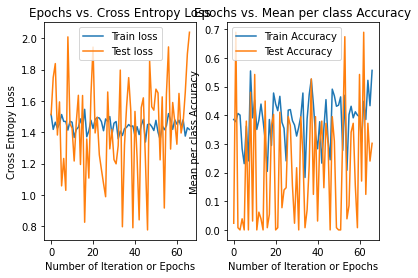

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
20
training cost: 0.69277355002917
validation cost: 0.7491822425267978
training accuracy: 0.7456647398843931
validation accuracy: 0.5891472868217055
time elapsed: 0.07898393100003887
learning rate: 0.1
momentum : 0.5
regularization: 0.1


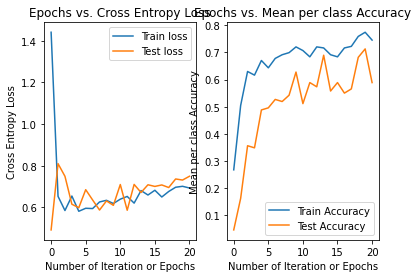

29
training cost: 0.6188785755216727
validation cost: 0.7257671059360042
training accuracy: 0.7514450867052023
validation accuracy: 0.6124031007751938
time elapsed: 0.10959432100025879
learning rate: 0.1
momentum : 0.5
regularization: 0.1


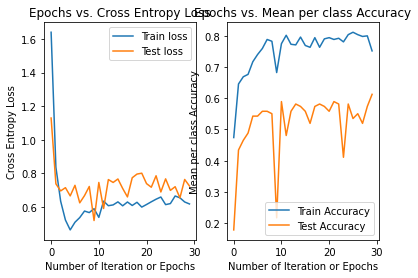

22
training cost: 0.7082323992646685
validation cost: 0.7061145309786716
training accuracy: 0.7687861271676301
validation accuracy: 0.6201550387596899
time elapsed: 0.08951874400008819
learning rate: 0.1
momentum : 0.5
regularization: 0.1


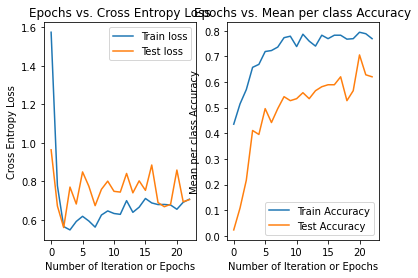

20
training cost: 0.5873061957325051
validation cost: 0.9206243856623815
training accuracy: 0.7398843930635838
validation accuracy: 0.32558139534883723
time elapsed: 0.0800965130001714
learning rate: 0.1
momentum : 0.5
regularization: 0.1


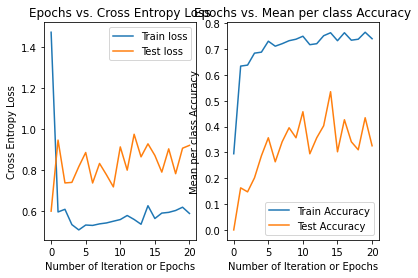

28
training cost: 0.6488402218838506
validation cost: 0.9254375244230331
training accuracy: 0.8111753371868978
validation accuracy: 0.7674418604651163
time elapsed: 0.11062407800000074
learning rate: 0.1
momentum : 0.5
regularization: 0.1


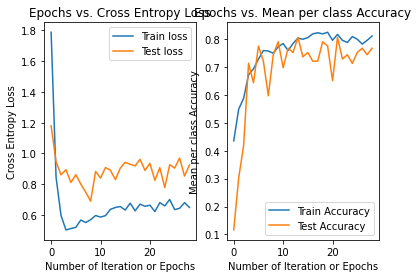

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.22857142857142856
31
training cost: 0.9941094469045014
validation cost: 1.434285322109293
training accuracy: 0.5895953757225434
validation accuracy: 0.3023255813953488
time elapsed: 0.1120308469999145
learning rate: 0.1
momentum : 0.5
regularization: 0.5


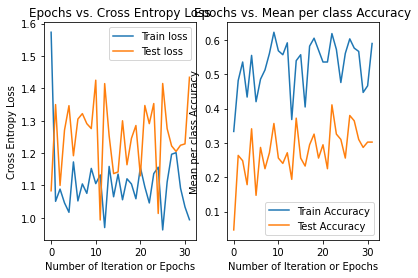

28
training cost: 1.0195351568625208
validation cost: 1.2451638811235928
training accuracy: 0.6358381502890174
validation accuracy: 0.4418604651162791
time elapsed: 0.11492531899966707
learning rate: 0.1
momentum : 0.5
regularization: 0.5


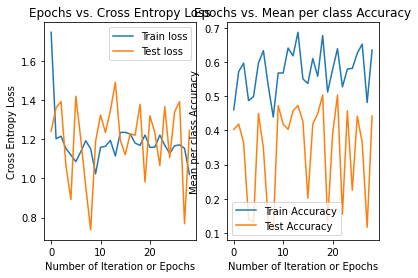

36
training cost: 1.1567119474754326
validation cost: 0.9531943183772984
training accuracy: 0.5144508670520231
validation accuracy: 0.03875968992248062
time elapsed: 0.13697085300009348
learning rate: 0.1
momentum : 0.5
regularization: 0.5


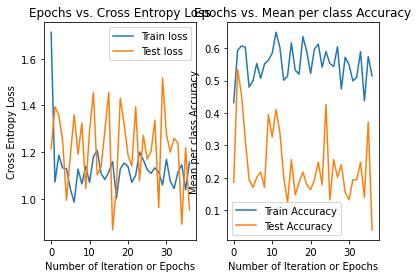

23
training cost: 1.0552693510609747
validation cost: 1.0274155873972488
training accuracy: 0.5491329479768786
validation accuracy: 0.06201550387596899
time elapsed: 0.10354048799945303
learning rate: 0.1
momentum : 0.5
regularization: 0.5


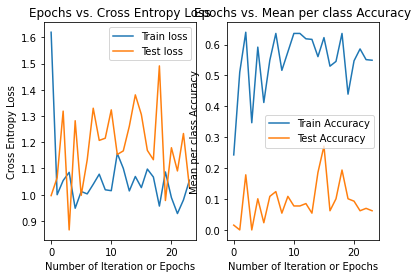

24
training cost: 1.2178772645603155
validation cost: 1.4051208961430703
training accuracy: 0.5298651252408478
validation accuracy: 0.5891472868217055
time elapsed: 0.09209956699942268
learning rate: 0.1
momentum : 0.5
regularization: 0.5


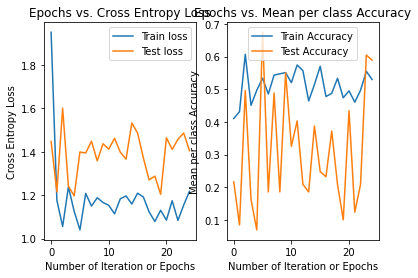

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0
20
training cost: 1.1979997813131575
validation cost: 1.581239081415311
training accuracy: 0.4161849710982659
validation accuracy: 0.32558139534883723
time elapsed: 0.08425041099962982
learning rate: 0.1
momentum : 0.5
regularization: 0.9


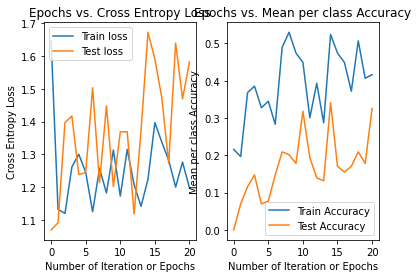

29
training cost: 1.367771529356926
validation cost: 1.2435538206862864
training accuracy: 0.41811175337186895
validation accuracy: 0.37209302325581395
time elapsed: 0.11217440899963549
learning rate: 0.1
momentum : 0.5
regularization: 0.9


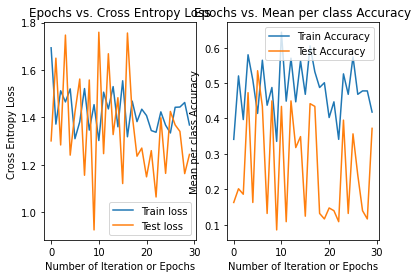

28
training cost: 1.3586018220183795
validation cost: 1.305809336847062
training accuracy: 0.4508670520231214
validation accuracy: 0.18604651162790697
time elapsed: 0.120127340000181
learning rate: 0.1
momentum : 0.5
regularization: 0.9


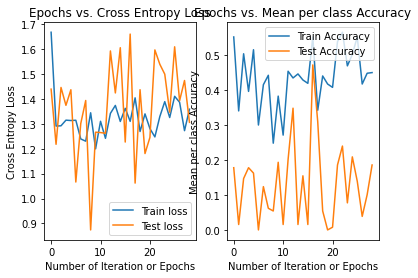

30
training cost: 1.2386749162806299
validation cost: 1.4892242707883352
training accuracy: 0.47591522157996147
validation accuracy: 0.015503875968992248
time elapsed: 0.11568154599990521
learning rate: 0.1
momentum : 0.5
regularization: 0.9


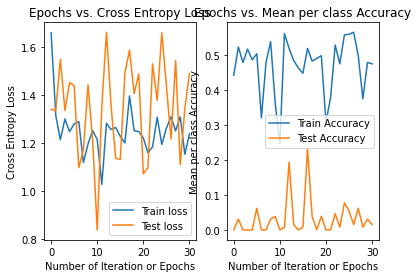

34
training cost: 1.364097843713594
validation cost: 1.3461138020047416
training accuracy: 0.4007707129094412
validation accuracy: 0.06201550387596899
time elapsed: 0.12305387600008544
learning rate: 0.1
momentum : 0.5
regularization: 0.9


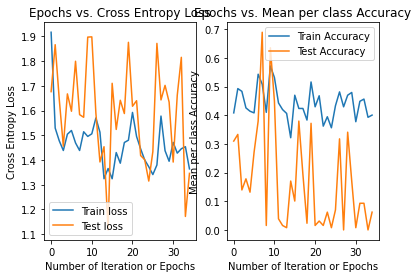

_______________________DONE 5 FOLD_______________________
Best accuracy on validation set: 0.813953488372093
Average cross validation score: 0.6950904392764858
Accuracy on test: 0.0


In [13]:
trainOnData(soy)